In [ ]:
# Matplotlib 한글 폰트 3단계 수행하기 (한글명은 없앴지만 만일을 대비)
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# 한글폰트 설치 3단계
# 1단계, 폰트 설치
!sudo apt-get install -y fonts-nanum
!sudo fc-cache -fv
!rm ~/.cache/matplotlib -rf

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following NEW packages will be installed:
  fonts-nanum
0 upgraded, 1 newly installed, 0 to remove and 35 not upgraded.
Need to get 10.3 MB of archives.
After this operation, 34.1 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 fonts-nanum all 20200506-1 [10.3 MB]
Fetched 10.3 MB in 4s (2,699 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 78, <> line 1.)
debconf: falling back to frontend: Readline
debconf: unable to initialize frontend: Readline
debconf: (This frontend requires a controlling tty.)
debconf: falling back to frontend: Teletype
dpkg-preconfigure: unable to re-open stdin: 
Selecting previously unselected package fonts-nanum.
(Reading database ... 126284 files and dire

In [ ]:
# 2단계, 세션 다시 시작한다.
코랩의 런타임 재시작한다. # 폰트 설치 후

In [ ]:
# 3단계, matplotlib의 폰트를 Nanum 폰트로 지정합니다.
import matplotlib.pyplot as plt
plt.rc('font', family='NanumBarunGothic')

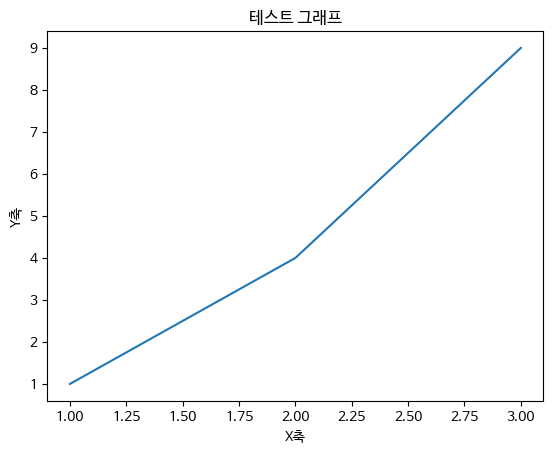

In [ ]:
import matplotlib.pyplot as plt

plt.plot([1, 2, 3], [1, 4, 9])
plt.title('테스트 그래프')  # 한글이 포함됨
plt.xlabel('X축')
plt.ylabel('Y축')
plt.show()


# 1. 파일명(한글) -> 파일명(영문) 변경

In [ ]:
# # 전
# /content/drive/MyDrive/pet_angle/front/label_front
# /content/drive/MyDrive/pet_angle/add_front/add_front_label

# 좌우
# /content/drive/MyDrive/pet_angle/add_side/add_side_label
# /content/drive/MyDrive/pet_angle/side/label_side

# 후
# /content/drive/MyDrive/pet_angle/add_tail/add_tail_label
# /content/drive/MyDrive/pet_angle/tail/label

## 1) 실제 파일명(한글->영문)을 변경

In [ ]:
# 실제 파일명.jpg와 파일명.json을 영문으로 변경
유니코드 정규화 후 문자열 치환한다.
파이썬의 unicodedata.normalize()를 사용해 NFD → NFC 정규화를 먼저 해주면 해결된다.

In [ ]:
from pathlib import Path
import unicodedata

# 대상 디렉토리
folder = Path("/content/side_healbow3/images/train")

for file in folder.iterdir():
    if file.is_file():
        # 유니코드 정규화
        normalized_name = unicodedata.normalize("NFC", file.name)
        if "치료멍멍" in normalized_name:
            new_normalized_name = normalized_name.replace("치료멍멍", "heal") # 치료멍멍이 들어간 파일명을 heal로 변경한다. # 예시 : 치료멍멍abc.jpg -> headabc.jpg
            new_path = file.with_name(new_normalized_name)
            file.rename(new_path)
            print(f"✅ 이름 변경: {file.name} → {new_path.name}")

print("\n🎉 이름 변경 작업이 완료되었습니다.")


## 2) json 파일의 속성 값인 filename에 명시된 파일명(한글->영문)으로 변경

In [ ]:
# 우선 json파일 내용의 filename 속성 중 한글 이름을 영문으로 바꾼다. (내부 파이프라인으로 파일명 인식)
json의 filename 값은 이미지 파일 이름의 본체로, 코드나 파이프라인에서 .jpg를 붙여서 해당 이미지를 찾는다.
cv2.imread, matplotlib, yolo 기타 코드에서 매핑 방식의 일환으로 사용하므로, 안전하게 한글명은 모두 영문명으로 바꾼다.

예시 : image_info["filename]+".jpg"]


In [ ]:
from pathlib import Path
import json

# 6개 경로 리스트
json_dirs = [
    "/content/drive/MyDrive/pet_angle/front/label_front",
    "/content/drive/MyDrive/pet_angle/add_front/add_front_label",
    "/content/drive/MyDrive/pet_angle/side/label_side",
    "/content/drive/MyDrive/pet_angle/add_side/add_side_label",
    "/content/drive/MyDrive/pet_angle/tail/label",
    "/content/drive/MyDrive/pet_angle/add_tail/add_tail_label"
]

modified_count = 0

# 각 폴더 순회
for dir_path in json_dirs:
    json_root = Path(dir_path)
    for json_path in json_root.rglob("*.json"):
        try:
            with open(json_path, "r", encoding="utf-8") as f:
                data = json.load(f)

            old_name = data.get("image_info", {}).get("filename", "")
            if "치료멍멍" in old_name:
                new_name = old_name.replace("치료멍멍", "heal")
                data["image_info"]["filename"] = new_name

                with open(json_path, "w", encoding="utf-8") as f:
                    json.dump(data, f, ensure_ascii=False, indent=2)

                print(f"✅ 수정됨: {json_path.name} | {old_name} → {new_name}")
                modified_count += 1
        except Exception as e:
            print(f"⚠️ 오류: {json_path.name} → {e}")

print(f"\n🎉 총 수정된 파일 수: {modified_count}개")


✅ 수정됨: heal_2024_09_10_14_43_51_00125.json | 치료멍멍_2024_09_10_14_43_51_00125 → heal_2024_09_10_14_43_51_00125
✅ 수정됨: heal_2024_09_11_12_39_02_00043.json | 치료멍멍_2024_09_11_12_39_02_00043 → heal_2024_09_11_12_39_02_00043
✅ 수정됨: heal_2024_09_24_10_28_05_00739.json | 치료멍멍_2024_09_24_10_28_05_00739 → heal_2024_09_24_10_28_05_00739
✅ 수정됨: heal_2024_10_05_14_17_00_00331.json | 치료멍멍_2024_10_05_14_17_00_00331 → heal_2024_10_05_14_17_00_00331
✅ 수정됨: heal_2024_09_05_17_31_30_00073.json | 치료멍멍_2024_09_05_17_31_30_00073 → heal_2024_09_05_17_31_30_00073
✅ 수정됨: heal_2024_09_19_17_53_55_00215.json | 치료멍멍_2024_09_19_17_53_55_00215 → heal_2024_09_19_17_53_55_00215
✅ 수정됨: heal_2024_09_24_10_28_05_00533.json | 치료멍멍_2024_09_24_10_28_05_00533 → heal_2024_09_24_10_28_05_00533
✅ 수정됨: heal_2024_09_14_14_05_10_00014.json | 치료멍멍_2024_09_14_14_05_10_00014 → heal_2024_09_14_14_05_10_00014
✅ 수정됨: heal_2024_09_14_14_03_10_00001.json | 치료멍멍_2024_09_14_14_03_10_00001 → heal_2024_09_14_14_03_10_00001
✅ 수정됨: heal_2024_09

In [ ]:
from pathlib import Path
import json

# 6개 경로 리스트
json_dirs = [
    "/content/drive/MyDrive/pet_angle/front/label_front",
    "/content/drive/MyDrive/pet_angle/add_front/add_front_label",
    "/content/drive/MyDrive/pet_angle/side/label_side",
    "/content/drive/MyDrive/pet_angle/add_side/add_side_label",
    "/content/drive/MyDrive/pet_angle/tail/label",
    "/content/drive/MyDrive/pet_angle/add_tail/add_tail_label"
]

modified_count = 0

# 각 폴더 순회
for dir_path in json_dirs:
    json_root = Path(dir_path)
    for json_path in json_root.rglob("*.json"):
        try:
            with open(json_path, "r", encoding="utf-8") as f:
                data = json.load(f)

            old_name = data.get("image_info", {}).get("filename", "")
            if "잠실" in old_name:
                new_name = old_name.replace("잠실", "jamsil")
                data["image_info"]["filename"] = new_name

                with open(json_path, "w", encoding="utf-8") as f:
                    json.dump(data, f, ensure_ascii=False, indent=2)

                print(f"✅ 수정됨: {json_path.name} | {old_name} → {new_name}")
                modified_count += 1
        except Exception as e:
            print(f"⚠️ 오류: {json_path.name} → {e}")

print(f"\n🎉 총 수정된 파일 수: {modified_count}개")


✅ 수정됨: jamsil_2024_10_14_14_24_26_00012.json | 잠실_2024_10_14_14_24_26_00012 → jamsil_2024_10_14_14_24_26_00012
✅ 수정됨: jamsil_2024_09_05_17_11_10_00016.json | 잠실_2024_09_05_17_11_10_00016 → jamsil_2024_09_05_17_11_10_00016
✅ 수정됨: jamsil_2024_09_06_11_39_50_00428.json | 잠실_2024_09_06_11_39_50_00428 → jamsil_2024_09_06_11_39_50_00428
✅ 수정됨: jamsil_2024_10_01_14_55_30_00590.json | 잠실_2024_10_01_14_55_30_00590 → jamsil_2024_10_01_14_55_30_00590
✅ 수정됨: jamsil_2024_09_30_14_23_55_00114.json | 잠실_2024_09_30_14_23_55_00114 → jamsil_2024_09_30_14_23_55_00114
✅ 수정됨: jamsil_2024_10_13_13_33_00_00080.json | 잠실_2024_10_13_13_33_00_00080 → jamsil_2024_10_13_13_33_00_00080
✅ 수정됨: jamsil_2024_10_03_11_49_05_00077.json | 잠실_2024_10_03_11_49_05_00077 → jamsil_2024_10_03_11_49_05_00077
✅ 수정됨: jamsil_2024_09_08_11_11_44_02975.json | 잠실_2024_09_08_11_11_44_02975 → jamsil_2024_09_08_11_11_44_02975
✅ 수정됨: jamsil_2024_09_11_12_00_50_00117.json | 잠실_2024_09_11_12_00_50_00117 → jamsil_2024_09_11_12_00_50_00117
✅

# 2. 데이터 준비

In [ ]:
# 여러 폴더에 흩어진 json 파일들을 한 번에 읽어서 처리

In [ ]:
# 전
# /content/drive/MyDrive/pet_angle/front/label_front
# /content/drive/MyDrive/pet_angle/add_front/add_front_label

# 좌우
# /content/drive/MyDrive/pet_angle/add_side/add_side_label
# /content/drive/MyDrive/pet_angle/side/label_side

# 후
# /content/drive/MyDrive/pet_angle/add_tail/add_tail_label
# /content/drive/MyDrive/pet_angle/tail/label

In [2]:
import json
import glob
import numpy as np
import pandas as pd

In [ ]:
# (1) Front 라벨 json
label_front_folder = "/content/drive/MyDrive/pet_angle/front/label_front/*.json"
add_front_label = "/content/drive/MyDrive/pet_angle/add_front/add_front_label/*.json"

# (2) Side 라벨 json
label_side_folder = "/content/drive/MyDrive/pet_angle/side/label_side/*.json"
add_side_label =  "/content/drive/MyDrive/pet_angle/add_side/add_side_label/*.json"

# (3) Tail 라벨 json
label_tail_folder = "/content/drive/MyDrive/pet_angle/tail/label/*.json"
add_tail_label = "/content/drive/MyDrive/pet_angle/add_tail/add_tail_label/*.json"

json_files = glob.glob(label_front_folder) + glob.glob(add_front_label) +glob.glob(label_side_folder) + glob.glob(add_side_label) + glob.glob(label_tail_folder) + glob.glob(add_tail_label)

print(f"총 JSON 파일 수: {len(json_files)}개")


총 JSON 파일 수: 1436개


In [3]:
# (1) Front 라벨 json
label_front_folder = "/content/drive/MyDrive/pet_angle/front/label_front/*.json"
add_front_label = "/content/drive/MyDrive/pet_angle/add_front/add_front_label/*.json"

# (2) Side 라벨 json
label_side_folder = "/content/drive/MyDrive/pet_angle/side/label_side/*.json"
add_side_label =  "/content/drive/MyDrive/pet_angle/add_side/add_side_label/*.json"

# (3) Tail 라벨 json
label_tail_folder = "/content/drive/MyDrive/pet_angle/tail/label/*.json"
add_tail_label = "/content/drive/MyDrive/pet_angle/add_tail/add_tail_label/*.json"

json_files = glob.glob(label_front_folder) + glob.glob(add_front_label) +glob.glob(label_side_folder) + glob.glob(add_side_label) + glob.glob(label_tail_folder) + glob.glob(add_tail_label)

print(f"총 JSON 파일 수: {len(json_files)}개")


총 JSON 파일 수: 1436개


In [ ]:
# 전체 keypoint의 label 데이터 확인
# 🔹 라벨 수집용 카운터
label_counter = Counter()

# 🔹 전체 JSON 파일 순회
for json_path in json_files:
    try:
        with open(json_path, "r", encoding="utf-8") as f:
            data = json.load(f)

        for kp in data.get("annotation_info", []):
            label = kp.get("label")
            if label:
                label_counter[label] += 1

    except Exception as e:
        print(f"[ERROR] {Path(json_path).name} 처리 중 오류: {e}")

# 🔹 결과 출력
print("\n📊 전체 라벨 종류 및 등장 횟수:")
for label, count in label_counter.most_common():
    print(f"{label:50s} : {count}")


📊 전체 라벨 종류 및 등장 횟수:
Ear                                                : 1705
Distal lateral aspect of fifth metacarpal bone     : 1402
Ulnar styloid process                              : 1388
Femoral greater trochanter                         : 1383
Distal lateral aspect of the fifth metatarsus      : 1382
Lateral malleolus of the distal tibia              : 1376
Femorotibial joint                                 : 1364
Lateral humeral epicondyle                         : 1342
Iliac crest                                        : 956
Acromion/Greater tubercle                          : 693
Dorsal scapular spine                              : 645
T13 Spinous precess                                : 494


In [4]:
# 수월한 데이터 증강을 위해 품종 파악한다. # 혹은 맹수의 유아 상태를 크롤링해도 된다.
from collections import Counter
import json
from pathlib import Path

# JSON 파일들이 있는 폴더
json_files

# 각 항목별 카운터
dog_type_counter = Counter()
age_counter = Counter()
size_counter = Counter()

# 모든 JSON 파일 순회
for json_file in json_files:
    try:
        with open(json_file, "r", encoding="utf-8") as f:
            data = json.load(f)

        # 각 필드 가져오기 (없으면 "N/A" 처리)
        dog_type = data.get("dog_type", "N/A")
        age = data.get("age", "N/A")
        size = data.get("size", "N/A")

        dog_type_counter[dog_type] += 1
        age_counter[age] += 1
        size_counter[size] += 1

    except Exception as e:
        print(f"[ERROR] {json_file.name} 처리 중 오류: {e}")

# 결과 출력
print("\n📊 dog_type (품종) 분포:")
for k, v in dog_type_counter.most_common():
    print(f"{k:20s}: {v}")

print("\n📊 age (연령대) 분포:")
for k, v in age_counter.most_common():
    print(f"{k:20s}: {v}")

print("\n📊 size (체형) 분포:")
for k, v in size_counter.most_common():
    print(f"{k:20s}: {v}")



📊 dog_type (품종) 분포:
푸들                  : 365
말티즈                 : 201
비숑                  : 117
치와와                 : 98
포메라니안               : 61
포메                  : 56
말티푸                 : 51
믹스                  : 50
비숑프리제               : 42
시츄                  : 41
페키니즈                : 34
포메라니언               : 18
보스턴테리어              : 17
스피츠                 : 15
요크셔                 : 15
포메라이언               : 14
푸들                  : 14
요크셔테리어              : 13
닥스훈트                : 13
이탈리안그레이하운드          : 12
시바이누                : 11
미니핀                 : 11
비숑 프리제              : 11
슈나                  : 10
비숑                  : 9
비숑 프리제              : 9
말티푸                 : 9
퍼그                  : 8
폼스키                 : 8
토이푸들                : 7
슈나우저                : 7
파피용                 : 6
쉽독                  : 6
말티츄                 : 5
꼬똥드뚤레아              : 4
기타                  : 4
포메라니안               : 4
꼬통 드 툴레아            : 4
꼬통드 툴레아             : 4
화이트테리어          

In [9]:
# 품종 표기명 통일화(오타, 표기 차이 -> 하나로 통합) # 나중에 강아지 사진 올렸을 때 000 품종이라고 출력 -> 할 필요 없을 듯, 강아지 학습시키는 것이 아니라, KEYPOINT기반 POSE 학습시키는 모델
DOG_TYPE_MAPPING = {
    "푸들": "푸들",
    " 푸들": "푸들",
    "토이푸들": "푸들",
    "말티푸": "말티푸",
    "말티즈": "말티즈",
    "말티": "말티즈",
    "포메라니안": "포메라니안",
    "포메": "포메라니안",
    "포메라니언": "포메라니안",
    "폼스키": "포메라니안",
    "비숑": "비숑프리제",
    "비숑프리제": "비숑프리제",
    "비숑 프리제": "비숑프리제",
    "미니비숑": "비숑프리제",
    "요크셔": "요크셔테리어",
    "요크셔테리어": "요크셔테리어",
    "요키": "요크셔테리어",
    "시츄": "시츄",
    "시추": "시츄",
    "화이트테리어": "화이트테리어",
    "빠삐용": "파피용",
    "파피용": "파피용",
    "꼬통 드 툴레아": "꼬똥드툴레아",
    "꼬통 드 튤레아": "꼬똥드툴레아",
    "꼬통드 툴레아": "꼬똥드툴레아",
    "꼬통드툴레아": "꼬똥드툴레아",
    "꼬똥드뚤레아": "꼬똥드툴레아",
    "꼬통": "꼬똥드툴레아",
    "패키니즈": "페키니즈",
    "슈나": "슈나우저",
    "불독": "불독",
    "프렌치 불독": "불독",
    "카발리에킹찰스": "카발리에 킹 찰스",
    "카발리에 킹 찰스": "카발리에 킹 찰스",
    "기타": "기타",
    # 생략된 항목은 필요시 확장
}


In [6]:
normalized_counter = Counter()

for raw_label, count in dog_type_counter.items():
    norm_label = DOG_TYPE_MAPPING.get(raw_label.strip(), "기타")  # default: 기타
    normalized_counter[norm_label] += count

print("\n📊 통합된 dog_type 분포:")
for label, count in normalized_counter.most_common():
    print(f"{label:20s}: {count}")

print(f"\n✅ 최종 품종 개수: {len(normalized_counter)}개")



📊 통합된 dog_type 분포:
푸들                  : 387
기타                  : 319
말티즈                 : 205
비숑프리제               : 192
포메라니안               : 147
말티푸                 : 60
시츄                  : 45
요크셔테리어              : 30
꼬똥드툴레아              : 21
슈나우저                : 10
파피용                 : 7
화이트테리어              : 5
카발리에 킹 찰스           : 3
페키니즈                : 3
불독                  : 2

✅ 최종 품종 개수: 15개


In [ ]:
# 슬개골 탈구 확인은 강아지 품종보다는 size로 판단하는 것이 맞다고 생각한다. (클래스를 소형견과 중형견으로 구분)
체형별 구조 차이 → keypoint 위치 차이 명확
슬개골, 고관절, 견관절 등 keypoint 위치 자체가 체형에 따라 물리적으로 다를 수 있기 때문에,
YOLO 모델이 소형견과 중형견을 구분할 수 있게 학습하면:

포즈 예측 정확도 향상 가능
체형별 좌표 차이를 효과적으로 반영 가능

하지만 여전히 클래스 불균형 문제 존재
현재 소형견: 1027, 중형견: 23 → 매우 불균형


In [12]:
import json
import glob
import pandas as pd


# 데이터 누적 리스트
data = []

# JSON 파싱
for file in json_files:
    try:
        with open(file, "r", encoding="utf-8") as f:
            content = json.load(f)

            dog_type_raw = content.get("dog_type", "").strip()
            dog_type = DOG_TYPE_MAPPING.get(dog_type_raw, dog_type_raw)

            age = content.get("age", "").strip()
            severity = content.get("severity", None)

            if dog_type and age and severity is not None:
                data.append({
                    "dog_type": dog_type,
                    "age": age,
                    "severity": severity
                })
    except Exception as e:
        print(f"Error in file {file}: {e}")
        continue

# DataFrame으로 변환
df = pd.DataFrame(data)

# groupby로 통계 집계
grouped = df.groupby(["dog_type", "age", "severity"]).size().reset_index(name="count")

# 결과 확인
print("✅ 중증도 분포 (품종 × 나이 × severity):")
print(grouped.sort_values(by="count"))

# 필요한 경우 CSV로 저장
# 한글이 깨지지 않도록 utf-8-sig로 저장
grouped.to_csv("severity_stats_by_breed_and_age.csv", index=False, encoding="utf-8-sig")


✅ 중증도 분포 (품종 × 나이 × severity):
    dog_type  age  severity  count
1     꼬똥드툴레아  노령견         0      1
5     꼬똥드툴레아   자견         3      1
9       닥스훈트   성견         1      1
8       닥스훈트   성견         0      1
45        불독   성견         0      1
..       ...  ...       ...    ...
85       치와와  노령견         0     51
46     비숑프리제  노령견         0     58
127       푸들   성견         0     73
11       말티즈  노령견         0     86
122       푸들  노령견         0    157

[138 rows x 4 columns]


In [13]:
import pandas as pd

# CSV 파일 불러오기 (이미 메모리에 df가 있다면 이 줄은 생략 가능)
# df = pd.read_csv("severity_stats_by_breed_and_age.csv", encoding="utf-8-sig")

# 1. 주의 수준 (severity 1, 2)
warning_df = df[df["severity"].isin([1, 2])]
warning_grouped = warning_df.groupby(["dog_type", "age"]).size().reset_index(name="warning_count")

# 2. 심각 수준 (severity 3, 4)
severe_df = df[df["severity"].isin([3, 4])]
severe_grouped = severe_df.groupby(["dog_type", "age"]).size().reset_index(name="severe_count")

# 3. 두 결과 병합 (optional)
merged = pd.merge(warning_grouped, severe_grouped, on=["dog_type", "age"], how="outer").fillna(0)

# 정수형으로 변환
merged["warning_count"] = merged["warning_count"].astype(int)
merged["severe_count"] = merged["severe_count"].astype(int)

# 보기 좋게 정렬
merged = merged.sort_values(by="severe_count", ascending=False)

# 결과 출력
print("🔍 품종 × 연령별 중증도 분포 (주의 vs 심각):")
print(merged)

# 저장 (선택)
merged.to_csv("filtered_severity_summary.csv", index=False, encoding="utf-8-sig")


🔍 품종 × 연령별 중증도 분포 (주의 vs 심각):
   dog_type  age  warning_count  severe_count
35       푸들  노령견             51            47
30     페키니즈  노령견              0            36
36       푸들   성견             27            26
6       말티즈  노령견             43            25
31    포메라니안  노령견             34            24
16    비숑프리제  노령견              8            21
17    비숑프리제   성견             16            20
32    포메라니안   성견             12            16
25      치와와  노령견              8            15
7       말티즈   성견              8            13
33    포메라니안   자견              7             8
22   요크셔테리어  노령견              3             7
26      치와와   성견              2             6
34    포메라이언   성견              3             6
27      치와와   자견              0             5
10      말티푸   자견              0             5
37       푸들   자견              0             4
9       말티푸   성견             15             4
18    비숑프리제   자견              2             4
20       시츄  노령견             11             3
5   

In [14]:
import json
import glob
import pandas as pd

# 추출된 annotation 결과 저장
annotations_by_severity = []

for file in json_files:
    try:
        with open(file, "r", encoding="utf-8") as f:
            content = json.load(f)
            severity = content.get("severity", None)
            dog_type = content.get("dog_type", "").strip()
            age = content.get("age", "").strip()
            if severity is not None and "annotation_info" in content:
                for point in content["annotation_info"]:
                    annotations_by_severity.append({
                        "file": file.split("/")[-1],
                        "severity": severity,
                        "label": point.get("label", ""),
                        "x": point.get("x", None),
                        "y": point.get("y", None),
                        "dog_type": dog_type,
                        "age": age
                    })
    except Exception as e:
        print(f"❌ Error reading {file}: {e}")
        continue

# DataFrame 변환
df_ann = pd.DataFrame(annotations_by_severity)

# 확인
print("📌 annotation_info 추출 결과 (상위 5개):")
print(df_ann.head())

# CSV 저장 (선택)
df_ann.to_csv("annotation_by_severity.csv", index=False, encoding="utf-8-sig")


📌 annotation_info 추출 결과 (상위 5개):
                                 file  severity                      label  \
0  SNC_2024_10_27_17_04_30_00034.json         2                        Ear   
1  SNC_2024_10_27_17_04_30_00034.json         2                        Ear   
2  SNC_2024_10_27_17_04_30_00034.json         2      Dorsal scapular spine   
3  SNC_2024_10_27_17_04_30_00034.json         2      Dorsal scapular spine   
4  SNC_2024_10_27_17_04_30_00034.json         2  Acromion/Greater tubercle   

                    x                    y dog_type  age  
0  0.6237980769230769   0.4230769230769231       푸들  노령견  
1  0.5384615384615384   0.4014423076923077       푸들  노령견  
2  0.5685096153846154   0.4855769230769231       푸들  노령견  
3  0.5949519230769231  0.49038461538461536       푸들  노령견  
4  0.5985576923076923   0.5120192307692307       푸들  노령견  


In [ ]:
# 1. 주의 수준 (severity 1, 2)

# 2. 심각 수준 (severity 3, 4)

In [18]:
# 라벨별 심각도 count 누적
records = []

for file in json_files:
    try:
        with open(file, "r", encoding="utf-8") as f:
            content = json.load(f)
            severity = content.get("severity", None)
            dog_type = content.get("dog_type", "").strip()
            age = content.get("age", "").strip()
            if severity is None or "annotation_info" not in content:
                continue

            severity_level = "주의" if severity in [1,2] else "심각"

            for anno in content["annotation_info"]:
                label = anno.get("label", "")
                if label:
                    records.append({
                        "dog_type": dog_type,
                        "age": age,
                        "label": label,
                        "severity_level": severity_level
                    })
    except Exception as e:
        print(f"Error in {file}: {e}")
        continue

# DataFrame 생성
df = pd.DataFrame(records)

# groupby: 품종 + 나이 + 라벨 + 심각도 수준 → count
grouped = df.groupby(["dog_type", "age", "label", "severity_level"]).size().reset_index(name="count")

# pivot: 보기 좋게 재구성 (정상/심각 count 컬럼으로 분리)
pivot_df = grouped.pivot_table(index=["dog_type", "age", "label"],
                                columns="severity_level",
                                values="count",
                                fill_value=0).reset_index()

# 컬럼 이름 정리
pivot_df.columns.name = None
pivot_df = pivot_df.rename(columns={"주의": "normal_count", "심각": "severe_count"})

# 결과 정렬
pivot_df = pivot_df.sort_values(by="severe_count", ascending=False)

# 결과 출력
print("📌 품종 × 나이 × 라벨별 정상/심각 건수 요약:")
print(pivot_df.head(20))

# 저장 (선택)
pivot_df.to_csv("f_label_severity_by_dogtype_age.csv", index=False, encoding="utf-8-sig")

📌 품종 × 나이 × 라벨별 정상/심각 건수 요약:
    dog_type  age                                           label  \
886       푸들  노령견                                             Ear   
884       푸들  노령견   Distal lateral aspect of the fifth metatarsus   
891       푸들  노령견           Lateral malleolus of the distal tibia   
888       푸들  노령견                              Femorotibial joint   
887       푸들  노령견                      Femoral greater trochanter   
883       푸들  노령견  Distal lateral aspect of fifth metacarpal bone   
893       푸들  노령견                           Ulnar styloid process   
890       푸들  노령견                      Lateral humeral epicondyle   
889       푸들  노령견                                     Iliac crest   
120      말티즈  노령견                                             Ear   
882       푸들  노령견                       Acromion/Greater tubercle   
125      말티즈  노령견           Lateral malleolus of the distal tibia   
122      말티즈  노령견                              Femorotibial joint   
121  

## 2-1. 데이터 증강 준비 필요(중현견 위주)

In [ ]:
# 가능 파인튜닝 데이터에서
import json
from collections import Counter

# 카운터 초기화
size_counter = Counter()
error_count = 0

# 이미지별 크기 분류
for item in data:
    try:
        breed = item["img_path"].split('/')[0].split('-')[1]
        size_class = breed_size_map.get(breed)
        if size_class is not None:
            size_counter[size_class] += 1
        else:
            print(f"❗ Unknown breed in map: {breed}")
            error_count += 1
    except Exception as e:
        print(f"❗ Error parsing: {item['img_path']}")
        error_count += 1

# 결과 출력
print("\n✅ 이미지 개수 통계")
print(f"🔹 소형견 (0): {size_counter[0]} 장")
print(f"🔹 중형견 (1): {size_counter[1]} 장")
print(f"⚠️ 매핑 실패/에러: {error_count} 장")



✅ 이미지 개수 통계
🔹 소형견 (0): 4364 장
🔹 중형견 (1): 8174 장
⚠️ 매핑 실패/에러: 0 장


## 2-2. Keypoint 개수에 따른 반려견 사진 파악

In [ ]:
# keypoint가 적을수록 전면 사진인지, 후면사진인지 등등 = PYQT GUI 제작용 참고

In [ ]:
import json
from collections import defaultdict
from pathlib import Path

# json_files는 이미 glob으로 생성한 전체 JSON 경로 리스트라고 가정
# 예: json_files = glob.glob(...)

# 결과 저장용: key = keypoint 개수, value = 파일 개수
keypoint_distribution = defaultdict(int)

# 파일 개수 세기
total_files = 0

# 모든 JSON 파일 순회
for file_path in json_files:
    try:
        with open(file_path, 'r', encoding='utf-8') as f:
            data = json.load(f)
        keypoints = data.get("annotation_info", [])
        count = len(keypoints)
        keypoint_distribution[count] += 1
        total_files += 1
    except Exception as e:
        print(f"⚠️ 오류 발생: {Path(file_path).name} → {e}")

# 결과 출력
print(f"✅ 총 파일 수: {total_files}")
print(f"📊 Keypoint 개수별 파일 분포:")

for count in sorted(keypoint_distribution.keys()):
    print(f"  - {count}개 keypoint: {keypoint_distribution[count]}개 파일")


✅ 총 파일 수: 1436
📊 Keypoint 개수별 파일 분포:
  - 4개 keypoint: 14개 파일
  - 5개 keypoint: 25개 파일
  - 6개 keypoint: 48개 파일
  - 7개 keypoint: 163개 파일
  - 8개 keypoint: 183개 파일
  - 9개 keypoint: 160개 파일
  - 10개 keypoint: 183개 파일
  - 11개 keypoint: 154개 파일
  - 12개 keypoint: 486개 파일
  - 13개 keypoint: 20개 파일


In [ ]:
# 아래 시각화해본 결과, 주로 앞모습(front)이 keypoint 개수가 가장 적다.

## 2-3. Keypoint 개수별 이미지 시각화(1-2개씩)

In [ ]:
# 각 keypoint 개수별로 하나씩 랜덤하게 JSON 파일을 선택하고, 그에 해당하는 이미지와 keypoint들을 시각화해주는 코드
# keypoint 개수가 적을 수록 후면인지, 전면인지 파악 필요하다.

In [ ]:
# 전
/content/drive/MyDrive/pet_angle/add_front/add_front_train
/content/drive/MyDrive/pet_angle/front/train_front

# 좌우
/content/drive/MyDrive/pet_angle/add_side/add_side_train
/content/drive/MyDrive/pet_angle/side/train_side

# 후
/content/drive/MyDrive/pet_angle/tail/train
/content/drive/MyDrive/pet_angle/add_tail/add_tail_train


In [ ]:
import matplotlib.pyplot as plt
plt.rcParams['font.family'] = 'sans-serif'  # 또는 'Arial', 'DejaVu Sans', etc.


In [ ]:
from matplotlib import rcParams
print("📌 설정된 폰트:", rcParams['font.family'])


📌 설정된 폰트: ['sans-serif']



🖼️ 4개 keypoint 예시: heal_2024_11_19_12_24_49_00092.json


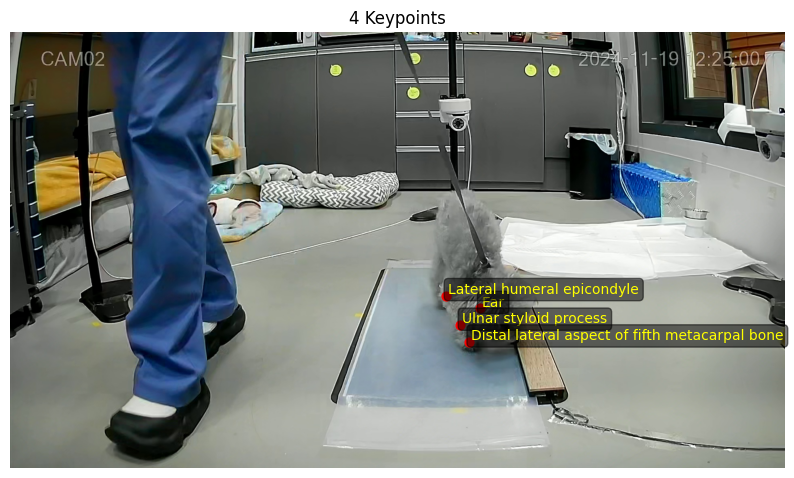


🖼️ 5개 keypoint 예시: heal_2024_10_21_12_18_05_00029.json


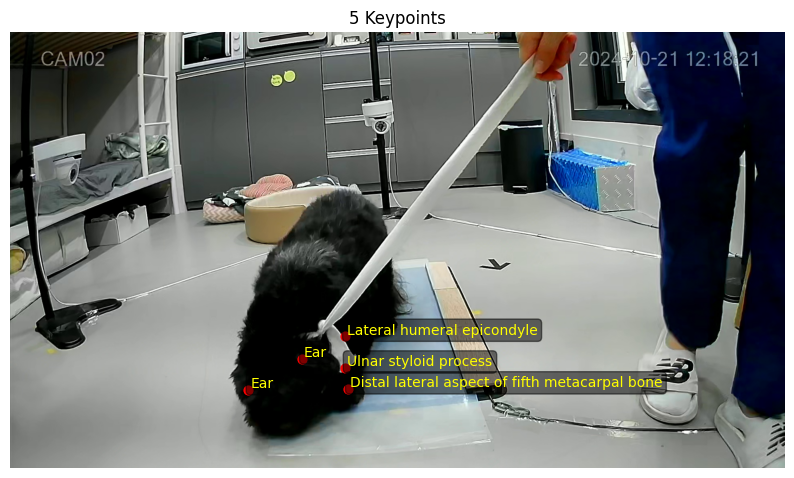


🖼️ 6개 keypoint 예시: SNC_2024_09_15_21_59_40_00055.json


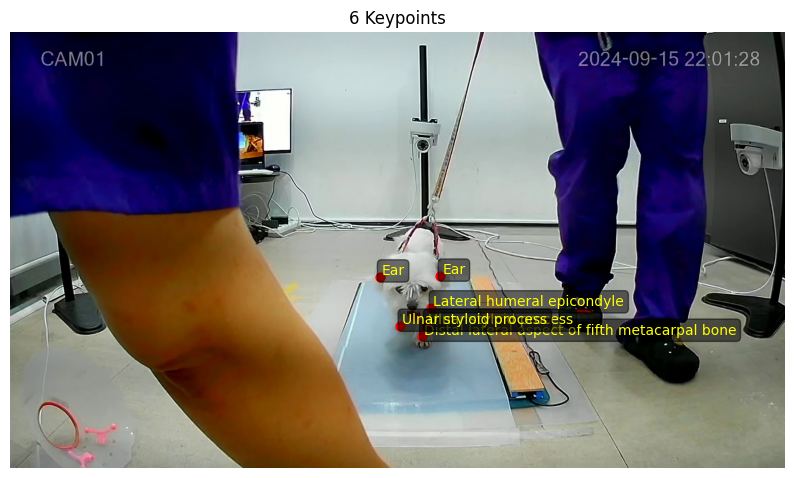


🖼️ 7개 keypoint 예시: jamsil_2024_10_03_15_59_25_00068.json


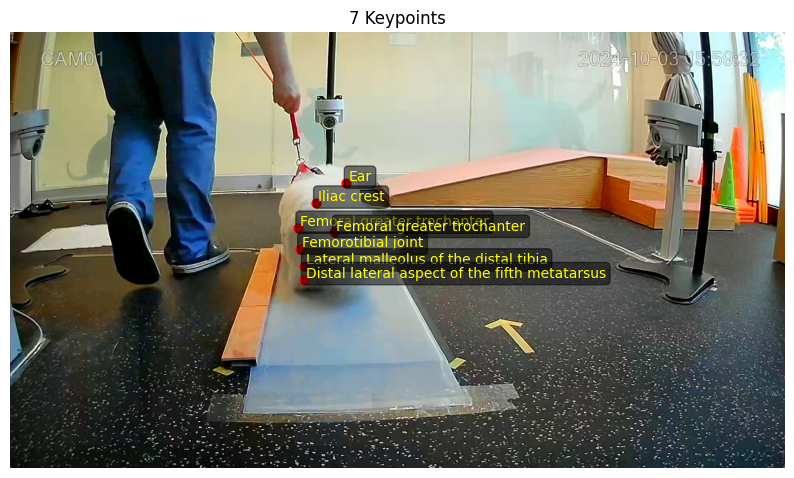


🖼️ 8개 keypoint 예시: SNC_2024_10_19_18_40_15_00088.json


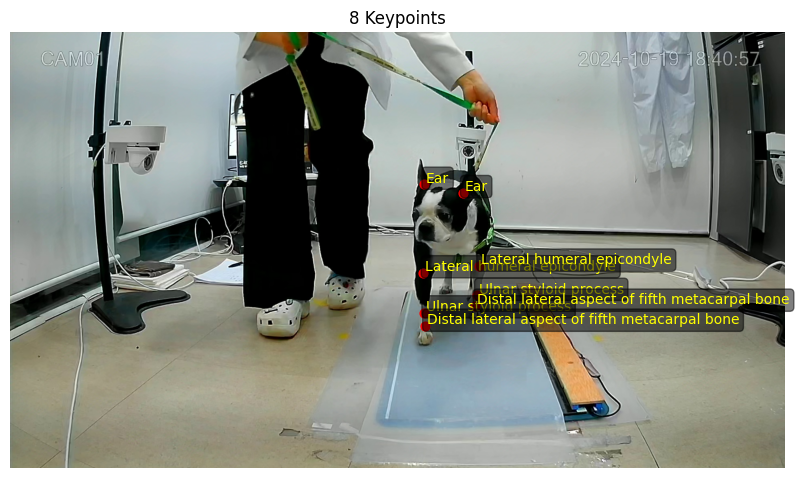


🖼️ 9개 keypoint 예시: SNC_2024_09_07_12_55_15_00016.json


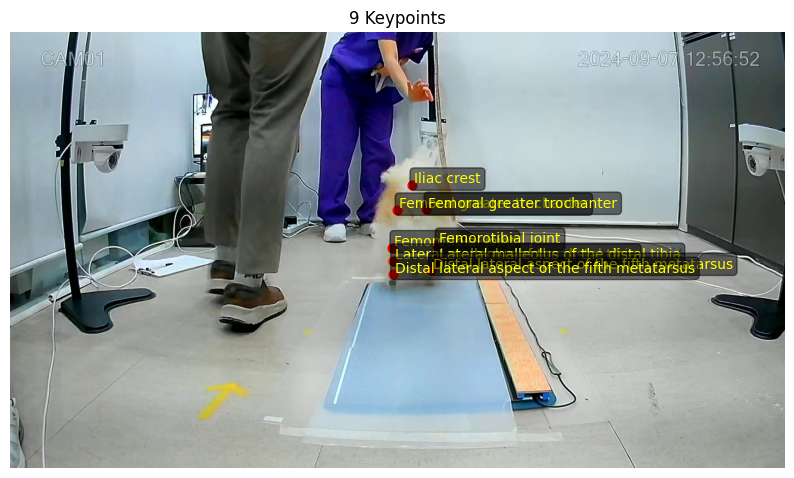


🖼️ 10개 keypoint 예시: heal_2024_10_10_15_39_35_00013.json


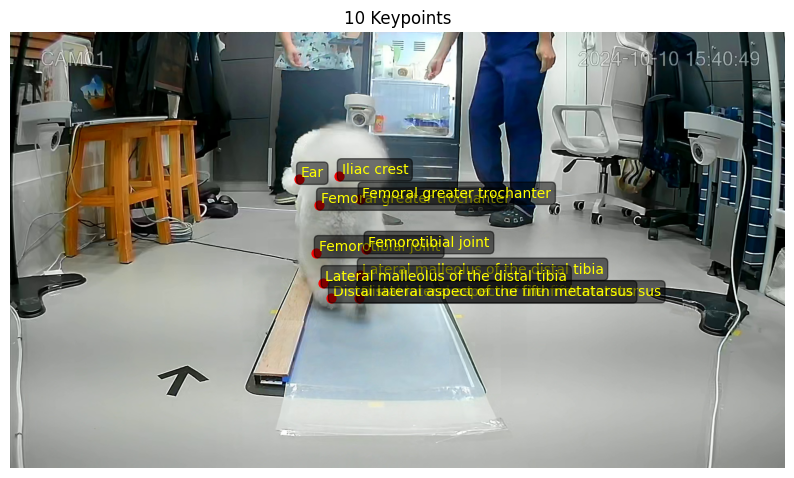


🖼️ 11개 keypoint 예시: SNC_2024_09_17_19_43_55_00027.json


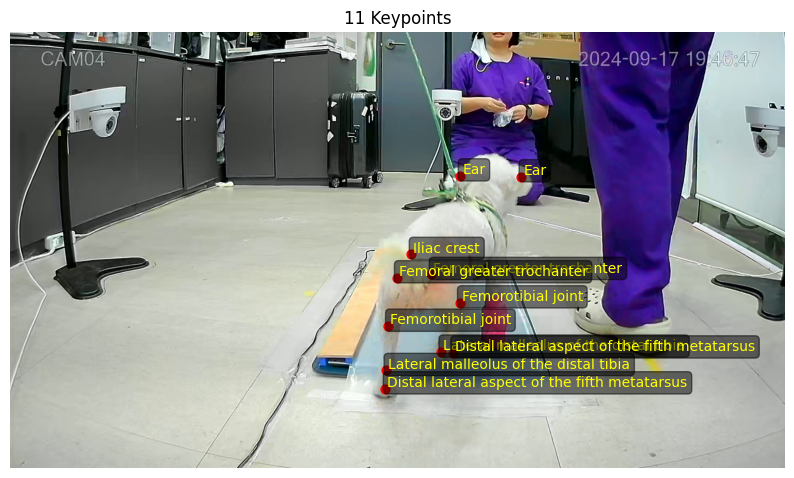


🖼️ 12개 keypoint 예시: SNC_2024_09_07_11_19_30_00480.json


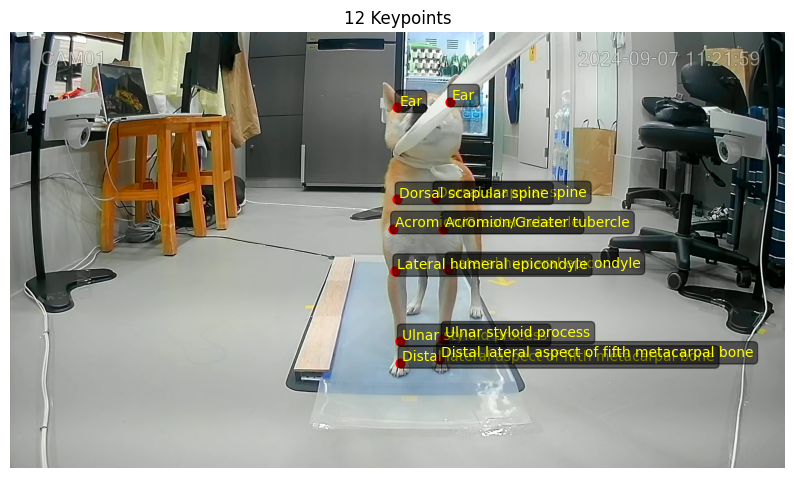


🖼️ 13개 keypoint 예시: jamsil_2024_11_30_11_10_03_00018.json


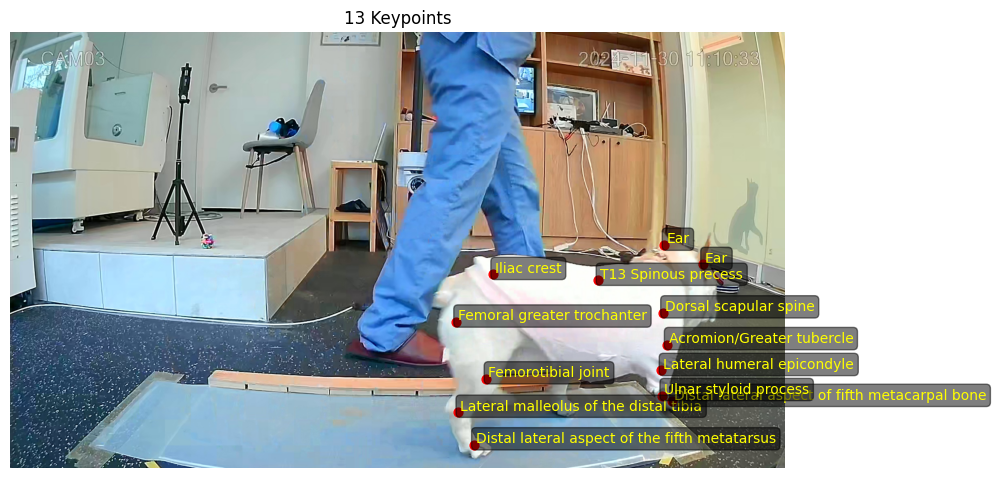

In [ ]:
import os
import json
import random
import cv2
import matplotlib.pyplot as plt
from collections import defaultdict
from pathlib import Path

# 🔹 JSON 파일 분류
keypoint_to_files = defaultdict(list)
for file_path in json_files:
    try:
        with open(file_path, "r", encoding="utf-8") as f:
            data = json.load(f)
        count = len(data.get("annotation_info", []))
        keypoint_to_files[count].append(file_path)
    except:
        continue

# 🔹 실제 이미지 경로들 (총 6개)
image_dirs = [
    "/content/drive/MyDrive/pet_angle/front/train_front",
    "/content/drive/MyDrive/pet_angle/add_front/add_front_train",
    "/content/drive/MyDrive/pet_angle/side/train_side",
    "/content/drive/MyDrive/pet_angle/add_side/add_side_train",
    "/content/drive/MyDrive/pet_angle/tail/train",
    "/content/drive/MyDrive/pet_angle/add_tail/add_tail_train"
]

# 🔹 시각화 함수
def visualize_keypoints(json_path):
    with open(json_path, "r", encoding="utf-8") as f:
        data = json.load(f)

    filename = data["image_info"]["filename"]
    image_filename = f"{filename}.jpg"

    # 실제 존재하는 이미지 경로 찾기
    image_path = None
    for dir_path in image_dirs:
        candidate = os.path.join(dir_path, image_filename)
        if os.path.exists(candidate):
            image_path = candidate
            break

    if image_path is None:
        print(f"⚠️ 이미지 경로 없음: {image_filename}")
        return

    # 이미지 로딩
    image = cv2.imread(image_path)
    if image is None:
        print(f"⚠️ 이미지 로딩 실패: {image_path}")
        return

    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    plt.axis("off")

    for kp in data.get("annotation_info", []):
        try:
            x = float(kp["x"]) * image.shape[1]
            y = float(kp["y"]) * image.shape[0]
            label = kp["label"]
            plt.scatter(x, y, c='red', s=40)
            plt.text(x+5, y-5, label, fontsize=10, color='yellow', bbox=dict(facecolor='black', alpha=0.5, boxstyle='round'))
            # plt.text(x + 5, y - 5, label, fontsize=10, ...)

        except Exception as e:
            print(f"⚠️ 시각화 오류: {e}")

    plt.title(f"{len(data['annotation_info'])} Keypoints")
    plt.show()

# 🔹 각 keypoint 개수별 예시 출력
target_counts = [4, 5, 6, 7, 8, 9, 10, 11, 12, 13]

for count in target_counts:
    files = keypoint_to_files.get(count)
    if files:
        sample = random.choice(files)
        print(f"\n🖼️ {count}개 keypoint 예시: {Path(sample).name}")
        visualize_keypoints(sample)
    else:
        print(f"\n❌ {count}개 keypoint를 가진 파일 없음")


## 2-4. 데이터 분할 준비 (훈련, 검증, 시험)

In [ ]:
# /content/drive/MyDrive/pet_angle

In [ ]:
!cp -r "/content/drive/MyDrive/pet_angle" "/content/drive/MyDrive/pet_angle_0804 복사본"

In [ ]:
# /content/drive/MyDrive/pet_angle_copy

In [ ]:
1. 라벨 데이터(json)
# 전
# /content/drive/MyDrive/pet_angle/front/label_front
# /content/drive/MyDrive/pet_angle/add_front/add_front_label

# 좌우
# /content/drive/MyDrive/pet_angle/add_side/add_side_label
# /content/drive/MyDrive/pet_angle/side/label_side

# 후
# /content/drive/MyDrive/pet_angle/add_tail/add_tail_label
# /content/drive/MyDrive/pet_angle/tail/label

2. 이미지 데이터(jpg)
# 전
/content/drive/MyDrive/pet_angle/add_front/add_front_train
/content/drive/MyDrive/pet_angle/front/train_front

# 좌우
/content/drive/MyDrive/pet_angle/add_side/add_side_train
/content/drive/MyDrive/pet_angle/side/train_side

# 후
/content/drive/MyDrive/pet_angle/tail/train
/content/drive/MyDrive/pet_angle/add_tail/add_tail_train

In [ ]:
# 현재 데이터 개수
원본(side) : 397장
추가(add_side) : 104장

원본(front) : 186장
추가(add_front) : 286장

원본(tail) : 203장
추가(add_tail) : 260장

=> 원본(side)를 제외한 나머지 원본(front)와 원본(tail)은 추가(add_front)와 추가(add_tail)의 개수가 훨씬 많았다.

In [ ]:
# 데이터 분할 - 내 생각 (최종)
그러면 side는 6:1.5:1.5 대비로 분할하고 add_side는 전부 train으로 넣고
front와 tail은 4:3:3으로 분할하되, add_front와 add_tail은 전부 train으로 넣으면 되잖아?

=> 훈련 데이터의 다양성을 고려하여 add_데이터를 train에만 포함시켜서 다양한 환경/각도/배경을 반영해서 학습을 시켰다.

평가의 신뢰도를 위해 오로지 원본 데이터만 사용하여 성능 평가의 왜곡을 방지했다.
또한 원본 데이터를 적절한 비율로 val/test에도 충분히 남겨서, 모델의 일반화 성능도 확보했다.

In [ ]:
# 육안으로 볼 수 있는 데이터 분할 개수

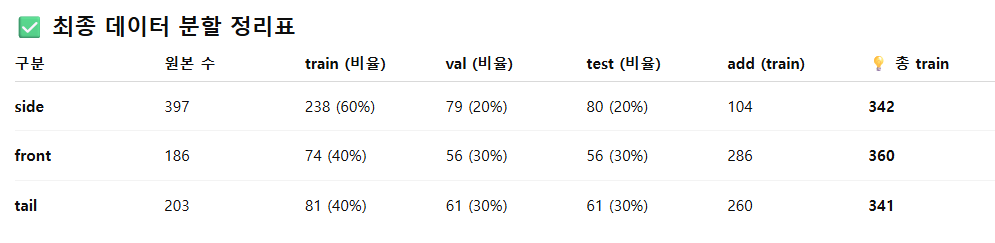

In [ ]:
import os
import random
import shutil
from pathlib import Path

# 상위 경로
base_path = Path("/content/drive/MyDrive/pet_angle_copy")

# 분할 기준 설정
data_config = {
    "side": {
        "original_img": base_path / "side/train_side",
        "original_json": base_path / "side/label_side",
        "add_img": base_path / "add_side/add_side_train",
        "add_json": base_path / "add_side/add_side_label",
        "split_ratio": [0.6, 0.2, 0.2]
    },
    "front": {
        "original_img": base_path / "front/train_front",
        "original_json": base_path / "front/label_front",
        "add_img": base_path / "add_front/add_front_train",
        "add_json": base_path / "add_front/add_front_label",
        "split_ratio": [0.4, 0.3, 0.3]
    },
    "tail": {
        "original_img": base_path / "tail/train",
        "original_json": base_path / "tail/label",
        "add_img": base_path / "add_tail/add_tail_train",
        "add_json": base_path / "add_tail/add_tail_label",
        "split_ratio": [0.4, 0.3, 0.3]
    }
}

# 저장할 최종 디렉토리
output_root = base_path / "dataset_split"

# train, val, test 폴더
splits = ["train", "val", "test"]

# 복사 함수
def copy_file(src, dst):
    dst.parent.mkdir(parents=True, exist_ok=True)
    shutil.copy2(src, dst)

# 분할 수행
for category, cfg in data_config.items():
    print(f"\n🔹 {category.upper()} 분할 중...")

    # 원본 데이터 목록 추출
    image_files = sorted(cfg["original_img"].glob("*.jpg"))
    base_names = [img.stem for img in image_files if (cfg["original_json"] / f"{img.stem}.json").exists()]
    random.seed(42)
    random.shuffle(base_names)

    total = len(base_names)
    n_train = int(total * cfg["split_ratio"][0])
    n_val = int(total * cfg["split_ratio"][1])
    n_test = total - n_train - n_val

    split_map = {
        "train": base_names[:n_train],
        "val": base_names[n_train:n_train + n_val],
        "test": base_names[n_train + n_val:]
    }

    # 원본 파일 복사
    for split in splits:
        for name in split_map[split]:
            img_src = cfg["original_img"] / f"{name}.jpg"
            json_src = cfg["original_json"] / f"{name}.json"
            img_dst = output_root / split / category / f"{name}.jpg"
            json_dst = output_root / split / category / f"{name}.json"

            copy_file(img_src, img_dst)
            copy_file(json_src, json_dst)

    # 추가(add_) 데이터는 train에만 포함
    add_image_files = sorted(cfg["add_img"].glob("*.jpg"))
    for img_path in add_image_files:
        stem = img_path.stem
        json_path = cfg["add_json"] / f"{stem}.json"
        if json_path.exists():
            img_dst = output_root / "train" / category / f"{stem}.jpg"
            json_dst = output_root / "train" / category / f"{stem}.json"
            copy_file(img_path, img_dst)
            copy_file(json_path, json_dst)

    print(f"✅ 분할 완료: train={len(split_map['train'])}+{len(add_image_files)}, val={len(split_map['val'])}, test={len(split_map['test'])}")


🔹 SIDE 분할 중...
✅ 분할 완료: train=238+104, val=79, test=80

🔹 FRONT 분할 중...
✅ 분할 완료: train=74+286, val=55, test=57

🔹 TAIL 분할 중...
✅ 분할 완료: train=81+260, val=60, test=62


In [ ]:
# 분할 결과 - 폴더 정리
/pet_angle_copy/dataset_split/
    ├── train/
    │   ├── side/
    │   ├── front/
    │   └── tail/
    ├── val/
    │   ├── side/
    │   ├── front/
    │   └── tail/
    └── test/
        ├── side/
        ├── front/
        └── tail/


In [ ]:
# 이미지와 json을 같은 위치에 저장한 코드 (아래 코드는 side, front,tail 이미지를 아예 통합하고, 그에 따른 json 라벨도 분리) => 나중에 전체 테스트용으로 사용하기

In [ ]:
import os
import shutil
from pathlib import Path

# 경로 설정
base_path = Path("/content/drive/MyDrive/pet_angle_copy/dataset_split")
splits = ["train", "val", "test"]
categories = ["side", "front", "tail"]

for split in splits:
    print(f"\n🔹 {split.upper()} 정리 중...")

    # 타겟 폴더 생성
    images_dir = base_path / split / "images"
    json_dir = base_path / split / "json_raw"
    images_dir.mkdir(parents=True, exist_ok=True)
    json_dir.mkdir(parents=True, exist_ok=True)

    for category in categories:
        category_path = base_path / split / category
        if not category_path.exists():
            continue

        for file in category_path.iterdir():
            if file.suffix == ".jpg":
                shutil.move(str(file), str(images_dir / file.name))
            elif file.suffix == ".json":
                shutil.move(str(file), str(json_dir / file.name))

        # 정리 후 빈 폴더 제거
        try:
            category_path.rmdir()
        except OSError:
            pass  # 비어있지 않으면 무시

    print(f"✅ {split} 정리 완료: 이미지 → images/, JSON → json_raw/")


In [ ]:
# 각 사진별로 train,val,test > 이미지와 라벨 분리하기 (dataset_split2)

In [ ]:
pet_angle_copy/dataset_split/
    ├── train/
    │   ├── side_image/
    │   ├── side_label/
    │   ├── front_image/
    │   ├── front_label/
    │   ├── tail_image/
    │   └── tail_label/
    ├── val/
    │   ├── side_image/
    │   ├── side_label/
    │   ├── front_image/
    │   ├── front_label/
    │   ├── tail_image/
    │   └── tail_label/
    └── test/
        ├── side_image/
        ├── side_label/
        ├── front_image/
        ├── front_label/
        ├── tail_image/
        └── tail_label/


In [ ]:
import os
import random
import shutil
from pathlib import Path

# 상위 경로
base_path = Path("/content/drive/MyDrive/pet_angle_copy")

# 분할 기준 설정
data_config = {
    "side": {
        "original_img": base_path / "side/train_side",
        "original_json": base_path / "side/label_side",
        "add_img": base_path / "add_side/add_side_train",
        "add_json": base_path / "add_side/add_side_label",
        "split_ratio": [0.6, 0.2, 0.2]
    },
    "front": {
        "original_img": base_path / "front/train_front",
        "original_json": base_path / "front/label_front",
        "add_img": base_path / "add_front/add_front_train",
        "add_json": base_path / "add_front/add_front_label",
        "split_ratio": [0.4, 0.3, 0.3]
    },
    "tail": {
        "original_img": base_path / "tail/train",
        "original_json": base_path / "tail/label",
        "add_img": base_path / "add_tail/add_tail_train",
        "add_json": base_path / "add_tail/add_tail_label",
        "split_ratio": [0.4, 0.3, 0.3]
    }
}

# 저장할 최종 디렉토리
output_root = base_path / "dataset_split2"
splits = ["train", "val", "test"]

# 복사 함수
def copy_file(src, dst):
    dst.parent.mkdir(parents=True, exist_ok=True)
    shutil.copy2(src, dst)

# 분할 수행
for category, cfg in data_config.items():
    print(f"\n🔹 {category.upper()} 분할 중...")

    image_files = sorted(cfg["original_img"].glob("*.jpg"))
    base_names = [img.stem for img in image_files if (cfg["original_json"] / f"{img.stem}.json").exists()]
    random.seed(42)
    random.shuffle(base_names)

    total = len(base_names)
    n_train = int(total * cfg["split_ratio"][0])
    n_val = int(total * cfg["split_ratio"][1])
    n_test = total - n_train - n_val

    split_map = {
        "train": base_names[:n_train],
        "val": base_names[n_train:n_train + n_val],
        "test": base_names[n_train + n_val:]
    }

    # 원본 데이터 복사
    for split in splits:
        for name in split_map[split]:
            img_src = cfg["original_img"] / f"{name}.jpg"
            json_src = cfg["original_json"] / f"{name}.json"

            img_dst = output_root / split / f"{category}_image" / f"{name}.jpg"
            json_dst = output_root / split / f"{category}_label" / f"{name}.json"

            copy_file(img_src, img_dst)
            copy_file(json_src, json_dst)

    # 추가 데이터는 train에만
    add_image_files = sorted(cfg["add_img"].glob("*.jpg"))
    for img_path in add_image_files:
        stem = img_path.stem
        json_path = cfg["add_json"] / f"{stem}.json"
        if json_path.exists():
            img_dst = output_root / "train" / f"{category}_image" / f"{stem}.jpg"
            json_dst = output_root / "train" / f"{category}_label" / f"{stem}.json"
            copy_file(img_path, img_dst)
            copy_file(json_path, json_dst)

    print(f"✅ {category.upper()} 완료: train={len(split_map['train'])}+{len(add_image_files)}, val={len(split_map['val'])}, test={len(split_map['test'])}")



🔹 SIDE 분할 중...
✅ SIDE 완료: train=238+104, val=79, test=80

🔹 FRONT 분할 중...
✅ FRONT 완료: train=74+286, val=55, test=57

🔹 TAIL 분할 중...
✅ TAIL 완료: train=81+260, val=60, test=62


## 2-5. Yolo를 위한 txt 파일 준비

In [ ]:
# KEYPOINT 기반으로 BBOX 추론 및 생성해서 TXT 파일 만든다.
# TRAIN에는 X,Y,V에서의 V를 2.0으로 생성한다.
# 단, VALID에는 V를 1.0으로 생성해줘야한다.

In [ ]:
### 0804 저녁 yolo 모델 학습 중 깨달은 사실 ###
side와 front, tail 중 keypoint개수 count해서 학습 잘 되게 하기
그리고 각 txt 파일이 이미지와 매핑이 되는지 확인

In [ ]:
# [코랩용] 랜덤 JSON + 이미지 1개 시각화 테스트 코드

📂 시각화 대상: jamsil_2024_10_23_14_08_41_00004.jpg


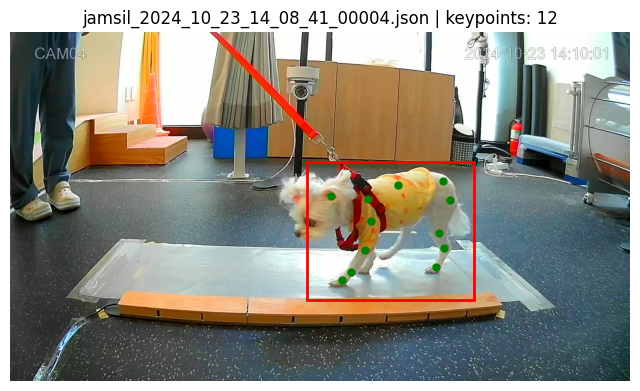

In [ ]:
import json
import cv2
import random
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from pathlib import Path

# ✅ YOLO keypoint 순서
KEYPOINT_ORDER = [
    "Ear",
    "Distal lateral aspect of fifth metacarpal bone",
    "Ulnar styloid process",
    "Lateral humeral epicondyle",
    "Distal lateral aspect of the fifth metatarsus",
    "Femoral greater trochanter",
    "Lateral malleolus of the distal tibia",
    "Femorotibial joint",
    "Iliac crest",
    "Acromion/Greater tubercle",
    "Dorsal scapular spine",
    "T13 Spinous precess"
]

# ✅ bbox 자동 계산
def compute_bbox_from_keypoints(kps, scale=1.2):
    xs = [kps[i] for i in range(0, len(kps), 3) if kps[i+2] > 0]
    ys = [kps[i+1] for i in range(0, len(kps), 3) if kps[i+2] > 0]
    if not xs or not ys:
        return 0, 0, 0, 0
    x_min, x_max = min(xs), max(xs)
    y_min, y_max = min(ys), max(ys)
    x_center = (x_min + x_max) / 2
    y_center = (y_min + y_max) / 2
    width = (x_max - x_min) * scale
    height = (y_max - y_min) * scale
    return x_center, y_center, width, height

# ✅ 시각화 함수
def visualize_from_json(json_path, image_path, scale=1.2, v_value=2):
    with open(json_path, encoding="utf-8") as f:
        data = json.load(f)

    # keypoint 수집
    label_to_coords = {}
    for ann in data.get("annotation_info", []):
        label = ann["label"]
        x = float(ann["x"])
        y = float(ann["y"])
        if label not in label_to_coords:
            label_to_coords[label] = (x, y)

    keypoints = []
    for label in KEYPOINT_ORDER:
        if label in label_to_coords:
            x, y = label_to_coords[label]
            v = v_value  # train=2, val=1
        else:
            x, y, v = 0.0, 0.0, 0
        keypoints.extend([x, y, v])

    # bbox 계산
    bbox = compute_bbox_from_keypoints(keypoints, scale=scale)

    # 이미지 시각화
    image = cv2.imread(str(image_path))
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    h, w, _ = image.shape

    fig, ax = plt.subplots(figsize=(8, 8))
    ax.imshow(image)

    # bbox
    x_center, y_center, width, height = bbox
    x_center *= w
    y_center *= h
    width *= w
    height *= h
    x_min = x_center - width / 2
    y_min = y_center - height / 2
    rect = patches.Rectangle((x_min, y_min), width, height,
                             linewidth=2, edgecolor='red', facecolor='none')
    ax.add_patch(rect)

    # keypoints
    for i in range(0, len(keypoints), 3):
        x, y, v = keypoints[i], keypoints[i+1], keypoints[i+2]
        if v > 0:
            ax.plot(x * w, y * h, 'go', markersize=5)

    plt.title(f"{Path(json_path).name} | keypoints: {len(keypoints)//3}")
    plt.axis('off')
    plt.show()

# ✅ 랜덤 시각화 실행 함수
def random_visualize(dataset_split="train", category="side", base_path="/content/drive/MyDrive/pet_angle_copy/dataset_split2", v_value=2):
    label_dir = Path(base_path) / dataset_split / f"{category}_label"
    image_dir = Path(base_path) / dataset_split / f"{category}_image"

    json_list = sorted(label_dir.glob("*.json"))
    if not json_list:
        print(f"❌ No JSON files in {label_dir}")
        return

    sample_json = random.choice(json_list)
    sample_img = image_dir / f"{sample_json.stem}.jpg"

    if not sample_img.exists():
        print(f"❌ Image not found: {sample_img}")
        return

    print(f"📂 시각화 대상: {sample_img.name}")
    visualize_from_json(sample_json, sample_img, scale=1.4, v_value=v_value)

# ✅ 사용 예시
random_visualize(dataset_split="train", category="side", v_value=2)  # train용
# random_visualize(dataset_split="val", category="front", v_value=1)  # val용


# 2-5.1. 0806 저녁 test 후 tail과 front는 txt 파일 다시 준비(bbox의 크기 문제)

In [ ]:
import yaml

# YAML 파일 경로 리스트
yaml_paths = [
    "/content/drive/MyDrive/pet_angle_copy/dataset_split2/front.yaml",
    "/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail.yaml"
]

# YAML 파일 읽기 함수
def load_yaml(path):
    with open(path, 'r') as f:
        data = yaml.safe_load(f)
    print(f"\n📄 {path} 내용:")
    print("-" * 50)
    for key, value in data.items():
        print(f"{key}: {value}")

# 모든 YAML 파일 읽기
for path in yaml_paths:
    load_yaml(path)



📄 /content/drive/MyDrive/pet_angle_copy/dataset_split2/front.yaml 내용:
--------------------------------------------------
path: /content/drive/MyDrive/pet_angle_copy/dataset_split2
train: train/front_image
val: val/front_image
nc: 2
names: ['소형견', '중형견']
kpt_shape: [12, 3]
flip_idx: [0, 4, 6, 5, 1, 3, 2, 8, 7, 10, 9, 11]

📄 /content/drive/MyDrive/pet_angle_copy/dataset_split2/tail.yaml 내용:
--------------------------------------------------
path: /content/drive/MyDrive/pet_angle_copy/dataset_split2
train: train/tail_image
val: val/tail_image
nc: 2
names: ['소형견', '중형견']
kpt_shape: [12, 3]
flip_idx: [0, 4, 6, 5, 1, 3, 2, 8, 7, 10, 9, 11]


In [ ]:
/content/drive/MyDrive/pet_angle_copy/dataset_split2/train/front_image
/content/drive/MyDrive/pet_angle_copy/dataset_split2/val/front_image

/content/drive/MyDrive/pet_angle_copy/dataset_split2/train/tail_image
/content/drive/MyDrive/pet_angle_copy/dataset_split2/val/tail_image


In [ ]:
# 문제가 있는 txt 파일 전부 삭제
import os
import glob

# 삭제 대상 디렉토리 목록
dirs = [
    "/content/drive/MyDrive/pet_angle_copy/dataset_split2/train/front_image",
    "/content/drive/MyDrive/pet_angle_copy/dataset_split2/val/front_image",
    "/content/drive/MyDrive/pet_angle_copy/dataset_split2/train/tail_image",
    "/content/drive/MyDrive/pet_angle_copy/dataset_split2/val/tail_image"
]

# 각 디렉토리 내 txt 파일 삭제
for directory in dirs:
    txt_files = glob.glob(os.path.join(directory, "*.txt"))
    for file in txt_files:
        try:
            os.remove(file)
            print(f"🗑️ 삭제됨: {file}")
        except Exception as e:
            print(f"⚠️ 삭제 실패: {file} ({e})")


🗑️ 삭제됨: /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/front_image/heal_2024_09_05_17_31_30_00073.txt
🗑️ 삭제됨: /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/front_image/heal_2024_09_05_17_31_30_00082.txt
🗑️ 삭제됨: /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/front_image/heal_2024_09_10_10_56_00_00112.txt
🗑️ 삭제됨: /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/front_image/heal_2024_09_12_14_23_29_00198.txt
🗑️ 삭제됨: /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/front_image/heal_2024_09_12_14_23_29_00425.txt
🗑️ 삭제됨: /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/front_image/heal_2024_09_14_14_03_10_00001.txt
🗑️ 삭제됨: /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/front_image/heal_2024_09_14_14_55_20_00020.txt
🗑️ 삭제됨: /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/front_image/heal_2024_09_19_12_43_52_00005.txt
🗑️ 삭제됨: /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/front_image/heal_2024

In [ ]:
import os
from collections import Counter

# 확인할 디렉토리 목록
dirs = [
    "/content/drive/MyDrive/pet_angle_copy/dataset_split2/train/front_image",
    "/content/drive/MyDrive/pet_angle_copy/dataset_split2/val/front_image",
    "/content/drive/MyDrive/pet_angle_copy/dataset_split2/train/tail_image",
    "/content/drive/MyDrive/pet_angle_copy/dataset_split2/val/tail_image"
]

# 디렉토리별 확장자 확인
for directory in dirs:
    ext_counter = Counter()
    if not os.path.exists(directory):
        print(f"❌ 경로 없음: {directory}")
        continue

    for filename in os.listdir(directory):
        if os.path.isfile(os.path.join(directory, filename)):
            ext = os.path.splitext(filename)[1].lower()  # .jpg, .txt 등
            ext_counter[ext] += 1

    print(f"\n📁 {directory} 의 확장자 목록:")
    if ext_counter:
        for ext, count in ext_counter.items():
            print(f"  - {ext}: {count}개")
    else:
        print("  (파일 없음)")



📁 /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/front_image 의 확장자 목록:
  - .jpg: 287개

📁 /content/drive/MyDrive/pet_angle_copy/dataset_split2/val/front_image 의 확장자 목록:
  - .jpg: 55개

📁 /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/tail_image 의 확장자 목록:
  - .jpg: 262개

📁 /content/drive/MyDrive/pet_angle_copy/dataset_split2/val/tail_image 의 확장자 목록:
  - .jpg: 60개


In [ ]:
import cv2
import matplotlib.pyplot as plt
from pathlib import Path
import json

KEYPOINT_ORDER = [
    "Ear",
    "Distal lateral aspect of fifth metacarpal bone",
    "Ulnar styloid process",
    "Lateral humeral epicondyle",
    "Distal lateral aspect of the fifth metatarsus",
    "Femoral greater trochanter",
    "Lateral malleolus of the distal tibia",
    "Femorotibial joint",
    "Iliac crest",
    "Acromion/Greater tubercle",
    "Dorsal scapular spine",
    "T13 Spinous precess"
]

def compute_bbox_from_keypoints(kps, scale=1.2):
    xs = [kps[i] for i in range(0, len(kps), 3) if kps[i+2] > 0]
    ys = [kps[i+1] for i in range(0, len(kps), 3) if kps[i+2] > 0]
    if not xs or not ys:
        return 0, 0, 0, 0
    x_min, x_max = min(xs), max(xs)
    y_min, y_max = min(ys), max(ys)
    x_center = (x_min + x_max) / 2
    y_center = (y_min + y_max) / 2
    width = (x_max - x_min) * scale
    height = (y_max - y_min) * scale
    return x_center, y_center, width, height

def visualize_keypoints_and_bbox(image_path, keypoints, bbox):
    img = cv2.imread(str(image_path))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    h, w, _ = img.shape

    # keypoints
    for i in range(0, len(keypoints), 3):
        x, y, v = keypoints[i:i+3]
        if v > 0:
            px = int(x * w)
            py = int(y * h)
            cv2.circle(img, (px, py), 4, (0, 255, 0), -1)

    # bbox
    x_center, y_center, bw, bh = bbox
    x_center *= w
    y_center *= h
    bw *= w
    bh *= h
    x1 = int(x_center - bw / 2)
    y1 = int(y_center - bh / 2)
    x2 = int(x_center + bw / 2)
    y2 = int(y_center + bh / 2)
    cv2.rectangle(img, (x1, y1), (x2, y2), (255, 0, 0), 2)

    # plot
    plt.figure(figsize=(6,6))
    plt.imshow(img)
    plt.axis('off')
    plt.title("Keypoints + Bounding Box")
    plt.show()

def preview_sample(category="front", split="train", scale=1.4, sample_idx=0):
    base_path = Path("/content/drive/MyDrive/pet_angle_copy/dataset_split2")
    img_dir = base_path / split / f"{category}_image"
    json_dir = base_path / split / f"{category}_label"

    json_paths = sorted(json_dir.glob("*.json"))
    json_path = json_paths[sample_idx]
    image_path = img_dir / f"{json_path.stem}.jpg"

    with open(json_path, encoding="utf-8") as f:
        data = json.load(f)

    label_to_coords = {}
    for ann in data.get("annotation_info", []):
        label = ann["label"]
        x = float(ann["x"])  # 정규화된 x
        y = float(ann["y"])  # 정규화된 y
        if label not in label_to_coords:
            label_to_coords[label] = (x, y)

    keypoints = []
    for label in KEYPOINT_ORDER:
        if label in label_to_coords:
            x, y = label_to_coords[label]
            v = 2.0 if split == "train" else 1.0
        else:
            x, y, v = 0.0, 0.0, 0.0
        keypoints.extend([x, y, v])

    bbox = compute_bbox_from_keypoints(keypoints, scale=scale)
    print(f"📌 {category} / {split} / {json_path.name} | bbox: {bbox}")
    visualize_keypoints_and_bbox(image_path, keypoints, bbox)


📌 front / train / SNC_2024_09_05_17_11_10_00014.json | bbox: (0.5378605769230769, 0.5901442307692308, 0.021875, 0.23221153846153855)


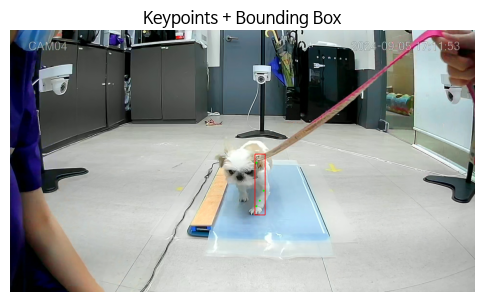

📌 tail / val / SNC_2024_09_28_16_59_00_00385.json | bbox: (0.5177033492822967, 0.44348659003831414, 0.0482296650717704, 0.2547892720306513)


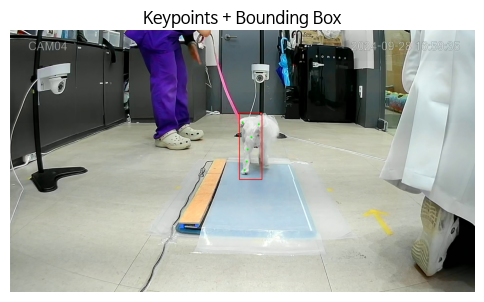

In [ ]:
# front 카테고리에서 bbox 1.4 배 확장하여 0번째 샘플 시각화
preview_sample(category="front", split="train", scale=1.4, sample_idx=0)

# tail 카테고리에서도 시각화
preview_sample(category="tail", split="val", scale=1.4, sample_idx=1)


In [ ]:
# 시각화 느낀점
front와 tail 같은 경우 keypoint 기반으로 bbox 생성하지만, 특정 위치에 keypoint가 매몰되어있는 경우가 많아서 bbox 크기를 많이 키워줘야해
주로 keypoint가 세로 위주의 직선 방향으로 퍼져있는 경우가 있어서 keypoint기반으로 bbox 생성할 때, 가로 비율도 고려해서 만들어줬으면 좋겠어
아니 keypoint기반으로 bbox 생성하는데, 한 사진의 객체 사진(강아지)에 따라 조정해줘야하는데, 어떤 건 너무 작고, 어떤 건 너무 커서 강아지와 다른 사물들도 같이 담거나 어떤 건 너무 작아서 강아지의 특정부분만 담아...

In [ ]:
✅ 이 문제의 핵심 원인
keypoint는 강아지의 중심을 대표하지 않을 수 있음
→ 즉, keypoint만으로는 강아지 전체를 포함하는 bbox를 만들기 어려움

✅ 해결 전략: keypoint + 이미지 context 기반으로 bbox 생성 보정

In [ ]:
✅ 3. (고급) YOLO object detector (예: YOLOv8)로 강아지 객체 먼저 탐지 → bbox로 활용
기존의 pose 모델 이전에 강아지 전체를 감싸는 bbox를 YOLO로 먼저 탐지

이 bbox 안에서 keypoint 기반 pose 분석 수행 → 완벽히 안정적

단점: YOLO object detector도 학습시켜야 하므로 프로젝트 규모 커짐

In [ ]:
import cv2
import matplotlib.pyplot as plt
from pathlib import Path
import json
import random

KEYPOINT_ORDER = [
    "Ear",
    "Distal lateral aspect of fifth metacarpal bone",
    "Ulnar styloid process",
    "Lateral humeral epicondyle",
    "Distal lateral aspect of the fifth metatarsus",
    "Femoral greater trochanter",
    "Lateral malleolus of the distal tibia",
    "Femorotibial joint",
    "Iliac crest",
    "Acromion/Greater tubercle",
    "Dorsal scapular spine",
    "T13 Spinous precess"
]

def compute_bbox_from_keypoints_with_ratio(kps, scale=1.0, aspect_ratio_thresh=2.0, min_aspect_ratio=0.8):
    xs = [kps[i] for i in range(0, len(kps), 3) if kps[i+2] > 0]
    ys = [kps[i+1] for i in range(0, len(kps), 3) if kps[i+2] > 0]

    if not xs or not ys:
        return 0, 0, 0, 0

    x_min, x_max = min(xs), max(xs)
    y_min, y_max = min(ys), max(ys)
    x_center = (x_min + x_max) / 2
    y_center = (y_min + y_max) / 2
    width = (x_max - x_min)
    height = (y_max - y_min)

    aspect_ratio = height / width if width > 0 else float('inf')
    if aspect_ratio > aspect_ratio_thresh:
        width = height / min_aspect_ratio

    width *= scale
    height *= scale

    # ✅ 경계 클리핑: YOLO 형식에서 width, height는 최대 1.0이어야 함
    width = min(width, 1.0)
    height = min(height, 1.0)

    # ✅ center도 경계를 벗어나면 clip
    x_center = max(0.0, min(x_center, 1.0))
    y_center = max(0.0, min(y_center, 1.0))

    return x_center, y_center, width, height


def visualize_keypoints_and_bbox(image_path, keypoints, bbox):
    img = cv2.imread(str(image_path))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    h, w, _ = img.shape

    for i in range(0, len(keypoints), 3):
        x, y, v = keypoints[i:i+3]
        if v > 0:
            px = int(x * w)
            py = int(y * h)
            cv2.circle(img, (px, py), 4, (0, 255, 0), -1)

    x_center, y_center, bw, bh = bbox
    x_center *= w
    y_center *= h
    bw *= w
    bh *= h
    x1 = int(x_center - bw / 2)
    y1 = int(y_center - bh / 2)
    x2 = int(x_center + bw / 2)
    y2 = int(y_center + bh / 2)
    cv2.rectangle(img, (x1, y1), (x2, y2), (255, 0, 0), 2)

    plt.figure(figsize=(6, 6))
    plt.imshow(img)
    plt.axis('off')
    plt.title("Keypoints + Bounding Box")
    plt.show()

def preview_sample(category="front", split="train", sample_count=3):
    # 자동 scale 적용
    scale = scale_by_category.get(category, 1.2)

    base_path = Path("/content/drive/MyDrive/pet_angle_copy/dataset_split2")
    img_dir = base_path / split / f"{category}_image"
    json_dir = base_path / split / f"{category}_label"

    json_paths = sorted(json_dir.glob("*.json"))
    if not json_paths:
        print("❌ JSON 파일이 없습니다.")
        return

    selected_paths = random.sample(json_paths, min(sample_count, len(json_paths)))

    for json_path in selected_paths:
        image_path = img_dir / f"{json_path.stem}.jpg"
        if not image_path.exists():
            print(f"⚠️ 이미지 없음: {image_path.name}")
            continue

        with open(json_path, encoding="utf-8") as f:
            data = json.load(f)

        label_to_coords = {}
        for ann in data.get("annotation_info", []):
            label = ann["label"]
            x = float(ann["x"])
            y = float(ann["y"])
            label_to_coords[label] = (x, y)

        keypoints = []
        for label in KEYPOINT_ORDER:
            if label in label_to_coords:
                x, y = label_to_coords[label]
                v = 2.0 if split == "train" else 1.0
            else:
                x, y, v = 0.0, 0.0, 0.0
            keypoints.extend([x, y, v])

        bbox = compute_bbox_from_keypoints_with_ratio(keypoints, scale=scale)

        print(f"📌 {category} / {split} / {json_path.name} | bbox: {bbox}")
        visualize_keypoints_and_bbox(image_path, keypoints, bbox)


📌 front / train / SNC_2024_10_07_13_33_20_00120.json | bbox: (0.6519774011299435, 0.7194570135746606, 0.42647058823529405, 0.34117647058823525)


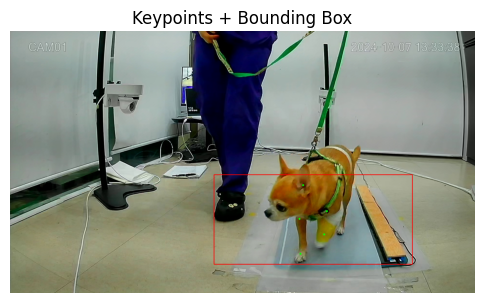

📌 front / train / jamsil_2024_09_14_11_31_30_00047.json | bbox: (0.5206896551724138, 0.569060773480663, 0.9426795580110496, 0.7541436464088398)


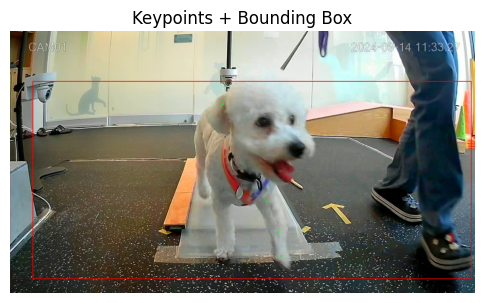

📌 front / train / heal_2024_10_06_10_30_00_00008.json | bbox: (0.47942583732057414, 0.5268199233716475, 0.1368421052631579, 0.12452107279693483)


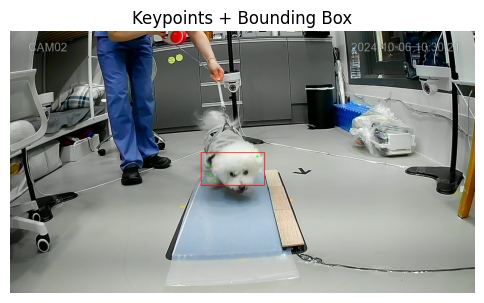

📌 tail / val / jamsil_2024_10_01_14_55_30_00090.json | bbox: (0.43301435406698563, 0.45689655172413796, 0.31345785440613033, 0.25076628352490427)


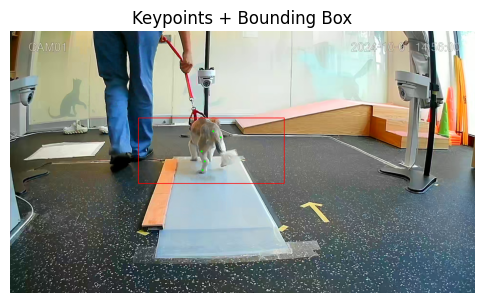

📌 tail / val / heal_2024_11_08_14_39_45_00717.json | bbox: (0.5722488038277511, 0.49137931034482757, 0.9647988505747124, 0.77183908045977)


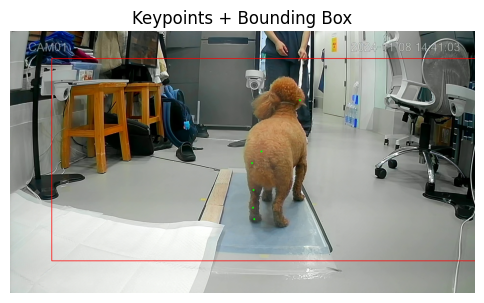

In [ ]:
preview_sample(category="front", split="train", sample_count=3)
preview_sample(category="tail", split="val", sample_count=2)


In [ ]:
# 위의 강아지 객체 탐지를 하는 bbox가 제대로 작동을 하지 않아 다시 수행(해결 전략)

In [ ]:
import cv2
import matplotlib.pyplot as plt
from pathlib import Path
import json
import random

# ✅ keypoint 순서
KEYPOINT_ORDER = [
    "Ear",
    "Distal lateral aspect of fifth metacarpal bone",
    "Ulnar styloid process",
    "Lateral humeral epicondyle",
    "Distal lateral aspect of the fifth metatarsus",
    "Femoral greater trochanter",
    "Lateral malleolus of the distal tibia",
    "Femorotibial joint",
    "Iliac crest",
    "Acromion/Greater tubercle",
    "Dorsal scapular spine",
    "T13 Spinous precess"
]

# ✅ keypoint 간 거리 기반으로 scale 자동 계산
def compute_adaptive_scale(kps):
    xs = [kps[i] for i in range(0, len(kps), 3) if kps[i+2] > 0]
    ys = [kps[i+1] for i in range(0, len(kps), 3) if kps[i+2] > 0]
    if len(xs) < 2:
        return 1.2

    max_dist = max([((xs[i]-xs[j])**2 + (ys[i]-ys[j])**2)**0.5 for i in range(len(xs)) for j in range(i+1, len(xs))])

    if max_dist < 0.1:
        return 2.8
    elif max_dist < 0.2:
        return 2.0
    else:
        return 1.2

# ✅ bbox 생성: adaptive scale + clip 적용
def compute_refined_bbox_from_keypoints(kps, min_size=0.3, max_size=0.8):
    xs = [kps[i] for i in range(0, len(kps), 3) if kps[i+2] > 0]
    ys = [kps[i+1] for i in range(0, len(kps), 3) if kps[i+2] > 0]

    if not xs or not ys:
        return 0, 0, 0, 0

    x_min, x_max = min(xs), max(xs)
    y_min, y_max = min(ys), max(ys)
    x_center = (x_min + x_max) / 2
    y_center = (y_min + y_max) / 2

    width = x_max - x_min
    height = y_max - y_min

    # ✅ adaptive scale
    scale = compute_adaptive_scale(kps)
    width *= scale
    height *= scale

    # ✅ bbox 크기 제한
    width = min(max(width, min_size), max_size)
    height = min(max(height, min_size), max_size)

    # ✅ 중심 clip
    x_center = max(0.0, min(x_center, 1.0))
    y_center = max(0.0, min(y_center, 1.0))

    return x_center, y_center, width, height

# ✅ 시각화 함수
def visualize_keypoints_and_bbox(image_path, keypoints, bbox):
    img = cv2.imread(str(image_path))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    h, w, _ = img.shape

    for i in range(0, len(keypoints), 3):
        x, y, v = keypoints[i:i+3]
        if v > 0:
            px = int(x * w)
            py = int(y * h)
            cv2.circle(img, (px, py), 4, (0, 255, 0), -1)

    x_center, y_center, bw, bh = bbox
    x_center *= w
    y_center *= h
    bw *= w
    bh *= h
    x1 = int(x_center - bw / 2)
    y1 = int(y_center - bh / 2)
    x2 = int(x_center + bw / 2)
    y2 = int(y_center + bh / 2)
    cv2.rectangle(img, (x1, y1), (x2, y2), (255, 0, 0), 2)

    plt.figure(figsize=(6, 6))
    plt.imshow(img)
    plt.axis('off')
    plt.title("Keypoints + Refined BBox")
    plt.show()

# ✅ 랜덤 샘플 시각화 함수
def preview_sample(category="front", split="train", sample_count=3):
    base_path = Path("/content/drive/MyDrive/pet_angle_copy/dataset_split2")
    img_dir = base_path / split / f"{category}_image"
    json_dir = base_path / split / f"{category}_label"

    json_paths = sorted(json_dir.glob("*.json"))
    if not json_paths:
        print("❌ JSON 파일이 없습니다.")
        return

    selected_paths = random.sample(json_paths, min(sample_count, len(json_paths)))

    for json_path in selected_paths:
        image_path = img_dir / f"{json_path.stem}.jpg"
        if not image_path.exists():
            print(f"⚠️ 이미지 없음: {image_path.name}")
            continue

        with open(json_path, encoding="utf-8") as f:
            data = json.load(f)

        label_to_coords = {}
        for ann in data.get("annotation_info", []):
            label = ann["label"]
            x = float(ann["x"])
            y = float(ann["y"])
            label_to_coords[label] = (x, y)

        keypoints = []
        for label in KEYPOINT_ORDER:
            if label in label_to_coords:
                x, y = label_to_coords[label]
                v = 2.0 if split == "train" else 1.0
            else:
                x, y, v = 0.0, 0.0, 0.0
            keypoints.extend([x, y, v])

        bbox = compute_refined_bbox_from_keypoints(keypoints)
        print(f"📌 {category} / {split} / {json_path.name} | bbox: {bbox}")
        visualize_keypoints_and_bbox(image_path, keypoints, bbox)


📌 front / train / heal_2024_11_01_16_57_15_00015.json | bbox: (0.42966507177033497, 0.48563218390804597, 0.3, 0.3639846743295019)


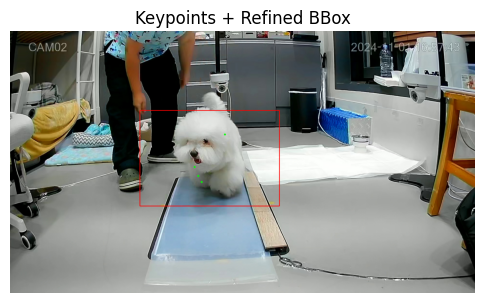

📌 front / train / heal_2024_11_07_15_15_20_00014.json | bbox: (0.34114832535885165, 0.638888888888889, 0.3, 0.34252873563218394)


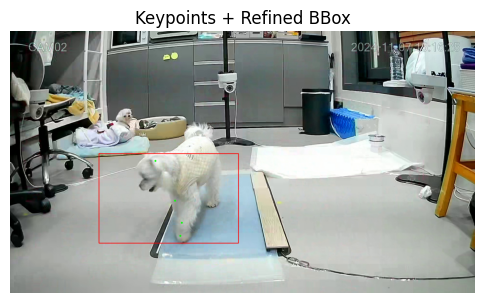

📌 front / train / jamsil_2024_10_28_10_47_30_00119.json | bbox: (0.5344497607655503, 0.38409961685823757, 0.3, 0.3655172413793103)


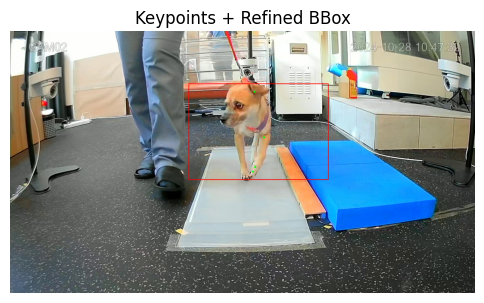

📌 tail / val / jamsil_2024_10_05_16_59_32_00125.json | bbox: (0.4894736842105263, 0.47701149425287354, 0.3, 0.5471264367816091)


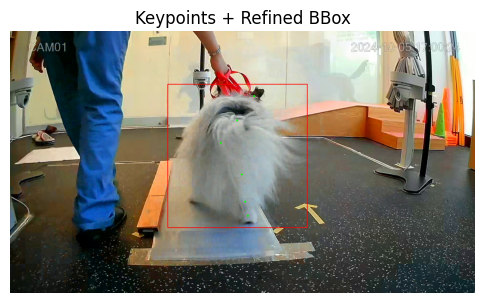

📌 tail / val / jamsil_2024_10_25_11_54_55_00146.json | bbox: (0.377511961722488, 0.407088122605364, 0.3, 0.3)


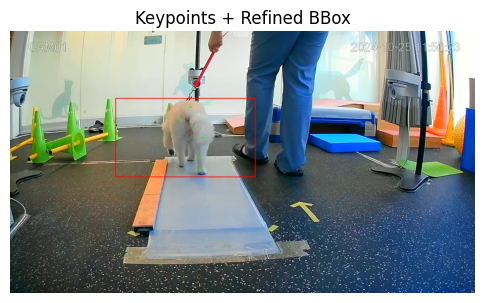

In [ ]:
# front 훈련 샘플 중 3개 무작위 시각화
preview_sample(category="front", split="train", sample_count=3)

# tail 검증 샘플 중 2개 시각화
preview_sample(category="tail", split="val", sample_count=2)


In [ ]:
# 해결 완료 - keypoint 기반 bbox의 크기 불균형” 문제를 해결
✅ 주요 적용 사항
adaptive scale 적용: keypoint 간 거리 기반으로 bbox 확장 비율 자동 조정

bbox 최소/최대 크기 보장: 너무 작거나 너무 크지 않게 제한

bbox 중심 clip: YOLO 형식(0~1 범위)에 맞게 조정

preview_sample() 함수로 front/tail 데이터 랜덤 시각화


1. 문제 진단
문제 유형	설명
📉 bbox가 너무 작다	keypoint가 강아지의 일부(예: 다리만)만 있을 때, bbox가 좁아져 전체 객체를 못 담음
📈 bbox가 너무 크다	keypoint가 넓게 퍼지거나 분산될 때, 강아지 외 배경/사물이 포함됨
⚠️ 일관성 없음	강아지 사진마다 bbox 크기와 비율이 달라서 학습이 불안정해짐

2. ✅ 해결 전략
✔️ 2.1 adaptive scale 도입
keypoint 간 최대 거리(max_dist)를 계산해, 강아지 크기를 추정
거리가 짧으면 → bbox 확장을 크게 (scale ↑)
거리가 넓으면 → bbox 확장을 작게 (scale ↓)

✔️ 2.2 bbox 크기 제한
YOLO 포맷 기준으로 width와 height를 min_size ~ max_size 범위로 clip
기본: min_size=0.3, max_size=0.8
지나치게 크거나 작은 bbox를 방지하여 학습 안정성 확보

✔️ 2.3 YOLO 포맷 맞춤
bbox 중심점 (x_center, y_center)도 0~1 사이로 clip
YOLO 모델이 요구하는 형식 정확히 맞춤

3. ✅ 전체 로직 통합 함수
def compute_refined_bbox_from_keypoints(...)
keypoint → adaptive scale 계산 → bbox 계산 → 크기 clip → 중심 clip

학습에 최적화된 안정적인 bbox 생성

# 2.5.2 front와 tail에 완벽한 bbox 적용, TXT 파일 생성(JPG와 같은 위치)

In [ ]:
import json
from pathlib import Path

# ✅ keypoint 순서
KEYPOINT_ORDER = [
    "Ear",
    "Distal lateral aspect of fifth metacarpal bone",
    "Ulnar styloid process",
    "Lateral humeral epicondyle",
    "Distal lateral aspect of the fifth metatarsus",
    "Femoral greater trochanter",
    "Lateral malleolus of the distal tibia",
    "Femorotibial joint",
    "Iliac crest",
    "Acromion/Greater tubercle",
    "Dorsal scapular spine",
    "T13 Spinous precess"
]

# ✅ adaptive scale 계산 함수
def compute_adaptive_scale(kps):
    xs = [kps[i] for i in range(0, len(kps), 3) if kps[i+2] > 0]
    ys = [kps[i+1] for i in range(0, len(kps), 3) if kps[i+2] > 0]
    if len(xs) < 2:
        return 1.2
    max_dist = max([((xs[i]-xs[j])**2 + (ys[i]-ys[j])**2)**0.5 for i in range(len(xs)) for j in range(i+1, len(xs))])
    if max_dist < 0.1:
        return 2.8
    elif max_dist < 0.2:
        return 2.0
    else:
        return 1.2

# ✅ refined bbox 생성
def compute_refined_bbox_from_keypoints(kps, min_size=0.3, max_size=0.8):
    xs = [kps[i] for i in range(0, len(kps), 3) if kps[i+2] > 0]
    ys = [kps[i+1] for i in range(0, len(kps), 3) if kps[i+2] > 0]
    if not xs or not ys:
        return 0, 0, 0, 0
    x_min, x_max = min(xs), max(xs)
    y_min, y_max = min(ys), max(ys)
    x_center = (x_min + x_max) / 2
    y_center = (y_min + y_max) / 2
    width = x_max - x_min
    height = y_max - y_min
    scale = compute_adaptive_scale(kps)
    width *= scale
    height *= scale
    width = min(max(width, min_size), max_size)
    height = min(max(height, min_size), max_size)
    x_center = max(0.0, min(x_center, 1.0))
    y_center = max(0.0, min(y_center, 1.0))
    return x_center, y_center, width, height

# ✅ 경로 설정
base_path = Path("/content/drive/MyDrive/pet_angle_copy/dataset_split2")
splits = ["train", "val", "test"]
categories = ["front", "tail"]

for split in splits:
    for category in categories:
        print(f"📂 {split}/{category} 처리 중...")
        img_dir = base_path / split / f"{category}_image"
        json_dir = base_path / split / f"{category}_label"

        json_paths = sorted(json_dir.glob("*.json"))
        for json_path in json_paths:
            image_path = img_dir / f"{json_path.stem}.jpg"
            if not image_path.exists():
                continue

            # JSON 파일 열기
            with open(json_path, encoding="utf-8") as f:
                data = json.load(f)

            # keypoints 추출
            label_to_coords = {}
            for ann in data.get("annotation_info", []):
                label = ann["label"]
                x = float(ann["x"])
                y = float(ann["y"])
                label_to_coords[label] = (x, y)

            keypoints = []
            for label in KEYPOINT_ORDER:
                if label in label_to_coords:
                    x, y = label_to_coords[label]
                    v = 2.0 if split == "train" else 1.0
                else:
                    x, y, v = 0.0, 0.0, 0.0
                keypoints.extend([x, y, v])

            # refined bbox 계산
            bbox = compute_refined_bbox_from_keypoints(keypoints)

            # ✅ .jpg와 같은 폴더에 .txt 저장
            txt_path = img_dir / f"{json_path.stem}.txt"
            with open(txt_path, "w") as f:
                line = [0, *bbox, *keypoints]  # class_id = 0
                f.write(" ".join(map(str, line)) + "\n")

print("✅ 모든 .txt 파일 생성 완료! (이미지 폴더에 저장됨)")


📂 train/front 처리 중...
📂 train/tail 처리 중...
📂 val/front 처리 중...
📂 val/tail 처리 중...
📂 test/front 처리 중...
📂 test/tail 처리 중...
✅ 모든 .txt 파일 생성 완료! (이미지 폴더에 저장됨)


In [ ]:
import cv2
import matplotlib.pyplot as plt
from pathlib import Path
import random

# ✅ keypoint 순서
KEYPOINT_ORDER = [
    "Ear",
    "Distal lateral aspect of fifth metacarpal bone",
    "Ulnar styloid process",
    "Lateral humeral epicondyle",
    "Distal lateral aspect of the fifth metatarsus",
    "Femoral greater trochanter",
    "Lateral malleolus of the distal tibia",
    "Femorotibial joint",
    "Iliac crest",
    "Acromion/Greater tubercle",
    "Dorsal scapular spine",
    "T13 Spinous precess"
]

# ✅ 시각화 함수
def visualize_txt_sample(image_path, txt_path):
    img = cv2.imread(str(image_path))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    h, w, _ = img.shape

    # txt에서 bbox + keypoint 읽기
    with open(txt_path, "r") as f:
        line = f.readline().strip().split()
        line = list(map(float, line))

    _, x_center, y_center, bw, bh, *keypoints = line

    # draw keypoints
    for i in range(0, len(keypoints), 3):
        x, y, v = keypoints[i:i+3]
        if v > 0:
            px = int(x * w)
            py = int(y * h)
            cv2.circle(img, (px, py), 4, (0, 255, 0), -1)

    # draw bbox
    x_center *= w
    y_center *= h
    bw *= w
    bh *= h
    x1 = int(x_center - bw / 2)
    y1 = int(y_center - bh / 2)
    x2 = int(x_center + bw / 2)
    y2 = int(y_center + bh / 2)
    cv2.rectangle(img, (x1, y1), (x2, y2), (255, 0, 0), 2)

    # show
    plt.figure(figsize=(6, 6))
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"{image_path.name}")
    plt.show()

# ✅ preview 함수
def preview_random_samples(category="front", split="train", sample_count=3):
    base_path = Path("/content/drive/MyDrive/pet_angle_copy/dataset_split2")
    img_dir = base_path / split / f"{category}_image"

    jpg_files = sorted(img_dir.glob("*.jpg"))
    candidates = [f for f in jpg_files if (img_dir / f.with_suffix(".txt").name).exists()]
    if not candidates:
        print("❌ .jpg와 .txt 쌍이 없습니다.")
        return

    selected = random.sample(candidates, min(sample_count, len(candidates)))

    for image_path in selected:
        txt_path = image_path.with_suffix(".txt")
        print(f"📌 시각화 중: {image_path.name}")
        visualize_txt_sample(image_path, txt_path)


📌 시각화 중: heal_2024_09_19_12_43_52_00024.jpg


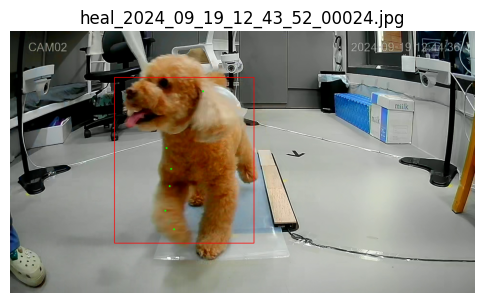

📌 시각화 중: heal_2024_11_04_11_24_38_00617.jpg


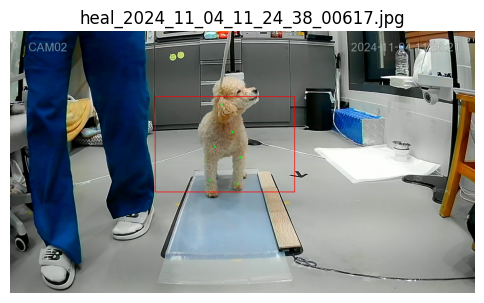

📌 시각화 중: SNC_2024_11_23_03_45_40_00048.jpg


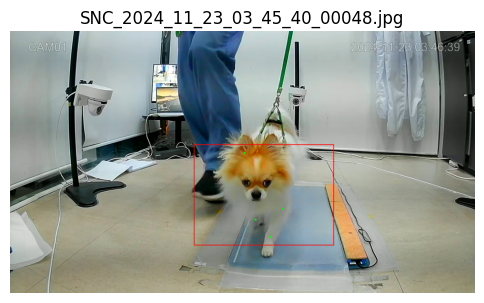

📌 시각화 중: jamsil_2024_08_30_14_08_45_00249.jpg


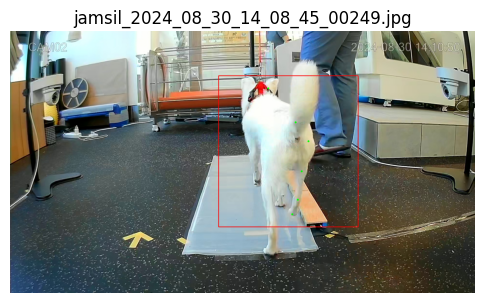

📌 시각화 중: jamsil_2024_10_01_14_55_30_00090.jpg


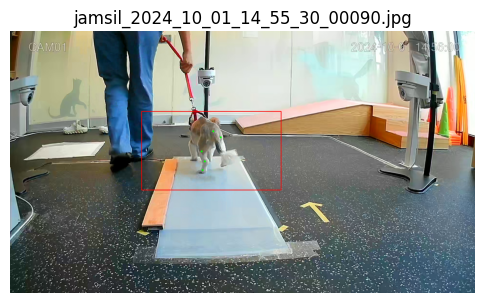

In [ ]:
preview_random_samples(category="front", split="train", sample_count=3)
preview_random_samples(category="tail", split="val", sample_count=2)


In [ ]:
from pathlib import Path

def check_jpg_txt_pairs(base_dir):
    base_dir = Path(base_dir)
    jpg_files = sorted(base_dir.glob("*.jpg"))
    txt_files = sorted(base_dir.glob("*.txt"))

    jpg_stems = set(f.stem for f in jpg_files)
    txt_stems = set(f.stem for f in txt_files)

    only_jpg = jpg_stems - txt_stems
    only_txt = txt_stems - jpg_stems
    matched = jpg_stems & txt_stems

    print(f"\n✅ 총 이미지 파일: {len(jpg_stems)}")
    print(f"✅ 총 텍스트 파일: {len(txt_stems)}")
    print(f"✅ 쌍으로 있는 파일: {len(matched)}")

    if only_jpg:
        print(f"\n❌ .jpg만 있고 .txt 없는 파일 ({len(only_jpg)}개):")
        for name in sorted(only_jpg):
            print(f"  - {name}.jpg")

    if only_txt:
        print(f"\n❌ .txt만 있고 .jpg 없는 파일 ({len(only_txt)}개):")
        for name in sorted(only_txt):
            print(f"  - {name}.txt")

    if not only_jpg and not only_txt:
        print("\n🎉 모든 파일이 잘 매칭되어 있습니다!")

# ✅ 사용 예시
check_jpg_txt_pairs("/content/drive/MyDrive/pet_angle_copy/dataset_split2/train/front_image")
check_jpg_txt_pairs("/content/drive/MyDrive/pet_angle_copy/dataset_split2/val/tail_image")



✅ 총 이미지 파일: 287
✅ 총 텍스트 파일: 287
✅ 쌍으로 있는 파일: 287

🎉 모든 파일이 잘 매칭되어 있습니다!

✅ 총 이미지 파일: 60
✅ 총 텍스트 파일: 60
✅ 쌍으로 있는 파일: 60

🎉 모든 파일이 잘 매칭되어 있습니다!


# 예전에 사용했던 txt 파일 생성(jpg와 다른 경로)

In [ ]:
import json
from pathlib import Path

# ✅ YOLO keypoint 순서
KEYPOINT_ORDER = [
    "Ear",
    "Distal lateral aspect of fifth metacarpal bone",
    "Ulnar styloid process",
    "Lateral humeral epicondyle",
    "Distal lateral aspect of the fifth metatarsus",
    "Femoral greater trochanter",
    "Lateral malleolus of the distal tibia",
    "Femorotibial joint",
    "Iliac crest",
    "Acromion/Greater tubercle",
    "Dorsal scapular spine",
    "T13 Spinous precess"
]

# ✅ bbox 계산 함수
def compute_bbox_from_keypoints(kps, scale=1.2):
    xs = [kps[i] for i in range(0, len(kps), 3) if kps[i+2] > 0]
    ys = [kps[i+1] for i in range(0, len(kps), 3) if kps[i+2] > 0]
    if not xs or not ys:
        return 0, 0, 0, 0
    x_min, x_max = min(xs), max(xs)
    y_min, y_max = min(ys), max(ys)
    x_center = (x_min + x_max) / 2
    y_center = (y_min + y_max) / 2
    width = (x_max - x_min) * scale
    height = (y_max - y_min) * scale
    return x_center, y_center, width, height

# ✅ split 및 category별 경로 지정
base_path = Path("/content/drive/MyDrive/pet_angle_copy/dataset_split2")
splits = ["train", "val", "test"]
categories = ["side", "front", "tail"]

for split in splits:
    for category in categories:
        print(f"📂 처리 중: {split}/{category}")

        # 입력 폴더
        img_dir = base_path / split / f"{category}_image"
        json_dir = base_path / split / f"{category}_label"

        # 출력 폴더
        txt_dir = base_path / split / f"{category}_txt"
        txt_dir.mkdir(parents=True, exist_ok=True)

        for json_path in sorted(json_dir.glob("*.json")):
            image_path = img_dir / f"{json_path.stem}.jpg"
            if not image_path.exists():
                continue

            # json 읽기
            with open(json_path, encoding="utf-8") as f:
                data = json.load(f)

            # keypoint 수집
            label_to_coords = {}
            for ann in data.get("annotation_info", []):
                label = ann["label"]
                x = float(ann["x"])
                y = float(ann["y"])
                if label not in label_to_coords:
                    label_to_coords[label] = (x, y)

            keypoints = []
            for label in KEYPOINT_ORDER:
                if label in label_to_coords:
                    x, y = label_to_coords[label]
                    v = 2.0 if split == "train" else 1.0
                else:
                    x, y, v = 0.0, 0.0, 0.0
                keypoints.extend([x, y, v])

            # bbox 계산
            bbox = compute_bbox_from_keypoints(keypoints, scale=1.4)

            # YOLO txt 저장
            txt_path = txt_dir / f"{json_path.stem}.txt"
            with open(txt_path, "w") as f:
                # class_id는 0으로 고정
                line = [0, *bbox, *keypoints]
                f.write(" ".join(map(str, line)) + "\n")

print("\n✅ 모든 .txt 파일 생성 완료!")


📂 처리 중: train/side
📂 처리 중: train/front
📂 처리 중: train/tail
📂 처리 중: val/side
📂 처리 중: val/front
📂 처리 중: val/tail
📂 처리 중: test/side
📂 처리 중: test/front
📂 처리 중: test/tail

✅ 모든 .txt 파일 생성 완료!


In [ ]:
# txt 파일 깨달은 점 하나 ********************************************************************
해결책: .jpg 파일이 있는 side_image 폴더 안에 .txt 파일도 같이 넣어야 함


In [ ]:
# 예시1: side_txt의 라벨 파일들을 side_image 폴더로 복사
!cp /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/side_txt/*.txt \
    /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/side_image/

!cp /content/drive/MyDrive/pet_angle_copy/dataset_split2/val/side_txt/*.txt \
    /content/drive/MyDrive/pet_angle_copy/dataset_split2/val/side_image/


In [ ]:
# 예시2: front_txt의 라벨 파일들을 tail_image 폴더로 복사
!cp /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/front_txt/*.txt \
    /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/front_image/

!cp /content/drive/MyDrive/pet_angle_copy/dataset_split2/val/front_txt/*.txt \
    /content/drive/MyDrive/pet_angle_copy/dataset_split2/val/front_image/


In [ ]:
# 예시3: tail_txt의 라벨 파일들을 tail_image 폴더로 복사
!cp /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/tail_txt/*.txt \
    /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/tail_image/

!cp /content/drive/MyDrive/pet_angle_copy/dataset_split2/val/tail_txt/*.txt \
    /content/drive/MyDrive/pet_angle_copy/dataset_split2/val/tail_image/


## 2.6 YAML 파일 생성

In [ ]:
# /content/drive/MyDrive/pet_angle_copy/dataset_split2

In [ ]:
# 각 방향(side, front, tail)마다 별도의 YAML 파일을 만들어 학습시킬 준비하기

In [ ]:
# 기존에 추가했던 FLIP_IDX를 아래와 같이 교체해서 학습
path: /content/drive/MyDrive/pet_angle_copy/dataset_split2
train: train/side_image
val: val/side_image

nc: 2
names: ["소형견", "중형견"]

kpt_shape: [12, 3]
flip_idx: [0, 4, 6, 5, 1, 3, 2, 8, 7, 10, 9, 11]


# 3. Yolo 학습

In [ ]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 28.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 125.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 96.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 62.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 38.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 16.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 105.8 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalli

In [ ]:
| 모델명                | 설명               |
| ------------------ | ---------------- |
| `yolov11n-pose.pt` | 가장 작고 빠름 (Nano)  |
| `yolov11s-pose.pt` | Standard (Small) |
| `yolov11m-pose.pt` | 더 정확함 (Medium)   |
| `yolov11l-pose.pt` | 가장 크고 정밀 (Large) |


# 3-1. Yolo 학습 - Side 방향

In [ ]:
# 1. Side 방향 부터 학습

In [ ]:
from ultralytics import YOLO

# 사전학습된 Pose 모델 불러오기
model = YOLO("yolov8n-pose.pt")
# /content/side_healbow2/side_healbow.yaml
# 학습 실행
model.train(
    data="/content/drive/MyDrive/pet_angle_copy/dataset_split2/side.yaml",
    epochs=70,
    imgsz=640,
    name="train_pose_model",
    batch=16
)

New https://pypi.org/project/ultralytics/8.3.174 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.173 🚀 Python-3.11.13 torch-2.6.0+cu124 CPU (Intel Xeon 2.20GHz)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/pet_angle_copy/dataset_split2/side.yaml, degrees=0.0, deterministic=True, device=cpu, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=70, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n-pose.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train_pose_model

train: Scanning /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/side_image.cache... 342 images, 0 backgrounds, 0 corrupt: 100%|██████████| 342/342 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.8±0.4 ms, read: 45.6±25.4 MB/s, size: 425.8 KB)



val: Scanning /content/drive/MyDrive/pet_angle_copy/dataset_split2/val/side_image.cache... 79 images, 0 backgrounds, 0 corrupt: 100%|██████████| 79/79 [00:00<?, ?it/s]

Plotting labels to runs/pose/train_pose_model4/labels.jpg... 



/usr/local/lib/python3.11/dist-packages/ultralytics/utils/plotting.py:618: UserWarning: Glyph 49548 (\N{HANGUL SYLLABLE SO}) missing from font(s) DejaVu Sans.
  plt.savefig(fname, dpi=200)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/plotting.py:618: UserWarning: Glyph 54805 (\N{HANGUL SYLLABLE HYEONG}) missing from font(s) DejaVu Sans.
  plt.savefig(fname, dpi=200)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/plotting.py:618: UserWarning: Glyph 44204 (\N{HANGUL SYLLABLE GYEON}) missing from font(s) DejaVu Sans.
  plt.savefig(fname, dpi=200)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/plotting.py:618: UserWarning: Glyph 51473 (\N{HANGUL SYLLABLE JUNG}) missing from font(s) DejaVu Sans.
  plt.savefig(fname, dpi=200)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/plotting.py:618: UserWarning: Glyph 49548 (\N{HANGUL SYLLABLE SO}) missing from font(s) DejaVu Sans.
  plt.savefig(fname, dpi=200)
/usr/local/lib/python3.11/dist-packages/ultra

optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 63 weight(decay=0.0), 73 weight(decay=0.0005), 72 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/pose/train_pose_model4
Starting training for 70 epochs...

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


       1/70         0G       1.62      9.405     0.6949      2.346       1.65         10        640: 100%|██████████| 22/22 [05:36<00:00, 15.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.55s/it]

                   all         79         79      0.955      0.987      0.992      0.594          0          0          0          0



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


       2/70         0G      1.416      8.448     0.6546       1.38      1.394         17        640: 100%|██████████| 22/22 [05:30<00:00, 15.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.49s/it]

                   all         79         79      0.725          1      0.972      0.486    0.00916     0.0127   0.000252   2.52e-05



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


       3/70         0G      1.361      7.741     0.6301      1.246      1.358         16        640: 100%|██████████| 22/22 [05:31<00:00, 15.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.51s/it]

                   all         79         79      0.935      0.918      0.958       0.61          0          0          0          0



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


       4/70         0G      1.326       7.37     0.5806      1.148      1.313         13        640: 100%|██████████| 22/22 [05:30<00:00, 15.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.40s/it]

                   all         79         79      0.892      0.942      0.958       0.59     0.0001     0.0127   7.91e-05   7.91e-06



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


       5/70         0G       1.31      7.057     0.5427      1.055      1.281         15        640: 100%|██████████| 22/22 [05:29<00:00, 15.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.55s/it]

                   all         79         79      0.918      0.911      0.942      0.589     0.0368     0.0759     0.0041     0.0005



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


       6/70         0G       1.29      6.468     0.5248     0.9702      1.284         13        640: 100%|██████████| 22/22 [05:31<00:00, 15.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.42s/it]

                   all         79         79      0.811      0.924      0.882      0.542     0.0975      0.127     0.0149    0.00166



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


       7/70         0G      1.301      6.151     0.5279     0.9776      1.279         14        640: 100%|██████████| 22/22 [05:28<00:00, 14.93s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.34s/it]

                   all         79         79      0.962      0.974      0.987      0.649      0.186       0.19     0.0408     0.0063



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


       8/70         0G      1.245      6.047     0.5089     0.9128      1.259         13        640: 100%|██████████| 22/22 [05:30<00:00, 15.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:17<00:00,  5.67s/it]

                   all         79         79       0.95      0.953       0.98      0.613      0.542      0.278      0.232     0.0342



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


       9/70         0G      1.277      6.077     0.5346     0.9114      1.274         13        640: 100%|██████████| 22/22 [05:30<00:00, 15.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.45s/it]

                   all         79         79      0.988      0.962      0.994      0.639      0.188      0.177     0.0363    0.00449



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      10/70         0G       1.29      5.924     0.5037     0.8739      1.276         13        640: 100%|██████████| 22/22 [05:29<00:00, 14.97s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.42s/it]

                   all         79         79      0.984      0.949      0.992      0.639     0.0996      0.101     0.0138    0.00159



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      11/70         0G      1.235      5.759      0.519     0.8366      1.235         10        640: 100%|██████████| 22/22 [05:28<00:00, 14.95s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.63s/it]

                   all         79         79      0.961      0.975       0.99      0.654      0.294      0.177     0.0954     0.0135



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      12/70         0G      1.241      5.714     0.5162     0.8218      1.239         13        640: 100%|██████████| 22/22 [05:28<00:00, 14.94s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:19<00:00,  6.39s/it]

                   all         79         79      0.983      0.975      0.994      0.688       0.37      0.354      0.221     0.0517



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      13/70         0G      1.199      5.589     0.4881      0.859      1.241         12        640: 100%|██████████| 22/22 [05:29<00:00, 14.97s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.57s/it]

                   all         79         79      0.985          1      0.995      0.731      0.324      0.329      0.145     0.0225



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      14/70         0G      1.169      5.403     0.4852     0.8069      1.214         12        640: 100%|██████████| 22/22 [05:29<00:00, 14.98s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.44s/it]

                   all         79         79      0.949      0.939      0.984      0.675      0.467      0.418      0.243     0.0422



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      15/70         0G      1.165      5.261     0.4769      0.763      1.202         11        640: 100%|██████████| 22/22 [05:27<00:00, 14.88s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.37s/it]

                   all         79         79      0.967      0.937      0.989      0.661       0.58      0.519      0.396     0.0806



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      16/70         0G      1.118      5.254     0.4652     0.7346      1.174         11        640: 100%|██████████| 22/22 [05:30<00:00, 15.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.55s/it]

                   all         79         79      0.983      0.987      0.994      0.698       0.43      0.392      0.211     0.0392



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      17/70         0G       1.16      5.274     0.4498     0.7546      1.198         16        640: 100%|██████████| 22/22 [05:32<00:00, 15.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.55s/it]

                   all         79         79      0.987      0.981      0.985      0.662      0.445      0.443      0.213     0.0495



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      18/70         0G      1.157      5.281     0.4569     0.7576        1.2         14        640: 100%|██████████| 22/22 [05:31<00:00, 15.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.40s/it]

                   all         79         79      0.986      0.987      0.994       0.68      0.557      0.544      0.428     0.0876



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      19/70         0G      1.135       5.18     0.4609     0.7238      1.198         17        640: 100%|██████████| 22/22 [05:28<00:00, 14.94s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.49s/it]

                   all         79         79      0.987          1      0.995      0.731      0.517      0.519      0.309     0.0712



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      20/70         0G      1.075      5.073     0.4656     0.6788      1.175         11        640: 100%|██████████| 22/22 [05:30<00:00, 15.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.60s/it]

                   all         79         79      0.973          1      0.994      0.743      0.471      0.468      0.351     0.0982



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      21/70         0G      1.079      4.934     0.4588     0.7118      1.177         12        640: 100%|██████████| 22/22 [05:30<00:00, 15.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.40s/it]

                   all         79         79      0.999          1      0.995      0.736       0.48      0.481      0.247     0.0691



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      22/70         0G      1.116       5.01     0.4624     0.6984      1.188         15        640: 100%|██████████| 22/22 [05:31<00:00, 15.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.55s/it]

                   all         79         79      0.986      0.987      0.994      0.743       0.49      0.468      0.312     0.0701



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      23/70         0G      1.031      4.849     0.4398     0.6603      1.131         15        640: 100%|██████████| 22/22 [05:37<00:00, 15.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.38s/it]

                   all         79         79      0.993          1      0.995      0.749      0.663      0.671      0.549      0.116



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      24/70         0G      1.052      4.919     0.4336     0.6547      1.138         15        640: 100%|██████████| 22/22 [05:31<00:00, 15.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:17<00:00,  5.75s/it]

                   all         79         79      0.974          1      0.994      0.758      0.432      0.443      0.254     0.0554



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      25/70         0G      1.045      4.899     0.4266     0.6693      1.146         14        640: 100%|██████████| 22/22 [05:32<00:00, 15.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.41s/it]

                   all         79         79      0.986          1      0.995      0.753      0.462      0.468      0.261     0.0629



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      26/70         0G      1.028      4.928     0.4141     0.6532       1.12         12        640: 100%|██████████| 22/22 [05:31<00:00, 15.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.59s/it]

                   all         79         79          1          1      0.995      0.745      0.494      0.468      0.269     0.0535



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      27/70         0G      1.022      4.708      0.419     0.6344      1.123         11        640: 100%|██████████| 22/22 [05:33<00:00, 15.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.43s/it]

                   all         79         79      0.999          1      0.995       0.76      0.621      0.582        0.4     0.0803



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      28/70         0G      1.041      4.856     0.4322     0.6415      1.149         16        640: 100%|██████████| 22/22 [05:32<00:00, 15.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.63s/it]

                   all         79         79      0.999          1      0.995      0.742      0.683      0.684      0.506     0.0925



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      29/70         0G      1.016      4.659     0.4172     0.6685      1.134         17        640: 100%|██████████| 22/22 [05:33<00:00, 15.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.50s/it]

                   all         79         79      0.999          1      0.995      0.754      0.533      0.519      0.383      0.115



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      30/70         0G     0.9841      4.823     0.4155     0.6042      1.113         14        640: 100%|██████████| 22/22 [05:33<00:00, 15.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:17<00:00,  5.73s/it]

                   all         79         79      0.987          1      0.995      0.756        0.5      0.494      0.322      0.091



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      31/70         0G          1      4.587     0.4227     0.6267      1.118         13        640: 100%|██████████| 22/22 [05:30<00:00, 15.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.45s/it]

                   all         79         79      0.987      0.998      0.995      0.721      0.493      0.481      0.261     0.0583



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      32/70         0G      0.971      4.751     0.4013     0.6152      1.125         13        640: 100%|██████████| 22/22 [05:27<00:00, 14.90s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.37s/it]

                   all         79         79      0.986      0.987      0.994      0.756      0.531      0.532      0.396      0.098



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      33/70         0G     0.9648      4.598     0.3969     0.5978      1.102         14        640: 100%|██████████| 22/22 [05:34<00:00, 15.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.54s/it]

                   all         79         79      0.987      0.997      0.995      0.781      0.468      0.468      0.246      0.058



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      34/70         0G     0.9819      4.635     0.4161     0.6219      1.119         10        640: 100%|██████████| 22/22 [05:32<00:00, 15.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.43s/it]

                   all         79         79      0.998      0.987      0.992      0.773        0.5      0.494      0.272     0.0673



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      35/70         0G      0.956      4.564     0.3822     0.6208      1.094         15        640: 100%|██████████| 22/22 [05:35<00:00, 15.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.55s/it]

                   all         79         79      0.998          1      0.995      0.774      0.551      0.532      0.436      0.123



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      36/70         0G     0.9929      4.561     0.4008     0.6065      1.134         19        640: 100%|██████████| 22/22 [05:30<00:00, 15.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.37s/it]

                   all         79         79      0.991      0.975      0.994       0.77      0.541      0.532      0.401      0.108



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      37/70         0G      0.944      4.505     0.3784     0.5879      1.101         15        640: 100%|██████████| 22/22 [05:34<00:00, 15.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.49s/it]

                   all         79         79      0.986          1      0.995      0.773      0.536      0.544      0.356      0.087



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      38/70         0G     0.9677      4.488     0.3806     0.5799        1.1         12        640: 100%|██████████| 22/22 [05:34<00:00, 15.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.56s/it]

                   all         79         79          1      0.986      0.995      0.794      0.511      0.529      0.358     0.0888



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      39/70         0G     0.9242       4.47     0.3558     0.5904      1.072         15        640: 100%|██████████| 22/22 [05:34<00:00, 15.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:18<00:00,  6.07s/it]

                   all         79         79          1          1      0.995       0.79      0.512      0.506      0.396      0.111



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      40/70         0G     0.8882      4.498     0.3835     0.5599      1.067         17        640: 100%|██████████| 22/22 [05:31<00:00, 15.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.45s/it]

                   all         79         79      0.999          1      0.995      0.786      0.523      0.519      0.334     0.0908



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      41/70         0G     0.9196      4.438     0.3765     0.5725      1.074         15        640: 100%|██████████| 22/22 [05:33<00:00, 15.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.52s/it]

                   all         79         79          1      0.997      0.995      0.785      0.528      0.532      0.322     0.0885



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      42/70         0G     0.8988      4.423     0.3768     0.5695      1.078         12        640: 100%|██████████| 22/22 [05:32<00:00, 15.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.49s/it]

                   all         79         79          1      0.999      0.995      0.789      0.678      0.671      0.525      0.121



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      43/70         0G     0.9044      4.395     0.3541     0.5466      1.066          7        640: 100%|██████████| 22/22 [05:32<00:00, 15.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.51s/it]

                   all         79         79      0.999          1      0.995       0.79      0.499      0.494      0.467      0.141



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      44/70         0G     0.9205      4.456     0.3553     0.5719      1.089         10        640: 100%|██████████| 22/22 [05:35<00:00, 15.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:17<00:00,  5.69s/it]

                   all         79         79          1          1      0.995      0.783      0.486      0.481      0.351      0.106



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      45/70         0G     0.8611      4.382      0.355     0.5105      1.061         13        640: 100%|██████████| 22/22 [05:31<00:00, 15.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.39s/it]

                   all         79         79          1          1      0.995      0.794      0.595      0.595      0.399      0.107



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      46/70         0G     0.8789      4.244     0.3516     0.5485      1.062         15        640: 100%|██████████| 22/22 [05:31<00:00, 15.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.56s/it]

                   all         79         79      0.999          1      0.995      0.795      0.607      0.608      0.501      0.142



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      47/70         0G     0.8811      4.221     0.3432     0.5327      1.057         15        640: 100%|██████████| 22/22 [05:32<00:00, 15.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.43s/it]

                   all         79         79      0.999          1      0.995      0.794      0.569       0.57       0.39      0.125



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      48/70         0G     0.8924      4.315     0.3537     0.5417      1.073         15        640: 100%|██████████| 22/22 [05:29<00:00, 14.97s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.44s/it]

                   all         79         79      0.999          1      0.995      0.795      0.658      0.658      0.478      0.119



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      49/70         0G     0.8423      4.231     0.3452     0.5133      1.039         15        640: 100%|██████████| 22/22 [05:33<00:00, 15.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.41s/it]

                   all         79         79          1          1      0.995       0.79      0.678      0.671      0.503      0.123



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      50/70         0G     0.8809      4.173     0.3783     0.5405      1.083         12        640: 100%|██████████| 22/22 [05:31<00:00, 15.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.42s/it]

                   all         79         79      0.999          1      0.995      0.802      0.556      0.557       0.38      0.112



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      51/70         0G     0.8247      4.272     0.3312     0.5173      1.048         11        640: 100%|██████████| 22/22 [05:32<00:00, 15.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.43s/it]

                   all         79         79      0.987          1      0.995      0.793      0.558      0.544      0.361     0.0985



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      52/70         0G     0.8511      4.232     0.3511     0.5273      1.051         14        640: 100%|██████████| 22/22 [05:29<00:00, 14.98s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.41s/it]

                   all         79         79      0.987          1      0.995       0.79      0.699      0.709       0.55      0.139



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      53/70         0G     0.7881      4.256     0.3464     0.4678      1.024         16        640: 100%|██████████| 22/22 [05:33<00:00, 15.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.49s/it]

                   all         79         79      0.999          1      0.995      0.801      0.582      0.582      0.404      0.128



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      54/70         0G     0.8201      4.296      0.337     0.5089      1.035         14        640: 100%|██████████| 22/22 [05:30<00:00, 15.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.39s/it]

                   all         79         79      0.999          1      0.995      0.807      0.664      0.658      0.515      0.144



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      55/70         0G     0.8064      4.125     0.3525     0.4967      1.046         18        640: 100%|██████████| 22/22 [05:32<00:00, 15.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.54s/it]

                   all         79         79      0.999          1      0.995      0.805      0.695      0.696      0.564      0.145



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      56/70         0G     0.7721      4.148      0.328     0.4701      1.012         19        640: 100%|██████████| 22/22 [05:32<00:00, 15.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.53s/it]

                   all         79         79      0.999          1      0.995      0.825      0.582      0.582      0.442       0.13



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      57/70         0G     0.8098      4.104     0.3309     0.4884       1.06          7        640: 100%|██████████| 22/22 [05:31<00:00, 15.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.35s/it]

                   all         79         79      0.999          1      0.995        0.8      0.595      0.595       0.43      0.116



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      58/70         0G     0.8016      4.035      0.324     0.4967      1.046          9        640: 100%|██████████| 22/22 [05:34<00:00, 15.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.54s/it]

                   all         79         79      0.999          1      0.995      0.812      0.683      0.684      0.515      0.126



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      59/70         0G     0.7965      4.224     0.3447     0.4895      1.025         15        640: 100%|██████████| 22/22 [05:32<00:00, 15.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.40s/it]

                   all         79         79      0.999          1      0.995      0.812      0.696      0.696       0.52      0.124



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      60/70         0G     0.7649      4.097     0.3327     0.4745      1.018         11        640: 100%|██████████| 22/22 [05:35<00:00, 15.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.63s/it]

                   all         79         79      0.999          1      0.995      0.823      0.658      0.658      0.486      0.139


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      61/70         0G      0.631      4.163     0.1154     0.3838     0.9349          6        640: 100%|██████████| 22/22 [05:32<00:00, 15.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.42s/it]

                   all         79         79      0.999          1      0.995      0.808      0.569       0.57      0.371      0.112



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      62/70         0G     0.6209       4.13     0.1304     0.3846     0.9392          6        640: 100%|██████████| 22/22 [05:30<00:00, 15.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.42s/it]

                   all         79         79          1      0.999      0.995       0.82      0.645      0.645      0.499      0.141



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      63/70         0G     0.5794      4.137     0.1232      0.346     0.9227          6        640: 100%|██████████| 22/22 [05:29<00:00, 14.98s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:18<00:00,  6.08s/it]

                   all         79         79          1      0.999      0.995      0.815      0.636      0.646       0.46      0.113



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      64/70         0G     0.6201      4.066     0.1179     0.3542     0.9255          6        640: 100%|██████████| 22/22 [05:31<00:00, 15.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.46s/it]

                   all         79         79          1      0.999      0.995      0.815      0.589      0.582      0.387      0.106



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      65/70         0G     0.6121      4.072     0.1214     0.3534     0.9304          6        640: 100%|██████████| 22/22 [05:28<00:00, 14.94s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.36s/it]

                   all         79         79          1          1      0.995      0.815      0.582      0.582      0.403      0.115



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      66/70         0G     0.5771      4.082     0.1297     0.3413     0.9341          6        640: 100%|██████████| 22/22 [05:31<00:00, 15.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.61s/it]

                   all         79         79          1          1      0.995      0.807      0.569       0.57      0.381      0.105



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      67/70         0G      0.579      4.079     0.1257     0.3397     0.9312          6        640: 100%|██████████| 22/22 [05:27<00:00, 14.90s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.65s/it]

                   all         79         79          1      0.999      0.995      0.807      0.535      0.544       0.36      0.102



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      68/70         0G      0.582      4.024     0.1132     0.3271     0.9253          6        640: 100%|██████████| 22/22 [05:31<00:00, 15.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.47s/it]

                   all         79         79          1      0.999      0.995       0.82      0.585      0.595      0.428      0.121



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      69/70         0G     0.5514      4.013     0.1236     0.3373      0.928          6        640: 100%|██████████| 22/22 [05:32<00:00, 15.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.45s/it]

                   all         79         79          1      0.999      0.995       0.82       0.61       0.62      0.454      0.129



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      70/70         0G     0.5542      4.054     0.1094     0.3191     0.9159          6        640: 100%|██████████| 22/22 [05:30<00:00, 15.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.43s/it]

                   all         79         79          1      0.999      0.995      0.822      0.562      0.568      0.389      0.119



70 epochs completed in 6.778 hours.
Optimizer stripped from runs/pose/train_pose_model4/weights/last.pt, 6.6MB
Optimizer stripped from runs/pose/train_pose_model4/weights/best.pt, 6.6MB

Validating runs/pose/train_pose_model4/weights/best.pt...
Ultralytics 8.3.173 🚀 Python-3.11.13 torch-2.6.0+cu124 CPU (Intel Xeon 2.20GHz)
YOLOv8n-pose summary (fused): 81 layers, 3,190,394 parameters, 0 gradients, 8.8 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.26s/it]
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:675: UserWarning: Glyph 49548 (\N{HANGUL SYLLABLE SO}) missing from font(s) DejaVu Sans.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:675: UserWarning: Glyph 54805 (\N{HANGUL SYLLABLE HYEONG}) missing from font(s) DejaVu Sans.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:675: UserWarning: Glyph 44204 (\N{HANGUL SYLLABLE GYEON}) missing from font(s) DejaVu Sans.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:721: UserWarning: Glyph 49548 (\N{HANGUL SYLLABLE SO}) missing from font(s) DejaVu Sans.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.11/dist-packages/ultralyti

                   all         79         79          1      0.999      0.995       0.82      0.645      0.645      0.498      0.141
                   소형견         79         79          1      0.999      0.995       0.82      0.645      0.645      0.498      0.141
Speed: 1.4ms preprocess, 160.8ms inference, 0.0ms loss, 0.6ms postprocess per image
Results saved to runs/pose/train_pose_model4


ultralytics.utils.metrics.PoseMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7bb158186790>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)', 'Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)', 'Precision-Recall(P)', 'F1-Confidence(P)', 'Precision-Confidence(P)', 'Recall-Confidence(P)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034, 

In [ ]:
그러면 KEYPOINT의 정밀도를 높이려면 어떻게 해야할까? 정밀도를 높여놔야, 슬개골 탈구 여부 판단을 위한 후속 분류 모델도 생각하잖아 (SIZE랑 SEVERITY) 함께 사용

❗ val에 대응되지 않는 txt 파일 수: 0


## 3-1-1. Yolo 학습 - Side 방향 = 튜닝을 위한 하이퍼파라미터 조정

In [ ]:
# 1. keypoint 라벨 순서와 명칭 재확인(side 방향 위주) => 모두 12개로 아무 이상 없다.
# 2. yolo11모델로 교체
# 3. SEMI-SUPERVISED 추가 => 하지 말것

In [ ]:
/content/drive/MyDrive/pet_angle_copy/dataset_split2/train/side_label
/content/drive/MyDrive/pet_angle_copy/dataset_split2/val/side_label

In [ ]:
import os
import json

# SIDE json 파일이 있는 폴더 경로
json_folder = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/train/side_label"  # 경로 수정 가능

# 모든 JSON에서 keypoint label만 수집
all_labels = []

for filename in os.listdir(json_folder):
    if filename.endswith(".json"):
        with open(os.path.join(json_folder, filename), "r", encoding="utf-8") as f:
            data = json.load(f)

        annotation_info = data.get("annotation_info", [])
        for ann in annotation_info:
            label = ann.get("label")
            if label:
                all_labels.append(label)

# 중복 제거 및 정렬
unique_labels = sorted(set(all_labels))

# 출력
print(f"🔍 총 {len(unique_labels)}개 keypoint 라벨:")
for label in unique_labels:
    print(f"- {label}")


🔍 총 12개 keypoint 라벨:
- Acromion/Greater tubercle
- Distal lateral aspect of fifth metacarpal bone
- Distal lateral aspect of the fifth metatarsus
- Dorsal scapular spine
- Ear
- Femoral greater trochanter
- Femorotibial joint
- Iliac crest
- Lateral humeral epicondyle
- Lateral malleolus of the distal tibia
- T13 Spinous precess
- Ulnar styloid process


In [ ]:
import os
import json

# SIDE json 파일이 있는 폴더 경로
json_folder = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/val/side_label"  # 경로 수정 가능

# 모든 JSON에서 keypoint label만 수집
all_labels = []

for filename in os.listdir(json_folder):
    if filename.endswith(".json"):
        with open(os.path.join(json_folder, filename), "r", encoding="utf-8") as f:
            data = json.load(f)

        annotation_info = data.get("annotation_info", [])
        for ann in annotation_info:
            label = ann.get("label")
            if label:
                all_labels.append(label)

# 중복 제거 및 정렬
unique_labels = sorted(set(all_labels))

# 출력
print(f"🔍 총 {len(unique_labels)}개 keypoint 라벨:")
for label in unique_labels:
    print(f"- {label}")


🔍 총 12개 keypoint 라벨:
- Acromion/Greater tubercle
- Distal lateral aspect of fifth metacarpal bone
- Distal lateral aspect of the fifth metatarsus
- Dorsal scapular spine
- Ear
- Femoral greater trochanter
- Femorotibial joint
- Iliac crest
- Lateral humeral epicondyle
- Lateral malleolus of the distal tibia
- T13 Spinous precess
- Ulnar styloid process


In [ ]:
# 모델 교체, epochs를 70->100으로, imgsz도 증가, 경사하강법 알고리즘도 교체

In [ ]:
🔍 왜 바꾸는가?
YOLOv11 + 이미지 해상도 768 이상이면 VRAM 사용량이 급증해요.
특히 pose는 keypoint까지 예측하므로 일반 detect보다 메모리를 더 많이 씁니다.
만약 Colab T4 (16GB VRAM) 환경이라면 batch=16은 OOM(Out of Memory) 에러가 나기 쉽습니다.

그래서 batch=8로 줄여서 안정적으로 학습하려는 거예요.

In [ ]:
!wget https://github.com/ultralytics/assets/releases/download/v8.2.0/yolov11m-pose.pt

--2025-08-05 00:48:36--  https://github.com/ultralytics/assets/releases/download/v8.2.0/yolov11m-pose.pt
Resolving github.com (github.com)... 20.205.243.166
Connecting to github.com (github.com)|20.205.243.166|:443... connected.
HTTP request sent, awaiting response... 404 Not Found
2025-08-05 00:48:36 ERROR 404: Not Found.



In [ ]:
# 모델 교체 불가 -> 같은 버전의 medium pose 모델로 교체(정밀도 중시)
yolov11m-pose.pt는 아직 Ultralytics 공식 릴리스로 배포되지 않았다.

In [ ]:
# Logging results to runs/pose/train_pose_model
# /content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs

In [ ]:
from ultralytics import YOLO
model = YOLO("/content/yolov8m-pose.pt")

model.train(
    data="/content/drive/MyDrive/pet_angle_copy/dataset_split2/side.yaml",
    epochs=100,                  # → 좀 더 늘려도 괜찮음
    imgsz=768,                   # → keypoint 품질 개선을 위해 증가
    name="train_pose_model",
    batch=8,                     # → VRAM 적으면 줄이기 (한 번 학습에 사용될 이미지를 16장에서 8장으로 교체)
    optimizer="AdamW",           # → 기본은 SGD인데 성능에 따라 바꿔보기
    lr0=0.001,
    close_mosaic=10              # → pose task에선 mosaic 일찍 끄는 게 유리
)


Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=8, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/pet_angle_copy/dataset_split2/side.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=768, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.001, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=/content/yolov8m-pose.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train_pose_model, nbs=64, nms=False, opset=None, optimize=False, optimizer=AdamW, overlap_mask=True, pa

Overriding model.yaml kpt_shape=[17, 3] with kpt_shape=[12, 3]
Overriding model.yaml nc=1 with nc=2

                   from  n    params  module                                       arguments                     
  0                  -1  1      1392  ultralytics.nn.modules.conv.Conv             [3, 48, 3, 2]                 
  1                  -1  1     41664  ultralytics.nn.modules.conv.Conv             [48, 96, 3, 2]                
  2                  -1  2    111360  ultralytics.nn.modules.block.C2f             [96, 96, 2, True]             
  3                  -1  1    166272  ultralytics.nn.modules.conv.Conv             [96, 192, 3, 2]               
  4                  -1  4    813312  ultralytics.nn.modules.block.C2f             [192, 192, 4, True]           
  5                  -1  1    664320  ultralytics.nn.modules.conv.Conv             [192, 384, 3, 2]              
  6                  -1  4   3248640  ultralytics.nn.modules.block.C2f             [384, 384, 4, True

 21                  -1  2   4207104  ultralytics.nn.modules.block.C2f             [960, 576, 2]                 
 22        [15, 18, 21]  1   4342594  ultralytics.nn.modules.head.Pose             [2, [12, 3], [192, 384, 576]] 
YOLOv8m-pose summary: 184 layers, 26,423,218 parameters, 26,423,202 gradients, 81.2 GFLOPs

Transferred 475/517 items from pretrained weights
Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...


AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.4±0.1 ms, read: 0.5±0.2 MB/s, size: 407.4 KB)


train: Scanning /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/side_image.cache... 342 images, 0 backgrounds, 0 corrupt: 100%|██████████| 342/342 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.4±0.1 ms, read: 0.6±0.2 MB/s, size: 425.8 KB)


val: Scanning /content/drive/MyDrive/pet_angle_copy/dataset_split2/val/side_image.cache... 79 images, 0 backgrounds, 0 corrupt: 100%|██████████| 79/79 [00:00<?, ?it/s]


Plotting labels to runs/pose/train_pose_model/labels.jpg... 
optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 83 weight(decay=0.0), 93 weight(decay=0.0005), 92 bias(decay=0.0)
Image sizes 768 train, 768 val
Using 8 dataloader workers
Logging results to runs/pose/train_pose_model
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      1/100      4.71G      2.171       9.43     0.7132      4.197      2.448         15        768:   9%|▉         | 4/43 [00:06<00:40,  1.04s/it]
      1/100      4.75G      1.624      8.474     0.5827      1.897      1.899          9        768: 100%|██████████| 43/43 [00:28<00:00,  1.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.45it/s]

                   all         79         79      0.379      0.795      0.666      0.306    0.00607     0.0127    0.00264   0.000264



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      2/100      5.02G      1.416      7.616     0.5486      1.104      1.677         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.94it/s]

                   all         79         79      0.871      0.937      0.976      0.525     0.0902     0.0759     0.0429    0.00531



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      3/100      5.09G      1.457      7.375     0.5622      1.033      1.686          9        768: 100%|██████████| 43/43 [00:09<00:00,  4.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.16it/s]

                   all         79         79      0.924      0.926      0.964      0.492      0.135      0.127     0.0361    0.00452



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      4/100      5.16G      1.407      7.014     0.5486      1.055      1.673         16        768: 100%|██████████| 43/43 [00:09<00:00,  4.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.10it/s]

                   all         79         79      0.921      0.962       0.98      0.607      0.108      0.101     0.0176    0.00288



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      5/100      5.16G      1.419      6.884      0.536     0.9859      1.685         16        768: 100%|██████████| 43/43 [00:09<00:00,  4.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.27it/s]

                   all         79         79      0.902      0.937      0.975      0.635      0.166      0.152     0.0473     0.0096



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      6/100      5.16G      1.327      6.558     0.5374      0.968      1.615         12        768: 100%|██████████| 43/43 [00:09<00:00,  4.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.85it/s]

                   all         79         79      0.739      0.595      0.721      0.443      0.158      0.114     0.0286    0.00532



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      7/100      5.23G      1.289      6.247     0.5103     0.9099      1.555          8        768: 100%|██████████| 43/43 [00:09<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.96it/s]

                   all         79         79       0.93      0.962      0.975       0.62      0.259      0.266     0.0971     0.0154



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      8/100       5.3G      1.275      6.225      0.535     0.9284      1.553         18        768: 100%|██████████| 43/43 [00:09<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.13it/s]

                   all         79         79      0.938      0.959      0.987      0.643      0.359      0.342      0.201     0.0339



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      9/100       5.3G      1.279      6.067     0.5257     0.9294      1.544         16        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.12it/s]

                   all         79         79      0.966      0.962      0.987      0.661      0.481      0.278      0.235     0.0509



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     10/100       5.3G      1.261      5.947     0.5156     0.8847      1.502         14        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.15it/s]

                   all         79         79      0.987      0.984      0.991      0.701      0.428      0.354      0.209     0.0525



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     11/100       5.3G      1.227      5.649     0.4931     0.8658      1.489         17        768: 100%|██████████| 43/43 [00:09<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.31it/s]

                   all         79         79          1       0.97      0.994      0.661      0.449      0.443      0.298     0.0617



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     12/100       5.3G      1.232      5.571     0.4913     0.8537      1.521         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.33it/s]

                   all         79         79      0.984      0.962      0.979      0.682       0.49      0.456      0.276     0.0813



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     13/100       5.3G      1.205      5.622     0.4793     0.8253      1.505         17        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.14it/s]

                   all         79         79      0.974      0.953      0.987      0.643      0.464      0.351      0.296      0.076



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     14/100       5.3G      1.199      5.478     0.4633     0.8063      1.491         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.15it/s]

                   all         79         79          1      0.968      0.993        0.7      0.454      0.441      0.225     0.0455



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     15/100       5.3G      1.179      5.439     0.4473     0.7701      1.462         12        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.02it/s]

                   all         79         79      0.996      0.987      0.991      0.711      0.458      0.443      0.229     0.0614



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     16/100       5.3G      1.184      5.388     0.4484     0.8164      1.464         16        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.28it/s]

                   all         79         79      0.985      0.975      0.989      0.717      0.435      0.443      0.214     0.0457



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     17/100       5.3G      1.186      5.367     0.4754     0.8156      1.487         16        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.09it/s]

                   all         79         79       0.97      0.975      0.986      0.664      0.479      0.443      0.274     0.0802



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     18/100       5.3G      1.123      5.221      0.446     0.7696      1.425         11        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.87it/s]

                   all         79         79      0.983          1      0.993      0.715       0.43      0.405      0.256     0.0713



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     19/100       5.3G      1.136      5.336      0.438     0.7742      1.433         17        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.21it/s]

                   all         79         79          1      0.987      0.994      0.717      0.475      0.456      0.236     0.0745



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     20/100      5.37G      1.087      5.248     0.4153     0.7447      1.404          7        768: 100%|██████████| 43/43 [00:09<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.17it/s]

                   all         79         79       0.96          1      0.993      0.712      0.426      0.443      0.202     0.0692



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     21/100      5.37G       1.14      5.332     0.4392     0.7986      1.433         14        768: 100%|██████████| 43/43 [00:09<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.06it/s]

                   all         79         79      0.972      0.975      0.993      0.711      0.442      0.443      0.343      0.117



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     22/100      5.37G      1.119       5.22     0.4212     0.7755      1.413         17        768: 100%|██████████| 43/43 [00:09<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.23it/s]

                   all         79         79      0.993      0.987      0.995      0.743      0.469      0.481        0.4      0.154



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     23/100      5.37G      1.068      5.322      0.416     0.7346      1.376         12        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.02it/s]

                   all         79         79      0.998      0.987      0.995      0.716       0.44       0.43       0.21     0.0659



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     24/100      5.37G      1.129      5.048     0.3956      0.744      1.401         18        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.25it/s]

                   all         79         79      0.998          1      0.995      0.706      0.491      0.481      0.272     0.0815



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     25/100      5.37G      1.078      5.169     0.3929     0.7154      1.391         10        768: 100%|██████████| 43/43 [00:09<00:00,  4.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.05it/s]

                   all         79         79      0.992          1      0.995      0.747      0.514      0.519      0.291      0.104



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     26/100      5.37G      1.048      4.814     0.3855     0.6968      1.344          9        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.15it/s]

                   all         79         79      0.987      0.987      0.993      0.746      0.463      0.456      0.238     0.0803



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     27/100      5.37G      1.084       4.99      0.399      0.749      1.403         16        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.87it/s]

                   all         79         79      0.987      0.983      0.994      0.755      0.493      0.468      0.251      0.105



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     28/100      5.37G      1.028      4.951     0.3876     0.6962      1.356         17        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.13it/s]

                   all         79         79      0.987      0.986      0.994      0.723      0.519      0.519      0.351      0.109



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     29/100      5.37G      1.047      4.925     0.3953     0.6882      1.361         17        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.13it/s]

                   all         79         79          1      0.987      0.995      0.749      0.506      0.494      0.324      0.138



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     30/100      5.37G       1.04       4.81     0.3853     0.6919      1.336         11        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.78it/s]

                   all         79         79      0.986          1      0.995      0.759      0.511      0.519      0.289      0.119



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     31/100       5.5G     0.9773      4.891     0.3795     0.6582      1.301         17        768: 100%|██████████| 43/43 [00:09<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.19it/s]

                   all         79         79      0.987      0.968      0.993      0.756      0.506      0.481      0.282      0.115



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     32/100      5.67G      1.018      4.936     0.3923     0.6796      1.344         16        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.91it/s]

                   all         79         79      0.987      0.984      0.985      0.742      0.569      0.567      0.332      0.101



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     33/100      5.67G      1.035      4.848     0.3861     0.6765      1.353         15        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.19it/s]

                   all         79         79          1      0.985      0.986      0.745      0.589      0.582      0.445      0.156



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     34/100      5.67G      1.039      4.889     0.3648     0.7073       1.36         15        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.10it/s]

                   all         79         79      0.979      0.975      0.991      0.755      0.594      0.595      0.419      0.139



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     35/100      5.67G     0.9772      4.768     0.3502     0.6733      1.325         12        768: 100%|██████████| 43/43 [00:09<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.31it/s]

                   all         79         79          1      0.996      0.995      0.735      0.581      0.578      0.459      0.187



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     36/100      5.67G     0.9799      4.753     0.3468     0.6463      1.327         10        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.21it/s]

                   all         79         79      0.987      0.986      0.992      0.726      0.576       0.57      0.358      0.131



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     37/100      5.67G     0.9978      4.636     0.3745     0.6681      1.333         12        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.21it/s]

                   all         79         79      0.994      0.975      0.994      0.766      0.748      0.734      0.614      0.181



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     38/100      5.67G     0.9425      4.523     0.3596     0.6355      1.287         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.04it/s]

                   all         79         79      0.998          1      0.995      0.766      0.758      0.759      0.595       0.15



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     39/100      5.67G     0.9218      4.734     0.3735     0.6048      1.275         16        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.15it/s]

                   all         79         79      0.999          1      0.995      0.756      0.536      0.532      0.357       0.14



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     40/100      5.67G     0.9429      4.584     0.3454     0.6044      1.286         15        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.07it/s]

                   all         79         79          1      0.974      0.994      0.749      0.536      0.519      0.313      0.117



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     41/100      5.67G     0.9565      4.619     0.3638      0.638      1.298         15        768: 100%|██████████| 43/43 [00:09<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.99it/s]

                   all         79         79          1          1      0.995      0.775      0.619       0.62      0.407      0.129



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     42/100      5.67G     0.8872      4.366     0.3408     0.5973      1.248         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.27it/s]

                   all         79         79      0.998          1      0.995      0.781      0.568       0.57      0.337      0.122



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     43/100      5.67G     0.8874      4.557     0.3344      0.564      1.237         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.17it/s]

                   all         79         79      0.999          1      0.995      0.785       0.48      0.481       0.27      0.135



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     44/100      5.67G     0.8766      4.489     0.3353     0.5792      1.238         10        768: 100%|██████████| 43/43 [00:09<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.12it/s]

                   all         79         79          1          1      0.995      0.753      0.474      0.468      0.308      0.136



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     45/100      5.67G     0.8903      4.424     0.3348     0.6003      1.264         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.01it/s]

                   all         79         79      0.999          1      0.995       0.78      0.467      0.468        0.4      0.157



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     46/100      5.67G     0.8677      4.292     0.3286     0.5796      1.239         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.17it/s]

                   all         79         79      0.999          1      0.995      0.782      0.526      0.519      0.466      0.212



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     47/100      5.67G     0.8922      4.476     0.3458     0.5835      1.248         14        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.94it/s]

                   all         79         79      0.998          1      0.995      0.788      0.517      0.519      0.325      0.158



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     48/100      5.67G     0.8658      4.389     0.3307     0.5707      1.237         14        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.23it/s]

                   all         79         79          1          1      0.995      0.783      0.555      0.557      0.356      0.135



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     49/100      5.67G     0.8643      4.305      0.345     0.5475      1.231         21        768: 100%|██████████| 43/43 [00:09<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.16it/s]

                   all         79         79      0.999          1      0.995      0.791      0.643      0.633      0.443      0.143



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     50/100      5.67G     0.8896      4.515      0.331     0.5756      1.244         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.29it/s]

                   all         79         79      0.999          1      0.995      0.782      0.529      0.519       0.37      0.158



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     51/100      5.67G     0.8769      4.324     0.3272     0.5755      1.233         17        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.23it/s]

                   all         79         79      0.999          1      0.995        0.8       0.51      0.506      0.337      0.161



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     52/100      5.67G     0.8759      4.265     0.3309     0.5633      1.235         17        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.19it/s]

                   all         79         79      0.992          1      0.995      0.776      0.562      0.532      0.463      0.236



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     53/100      5.67G     0.8509      4.406     0.3324     0.5227      1.199         11        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.00it/s]

                   all         79         79      0.987          1      0.995      0.779      0.505      0.506       0.28      0.146



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     54/100      5.67G     0.8282      4.312     0.3303      0.529      1.184         16        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.13it/s]

                   all         79         79      0.973          1      0.994      0.785      0.507      0.506      0.285       0.13



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     55/100      5.67G     0.8268      4.329     0.3235     0.5427      1.207         17        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.19it/s]

                   all         79         79      0.999          1      0.995      0.799      0.569       0.57      0.334      0.131



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     56/100      5.67G     0.8195      4.224     0.3197     0.5385       1.19         15        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.21it/s]

                   all         79         79      0.999          1      0.995      0.801      0.506      0.506      0.278      0.132



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     57/100      5.67G     0.8139      4.253     0.3243     0.5294      1.184         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.13it/s]

                   all         79         79          1      0.987      0.995      0.785      0.584       0.57      0.401      0.157



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     58/100      5.67G      0.837      4.118     0.3306     0.5381      1.209         11        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.12it/s]

                   all         79         79      0.987      0.997      0.995       0.78      0.631      0.633      0.488      0.187



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     59/100      5.67G     0.8454      4.294     0.3301     0.5381       1.21         10        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.34it/s]

                   all         79         79      0.975          1      0.995      0.781       0.71      0.684       0.56      0.195



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     60/100      5.67G     0.7702      4.217     0.3053     0.4931      1.165         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.22it/s]

                   all         79         79      0.998      0.987      0.995      0.783      0.653      0.646      0.461      0.152



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     61/100      5.67G     0.8274      4.159      0.318     0.5278      1.214          9        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.03it/s]

                   all         79         79      0.998      0.987      0.994      0.781      0.601      0.595      0.397      0.149



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     62/100      5.67G     0.7688      4.194     0.3072     0.4894      1.171         16        768: 100%|██████████| 43/43 [00:09<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.29it/s]

                   all         79         79      0.986      0.987      0.994      0.779      0.543      0.532      0.389      0.148



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     63/100      5.67G     0.8072      4.118     0.3168     0.5268      1.197         12        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.11it/s]

                   all         79         79      0.998      0.987      0.994      0.789      0.569       0.57      0.422      0.131



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     64/100      5.67G     0.7879      4.073     0.3181     0.5179      1.177         11        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.96it/s]

                   all         79         79      0.986      0.987      0.992      0.769      0.605      0.608       0.49      0.186



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     65/100      5.67G     0.7463      4.086     0.3163     0.5064      1.143         12        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.10it/s]

                   all         79         79      0.998      0.987      0.994      0.793      0.585       0.57      0.392       0.16



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     66/100      5.67G     0.7649      4.019     0.3339     0.5357      1.156         18        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.22it/s]

                   all         79         79      0.998      0.987      0.994      0.794      0.601      0.595      0.416      0.159



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     67/100      5.67G     0.7866      4.034     0.3156     0.5102      1.165         17        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.25it/s]

                   all         79         79      0.999          1      0.995       0.79      0.569       0.57      0.463       0.21



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     68/100      5.67G     0.7661      4.057     0.3113     0.5065      1.148         17        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.88it/s]

                   all         79         79      0.986      0.987      0.995       0.79       0.64      0.658      0.552       0.24



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     69/100      5.67G      0.769      4.002     0.3111     0.4718      1.163         17        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.21it/s]

                   all         79         79      0.986          1      0.995      0.781      0.574      0.582       0.45      0.213



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     70/100      5.67G     0.7456      3.781     0.2919     0.4821      1.138         14        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.30it/s]

                   all         79         79      0.994      0.987      0.995      0.798      0.599      0.595      0.454      0.197



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     71/100      5.67G     0.7365      3.868     0.3059     0.4843      1.138         15        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.10it/s]

                   all         79         79          1      0.999      0.995      0.785      0.538      0.532      0.358      0.158



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     72/100      5.67G     0.7728      3.791     0.3045      0.506      1.152         11        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.06it/s]

                   all         79         79      0.999      0.987      0.995      0.772      0.563      0.557      0.376      0.141



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     73/100      5.67G     0.7409       3.89     0.3095     0.4717      1.151         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.19it/s]

                   all         79         79      0.998      0.987      0.995      0.778      0.531      0.532      0.366      0.159



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     74/100      5.67G     0.7164      3.945     0.3035     0.4691      1.129         12        768: 100%|██████████| 43/43 [00:09<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.26it/s]

                   all         79         79          1      0.983      0.995       0.78      0.543      0.532      0.335      0.133



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     75/100      5.67G     0.7006       3.86     0.3098     0.4723      1.118         16        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.01it/s]

                   all         79         79      0.987          1      0.995      0.794      0.546      0.544      0.344      0.162



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     76/100      5.67G     0.6963      3.881     0.3062      0.461      1.105         12        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.89it/s]

                   all         79         79          1          1      0.995      0.804      0.544      0.532      0.358       0.16



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     77/100      5.67G     0.6835      3.877     0.3069     0.4625      1.107         16        768: 100%|██████████| 43/43 [00:09<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.10it/s]

                   all         79         79          1      0.999      0.995      0.796      0.595      0.582      0.429       0.18



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     78/100      5.67G     0.6928      3.835     0.3005     0.4464      1.103         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.16it/s]

                   all         79         79          1      0.987      0.994      0.805      0.532      0.519      0.339      0.149



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     79/100      5.67G      0.695      3.634     0.3164     0.4541      1.106         21        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.18it/s]

                   all         79         79          1      0.986      0.992      0.805       0.52      0.506      0.321      0.143



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     80/100      5.67G     0.7073      3.732      0.316     0.4682      1.124         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.21it/s]

                   all         79         79      0.987      0.987      0.991      0.807       0.55      0.532      0.364      0.167



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     81/100      5.67G     0.7019      3.814     0.3043     0.4501      1.123         20        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.16it/s]

                   all         79         79      0.999      0.987      0.994      0.808      0.523      0.506      0.362      0.128



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     82/100      5.67G     0.7062      3.809     0.3098     0.4585      1.139         12        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.12it/s]

                   all         79         79      0.987      0.987      0.994      0.796        0.6      0.595      0.438      0.172



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     83/100      5.86G     0.6545      3.691     0.2965     0.4268      1.093         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.11it/s]

                   all         79         79      0.986      0.987      0.993      0.811      0.614      0.608      0.459      0.179



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     84/100      5.86G     0.6849      3.636     0.3163     0.4548      1.122         11        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.18it/s]

                   all         79         79      0.987      0.987      0.994      0.804      0.538      0.532      0.364      0.149



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     85/100      5.86G     0.6699      3.485     0.2911     0.4472      1.094         11        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.10it/s]

                   all         79         79      0.987      0.999      0.995      0.804      0.531      0.519      0.348      0.174



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     86/100      5.86G     0.6635      3.494     0.2791     0.4289       1.09         15        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.41it/s]

                   all         79         79      0.975      0.999      0.994      0.815      0.538      0.532      0.353       0.18



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     87/100      5.86G     0.6615      3.491     0.3062     0.4536      1.087         18        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.23it/s]

                   all         79         79      0.975          1      0.993       0.81      0.512      0.506      0.325      0.139



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     88/100      5.86G     0.6585      3.418     0.3063     0.4442       1.09          9        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.18it/s]

                   all         79         79      0.974          1      0.994      0.797      0.499      0.494      0.325      0.137



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     89/100      5.86G     0.6528      3.454     0.3121     0.4244      1.097         14        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.33it/s]

                   all         79         79      0.987      0.996      0.994      0.806      0.448      0.443      0.276      0.135



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     90/100      5.86G     0.6804      3.398     0.3304     0.4463       1.11         15        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.13it/s]

                   all         79         79      0.974          1      0.994      0.803      0.496      0.481      0.313      0.146


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     91/100      5.86G     0.5217      3.434     0.1562     0.3387      0.988          6        768: 100%|██████████| 43/43 [00:10<00:00,  4.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.07it/s]

                   all         79         79      0.975          1      0.994      0.787      0.489      0.481      0.258     0.0995



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     92/100      5.86G     0.5231      3.369     0.1465     0.3267     0.9895          6        768: 100%|██████████| 43/43 [00:09<00:00,  4.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.98it/s]

                   all         79         79      0.987      0.998      0.994      0.786       0.53      0.519       0.29      0.111



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     93/100      5.86G     0.5124      3.344     0.1601     0.3173     0.9828          6        768: 100%|██████████| 43/43 [00:09<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.20it/s]

                   all         79         79      0.975          1      0.994       0.79      0.474      0.456      0.232     0.0958



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     94/100      5.86G      0.473      3.172     0.1634     0.3034     0.9516          6        768: 100%|██████████| 43/43 [00:09<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.22it/s]

                   all         79         79      0.987          1      0.995      0.796      0.505      0.506      0.272      0.127



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     95/100      5.86G     0.4689      3.275      0.134     0.3046     0.9457          6        768: 100%|██████████| 43/43 [00:09<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.27it/s]

                   all         79         79      0.987          1      0.995      0.802      0.519      0.506      0.277      0.112



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     96/100      5.86G     0.4778      3.243      0.151     0.3016     0.9468          6        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.21it/s]

                   all         79         79      0.986          1      0.995      0.801       0.51      0.494      0.268     0.0824



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     97/100      5.86G     0.4721       3.05     0.1462     0.2982     0.9403          6        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.28it/s]

                   all         79         79      0.987          1      0.995      0.799      0.561      0.544      0.322      0.119



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     98/100      5.86G     0.4601      3.035     0.1469     0.2934     0.9412          6        768: 100%|██████████| 43/43 [00:09<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.98it/s]

                   all         79         79      0.987          1      0.995      0.797      0.531      0.532      0.315      0.124



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     99/100      5.86G     0.4534      3.028     0.1393     0.2987     0.9467          6        768: 100%|██████████| 43/43 [00:09<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.06it/s]

                   all         79         79      0.987          1      0.995      0.792      0.557      0.557       0.34      0.124



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


    100/100      5.86G      0.446      2.963     0.1406     0.2885      0.935          6        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.15it/s]

                   all         79         79      0.987          1      0.995      0.798      0.519      0.519      0.298      0.118



100 epochs completed in 0.308 hours.
Optimizer stripped from runs/pose/train_pose_model/weights/last.pt, 53.2MB
Optimizer stripped from runs/pose/train_pose_model/weights/best.pt, 53.2MB

Validating runs/pose/train_pose_model/weights/best.pt...
Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
YOLOv8m-pose summary (fused): 101 layers, 26,406,370 parameters, 0 gradients, 80.9 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.02it/s]


                   all         79         79      0.986      0.987      0.995       0.79       0.64      0.658      0.551      0.241
                   소형견         79         79      0.986      0.987      0.995       0.79       0.64      0.658      0.551      0.241
Speed: 0.1ms preprocess, 4.1ms inference, 0.0ms loss, 2.0ms postprocess per image
Results saved to runs/pose/train_pose_model


ultralytics.utils.metrics.PoseMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7b76dccbb650>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)', 'Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)', 'Precision-Recall(P)', 'F1-Confidence(P)', 'Precision-Confidence(P)', 'Recall-Confidence(P)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034, 

In [ ]:
from ultralytics import YOLO
model = YOLO("/content/yolov8m-pose.pt")
model.train(
    data="/content/drive/MyDrive/pet_angle_copy/dataset_split2/side.yaml",
    epochs=100,
    imgsz=768,
    name="train_pose_model",  # 이건 하위 폴더 이름
    project="/content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs2",  # 이게 상위 경로!
    batch=8,
    optimizer="AdamW",
    lr0=0.001,
    close_mosaic=10
)


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=8, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/pet_angle_copy/dataset_split2/side.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=768, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.001, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=/content/yolov8m-pose.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train_pose_model, nbs=64, nms=False, opset=None, optimize=False, optimizer=AdamW, overlap_mask=True, pa

Overriding model.yaml kpt_shape=[17, 3] with kpt_shape=[12, 3]
Overriding model.yaml nc=1 with nc=2

                   from  n    params  module                                       arguments                     
  0                  -1  1      1392  ultralytics.nn.modules.conv.Conv             [3, 48, 3, 2]                 
  1                  -1  1     41664  ultralytics.nn.modules.conv.Conv             [48, 96, 3, 2]                
  2                  -1  2    111360  ultralytics.nn.modules.block.C2f             [96, 96, 2, True]             
  3                  -1  1    166272  ultralytics.nn.modules.conv.Conv             [96, 192, 3, 2]               
  4                  -1  4    813312  ultralytics.nn.modules.block.C2f             [192, 192, 4, True]           
  5                  -1  1    664320  ultralytics.nn.modules.conv.Conv             [192, 384, 3, 2]              
  6                  -1  4   3248640  ultralytics.nn.modules.block.C2f             [384, 384, 4, True

  8                  -1  2   3985920  ultralytics.nn.modules.block.C2f             [576, 576, 2, True]           
  9                  -1  1    831168  ultralytics.nn.modules.block.SPPF            [576, 576, 5]                 
 10                  -1  1         0  torch.nn.modules.upsampling.Upsample         [None, 2, 'nearest']          
 11             [-1, 6]  1         0  ultralytics.nn.modules.conv.Concat           [1]                           
 12                  -1  2   1993728  ultralytics.nn.modules.block.C2f             [960, 384, 2]                 
 13                  -1  1         0  torch.nn.modules.upsampling.Upsample         [None, 2, 'nearest']          
 14             [-1, 4]  1         0  ultralytics.nn.modules.conv.Concat           [1]                           
 15                  -1  2    517632  ultralytics.nn.modules.block.C2f             [576, 192, 2]                 
 16                  -1  1    332160  ultralytics.nn.modules.conv.Conv             [192,

AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.4±0.1 ms, read: 0.6±0.1 MB/s, size: 407.4 KB)


train: Scanning /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/side_image.cache... 342 images, 0 backgrounds, 0 corrupt: 100%|██████████| 342/342 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.4±0.1 ms, read: 0.6±0.2 MB/s, size: 425.8 KB)


val: Scanning /content/drive/MyDrive/pet_angle_copy/dataset_split2/val/side_image.cache... 79 images, 0 backgrounds, 0 corrupt: 100%|██████████| 79/79 [00:00<?, ?it/s]


Plotting labels to /content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs/train_pose_model/labels.jpg... 


/usr/local/lib/python3.11/dist-packages/ultralytics/utils/plotting.py:618: UserWarning: Glyph 49548 (\N{HANGUL SYLLABLE SO}) missing from font(s) DejaVu Sans.
  plt.savefig(fname, dpi=200)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/plotting.py:618: UserWarning: Glyph 54805 (\N{HANGUL SYLLABLE HYEONG}) missing from font(s) DejaVu Sans.
  plt.savefig(fname, dpi=200)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/plotting.py:618: UserWarning: Glyph 44204 (\N{HANGUL SYLLABLE GYEON}) missing from font(s) DejaVu Sans.
  plt.savefig(fname, dpi=200)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/plotting.py:618: UserWarning: Glyph 51473 (\N{HANGUL SYLLABLE JUNG}) missing from font(s) DejaVu Sans.
  plt.savefig(fname, dpi=200)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/plotting.py:618: UserWarning: Glyph 49548 (\N{HANGUL SYLLABLE SO}) missing from font(s) DejaVu Sans.
  plt.savefig(fname, dpi=200)
/usr/local/lib/python3.11/dist-packages/ultral

optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 83 weight(decay=0.0), 93 weight(decay=0.0005), 92 bias(decay=0.0)
Image sizes 768 train, 768 val
Using 8 dataloader workers
Logging results to /content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs/train_pose_model
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      1/100      4.71G      1.971      9.798      0.723      3.929      2.199         20        768:   5%|▍         | 2/43 [00:04<01:22,  2.01s/it]
      1/100      4.75G      1.624      8.474     0.5827      1.897      1.899          9        768: 100%|██████████| 43/43 [00:22<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:05<00:00,  1.02s/it]

                   all         79         79      0.379      0.795      0.666      0.306    0.00607     0.0127    0.00264   0.000264



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      2/100      5.01G      1.416      7.616     0.5486      1.104      1.677         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.99it/s]

                   all         79         79      0.871      0.937      0.976      0.525     0.0902     0.0759     0.0429    0.00531



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      3/100      5.09G      1.457      7.375     0.5622      1.033      1.686          9        768: 100%|██████████| 43/43 [00:09<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.44it/s]

                   all         79         79      0.924      0.926      0.964      0.492      0.135      0.127     0.0361    0.00452



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      4/100      5.09G      1.407      7.014     0.5486      1.055      1.673         16        768: 100%|██████████| 43/43 [00:09<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.40it/s]

                   all         79         79      0.921      0.962       0.98      0.607      0.108      0.101     0.0176    0.00288



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      5/100      5.09G      1.419      6.884      0.536     0.9859      1.685         16        768: 100%|██████████| 43/43 [00:09<00:00,  4.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.00it/s]

                   all         79         79      0.902      0.937      0.975      0.635      0.166      0.152     0.0473     0.0096



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      6/100      5.16G      1.327      6.558     0.5374      0.968      1.615         12        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.37it/s]

                   all         79         79      0.739      0.595      0.721      0.443      0.158      0.114     0.0286    0.00532



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      7/100      5.22G      1.289      6.247     0.5103     0.9099      1.555          8        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.43it/s]

                   all         79         79       0.93      0.962      0.975       0.62      0.259      0.266     0.0971     0.0154



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      8/100      5.29G      1.275      6.225      0.535     0.9284      1.553         18        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.51it/s]

                   all         79         79      0.938      0.959      0.987      0.643      0.359      0.342      0.201     0.0339



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      9/100      5.29G      1.279      6.067     0.5257     0.9294      1.544         16        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.38it/s]

                   all         79         79      0.966      0.962      0.987      0.661      0.481      0.278      0.235     0.0509



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     10/100      5.37G      1.261      5.947     0.5156     0.8847      1.502         14        768: 100%|██████████| 43/43 [00:09<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.48it/s]

                   all         79         79      0.987      0.984      0.991      0.701      0.428      0.354      0.209     0.0525



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     11/100      5.53G      1.227      5.649     0.4931     0.8658      1.489         17        768: 100%|██████████| 43/43 [00:09<00:00,  4.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.40it/s]

                   all         79         79          1       0.97      0.994      0.661      0.449      0.443      0.298     0.0617



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     12/100      5.53G      1.232      5.571     0.4913     0.8537      1.521         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.07it/s]

                   all         79         79      0.984      0.962      0.979      0.682       0.49      0.456      0.276     0.0813



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     13/100      5.53G      1.205      5.622     0.4793     0.8253      1.505         17        768: 100%|██████████| 43/43 [00:09<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.41it/s]

                   all         79         79      0.974      0.953      0.987      0.643      0.464      0.351      0.296      0.076



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     14/100      5.53G      1.199      5.478     0.4633     0.8063      1.491         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.88it/s]

                   all         79         79          1      0.968      0.993        0.7      0.454      0.441      0.225     0.0455



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     15/100      5.53G      1.179      5.439     0.4473     0.7701      1.462         12        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.91it/s]

                   all         79         79      0.996      0.987      0.991      0.711      0.458      0.443      0.229     0.0614



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     16/100      5.53G      1.184      5.388     0.4484     0.8164      1.464         16        768: 100%|██████████| 43/43 [00:09<00:00,  4.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.98it/s]

                   all         79         79      0.985      0.975      0.989      0.717      0.435      0.443      0.214     0.0457



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     17/100      5.53G      1.186      5.367     0.4754     0.8156      1.487         16        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.90it/s]

                   all         79         79       0.97      0.975      0.986      0.664      0.479      0.443      0.274     0.0802



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     18/100      5.53G      1.123      5.221      0.446     0.7696      1.425         11        768: 100%|██████████| 43/43 [00:09<00:00,  4.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.08it/s]

                   all         79         79      0.983          1      0.993      0.715       0.43      0.405      0.256     0.0713



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     19/100      5.53G      1.136      5.336      0.438     0.7742      1.433         17        768: 100%|██████████| 43/43 [00:09<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.24it/s]

                   all         79         79          1      0.987      0.994      0.717      0.475      0.456      0.236     0.0745



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     20/100      5.53G      1.087      5.248     0.4153     0.7447      1.404          7        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.36it/s]

                   all         79         79       0.96          1      0.993      0.712      0.426      0.443      0.202     0.0692



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     21/100      5.53G       1.14      5.332     0.4392     0.7986      1.433         14        768: 100%|██████████| 43/43 [00:09<00:00,  4.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.20it/s]

                   all         79         79      0.972      0.975      0.993      0.711      0.442      0.443      0.343      0.117



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     22/100      5.53G      1.119       5.22     0.4212     0.7755      1.413         17        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.12it/s]

                   all         79         79      0.993      0.987      0.995      0.743      0.469      0.481        0.4      0.154



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     23/100      5.53G      1.068      5.322      0.416     0.7346      1.376         12        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.19it/s]

                   all         79         79      0.998      0.987      0.995      0.716       0.44       0.43       0.21     0.0659



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     24/100      5.53G      1.129      5.048     0.3956      0.744      1.401         18        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.11it/s]

                   all         79         79      0.998          1      0.995      0.706      0.491      0.481      0.272     0.0815



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     25/100      5.53G      1.078      5.169     0.3929     0.7154      1.391         10        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.29it/s]

                   all         79         79      0.992          1      0.995      0.747      0.514      0.519      0.291      0.104



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     26/100      5.53G      1.048      4.814     0.3855     0.6968      1.344          9        768: 100%|██████████| 43/43 [00:09<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.34it/s]

                   all         79         79      0.987      0.987      0.993      0.746      0.463      0.456      0.238     0.0803



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     27/100      5.53G      1.084       4.99      0.399      0.749      1.403         16        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.19it/s]

                   all         79         79      0.987      0.983      0.994      0.755      0.493      0.468      0.251      0.105



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     28/100      5.53G      1.028      4.951     0.3876     0.6962      1.356         17        768: 100%|██████████| 43/43 [00:09<00:00,  4.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.84it/s]

                   all         79         79      0.987      0.986      0.994      0.723      0.519      0.519      0.351      0.109



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     29/100      5.53G      1.047      4.925     0.3953     0.6882      1.361         17        768: 100%|██████████| 43/43 [00:09<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.13it/s]

                   all         79         79          1      0.987      0.995      0.749      0.506      0.494      0.324      0.138



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     30/100      5.53G       1.04       4.81     0.3853     0.6919      1.336         11        768: 100%|██████████| 43/43 [00:09<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.47it/s]

                   all         79         79      0.986          1      0.995      0.759      0.511      0.519      0.289      0.119



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     31/100      5.53G     0.9773      4.891     0.3795     0.6582      1.301         17        768: 100%|██████████| 43/43 [00:09<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.49it/s]

                   all         79         79      0.987      0.968      0.993      0.756      0.506      0.481      0.282      0.115



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     32/100      5.53G      1.018      4.936     0.3923     0.6796      1.344         16        768: 100%|██████████| 43/43 [00:09<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.31it/s]

                   all         79         79      0.987      0.984      0.985      0.742      0.569      0.567      0.332      0.101



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     33/100      5.53G      1.035      4.848     0.3861     0.6765      1.353         15        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.61it/s]

                   all         79         79          1      0.985      0.986      0.745      0.589      0.582      0.445      0.156



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     34/100      5.53G      1.039      4.889     0.3648     0.7073       1.36         15        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.17it/s]

                   all         79         79      0.979      0.975      0.991      0.755      0.594      0.595      0.419      0.139



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     35/100      5.53G     0.9772      4.768     0.3502     0.6733      1.325         12        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.22it/s]

                   all         79         79          1      0.996      0.995      0.735      0.581      0.578      0.459      0.187



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     36/100      5.53G     0.9799      4.753     0.3468     0.6463      1.327         10        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.09it/s]

                   all         79         79      0.987      0.986      0.992      0.726      0.576       0.57      0.358      0.131



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     37/100      5.53G     0.9978      4.636     0.3745     0.6681      1.333         12        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.09it/s]

                   all         79         79      0.994      0.975      0.994      0.766      0.748      0.734      0.614      0.181



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     38/100      5.53G     0.9425      4.523     0.3596     0.6355      1.287         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.22it/s]

                   all         79         79      0.998          1      0.995      0.766      0.758      0.759      0.595       0.15



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     39/100      5.53G     0.9218      4.734     0.3735     0.6048      1.275         16        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.15it/s]

                   all         79         79      0.999          1      0.995      0.756      0.536      0.532      0.357       0.14



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     40/100      5.53G     0.9429      4.584     0.3454     0.6044      1.286         15        768: 100%|██████████| 43/43 [00:09<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.11it/s]

                   all         79         79          1      0.974      0.994      0.749      0.536      0.519      0.313      0.117



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     41/100      5.53G     0.9565      4.619     0.3638      0.638      1.298         15        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.15it/s]

                   all         79         79          1          1      0.995      0.775      0.619       0.62      0.407      0.129



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     42/100      5.53G     0.8872      4.366     0.3408     0.5973      1.248         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.16it/s]

                   all         79         79      0.998          1      0.995      0.781      0.568       0.57      0.337      0.122



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     43/100      5.53G     0.8874      4.557     0.3344      0.564      1.237         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.28it/s]

                   all         79         79      0.999          1      0.995      0.785       0.48      0.481       0.27      0.135



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     44/100      5.53G     0.8766      4.489     0.3353     0.5792      1.238         10        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.28it/s]

                   all         79         79          1          1      0.995      0.753      0.474      0.468      0.308      0.136



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     45/100      5.53G     0.8903      4.424     0.3348     0.6003      1.264         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.29it/s]

                   all         79         79      0.999          1      0.995       0.78      0.467      0.468        0.4      0.157



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     46/100      5.53G     0.8677      4.292     0.3286     0.5796      1.239         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.14it/s]

                   all         79         79      0.999          1      0.995      0.782      0.526      0.519      0.466      0.212



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     47/100      5.53G     0.8922      4.476     0.3458     0.5835      1.248         14        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.54it/s]

                   all         79         79      0.998          1      0.995      0.788      0.517      0.519      0.325      0.158



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     48/100      5.53G     0.8658      4.389     0.3307     0.5707      1.237         14        768: 100%|██████████| 43/43 [00:09<00:00,  4.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.08it/s]

                   all         79         79          1          1      0.995      0.783      0.555      0.557      0.356      0.135



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     49/100      5.53G     0.8643      4.305      0.345     0.5475      1.231         21        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.31it/s]

                   all         79         79      0.999          1      0.995      0.791      0.643      0.633      0.443      0.143



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     50/100      5.53G     0.8896      4.515      0.331     0.5756      1.244         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.27it/s]

                   all         79         79      0.999          1      0.995      0.782      0.529      0.519       0.37      0.158



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     51/100      5.53G     0.8769      4.324     0.3272     0.5755      1.233         17        768: 100%|██████████| 43/43 [00:09<00:00,  4.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.07it/s]

                   all         79         79      0.999          1      0.995        0.8       0.51      0.506      0.337      0.161



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     52/100      5.53G     0.8759      4.265     0.3309     0.5633      1.235         17        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.04it/s]

                   all         79         79      0.992          1      0.995      0.776      0.562      0.532      0.463      0.236



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     53/100      5.53G     0.8509      4.406     0.3324     0.5227      1.199         11        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.23it/s]

                   all         79         79      0.987          1      0.995      0.779      0.505      0.506       0.28      0.146



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     54/100      5.53G     0.8282      4.312     0.3303      0.529      1.184         16        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.23it/s]

                   all         79         79      0.973          1      0.994      0.785      0.507      0.506      0.285       0.13



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     55/100      5.53G     0.8268      4.329     0.3235     0.5427      1.207         17        768: 100%|██████████| 43/43 [00:09<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.15it/s]

                   all         79         79      0.999          1      0.995      0.799      0.569       0.57      0.334      0.131



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     56/100      5.53G     0.8195      4.224     0.3197     0.5385       1.19         15        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.18it/s]

                   all         79         79      0.999          1      0.995      0.801      0.506      0.506      0.278      0.132



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     57/100      5.53G     0.8139      4.253     0.3243     0.5294      1.184         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.42it/s]

                   all         79         79          1      0.987      0.995      0.785      0.584       0.57      0.401      0.157



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     58/100      5.53G      0.837      4.118     0.3306     0.5381      1.209         11        768: 100%|██████████| 43/43 [00:09<00:00,  4.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.19it/s]

                   all         79         79      0.987      0.997      0.995       0.78      0.631      0.633      0.488      0.187



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     59/100      5.53G     0.8454      4.294     0.3301     0.5381       1.21         10        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.11it/s]

                   all         79         79      0.975          1      0.995      0.781       0.71      0.684       0.56      0.195



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     60/100      5.53G     0.7702      4.217     0.3053     0.4931      1.165         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.17it/s]

                   all         79         79      0.998      0.987      0.995      0.783      0.653      0.646      0.461      0.152



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     61/100      5.53G     0.8274      4.159      0.318     0.5278      1.214          9        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.09it/s]

                   all         79         79      0.998      0.987      0.994      0.781      0.601      0.595      0.397      0.149



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     62/100      5.53G     0.7688      4.194     0.3072     0.4894      1.171         16        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.28it/s]

                   all         79         79      0.986      0.987      0.994      0.779      0.543      0.532      0.389      0.148



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     63/100      5.53G     0.8072      4.118     0.3168     0.5268      1.197         12        768: 100%|██████████| 43/43 [00:09<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.08it/s]

                   all         79         79      0.998      0.987      0.994      0.789      0.569       0.57      0.422      0.131



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     64/100      5.53G     0.7879      4.073     0.3181     0.5179      1.177         11        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.26it/s]

                   all         79         79      0.986      0.987      0.992      0.769      0.605      0.608       0.49      0.186



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     65/100      5.53G     0.7463      4.086     0.3163     0.5064      1.143         12        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.53it/s]

                   all         79         79      0.998      0.987      0.994      0.793      0.585       0.57      0.392       0.16



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     66/100      5.53G     0.7649      4.019     0.3339     0.5357      1.156         18        768: 100%|██████████| 43/43 [00:09<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.51it/s]

                   all         79         79      0.998      0.987      0.994      0.794      0.601      0.595      0.416      0.159



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     67/100      5.53G     0.7866      4.034     0.3156     0.5102      1.165         17        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.18it/s]

                   all         79         79      0.999          1      0.995       0.79      0.569       0.57      0.463       0.21



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     68/100      5.53G     0.7661      4.057     0.3113     0.5065      1.148         17        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.18it/s]

                   all         79         79      0.986      0.987      0.995       0.79       0.64      0.658      0.552       0.24



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     69/100      5.53G      0.769      4.002     0.3111     0.4718      1.163         17        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.36it/s]

                   all         79         79      0.986          1      0.995      0.781      0.574      0.582       0.45      0.213



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     70/100      5.53G     0.7456      3.781     0.2919     0.4821      1.138         14        768: 100%|██████████| 43/43 [00:09<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.11it/s]

                   all         79         79      0.994      0.987      0.995      0.798      0.599      0.595      0.454      0.197



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     71/100      5.53G     0.7365      3.868     0.3059     0.4843      1.138         15        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.06it/s]

                   all         79         79          1      0.999      0.995      0.785      0.538      0.532      0.358      0.158



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     72/100      5.53G     0.7728      3.791     0.3045      0.506      1.152         11        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.14it/s]

                   all         79         79      0.999      0.987      0.995      0.772      0.563      0.557      0.376      0.141



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     73/100      5.53G     0.7409       3.89     0.3095     0.4717      1.151         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.12it/s]

                   all         79         79      0.998      0.987      0.995      0.778      0.531      0.532      0.366      0.159



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     74/100      5.53G     0.7164      3.945     0.3035     0.4691      1.129         12        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.36it/s]

                   all         79         79          1      0.983      0.995       0.78      0.543      0.532      0.335      0.133



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     75/100      5.53G     0.7006       3.86     0.3098     0.4723      1.118         16        768: 100%|██████████| 43/43 [00:09<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.35it/s]

                   all         79         79      0.987          1      0.995      0.794      0.546      0.544      0.344      0.162



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     76/100      5.53G     0.6963      3.881     0.3062      0.461      1.105         12        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.32it/s]

                   all         79         79          1          1      0.995      0.804      0.544      0.532      0.358       0.16



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     77/100      5.53G     0.6835      3.877     0.3069     0.4625      1.107         16        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.26it/s]

                   all         79         79          1      0.999      0.995      0.796      0.595      0.582      0.429       0.18



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     78/100      5.53G     0.6928      3.835     0.3005     0.4464      1.103         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.36it/s]

                   all         79         79          1      0.987      0.994      0.805      0.532      0.519      0.339      0.149



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     79/100      5.53G      0.695      3.634     0.3164     0.4541      1.106         21        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.07it/s]

                   all         79         79          1      0.986      0.992      0.805       0.52      0.506      0.321      0.143



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     80/100      5.53G     0.7073      3.732      0.316     0.4682      1.124         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.25it/s]

                   all         79         79      0.987      0.987      0.991      0.807       0.55      0.532      0.364      0.167



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     81/100      5.53G     0.7019      3.814     0.3043     0.4501      1.123         20        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.96it/s]

                   all         79         79      0.999      0.987      0.994      0.808      0.523      0.506      0.362      0.128



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     82/100      5.53G     0.7062      3.809     0.3098     0.4585      1.139         12        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.37it/s]

                   all         79         79      0.987      0.987      0.994      0.796        0.6      0.595      0.438      0.172



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     83/100      5.53G     0.6545      3.691     0.2965     0.4268      1.093         13        768: 100%|██████████| 43/43 [00:09<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.48it/s]

                   all         79         79      0.986      0.987      0.993      0.811      0.614      0.608      0.459      0.179



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     84/100      5.53G     0.6849      3.636     0.3163     0.4548      1.122         11        768: 100%|██████████| 43/43 [00:09<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.86it/s]

                   all         79         79      0.987      0.987      0.994      0.804      0.538      0.532      0.364      0.149



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     85/100      5.53G     0.6699      3.485     0.2911     0.4472      1.094         11        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.16it/s]

                   all         79         79      0.987      0.999      0.995      0.804      0.531      0.519      0.348      0.174



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     86/100      5.53G     0.6635      3.494     0.2791     0.4289       1.09         15        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.42it/s]

                   all         79         79      0.975      0.999      0.994      0.815      0.538      0.532      0.353       0.18



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     87/100      5.53G     0.6615      3.491     0.3062     0.4536      1.087         18        768: 100%|██████████| 43/43 [00:09<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.25it/s]

                   all         79         79      0.975          1      0.993       0.81      0.512      0.506      0.325      0.139



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     88/100      5.53G     0.6585      3.418     0.3063     0.4442       1.09          9        768: 100%|██████████| 43/43 [00:09<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.09it/s]

                   all         79         79      0.974          1      0.994      0.797      0.499      0.494      0.325      0.137



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     89/100      5.53G     0.6528      3.454     0.3121     0.4244      1.097         14        768: 100%|██████████| 43/43 [00:09<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.30it/s]

                   all         79         79      0.987      0.996      0.994      0.806      0.448      0.443      0.276      0.135



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     90/100      5.53G     0.6804      3.398     0.3304     0.4463       1.11         15        768: 100%|██████████| 43/43 [00:09<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.04it/s]

                   all         79         79      0.974          1      0.994      0.803      0.496      0.481      0.313      0.146


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     91/100      5.53G     0.5217      3.434     0.1562     0.3387      0.988          6        768: 100%|██████████| 43/43 [00:10<00:00,  4.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.25it/s]

                   all         79         79      0.975          1      0.994      0.787      0.489      0.481      0.258     0.0995



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     92/100      5.53G     0.5231      3.369     0.1465     0.3267     0.9895          6        768: 100%|██████████| 43/43 [00:09<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.19it/s]

                   all         79         79      0.987      0.998      0.994      0.786       0.53      0.519       0.29      0.111



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     93/100      5.53G     0.5124      3.344     0.1601     0.3173     0.9828          6        768: 100%|██████████| 43/43 [00:09<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.40it/s]

                   all         79         79      0.975          1      0.994       0.79      0.474      0.456      0.232     0.0958



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     94/100      5.53G      0.473      3.172     0.1634     0.3034     0.9516          6        768: 100%|██████████| 43/43 [00:09<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.33it/s]

                   all         79         79      0.987          1      0.995      0.796      0.505      0.506      0.272      0.127



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     95/100      5.53G     0.4689      3.275      0.134     0.3046     0.9457          6        768: 100%|██████████| 43/43 [00:09<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.50it/s]

                   all         79         79      0.987          1      0.995      0.802      0.519      0.506      0.277      0.112



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     96/100      5.53G     0.4778      3.243      0.151     0.3016     0.9468          6        768: 100%|██████████| 43/43 [00:09<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.42it/s]

                   all         79         79      0.986          1      0.995      0.801       0.51      0.494      0.268     0.0824



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     97/100      5.53G     0.4721       3.05     0.1462     0.2982     0.9403          6        768: 100%|██████████| 43/43 [00:09<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.18it/s]

                   all         79         79      0.987          1      0.995      0.799      0.561      0.544      0.322      0.119



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     98/100      5.53G     0.4601      3.035     0.1469     0.2934     0.9412          6        768: 100%|██████████| 43/43 [00:09<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.12it/s]

                   all         79         79      0.987          1      0.995      0.797      0.531      0.532      0.315      0.124



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     99/100      5.53G     0.4534      3.028     0.1393     0.2987     0.9467          6        768: 100%|██████████| 43/43 [00:09<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.92it/s]

                   all         79         79      0.987          1      0.995      0.792      0.557      0.557       0.34      0.124



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


    100/100      5.53G      0.446      2.963     0.1406     0.2885      0.935          6        768: 100%|██████████| 43/43 [00:09<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.14it/s]

                   all         79         79      0.987          1      0.995      0.798      0.519      0.519      0.298      0.118



100 epochs completed in 0.324 hours.
Optimizer stripped from /content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs/train_pose_model/weights/last.pt, 53.2MB
Optimizer stripped from /content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs/train_pose_model/weights/best.pt, 53.2MB

Validating /content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs/train_pose_model/weights/best.pt...
Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
YOLOv8m-pose summary (fused): 101 layers, 26,406,370 parameters, 0 gradients, 80.9 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.22it/s]
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:675: UserWarning: Glyph 49548 (\N{HANGUL SYLLABLE SO}) missing from font(s) DejaVu Sans.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:675: UserWarning: Glyph 54805 (\N{HANGUL SYLLABLE HYEONG}) missing from font(s) DejaVu Sans.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:675: UserWarning: Glyph 44204 (\N{HANGUL SYLLABLE GYEON}) missing from font(s) DejaVu Sans.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:721: UserWarning: Glyph 49548 (\N{HANGUL SYLLABLE SO}) missing from font(s) DejaVu Sans.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.11/dist-packages/ultralyti

                   all         79         79      0.986      0.987      0.995       0.79       0.64      0.658      0.551      0.241
                   소형견         79         79      0.986      0.987      0.995       0.79       0.64      0.658      0.551      0.241
Speed: 0.1ms preprocess, 4.1ms inference, 0.0ms loss, 2.3ms postprocess per image
Results saved to /content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs/train_pose_model


ultralytics.utils.metrics.PoseMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7a19d660e210>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)', 'Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)', 'Precision-Recall(P)', 'F1-Confidence(P)', 'Precision-Confidence(P)', 'Recall-Confidence(P)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034, 

In [ ]:
/content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs/train_pose_model/weights/best.pt

In [ ]:
from ultralytics import YOLO

# 학습 완료된 모델 불러오기
model = YOLO("/content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs/train_pose_model/weights/best.pt")  # 학습된 best 모델 경로

# 예측 수행
results = model.predict(
    source="/content/drive/MyDrive/pet_angle_copy/dataset_split2/test/side_image",
    project="/content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs",  # 저장 루트 변경
    name="predict_results",   # 하위 폴더명 지정
    save=True,               # 예측 결과 이미지 저장
    save_txt=True,            # 예측된 keypoint 좌표 .txt 저장
    save_conf=True,             # confidence 포함 저장
    conf=0.25,                   # confidence threshold (필요 시 조절)
    imgsz=768                 # 학습할 때와 동일한 이미지 크기 사용
)



image 1/80 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/side_image/SNC_2024_09_07_11_19_30_00904.jpg: 448x768 1 소형견, 81.8ms
image 2/80 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/side_image/SNC_2024_09_08_16_13_55_00151.jpg: 448x768 1 소형견, 12.3ms
image 3/80 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/side_image/SNC_2024_09_09_10_29_30_00002.jpg: 448x768 1 소형견, 11.7ms
image 4/80 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/side_image/SNC_2024_09_09_15_06_50_00239.jpg: 448x768 1 소형견, 12.0ms
image 5/80 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/side_image/SNC_2024_09_09_15_06_50_00244.jpg: 448x768 1 소형견, 15.1ms
image 6/80 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/side_image/SNC_2024_09_13_17_38_20_00051.jpg: 448x768 1 소형견, 12.4ms
image 7/80 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/side_image/SNC_2024_09_14_20_16_20_00108.jpg: 448x768 1 소형견, 11.8ms
image 8/80 /content/drive/MyDrive/pet_an

## 3-1-2. Yolo 예측 - Side 방향

In [ ]:
# 예측 이미지 파일 경로
/content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs/predict_results
# 예측한 이미지의 keypoint를 txt로 변환한 파일 경로(라벨)
/content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs/predict_results/labels

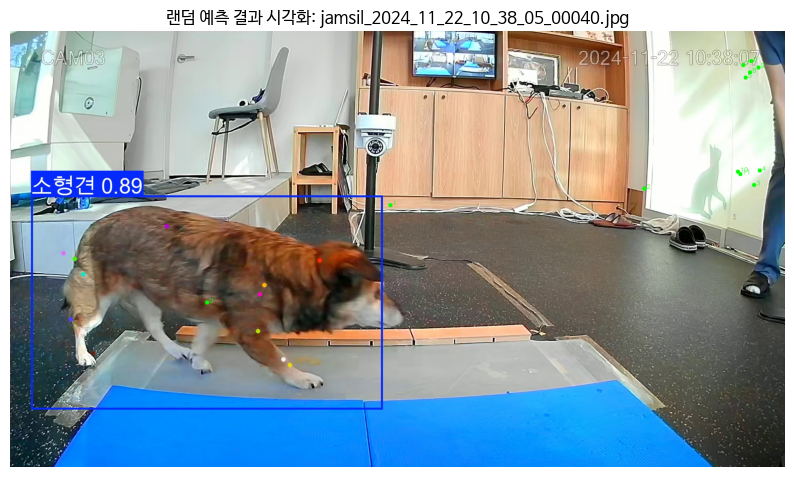

In [ ]:
import os
import cv2
import random
import matplotlib.pyplot as plt

# 경로 설정
image_dir = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs/predict_results"
label_dir = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs/predict_results/labels"

# keypoint 수
num_kpts = 12

# 파일 목록 불러오기
image_files = sorted([f for f in os.listdir(image_dir) if f.endswith(".jpg")])
label_files = sorted([f for f in os.listdir(label_dir) if f.endswith(".txt")])

# 파일명 기준으로 일치하는 페어만 선택
base_names = set(os.path.splitext(f)[0] for f in image_files) & set(os.path.splitext(f)[0] for f in label_files)
base_name = random.choice(list(base_names))  # 🔀 랜덤 선택

# 경로 설정
sample_image_path = os.path.join(image_dir, base_name + ".jpg")
sample_label_path = os.path.join(label_dir, base_name + ".txt")

# 이미지 불러오기
image = cv2.imread(sample_image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
h, w, _ = image.shape

# keypoint 추출
with open(sample_label_path, 'r') as f:
    line = f.readline().strip().split()
    keypoint_values = list(map(float, line[1:]))

keypoints = []
for i in range(num_kpts):
    x = keypoint_values[i * 3] * w
    y = keypoint_values[i * 3 + 1] * h
    v = keypoint_values[i * 3 + 2]
    if v > 0:
        keypoints.append((int(x), int(y)))
    else:
        keypoints.append(None)

# 시각화
for i, pt in enumerate(keypoints):
    if pt:
        cv2.circle(image, pt, 5, (0, 255, 0), -1)
        cv2.putText(image, str(i), (pt[0]+5, pt[1]), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)

# 출력
plt.figure(figsize=(10, 6))
plt.imshow(image)
plt.axis("off")
plt.title(f"랜덤 예측 결과 시각화: {base_name}.jpg")
plt.show()


In [ ]:
# keypoint 점이 너무 많아서(모델 예측 keypoint는 초록색), 원본 형태 확인하기

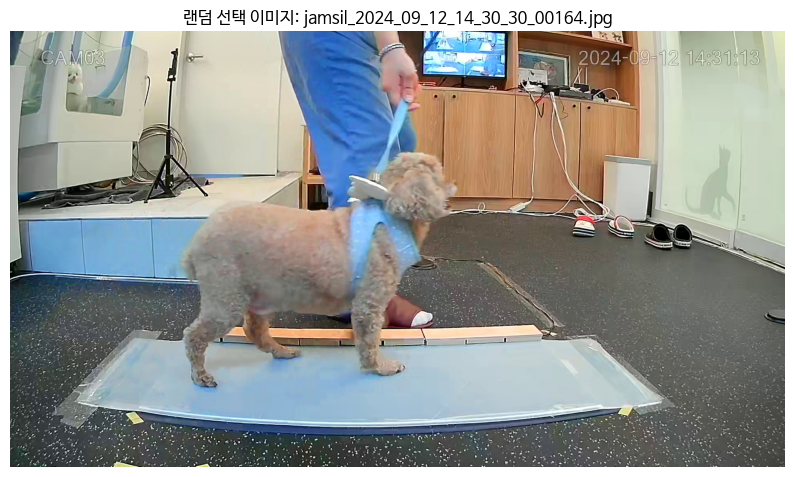

In [ ]:
import os
import cv2
import random
import matplotlib.pyplot as plt

# 이미지 폴더 경로
image_dir = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/test/side_image"

# 이미지 파일 목록 불러오기 (.jpg, .png 등)
image_files = [f for f in os.listdir(image_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

# 이미지가 하나도 없을 경우 예외 처리
if not image_files:
    print("❌ 이미지 파일이 없습니다.")
else:
    # 무작위 선택
    sample_image = random.choice(image_files)
    sample_image_path = os.path.join(image_dir, sample_image)

    # 이미지 읽기 및 RGB 변환
    image = cv2.imread(sample_image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # 시각화
    plt.figure(figsize=(10, 6))
    plt.imshow(image)
    plt.axis("off")
    plt.title(f"랜덤 선택 이미지: {sample_image}")
    plt.show()


In [ ]:
# 결과 해석
box 탐지 우수, 하지만 keypoint 시각화는 엉망, 엉뚱한 바닥에도 점이 찍혀있음
라벨 순서가 제각각 다르잖아, 그러면 라벨 순서가 같은 것끼리 모아서 txt파일로 변환하던가, 라벨 순서 13개 중에 라벨만 4개 있는 경우는 따로 라벨 순서를 지정해서 txt 파일로 학습시켜야하는 건가?
만약 예측 이미지도 다양하고 제각각인데 keypoint의 라벨 개수별로 알아서 학습할 수 있어?


In [ ]:
from ultralytics import YOLO

# 학습한 모델 불러오기
model = YOLO("/content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs/train_pose_model/weights/best.pt")

# validation 수행
metrics = model.val(data="/content/drive/MyDrive/pet_angle_copy/dataset_split2/side.yaml")


Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
YOLOv8m-pose summary (fused): 101 layers, 26,406,370 parameters, 0 gradients, 80.9 GFLOPs


val: Fast image access ✅ (ping: 0.3±0.0 ms, read: 0.7±0.3 MB/s, size: 454.7 KB)


val: Scanning /content/drive/MyDrive/pet_angle_copy/dataset_split2/val/side_image.cache... 79 images, 0 backgrounds, 0 corrupt: 100%|██████████| 79/79 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:14<00:00,  2.84s/it]
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:675: UserWarning: Glyph 49548 (\N{HANGUL SYLLABLE SO}) missing from font(s) DejaVu Sans.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:675: UserWarning: Glyph 54805 (\N{HANGUL SYLLABLE HYEONG}) missing from font(s) DejaVu Sans.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:675: UserWarning: Glyph 44204 (\N{HANGUL SYLLABLE GYEON}) missing from font(s) DejaVu Sans.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:721

                   all         79         79      0.986      0.987      0.995       0.79      0.652      0.671      0.572      0.244
                   소형견         79         79      0.986      0.987      0.995       0.79      0.652      0.671      0.572      0.244
Speed: 0.2ms preprocess, 7.5ms inference, 0.0ms loss, 4.7ms postprocess per image
Results saved to runs/pose/val


In [ ]:
박스 탐지 정확도	매우 우수 (P 98.6%, R 98.7%)
포즈 예측 정확도	보통 이상 (mAP50 = 57.2%, mAP50-95 = 24.4%)

In [ ]:
# /content/runs 를 /content/drive/MyDrive/pet_angle_copy/dataset_split2/side_val_runs로 옮겨줘


In [ ]:
!mv /content/runs /content/drive/MyDrive/pet_angle_copy/dataset_split2/side_val_runs

## 4. Standford Datasets FineTunning 방법 고려

In [ ]:
# Standford Datasets : 2만장 사진, 품종 120 종류 하지만 keypoint 부재
# StanfordExtra Dataset : keypoint 주석만 추가, 좌표값은 부재

In [ ]:
import json

# JSON 파일 경로
json_file_path = "/content/StanfordExtra_v12.json"  # ← 여기에 파일 경로 입력

# JSON 파일 열기
with open(json_file_path, 'r', encoding='utf-8') as f:
    data = json.load(f)

# 첫 번째 항목의 필드(키) 목록 확인
if isinstance(data, list) and len(data) > 0:
    first_item_keys = list(data[0].keys())
    print("🔑 JSON 내 필드 목록:")
    for key in first_item_keys:
        print(f"- {key}")
else:
    print("⚠️ JSON 데이터가 리스트 형식이 아니거나 비어 있습니다.")


🔑 JSON 내 필드 목록:
- img_path
- img_width
- img_height
- img_bbox
- is_multiple_dogs
- joints
- seg


In [ ]:
여기의 json필드 목록은 아래와 같아
🔑 JSON 내 필드 목록:
- img_path
- img_width
- img_height
- img_bbox
- is_multiple_dogs
- joints
- seg

난 keypoint 기반으로 bbox 추론해서 txt파일에 넣어줬잖아, 여기서도 joints 기반으로 bbox 만들어줬으니 냅두고, 이걸 그대로 사용해도 되겠는데,
단점은 여기서의 joints 좌표 값들이랑 나의 슬개골 좌표값들이랑 겹치는 것도 있고 안 겹치는 것도 있는데 어떻게 하면 좋을까?

In [ ]:
import json
from collections import Counter

# JSON 파일 경로
json_file_path = "/content/StanfordExtra_v12.json"  # ← 여기에 파일 경로 입력

# JSON 파일 열기
with open(json_file_path, 'r', encoding='utf-8') as f:
    data = json.load(f)

# is_multiple_dogs 값 카운트
is_multiple_dogs_list = [item.get("is_multiple_dogs") for item in data if "is_multiple_dogs" in item]
count_result = Counter(is_multiple_dogs_list)

# 출력
print("✅ 'is_multiple_dogs' 값 카운트:")
print(f"- True  개수: {count_result[True]}")
print(f"- False 개수: {count_result[False]}")


✅ 'is_multiple_dogs' 값 카운트:
- True  개수: 1
- False 개수: 12537


In [ ]:
import json
# JSON 파일 경로
json_file_path = "/content/StanfordExtra_v12.json"  # ← 여기에 파일 경로 입력

# JSON 파일 열기
with open(json_file_path, 'r', encoding='utf-8') as f:
    data = json.load(f)

# is_multiple_dogs == True 인 항목의 img_path 수집
true_img_paths = [item["img_path"] for item in data if item.get("is_multiple_dogs") is True]

# 출력
print("✅ 'is_multiple_dogs'가 True인 항목들의 img_path 목록:")
for path in true_img_paths:
    print(f"- {path}")

# 0805 이른 오후에 작업했던 누락 파일에 해당되지 않는다.

✅ 'is_multiple_dogs'가 True인 항목들의 img_path 목록:
- n02105251-briard/n02105251_7996.jpg


In [ ]:
[
    (0,  'Left front leg: paw'),
    (1,  'Left front leg: middle joint'),
    (2,  'Left front leg: top'),
    (3,  'Left rear leg: paw'),
    (4,  'Left rear leg: middle joint'),
    (5,  'Left rear leg: top'),

    (6,  'Right front leg: paw'),
    (7,  'Right front leg: middle joint'),
    (8,  'Right front leg: top'),

    (9,  'Right rear leg: paw'),
    (10, 'Right rear leg: middle joint'),
    (11, 'Right rear leg: top'),

    (12, 'Tail start'),
    (13, 'Tail end'),

    (14, 'Base of left ear'),
    (15, 'Base of right ear'),

    (16, 'Nose'),
    (17, 'Chin'),
    (18, 'Left ear tip'),
    (19, 'Right ear tip'),
    (20, 'Left eye'),
    (21, 'Right eye'),
    (22, 'Withers'),
    (23, 'Throat')
]


In [ ]:
[
    (0,  '왼쪽 앞다리: 발'),
    (1,  '왼쪽 앞다리: 중간 관절 (손목)'),
    (2,  '왼쪽 앞다리: 상단 관절 (팔꿈치)'),

    (3,  '왼쪽 뒷다리: 발'),
    (4,  '왼쪽 뒷다리: 중간 관절 (무릎)'),
    (5,  '왼쪽 뒷다리: 상단 관절 (엉덩이 부위)'),

    (6,  '오른쪽 앞다리: 발'),
    (7,  '오른쪽 앞다리: 중간 관절 (손목)'),
    (8,  '오른쪽 앞다리: 상단 관절 (팔꿈치)'),

    (9,  '오른쪽 뒷다리: 발'),
    (10, '오른쪽 뒷다리: 중간 관절 (무릎)'),
    (11, '오른쪽 뒷다리: 상단 관절 (엉덩이 부위)'),

    (12, '꼬리 시작점'),
    (13, '꼬리 끝'),

    (14, '왼쪽 귀의 기저부'),
    (15, '오른쪽 귀의 기저부'),

    (16, '코'),
    (17, '턱'),
    (18, '왼쪽 귀 끝'),
    (19, '오른쪽 귀 끝'),
    (20, '왼쪽 눈'),
    (21, '오른쪽 눈'),
    (22, '등 중앙(견갑 부위)'),
    (23, '목 앞쪽')
]


In [ ]:
| 영어 이름                                              | 한국어 번역                         |
| -------------------------------------------------- | ------------------------------ |
| **Ear**                                            | 귀                              |
| **Distal lateral aspect of fifth metacarpal bone** | 다섯째 중수골의 원위 외측면 (앞발의 바깥쪽 끝)    |
| **Ulnar styloid process**                          | 척골 경상돌기 (앞다리 손목 아래, 척골의 돌기)    |
| **Lateral humeral epicondyle**                     | 상완골 외측상과 (팔꿈치의 바깥쪽 돌기)         |
| **Distal lateral aspect of the fifth metatarsus**  | 다섯째 중족골의 원위 외측면 (뒷발의 바깥쪽 끝)    |
| **Femoral greater trochanter**                     | 대퇴골 대전자 (허벅지뼈 위쪽 돌기, 고관절 근처)   |
| **Lateral malleolus of the distal tibia**          | 경골 말단의 외측 복사뼈 (발목 바깥쪽)         |
| **Femorotibial joint**                             | 대퇴-경골 관절 (무릎관절)                |
| **Iliac crest**                                    | 장골능 (골반뼈의 윗부분)                 |
| **Acromion/Greater tubercle**                      | 견봉 / 상완골 대결절 (어깨뼈 끝 또는 상완골 돌기) |
| **Dorsal scapular spine**                          | 견갑극 (어깨뼈 등쪽 돌기)                |
| **T13 Spinous process**                            | 제13흉추 극돌기 (척추의 등 부위 마지막 가시돌기)  |


In [ ]:
이게 keypoint를 명칭하는 부위가 제각각 독립적인 의미를 지니는데, 비슷한 위치에 있다고 동일한 라벨링으로 매핑해버리면 정밀한 keypoint pose 파악이 어려워지지 않아?
yes, 해부학적으로 다른 의미를 갖는 keypoint를 단순히 위치가 유사하다고 묶어버리면 모델이 "의미의 차이"를 구분하지 못하고, 정밀한 pose 예측이 어려워집니다.
슬개골 진단, 골반 이상 탐지 등은 미세한 위치 변화를 근거로 판단하는데,라벨링이 제각각이면 예측 결과가 해부학적으로 무의미해질 수 있습니다.


In [ ]:
# 선별된 공통 keypoint
common_keypoint_indices = [4, 5, 10, 11, 14, 15, 22]

| 슬개골 keypoint                              | 매핑된 CSV keypoint 이름                | 인덱스          |
| ----------------------------------------- | ---------------------------------- | ------------ |
| **Ear**                                   | Base of left/right ear             | 14, 15       |
| **Femoral greater trochanter**            | Left/Right rear leg: top           | 5, 11        |
| **Lateral malleolus of the distal tibia** | Left/Right rear leg: middle joint  | 4, 10        |
| **Femorotibial joint**                    | Left/Right rear leg: middle or top | 4, 5, 10, 11 |
| **Acromion/Greater tubercle**             | Withers (등, 견갑 부위)                 | 22           |


In [ ]:
# 파인튜닝 고려
그러면 사전학습 모델은 24개의 keypoint로 학습하고, 파인튜닝할 때만 나의 슬개골 keypoint로 추가 학습 가능한거야?

기존의 24개의 keypoint를 사용한 모델 체계는 유지하고, 슬개골 데이터로 재학습시키는 구조이다.
만약 버려야하는 keypoint는 3개가 존재하는데, 슬개골 탈구 파악에 핵심이 되는 역할을 한다. 파인튜닝 할 수 없다.

| Keypoint                  | 역할                      |
| ------------------------- | ----------------------- |
| **Iliac crest**           | 골반 정렬, 고관절 위치 추정에 필요    |
| **Dorsal scapular spine** | 등뼈의 대칭성, 체중 분산 축 판단     |
| **T13 Spinous process**   | 척추 정렬 끝점 → 체형 전체 기울기 판단 |

이 3개는 단순히 "등에 있는 점"이 아니라,
✅ 슬개골이 탈구되는 방향이나 체형의 비대칭을 판별하는 데 쓰이는 기준선 역할을 하는 keypoint입니다.

In [ ]:
# 파인튜닝을 할 수 있는 다른 방향 : 나의 슬개골 데이터 모델 체계 유지 + 파인튜닝(24개의 keypoint 학습셋 2만장)
헐 그러면, 나의 슬개골 데이터를 사전학습용으로 사용하고 24개짜리 keypoint를 파인튜닝으로 사용하면 되자낳아/

더 정교하고 해부학적으로 의미 있는 keypoint로 먼저 학습하면, 이후 일반 keypoint는 더 잘 "맞춰지는" 방향으로 유도 가능

In [ ]:
| 단계             | 사용 데이터       | keypoint 수 | 목표                    |
| -------------- | ------------ | ---------- | --------------------- |
| **1단계 (사전학습)** | 슬개골 전문 데이터   | 12개        | 해부학적으로 정밀한 포즈 인식 학습   |
| **2단계 (파인튜닝)** | 동물 일반 포즈 데이터 | 24개        | 일반 동물 행동, 전체 포즈 예측 확장 |


In [ ]:
⚠️ 조건 & 주의점
1. keypoint 수 변경 필요
사전학습 모델은 12개 keypoint 기준으로 처음부터 학습

이후 24개 keypoint용 모델로 구조를 확장하여 이어 학습

2. 모델 구조 수정 필요
head 출력 크기: 12 * 3 → 24 * 3으로 변경

weight는 backbone + neck은 유지, pose head는 새로운 구조로 교체하거나 확장

3. 학습 코드 커스터마이징 필요
Ultralytics YOLO 코드 기준으로는 조금의 수정이 필요할 수 있음 (예: head 크기 변경, checkpoint 불러오기 등)



In [ ]:
# 헤드 구조 변경해야해? 24개에서 아래 공통된 것만 가져가면 되잖아
common_keypoint_indices = [4, 5, 10, 11, 14, 15, 22]


In [ ]:
그러면 12개의 keypoint로 사전학습, 파인튜닝때는 7개의 keypoint만 학습하는 거네?

In [ ]:
✅ 따라서 정리하면:
💡 사전학습: 12개 keypoint
💡 파인튜닝: 24개 keypoint 구조 유지하되, 7개 keypoint만 학습에 사용

✅ 참고: 이렇게 되면 어떤 효과가 있냐면…
효과	설명
🎯 슬개골 관련 pose 정밀도 ↑	사전학습을 통해 정밀한 학습 기반 확보
🔄 구조적 호환성 ↑	24개 pose 데이터 활용 가능 (일부만 사용)
✅ YOLOv8 구조 변경 없음	head만 확장하고 weight 로딩 시 strict=False 옵션 사용

In [ ]:
# 최종 정리 - 파인튜닝 전략

In [ ]:
공통 7개 keypoint만 학습시키면 0값이 너무 많아서 학습 불가 > 다운스트림 분류기 방식 사용

YOLO는 그 자체로 "정확한 pose feature 추출기"로 쓰이고, 슬개골 탈구 여부는 downstream classifier가 담당하면 된다.

1. YOLO inference → keypoint 추출 → feature vector 생성 코드
2. 관절 각도 계산 함수 모듈화
3. XGBoost/MLP 기반 슬개골 분류기 훈련 코드
4. 전체 파이프라인 연결 (YOLO + 분류기)

In [ ]:
graph TD
    A[이미지 입력] --> B[YOLOv8 pose 모델 (24 keypoints)]
    B --> C[7개 keypoint만 선택]
    C --> D[관절각 계산, feature 추출]
    D --> E[슬개골 탈구 여부 분류기 (예: XGBoost)]


In [ ]:
# npy 파일 해석
고마워, 이제 StanfordExtra_v12.json 값이 있고, npy파일 해석해줄래? 파인튜닝 어떻게 해야하나? 우선 2만장 강아지 사진을 저런식으로 keypoint24개 적용해서 분할한 거 맞지?


In [ ]:
# 이제 npy를 yolo를 위한 txt 변환하기

In [ ]:
import os
import json
import numpy as np

# 경로 설정
json_path = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/StanfordExtra_v12.json"
split_npy_paths = {
    "train": "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/train_stanford_StanfordExtra_v12.npy",
    "val": "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/val_stanford_StanfordExtra_v12.npy",
    "test": "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/test_stanford_StanfordExtra_v12.npy"
}
output_dir = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/yolo_txt"  # 결과 저장 폴더
os.makedirs(output_dir, exist_ok=True)

# JSON 로드
with open(json_path, 'r') as f:
    data = json.load(f)

# split별 처리
for split_name, npy_path in split_npy_paths.items():
    indices = np.load(npy_path)

    split_dir = os.path.join(output_dir, split_name)
    os.makedirs(split_dir, exist_ok=True)

    for idx in indices:
        item = data[int(idx)]

        # 파일명 생성
        img_name = os.path.splitext(os.path.basename(item["img_path"]))[0]
        txt_path = os.path.join(split_dir, img_name + ".txt")

        # bbox 정보
        x, y, w, h = item["img_bbox"]
        img_w = item["img_width"]
        img_h = item["img_height"]
        x_center = (x + w / 2) / img_w
        y_center = (y + h / 2) / img_h
        bbox_w = w / img_w
        bbox_h = h / img_h

        # keypoints (정규화 + v 값 포함)
        keypoints = item["joints"]
        keypoints_flat = []
        for kp in keypoints:
            kx, ky, v = kp
            norm_x = kx / img_w if v != 0 else 0.0
            norm_y = ky / img_h if v != 0 else 0.0
            keypoints_flat.extend([round(norm_x, 6), round(norm_y, 6), v])

        # YOLO 포맷으로 저장
        with open(txt_path, 'w') as f:
            all_values = [0, round(x_center, 6), round(y_center, 6), round(bbox_w, 6), round(bbox_h, 6)] + keypoints_flat
            f.write(" ".join(map(str, all_values)) + "\n")

print("✅ YOLO 포맷 변환 완료")


✅ YOLO 포맷 변환 완료


In [ ]:
# 1차 성공, 하지만 train과 val, test에 맞게 각각 txt 파일 구분 필요- 위의 코드는 train만 되어있음

In [ ]:
train만 .txt가 생성되고, val과 test는 생성되지 않은 이유는 .npy 파일 안의 값이 int가 아닌 str일 수도 있고, .json의 인덱스와 매칭이 잘 안 되는 경우 고려
idx를 int로 명확히 변환 (int(idx))

`범위를 벗어나는 인덱스는 스킵**

In [ ]:
import os
import json
import numpy as np

# 경로 설정
json_path = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/StanfordExtra_v12.json"
split_npy_paths = {
    "train": "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/train_stanford_StanfordExtra_v12.npy",
    "val": "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/val_stanford_StanfordExtra_v12.npy",
    "test": "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/test_stanford_StanfordExtra_v12.npy"
}
output_dir = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/yolo_txt2"
os.makedirs(output_dir, exist_ok=True)

# JSON 로드
with open(json_path, 'r') as f:
    data = json.load(f)

# split별 처리
for split_name, npy_path in split_npy_paths.items():
    indices = np.load(npy_path, allow_pickle=True)
    split_dir = os.path.join(output_dir, split_name)
    os.makedirs(split_dir, exist_ok=True)

    print(f"🔹 Processing split: {split_name} ({len(indices)} samples)")
    skipped = 0

    for idx in indices:
        idx = int(idx)
        if idx >= len(data):
            skipped += 1
            continue  # JSON 범위 벗어나면 skip

        item = data[idx]

        # 파일명 생성
        img_name = os.path.splitext(os.path.basename(item["img_path"]))[0]
        txt_path = os.path.join(split_dir, img_name + ".txt")

        # bbox 정보
        x, y, w, h = item["img_bbox"]
        img_w = item["img_width"]
        img_h = item["img_height"]
        x_center = (x + w / 2) / img_w
        y_center = (y + h / 2) / img_h
        bbox_w = w / img_w
        bbox_h = h / img_h

        # keypoints (정규화 + v 값 포함)
        keypoints = item["joints"]
        keypoints_flat = []
        for kp in keypoints:
            kx, ky, v = kp
            norm_x = kx / img_w if v != 0 else 0.0
            norm_y = ky / img_h if v != 0 else 0.0
            keypoints_flat.extend([round(norm_x, 6), round(norm_y, 6), v])

        # YOLO 포맷으로 저장
        with open(txt_path, 'w') as f:
            all_values = [0, round(x_center, 6), round(y_center, 6), round(bbox_w, 6), round(bbox_h, 6)] + keypoints_flat
            f.write(" ".join(map(str, all_values)) + "\n")

    print(f"✅ {split_name}: 완료 ({len(indices) - skipped}개 생성, {skipped}개 스킵됨)\n")


🔹 Processing split: train (6773 samples)
✅ train: 완료 (6773개 생성, 0개 스킵됨)

🔹 Processing split: val (4062 samples)
✅ val: 완료 (4062개 생성, 0개 스킵됨)

🔹 Processing split: test (1703 samples)
✅ test: 완료 (1703개 생성, 0개 스킵됨)



In [ ]:
# 하지만 파일명 걱정
실제 파일명은 품종/파일명.jpg인데, 위의 txt파일은 파일명.txt로 생성 완료 = 아래 코드 결과, train.npy에서 사용한 파일명은 품종/파일명.jpg로 되어있음
또다른 우려사항 : 분할 기준을 알아도, 랜덤 샘플링해서 분할하면 해당 npy와 지금의 이미지와 어떻게 체제 유지할 수 있나 - 아래 추출된 파일명 기준으로 분할하면 된다. (해결)

In [ ]:
import numpy as np
import json

# 경로 설정
json_path = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/StanfordExtra_v12.json"
npy_path = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/train_stanford_StanfordExtra_v12.npy"  # 업로드된 npy

# JSON 로드
with open(json_path, 'r') as f:
    json_data = json.load(f)

# 인덱스 로드
indices = np.load(npy_path)

# 해당 인덱스에 매칭되는 이미지 경로만 추출
image_paths = [json_data[int(idx)]["img_path"] for idx in indices]

# 결과 출력
for path in image_paths:
    print(path)

# 필요하다면 저장도 가능
with open("used_image_paths.txt", "w") as f:
    for path in image_paths:
        f.write(path + "\n")

print("✅ 이미지 경로 추출 완료")


n02085620-Chihuahua/n02085620_10074.jpg
n02085620-Chihuahua/n02085620_10131.jpg
n02085620-Chihuahua/n02085620_10621.jpg
n02085620-Chihuahua/n02085620_1073.jpg
n02085620-Chihuahua/n02085620_10976.jpg
n02085620-Chihuahua/n02085620_11140.jpg
n02085620-Chihuahua/n02085620_11337.jpg
n02085620-Chihuahua/n02085620_11818.jpg
n02085620-Chihuahua/n02085620_11948.jpg
n02085620-Chihuahua/n02085620_13151.jpg
n02085620-Chihuahua/n02085620_1321.jpg
n02085620-Chihuahua/n02085620_13964.jpg
n02085620-Chihuahua/n02085620_14413.jpg
n02085620-Chihuahua/n02085620_1502.jpg
n02085620-Chihuahua/n02085620_1558.jpg
n02085620-Chihuahua/n02085620_1816.jpg
n02085620-Chihuahua/n02085620_1862.jpg
n02085620-Chihuahua/n02085620_1916.jpg
n02085620-Chihuahua/n02085620_199.jpg
n02085620-Chihuahua/n02085620_2053.jpg
n02085620-Chihuahua/n02085620_2204.jpg
n02085620-Chihuahua/n02085620_2208.jpg
n02085620-Chihuahua/n02085620_242.jpg
n02085620-Chihuahua/n02085620_2479.jpg
n02085620-Chihuahua/n02085620_2590.jpg
n02085620-Chihua

In [ ]:
# 우선, 파인튜닝 이미지 (이미 분할된 npy에 맞게 이미지 파일 골라내는 작업) - train, val, test.npy에서 사용된 파일명 확인 가능

npy에서 추출한 파일명 : n02111129-Leonberg/n02111129_1215.jpg
❗ 이미지 없음: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/Images/n02086646-Blenheim_spaniel/n02086646_3429.jpg

=> 상대 경로 값은 제외하고 실질적인 경로의 시작위치점을 기준으로 파일명 찾기

In [ ]:
import os
import json
import numpy as np
import shutil

# 경로 설정
json_path = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/StanfordExtra_v12.json"
npy_paths = {
    "train": "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/train_stanford_StanfordExtra_v12.npy",
    "val": "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/val_stanford_StanfordExtra_v12.npy",
    "test": "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/test_stanford_StanfordExtra_v12.npy"
}

original_images_root = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/Images"  # 실제 이미지가 저장된 루트 폴더
output_root = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning"  # train/val/test 폴더들이 생성될 곳

# JSON 로드
with open(json_path, 'r') as f:
    data = json.load(f)

# 각 split 처리
for split_name, npy_path in npy_paths.items():
    indices = np.load(npy_path)
    split_dir = os.path.join(output_root, split_name)
    os.makedirs(split_dir, exist_ok=True)

    for idx in indices:
        item = data[int(idx)]
        rel_path = item["img_path"]  # 예: n02085782-Japanese_spaniel/n02085782_2886.jpg
        src_path = os.path.join(original_images_root, rel_path)
        dst_path = os.path.join(split_dir, os.path.basename(rel_path))  # 이름만 복사

        # 디렉토리가 없는 경우 무시하고 복사
        if not os.path.exists(src_path):
            print(f"❗ 이미지 없음: {src_path}")
            continue

        shutil.copy2(src_path, dst_path)  # 메타데이터까지 유지하면서 복사

print("✅ 이미지 분할 복사 완료")


❗ 이미지 없음: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/Images/n02085620-Chihuahua/n02085620_10074.jpg
❗ 이미지 없음: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/Images/n02085620-Chihuahua/n02085620_10131.jpg
❗ 이미지 없음: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/Images/n02085620-Chihuahua/n02085620_10621.jpg
❗ 이미지 없음: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/Images/n02085620-Chihuahua/n02085620_1073.jpg
❗ 이미지 없음: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/Images/n02085620-Chihuahua/n02085620_10976.jpg
❗ 이미지 없음: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/Images/n02085620-Chihuahua/n02085620_11140.jpg
❗ 이미지 없음: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/Images/n02085620-Chihuahua/n02085620_11337.jpg
❗ 이미지 없음: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/Images/n02085620-Chihuahua/n02085620_11818.jpg
❗ 이미지 없음: /content/drive/

KeyboardInterrupt: 

In [ ]:
# 상대 경로 값(/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/Images/)은 제외하고 실질적인 경로의 시작위치점을 기준으로 파일명 찾기 => 성공

In [ ]:
!rm -r /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/split_images

In [ ]:
import os
import shutil
import numpy as np

# 경로 설정
original_images_root = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/Images"  # 전체 이미지가 있는 상위 폴더
split_npy_paths = {
    "train": "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/train_stanford_StanfordExtra_v12.npy",
    "val": "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/val_stanford_StanfordExtra_v12.npy",
    "test": "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/test_stanford_StanfordExtra_v12.npy"
}
json_path = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/StanfordExtra_v12.json"
output_base_dir = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/split_images2"

# JSON 로드
import json
with open(json_path, "r") as f:
    data = json.load(f)

# 분할 및 이미지 복사
for split_name, npy_path in split_npy_paths.items():
    indices = np.load(npy_path, allow_pickle=True)

    split_output_dir = os.path.join(output_base_dir, split_name)
    os.makedirs(split_output_dir, exist_ok=True)

    missing_files = []

    for idx in indices:
        idx = int(idx)
        img_rel_path = data[idx]["img_path"]  # 예: 'n02111129-Leonberg/n02111129_1215.jpg'

        src_path = os.path.join(original_images_root, img_rel_path)
        dst_path = os.path.join(split_output_dir, img_rel_path)

        if os.path.exists(src_path):
            os.makedirs(os.path.dirname(dst_path), exist_ok=True)
            shutil.copy2(src_path, dst_path)
        else:
            missing_files.append(src_path)

    print(f"✅ {split_name} 이미지 복사 완료. 총 {len(indices)}개 중 누락 {len(missing_files)}개")
    if missing_files:
        print("❗ 누락 파일 목록:")
        for f in missing_files[:10]:  # 너무 많으면 처음 10개만
            print("   -", f)


✅ train 이미지 복사 완료. 총 6773개 중 누락 6547개
❗ 누락 파일 목록:
   - /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/Images/n02085620-Chihuahua/n02085620_368.jpg
   - /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/Images/n02085620-Chihuahua/n02085620_3681.jpg
   - /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/Images/n02085620-Chihuahua/n02085620_382.jpg
   - /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/Images/n02085620-Chihuahua/n02085620_3838.jpg
   - /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/Images/n02085620-Chihuahua/n02085620_4159.jpg
   - /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/Images/n02085620-Chihuahua/n02085620_4207.jpg
   - /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/Images/n02085620-Chihuahua/n02085620_4290.jpg
   - /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/Images/n02085620-Chihuahua/n02085620_4441.jpg
   - /content/drive/MyDr

In [ ]:
# 누락된 파일 목록 찾기
누락된 파일 목록들 전부 /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/Images 폴더에 있는지 확인하는 파이썬 코드 작성해줘
원본 이미지에는 없고 npy에 있는 파일들 확인 완료

In [ ]:
import os
# n02105251-briard/n02105251_7996.jpg (multipule-dogs값이 true인 이미지 파일, 아래 누락 파일에 해당 x)
# 기준 이미지 루트 경로
images_root = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/Images"

# 누락된 이미지의 전체 경로 목록 (복붙된 경로에서 루트 제거한 상대 경로만 추출)
missing_files = [
    "n02085620-Chihuahua/n02085620_368.jpg",
    "n02085620-Chihuahua/n02085620_3681.jpg",
    "n02085620-Chihuahua/n02085620_382.jpg",
    "n02085620-Chihuahua/n02085620_3838.jpg",
    "n02085620-Chihuahua/n02085620_4159.jpg",
    "n02085620-Chihuahua/n02085620_4207.jpg",
    "n02085620-Chihuahua/n02085620_4290.jpg",
    "n02085620-Chihuahua/n02085620_4441.jpg",
    "n02085620-Chihuahua/n02085620_4515.jpg",
    "n02085620-Chihuahua/n02085620_4572.jpg",

    "n02091134-whippet/n02091134_20065.jpg",
    "n02085782-Japanese_spaniel/n02085782_3720.jpg",
    "n02087394-Rhodesian_ridgeback/n02087394_4741.jpg",
    "n02091134-whippet/n02091134_7232.jpg",
    "n02087394-Rhodesian_ridgeback/n02087394_6495.jpg",
    "n02087394-Rhodesian_ridgeback/n02087394_7724.jpg",
    "n02087394-Rhodesian_ridgeback/n02087394_7875.jpg",
    "n02091244-Ibizan_hound/n02091244_1340.jpg",
    "n02091244-Ibizan_hound/n02091244_1496.jpg",
    "n02091244-Ibizan_hound/n02091244_2115.jpg",

    "n02085620-Chihuahua/n02085620_3651.jpg",
    "n02085620-Chihuahua/n02085620_3742.jpg",
    "n02085620-Chihuahua/n02085620_3975.jpg",
    "n02085620-Chihuahua/n02085620_4016.jpg",
    "n02085620-Chihuahua/n02085620_4814.jpg",
    "n02085620-Chihuahua/n02085620_500.jpg",
    "n02085620-Chihuahua/n02085620_6399.jpg",
    "n02085620-Chihuahua/n02085620_712.jpg",
    "n02085620-Chihuahua/n02085620_7292.jpg",
    "n02085782-Japanese_spaniel/n02085782_2886.jpg"
]

# 존재 여부 확인
print("🔍 파일 존재 여부 확인 결과:")
for rel_path in missing_files:
    full_path = os.path.join(images_root, rel_path)
    if os.path.exists(full_path):
        print(f"✅ 존재함: {rel_path}")
    else:
        print(f"❌ 없음: {rel_path}")


🔍 파일 존재 여부 확인 결과:
❌ 없음: n02085620-Chihuahua/n02085620_368.jpg
❌ 없음: n02085620-Chihuahua/n02085620_3681.jpg
❌ 없음: n02085620-Chihuahua/n02085620_382.jpg
❌ 없음: n02085620-Chihuahua/n02085620_3838.jpg
❌ 없음: n02085620-Chihuahua/n02085620_4159.jpg
❌ 없음: n02085620-Chihuahua/n02085620_4207.jpg
❌ 없음: n02085620-Chihuahua/n02085620_4290.jpg
❌ 없음: n02085620-Chihuahua/n02085620_4441.jpg
❌ 없음: n02085620-Chihuahua/n02085620_4515.jpg
❌ 없음: n02085620-Chihuahua/n02085620_4572.jpg
❌ 없음: n02091134-whippet/n02091134_20065.jpg
❌ 없음: n02085782-Japanese_spaniel/n02085782_3720.jpg
❌ 없음: n02087394-Rhodesian_ridgeback/n02087394_4741.jpg
❌ 없음: n02091134-whippet/n02091134_7232.jpg
❌ 없음: n02087394-Rhodesian_ridgeback/n02087394_6495.jpg
❌ 없음: n02087394-Rhodesian_ridgeback/n02087394_7724.jpg
❌ 없음: n02087394-Rhodesian_ridgeback/n02087394_7875.jpg
❌ 없음: n02091244-Ibizan_hound/n02091244_1340.jpg
❌ 없음: n02091244-Ibizan_hound/n02091244_1496.jpg
❌ 없음: n02091244-Ibizan_hound/n02091244_2115.jpg
❌ 없음: n02085620-Chihuahua/n0208

In [ ]:
print(f"누락된 파일 개수: {len(missing_files)}")
# 각각 10개씩 누락되어있는데, npy와 연동된 거잖아, 해당 npy에 연동된 txt 파일만 제거하면 되지?

누락된 파일 개수: 30


In [ ]:
# /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/yolo_txt2
# /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/yolo_txt2/train
# /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/yolo_txt2/val
# /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/yolo_txt2/test

파일명은 n02116738_7026.txt 되어 있고, 우선 누락된 파일이 txt 파일에 있는지 확인하고 삭제


In [ ]:
# 1. 확인 코드 (누락 이미지에 해당하는 txt 파일 존재 확인)

In [ ]:
import os

# ✅ 누락된 이미지 파일 경로를 split별로 정리
missing_by_split = {
    "train": [
        "n02085620-Chihuahua/n02085620_368.jpg",
        "n02085620-Chihuahua/n02085620_3681.jpg",
        "n02085620-Chihuahua/n02085620_382.jpg",
        "n02085620-Chihuahua/n02085620_3838.jpg",
        "n02085620-Chihuahua/n02085620_4159.jpg",
        "n02085620-Chihuahua/n02085620_4207.jpg",
        "n02085620-Chihuahua/n02085620_4290.jpg",
        "n02085620-Chihuahua/n02085620_4441.jpg",
        "n02085620-Chihuahua/n02085620_4515.jpg",
        "n02085620-Chihuahua/n02085620_4572.jpg",
    ],
    "val": [
        "n02091134-whippet/n02091134_20065.jpg",
        "n02085782-Japanese_spaniel/n02085782_3720.jpg",
        "n02087394-Rhodesian_ridgeback/n02087394_4741.jpg",
        "n02091134-whippet/n02091134_7232.jpg",
        "n02087394-Rhodesian_ridgeback/n02087394_6495.jpg",
        "n02087394-Rhodesian_ridgeback/n02087394_7724.jpg",
        "n02087394-Rhodesian_ridgeback/n02087394_7875.jpg",
        "n02091244-Ibizan_hound/n02091244_1340.jpg",
        "n02091244-Ibizan_hound/n02091244_1496.jpg",
        "n02091244-Ibizan_hound/n02091244_2115.jpg",
    ],
    "test": [
        "n02085620-Chihuahua/n02085620_3651.jpg",
        "n02085620-Chihuahua/n02085620_3742.jpg",
        "n02085620-Chihuahua/n02085620_3975.jpg",
        "n02085620-Chihuahua/n02085620_4016.jpg",
        "n02085620-Chihuahua/n02085620_4814.jpg",
        "n02085620-Chihuahua/n02085620_500.jpg",
        "n02085620-Chihuahua/n02085620_6399.jpg",
        "n02085620-Chihuahua/n02085620_712.jpg",
        "n02085620-Chihuahua/n02085620_7292.jpg",
        "n02085782-Japanese_spaniel/n02085782_2886.jpg",
    ],
}

# ✅ .txt 파일이 저장된 경로
base_txt_path = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/yolo_txt2"

# ✅ 각 split에 대해 존재 여부 확인
for split, missing_list in missing_by_split.items():
    print(f"\n📁 Checking {split.upper()} split:")
    split_txt_dir = os.path.join(base_txt_path, split)

    for image_path in missing_list:
        # 파일명만 추출 (예: n02085620_368)
        filename_wo_ext = os.path.splitext(os.path.basename(image_path))[0]
        txt_file_path = os.path.join(split_txt_dir, f"{filename_wo_ext}.txt")

        if os.path.exists(txt_file_path):
            print(f"✅ 존재함: {txt_file_path}")
        else:
            print(f"❌ 없음:   {txt_file_path}")



📁 Checking TRAIN split:
✅ 존재함: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/yolo_txt2/train/n02085620_368.txt
✅ 존재함: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/yolo_txt2/train/n02085620_3681.txt
✅ 존재함: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/yolo_txt2/train/n02085620_382.txt
✅ 존재함: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/yolo_txt2/train/n02085620_3838.txt
✅ 존재함: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/yolo_txt2/train/n02085620_4159.txt
✅ 존재함: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/yolo_txt2/train/n02085620_4207.txt
✅ 존재함: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/yolo_txt2/train/n02085620_4290.txt
✅ 존재함: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/yolo_txt2/train/n02085620_4441.txt
✅ 존재함: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/yolo_txt2/train/n02085620_4515.txt
✅ 존재함: /conten

In [ ]:
# 2. 삭제 코드 (누락 이미지에 해당하는 txt 파일 삭제)

In [ ]:
import os

# ✅ 누락된 이미지 파일 경로를 split별로 정리
missing_by_split = {
    "train": [
        "n02085620-Chihuahua/n02085620_368.jpg",
        "n02085620-Chihuahua/n02085620_3681.jpg",
        "n02085620-Chihuahua/n02085620_382.jpg",
        "n02085620-Chihuahua/n02085620_3838.jpg",
        "n02085620-Chihuahua/n02085620_4159.jpg",
        "n02085620-Chihuahua/n02085620_4207.jpg",
        "n02085620-Chihuahua/n02085620_4290.jpg",
        "n02085620-Chihuahua/n02085620_4441.jpg",
        "n02085620-Chihuahua/n02085620_4515.jpg",
        "n02085620-Chihuahua/n02085620_4572.jpg",
    ],
    "val": [
        "n02091134-whippet/n02091134_20065.jpg",
        "n02085782-Japanese_spaniel/n02085782_3720.jpg",
        "n02087394-Rhodesian_ridgeback/n02087394_4741.jpg",
        "n02091134-whippet/n02091134_7232.jpg",
        "n02087394-Rhodesian_ridgeback/n02087394_6495.jpg",
        "n02087394-Rhodesian_ridgeback/n02087394_7724.jpg",
        "n02087394-Rhodesian_ridgeback/n02087394_7875.jpg",
        "n02091244-Ibizan_hound/n02091244_1340.jpg",
        "n02091244-Ibizan_hound/n02091244_1496.jpg",
        "n02091244-Ibizan_hound/n02091244_2115.jpg",
    ],
    "test": [
        "n02085620-Chihuahua/n02085620_3651.jpg",
        "n02085620-Chihuahua/n02085620_3742.jpg",
        "n02085620-Chihuahua/n02085620_3975.jpg",
        "n02085620-Chihuahua/n02085620_4016.jpg",
        "n02085620-Chihuahua/n02085620_4814.jpg",
        "n02085620-Chihuahua/n02085620_500.jpg",
        "n02085620-Chihuahua/n02085620_6399.jpg",
        "n02085620-Chihuahua/n02085620_712.jpg",
        "n02085620-Chihuahua/n02085620_7292.jpg",
        "n02085782-Japanese_spaniel/n02085782_2886.jpg",
    ],
}

# ✅ .txt 파일이 저장된 base 경로
base_txt_path = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/yolo_txt2"

# ✅ 각 split별 누락 파일 .txt 삭제
for split, missing_list in missing_by_split.items():
    print(f"\n🧹 Deleting missing TXT in {split.upper()} set:")
    split_txt_dir = os.path.join(base_txt_path, split)

    for image_path in missing_list:
        filename_wo_ext = os.path.splitext(os.path.basename(image_path))[0]
        txt_file_path = os.path.join(split_txt_dir, f"{filename_wo_ext}.txt")

        if os.path.exists(txt_file_path):
            os.remove(txt_file_path)
            print(f"🗑️ 삭제됨: {txt_file_path}")
        else:
            print(f"⚠️ 삭제 실패(없음): {txt_file_path}")



🧹 Deleting missing TXT in TRAIN set:
🗑️ 삭제됨: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/yolo_txt2/train/n02085620_368.txt
🗑️ 삭제됨: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/yolo_txt2/train/n02085620_3681.txt
🗑️ 삭제됨: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/yolo_txt2/train/n02085620_382.txt
🗑️ 삭제됨: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/yolo_txt2/train/n02085620_3838.txt
🗑️ 삭제됨: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/yolo_txt2/train/n02085620_4159.txt
🗑️ 삭제됨: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/yolo_txt2/train/n02085620_4207.txt
🗑️ 삭제됨: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/yolo_txt2/train/n02085620_4290.txt
🗑️ 삭제됨: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/yolo_txt2/train/n02085620_4441.txt
🗑️ 삭제됨: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/yolo_txt2/train/n02085620_4

# npy에 있지만, 원본에는 이미지 파일 제거하기 (파인튜닝용)

In [ ]:
# npy에 있지만, 원본에 없는 파일 목록 직접 확인 완료 ----------------------------------------------
import os

# ✅ split별 누락된 이미지 목록
missing_by_split = {
    "train": [
        "n02085620-Chihuahua/n02085620_368.jpg",
        "n02085620-Chihuahua/n02085620_3681.jpg",
        "n02085620-Chihuahua/n02085620_382.jpg",
        "n02085620-Chihuahua/n02085620_3838.jpg",
        "n02085620-Chihuahua/n02085620_4159.jpg",
        "n02085620-Chihuahua/n02085620_4207.jpg",
        "n02085620-Chihuahua/n02085620_4290.jpg",
        "n02085620-Chihuahua/n02085620_4441.jpg",
        "n02085620-Chihuahua/n02085620_4515.jpg",
        "n02085620-Chihuahua/n02085620_4572.jpg",
    ],
    "val": [
        "n02091134-whippet/n02091134_20065.jpg",
        "n02085782-Japanese_spaniel/n02085782_3720.jpg",
        "n02087394-Rhodesian_ridgeback/n02087394_4741.jpg",
        "n02091134-whippet/n02091134_7232.jpg",
        "n02087394-Rhodesian_ridgeback/n02087394_6495.jpg",
        "n02087394-Rhodesian_ridgeback/n02087394_7724.jpg",
        "n02087394-Rhodesian_ridgeback/n02087394_7875.jpg",
        "n02091244-Ibizan_hound/n02091244_1340.jpg",
        "n02091244-Ibizan_hound/n02091244_1496.jpg",
        "n02091244-Ibizan_hound/n02091244_2115.jpg",
    ],
    "test": [
        "n02085620-Chihuahua/n02085620_3651.jpg",
        "n02085620-Chihuahua/n02085620_3742.jpg",
        "n02085620-Chihuahua/n02085620_3975.jpg",
        "n02085620-Chihuahua/n02085620_4016.jpg",
        "n02085620-Chihuahua/n02085620_4814.jpg",
        "n02085620-Chihuahua/n02085620_500.jpg",
        "n02085620-Chihuahua/n02085620_6399.jpg",
        "n02085620-Chihuahua/n02085620_712.jpg",
        "n02085620-Chihuahua/n02085620_7292.jpg",
        "n02085782-Japanese_spaniel/n02085782_2886.jpg",
    ],
}

# ✅ 원본 이미지가 저장된 base 경로
original_img_dir = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/split_images2"

# ✅ 존재 여부 확인
for split, missing_list in missing_by_split.items():
    print(f"\n🔍 Checking existence of missing images in {split.upper()} set:")
    for relative_path in missing_list:
        full_img_path = os.path.join(original_img_dir, relative_path)
        if os.path.exists(full_img_path):
            print(f"✅ 있음: {full_img_path}")
        else:
            print(f"❌ 없음: {full_img_path}")



🔍 Checking existence of missing images in TRAIN set:
❌ 없음: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/split_images2/n02085620-Chihuahua/n02085620_368.jpg
❌ 없음: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/split_images2/n02085620-Chihuahua/n02085620_3681.jpg
❌ 없음: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/split_images2/n02085620-Chihuahua/n02085620_382.jpg
❌ 없음: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/split_images2/n02085620-Chihuahua/n02085620_3838.jpg
❌ 없음: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/split_images2/n02085620-Chihuahua/n02085620_4159.jpg
❌ 없음: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/split_images2/n02085620-Chihuahua/n02085620_4207.jpg
❌ 없음: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/split_images2/n02085620-Chihuahua/n02085620_4290.jpg
❌ 없음: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/split_ima

# npy 파일(확장자) : 실제 사용 가능한 필드 목록 확인

In [ ]:
import numpy as np

# npy 파일 경로
npy_path = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/train_stanford_StanfordExtra_v12.npy"  # 🔁 파일 경로 수정

# npy 로드
data = np.load(npy_path, allow_pickle=True)

# 데이터 타입 확인
print("✅ 데이터 타입:", type(data))

# 구조 분기
if isinstance(data, np.ndarray):
    if data.dtype.names:
        print("✅ 구조화된 배열입니다. 필드 목록:")
        print(data.dtype.names)
    elif isinstance(data[0], dict):
        print("✅ 배열 내부에 dict 구조 포함. 예시 키 목록:")
        print(list(data[0].keys()))
    else:
        print("✅ 일반 배열입니다. shape:", data.shape)
        print("예시 값:", data[0])
elif isinstance(data, dict):
    print("✅ 딕셔너리 형식입니다. 포함된 키:")
    print(list(data.keys()))
else:
    print("⚠️ 알 수 없는 구조입니다.")


✅ 데이터 타입: <class 'numpy.ndarray'>
✅ 일반 배열입니다. shape: (6773,)
예시 값: 910


In [ ]:
📌 가능한 사용 목적
이런 구조는 보통 다음과 같은 경우에 사용됩니다:

이미지 파일 인덱스 목록
→ 예: 전체 이미지 목록에서 선택된 샘플의 인덱스를 따로 저장해놓은 것
(ex: train/test/val용 인덱스 번호)

클래스 라벨 리스트
→ 예: 6773개의 이미지에 대한 정답 라벨이 숫자로 저장됨

파일 이름 인덱스 매핑용
→ 예: 다른 JSON이나 리스트에 있는 [filenames[i] for i in npy] 형태로 사용

In [ ]:
# 결론
.npy는 일반적으로 JSON이나 리스트 형태의 전체 이미지 메타 정보와 매핑하기 위한 인덱스 용도로 사용한다.

1) json : 전체 메타 정보
이미지를 표현하는 다양한 정보(경로, 파일명, 크기, bbox, keypoint, joints 좌표값)를 가진 전체 메타정보를 저장

2) npy : 인덱스 저장
전체 json에서 사용할 인덱스 리스트로, 학습/검증/테스트 데이터로 나누기 위해 사용


In [ ]:
# npy 사용 이유
1) 속도
numpy의 내부구조를 그대로 이진 형태로 저장, 불필요한 파싱 없이 바로 메모리에 로드 가능

2) 공간 절약 - 저장 용량 작음
동일한 데이터를 csv나 json으로 저장할 때보다 파일 크기 작음

3) 데이터 타입 보존
정확한 자료형 정보가 손실되지 않고, pickle보다 안전하고 직관적이다.

4) 편리한 사용
파이썬 리스토보다 속도, 성능, 일관성 우수
save() 메서드와 load() 메서드로 간편 사용

이러한 npy는 데이터 타입과 배열 형태, 실제 데이터를 담는다.

# txt 파일명에 폴더 품종/파일명.txt를 생성 불가, 폴더품종 제외하고 실제 파일명 중복 여부 확인

In [ ]:
import json
from collections import Counter

# JSON 파일 경로
json_path = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/StanfordExtra_v12.json"

# JSON 로드
with open(json_path, "r") as f:
    data = json.load(f)

# 파일명만 추출
filenames = [item["img_path"].split("/")[-1] for item in data]

# 중복 확인
filename_counts = Counter(filenames)
duplicates = {fname: count for fname, count in filename_counts.items() if count > 1}

# 결과 출력
print(f"🔍 전체 파일 수: {len(filenames)}")
print(f"⚠️ 중복된 파일명 수: {len(duplicates)}")

if duplicates:
    print("\n📄 중복 파일 목록 (파일명: 중복 횟수):")
    for fname, count in duplicates.items():
        print(f" - {fname}: {count}회")
else:
    print("✅ 중복된 파일명이 없습니다.")


🔍 전체 파일 수: 12538
⚠️ 중복된 파일명 수: 0
✅ 중복된 파일명이 없습니다.


In [ ]:
# 실제 파인튜닝에 사용되는 데이터 개수 재확인하기

In [ ]:
# /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/split_images2
# /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/yolo_txt2
각각 하위 폴더가 train, val, test가 있어

그리고 아래 경로는 이게 끝이야, 파일 개수 세줘
/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/Images

In [ ]:
import os

# 폴더 경로 설정
base_dirs = {
    "split_images2": "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/split_images2",
    "yolo_txt2": "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/yolo_txt2",
    "Images": "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/Images",
}

# 파일 개수 세는 함수
def count_files_in_dir(path):
    if not os.path.exists(path):
        return "❌ 폴더 없음"
    if os.path.isdir(path):
        count = 0
        for root, _, files in os.walk(path):
            count += len([f for f in files if not f.startswith('.')])
        return count
    return "❌ 유효한 디렉토리가 아님"

# 결과 출력
for name, path in base_dirs.items():
    print(f"\n📁 {name} 경로 확인:")
    if name != "Images":
        for split in ["train", "val", "test"]:
            split_path = os.path.join(path, split)
            count = count_files_in_dir(split_path)
            print(f"  └─ {split}: {count}개")
    else:
        count = count_files_in_dir(path)
        print(f"  └─ 전체 이미지 파일 수: {count}개")



📁 split_images2 경로 확인:
  └─ train: 226개
  └─ val: 86개
  └─ test: 44개

📁 yolo_txt2 경로 확인:
  └─ train: 6763개
  └─ val: 4052개
  └─ test: 1693개

📁 Images 경로 확인:
  └─ 전체 이미지 파일 수: 462개


In [ ]:
import os

# 이미지가 들어 있는 최상위 폴더 경로
image_root = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/Images"

# 카운트할 이미지 확장자 목록
image_extensions = [".jpg", ".jpeg", ".png", ".bmp", ".webp"]

# 전체 이미지 파일 수 카운트
image_count = 0

for root, dirs, files in os.walk(image_root):
    for file in files:
        if any(file.lower().endswith(ext) for ext in image_extensions):
            image_count += 1

print(f"📸 전체 이미지 파일 수 (하위 폴더 포함): {image_count}개")


📸 전체 이미지 파일 수 (하위 폴더 포함): 462개


## 파인튜닝 데이터 개수 문제 확인 - 0805 오후 (kaggle api(json) 직접 사용하여 파일 업로드)

In [ ]:
# 직접 알집 다운로드하지 말고 코드로 다운받기

In [ ]:
# 1. kaggle.json 업로드
from google.colab import files
files.upload()  # kaggle.json 업로드

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"gayoon4","key":"3efb77bc6462452e1616fb7f7b0f17b6"}'}

In [ ]:
# 2. kaggle API 설정
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
# 3. 데이터셋 다운로드
!kaggle datasets download -d jessicali9530/stanford-dogs-dataset


Dataset URL: https://www.kaggle.com/datasets/jessicali9530/stanford-dogs-dataset
License(s): other
 87% 652M/750M [00:00<00:00, 1.33GB/s]
100% 750M/750M [00:00<00:00, 1.33GB/s]


In [ ]:
# 4. 압축 해제
!unzip stanford-dogs-dataset.zip -d stanford_dogs

스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
  inflating: stanford_dogs/images/Images/n02108089-boxer/n02108089_11687.jpg  
  inflating: stanford_dogs/images/Images/n02108089-boxer/n02108089_117.jpg  
  inflating: stanford_dogs/images/Images/n02108089-boxer/n02108089_11807.jpg  
  inflating: stanford_dogs/images/Images/n02108089-boxer/n02108089_11875.jpg  
  inflating: stanford_dogs/images/Images/n02108089-boxer/n02108089_122.jpg  
  inflating: stanford_dogs/images/Images/n02108089-boxer/n02108089_12232.jpg  
  inflating: stanford_dogs/images/Images/n02108089-boxer/n02108089_125.jpg  
  inflating: stanford_dogs/images/Images/n02108089-boxer/n02108089_12738.jpg  
  inflating: stanford_dogs/images/Images/n02108089-boxer/n02108089_12739.jpg  
  inflating: stanford_dogs/images/Images/n02108089-boxer/n02108089_12827.jpg  
  inflating: stanford_dogs/images/Images/n02108089-boxer/n02108089_13340.jpg  
  inflating: stanford_dogs/images/Images/n02108089-boxer/n02108089_13526.jpg  
  inflating: stanford_

In [ ]:
# /content/stanford_dogs 를 /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning 로 옮기는 코드

In [ ]:
# /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/standford_dogset 폴더 통째로 삭제하는 코드
!rm -r /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/standford_dogset

In [ ]:
!mv /content/stanford_dogs /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning

In [ ]:
# /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs/images/Images

In [ ]:
import os

# 이미지가 들어 있는 최상위 폴더 경로
image_root = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs/images/Images"

# 카운트할 이미지 확장자 목록
image_extensions = [".jpg", ".jpeg", ".png", ".bmp", ".webp"]

# 전체 이미지 파일 수 카운트
image_count = 0

for root, dirs, files in os.walk(image_root):
    for file in files:
        if any(file.lower().endswith(ext) for ext in image_extensions):
            image_count += 1

print(f"📸 전체 이미지 파일 수 (하위 폴더 포함): {image_count}개")


📸 전체 이미지 파일 수 (하위 폴더 포함): 20580개


# 3.2 Yolo 학습 - Front 방향

In [ ]:
# 2. Front 방향 학습
/content/drive/MyDrive/pet_angle_copy/dataset_split2/front.yaml

In [ ]:
from ultralytics import YOLO

# 사전학습된 Pose 모델 불러오기
model = YOLO("yolov8n-pose.pt")
# /content/side_healbow2/side_healbow.yaml
# 학습 실행
model.train(
    data="/content/drive/MyDrive/pet_angle_copy/dataset_split2/front.yaml",
    epochs=70,
    imgsz=640,
    name="train_pose_model",
    batch=16
)

ModuleNotFoundError: No module named 'ultralytics'

In [ ]:
missing from font(s) DejaVu Sans.

In [ ]:
from ultralytics import YOLO
model = YOLO("/content/yolov8m-pose.pt")
model.train(
    data="/content/drive/MyDrive/pet_angle_copy/dataset_split2/front.yaml",
    epochs=100,
    imgsz=768,
    name="train_pose_model",  # 이건 하위 폴더 이름
    project="/content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs",  # 이게 상위 경로!
    batch=8,
    optimizer="AdamW",
    lr0=0.001,
    close_mosaic=10
)

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=8, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/pet_angle_copy/dataset_split2/front.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=768, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.001, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=/content/yolov8m-pose.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train_pose_model, nbs=64, nms=False, opset=None, optimize=False, optimizer=AdamW, overlap_mask=True, p

Overriding model.yaml kpt_shape=[17, 3] with kpt_shape=[12, 3]
Overriding model.yaml nc=1 with nc=2

                   from  n    params  module                                       arguments                     
  0                  -1  1      1392  ultralytics.nn.modules.conv.Conv             [3, 48, 3, 2]                 
  1                  -1  1     41664  ultralytics.nn.modules.conv.Conv             [48, 96, 3, 2]                
  2                  -1  2    111360  ultralytics.nn.modules.block.C2f             [96, 96, 2, True]             
  3                  -1  1    166272  ultralytics.nn.modules.conv.Conv             [96, 192, 3, 2]               
  4                  -1  4    813312  ultralytics.nn.modules.block.C2f             [192, 192, 4, True]           
  5                  -1  1    664320  ultralytics.nn.modules.conv.Conv             [192, 384, 3, 2]              
  6                  -1  4   3248640  ultralytics.nn.modules.block.C2f             [384, 384, 4, True

  7                  -1  1   1991808  ultralytics.nn.modules.conv.Conv             [384, 576, 3, 2]              
  8                  -1  2   3985920  ultralytics.nn.modules.block.C2f             [576, 576, 2, True]           
  9                  -1  1    831168  ultralytics.nn.modules.block.SPPF            [576, 576, 5]                 
 10                  -1  1         0  torch.nn.modules.upsampling.Upsample         [None, 2, 'nearest']          
 11             [-1, 6]  1         0  ultralytics.nn.modules.conv.Concat           [1]                           
 12                  -1  2   1993728  ultralytics.nn.modules.block.C2f             [960, 384, 2]                 
 13                  -1  1         0  torch.nn.modules.upsampling.Upsample         [None, 2, 'nearest']          
 14             [-1, 4]  1         0  ultralytics.nn.modules.conv.Concat           [1]                           
 15                  -1  2    517632  ultralytics.nn.modules.block.C2f             [576,

AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.5±0.2 ms, read: 1.1±0.3 MB/s, size: 529.0 KB)


train: Scanning /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/front_image... 287 images, 0 backgrounds, 0 corrupt: 100%|██████████| 287/287 [00:27<00:00, 10.59it/s]

train: New cache created: /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/front_image.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.4±0.1 ms, read: 1.3±0.3 MB/s, size: 518.3 KB)


val: Scanning /content/drive/MyDrive/pet_angle_copy/dataset_split2/val/front_image... 55 images, 0 backgrounds, 0 corrupt: 100%|██████████| 55/55 [00:07<00:00,  7.45it/s]

val: New cache created: /content/drive/MyDrive/pet_angle_copy/dataset_split2/val/front_image.cache


Plotting labels to /content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs/train_pose_model/labels.jpg... 


/usr/local/lib/python3.11/dist-packages/ultralytics/utils/plotting.py:618: UserWarning: Glyph 49548 (\N{HANGUL SYLLABLE SO}) missing from font(s) DejaVu Sans.
  plt.savefig(fname, dpi=200)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/plotting.py:618: UserWarning: Glyph 54805 (\N{HANGUL SYLLABLE HYEONG}) missing from font(s) DejaVu Sans.
  plt.savefig(fname, dpi=200)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/plotting.py:618: UserWarning: Glyph 44204 (\N{HANGUL SYLLABLE GYEON}) missing from font(s) DejaVu Sans.
  plt.savefig(fname, dpi=200)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/plotting.py:618: UserWarning: Glyph 51473 (\N{HANGUL SYLLABLE JUNG}) missing from font(s) DejaVu Sans.
  plt.savefig(fname, dpi=200)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/plotting.py:618: UserWarning: Glyph 49548 (\N{HANGUL SYLLABLE SO}) missing from font(s) DejaVu Sans.
  plt.savefig(fname, dpi=200)
/usr/local/lib/python3.11/dist-packages/ultral

optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 83 weight(decay=0.0), 93 weight(decay=0.0005), 92 bias(decay=0.0)
Image sizes 768 train, 768 val
Using 8 dataloader workers
Logging results to /content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs/train_pose_model
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      1/100      4.73G      3.524      10.67     0.7492      6.729       3.08         13        768:  11%|█         | 4/36 [00:02<00:15,  2.09it/s]
      1/100      4.77G      2.633      9.715     0.6332       3.74      2.363         12        768: 100%|██████████| 36/36 [00:10<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.51it/s]


                   all         55         55      0.201      0.327      0.172     0.0419     0.0282     0.0364    0.00446     0.0011

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      2/100      5.03G      2.257      8.595     0.5355      2.414      2.049         14        768: 100%|██████████| 36/36 [00:07<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.65it/s]

                   all         55         55      0.282      0.364      0.181     0.0638     0.0695     0.0364    0.00864    0.00108



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      3/100       5.1G       2.25      8.038     0.5171      2.218      2.012         13        768: 100%|██████████| 36/36 [00:07<00:00,  4.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.34it/s]

                   all         55         55     0.0866      0.164     0.0336     0.0109    0.00163     0.0727    0.00086    0.00021



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      4/100      5.18G      2.325      7.649      0.511      2.136       2.08         17        768: 100%|██████████| 36/36 [00:07<00:00,  4.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.36it/s]

                   all         55         55    0.00134      0.327   0.000876   0.000258   0.000133     0.0364   6.35e-05   1.58e-05



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      5/100      5.24G      2.206      7.187     0.5005      2.145      2.053         17        768: 100%|██████████| 36/36 [00:07<00:00,  4.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.71it/s]

                   all         55         55    0.00468      0.418    0.00381    0.00144    0.00115      0.345   0.000809   0.000161



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      6/100      5.51G      2.161      6.947     0.5106      2.127      2.066         18        768: 100%|██████████| 36/36 [00:07<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.26it/s]

                   all         55         55      0.478      0.327      0.291     0.0959      0.123      0.145     0.0299    0.00466



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      7/100      5.58G      2.041      6.655     0.4961      2.007      1.913         13        768: 100%|██████████| 36/36 [00:07<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.22it/s]

                   all         55         55     0.0456      0.273     0.0407     0.0149    0.00625      0.582    0.00827    0.00238



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      8/100      5.65G      2.058       6.16     0.4884      1.998      1.949         14        768: 100%|██████████| 36/36 [00:07<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.95it/s]

                   all         55         55      0.202        0.4      0.162     0.0572       0.03     0.0909     0.0235    0.00506



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      9/100      5.72G      1.995      6.104     0.4816      2.002      1.926         15        768: 100%|██████████| 36/36 [00:07<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.26it/s]

                   all         55         55       0.32      0.455      0.278      0.107        0.1      0.273     0.0617     0.0154



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     10/100      5.86G      2.016       6.04     0.4928       1.96      1.893         14        768: 100%|██████████| 36/36 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.21it/s]

                   all         55         55      0.423      0.473      0.377      0.172      0.115      0.305     0.0704     0.0166



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     11/100         6G      1.995       5.93     0.4843      1.909      1.865          9        768: 100%|██████████| 36/36 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.28it/s]

                   all         55         55       0.58      0.418      0.415      0.171      0.181      0.382      0.119     0.0259



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     12/100      6.17G      1.998      5.631     0.4788      1.887      1.863         13        768: 100%|██████████| 36/36 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.34it/s]

                   all         55         55      0.309      0.473      0.325      0.147      0.177      0.327      0.118     0.0292



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     13/100       6.3G      1.885      5.709     0.4857       1.86      1.803          7        768: 100%|██████████| 36/36 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.85it/s]

                   all         55         55      0.318       0.56      0.305      0.124      0.231      0.564      0.184     0.0538



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     14/100      6.47G      1.864      5.601     0.4686      1.817      1.758         14        768: 100%|██████████| 36/36 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.00it/s]

                   all         55         55      0.399      0.382      0.332       0.15      0.164      0.291      0.121      0.032



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     15/100      6.61G      1.884      5.193     0.4707      1.852       1.83         13        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.26it/s]

                   all         55         55       0.38      0.582      0.365       0.15      0.239      0.364      0.219     0.0591



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     16/100      6.87G      1.908      5.361     0.4708      1.793      1.845         20        768: 100%|██████████| 36/36 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.27it/s]

                   all         55         55       0.31      0.563       0.34      0.152      0.175      0.327      0.147     0.0333



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     17/100      6.94G      1.855      5.413     0.4655      1.839      1.761         11        768: 100%|██████████| 36/36 [00:07<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.28it/s]

                   all         55         55      0.462      0.382      0.362      0.155      0.199      0.473      0.162     0.0411



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     18/100      7.09G      1.952      5.183     0.4756        1.8      1.812         10        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.59it/s]

                   all         55         55      0.441      0.616      0.429      0.179      0.338      0.509      0.258     0.0584



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     19/100      7.22G      1.898      5.283     0.4651      1.756      1.833         12        768: 100%|██████████| 36/36 [00:07<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.88it/s]

                   all         55         55      0.389      0.491      0.351      0.147      0.317      0.455       0.26      0.067



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     20/100      7.43G      1.785      4.849     0.4568      1.709      1.736         16        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.84it/s]

                   all         55         55       0.36      0.564      0.377      0.161      0.271      0.372      0.264     0.0789



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     21/100      7.53G      1.809      4.922     0.4661      1.722      1.769         15        768: 100%|██████████| 36/36 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.81it/s]

                   all         55         55      0.438      0.545      0.489      0.236      0.223      0.527      0.231     0.0706



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     22/100      7.69G      1.764       4.91     0.4716      1.669       1.71         14        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.95it/s]

                   all         55         55      0.561      0.545        0.6      0.261      0.359      0.582      0.354     0.0892



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     23/100      7.83G      1.775      4.769     0.4593      1.607      1.651         13        768: 100%|██████████| 36/36 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.91it/s]

                   all         55         55       0.47      0.745      0.631      0.291      0.367      0.545      0.415      0.108



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     24/100         8G      1.756      4.472     0.4576      1.623      1.697         16        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.10it/s]

                   all         55         55      0.433      0.611      0.436      0.183      0.438      0.582      0.484      0.138



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     25/100      8.14G      1.703      4.497      0.459      1.641      1.692         10        768: 100%|██████████| 36/36 [00:07<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.57it/s]

                   all         55         55      0.543      0.618      0.542       0.24      0.464      0.527      0.461      0.158



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     26/100       8.4G       1.72      4.494     0.4577       1.61      1.651         12        768: 100%|██████████| 36/36 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.58it/s]

                   all         55         55      0.476      0.727      0.525       0.25      0.632        0.4      0.537      0.175



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     27/100      8.47G      1.659      4.305     0.4666      1.504      1.651         11        768: 100%|██████████| 36/36 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.64it/s]

                   all         55         55      0.493      0.565      0.534      0.272      0.396      0.618      0.504      0.148



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     28/100      8.59G      1.726      4.382     0.4656      1.545      1.682         13        768: 100%|██████████| 36/36 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.73it/s]

                   all         55         55      0.449      0.623      0.477      0.253      0.436      0.563      0.433      0.139



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     29/100      8.88G       1.72      4.575     0.4614      1.523      1.647         16        768: 100%|██████████| 36/36 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.70it/s]

                   all         55         55      0.454       0.71      0.509       0.25      0.443      0.564      0.376      0.124



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     30/100      8.95G      1.663      4.228     0.4702       1.53      1.667         10        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.68it/s]

                   all         55         55       0.52      0.673      0.566      0.299       0.51       0.53      0.474      0.172



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     31/100      9.04G       1.58      4.007     0.4495       1.44      1.599         16        768: 100%|██████████| 36/36 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.26it/s]

                   all         55         55       0.54      0.582      0.544      0.295       0.44      0.636      0.531      0.196



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     32/100      9.21G      1.607       4.23     0.4591      1.468      1.637         17        768: 100%|██████████| 36/36 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.85it/s]

                   all         55         55      0.509      0.716      0.681      0.389      0.434      0.586      0.507      0.169



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     33/100      9.47G      1.612      4.198     0.4535      1.464      1.606         10        768: 100%|██████████| 36/36 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.81it/s]

                   all         55         55      0.523      0.673      0.605      0.338      0.576      0.618      0.598      0.195



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     34/100      9.54G      1.599      3.764     0.4551      1.362      1.552         12        768: 100%|██████████| 36/36 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.09it/s]

                   all         55         55      0.551      0.709      0.662      0.357      0.731        0.6      0.691      0.236



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     35/100      9.66G      1.586      4.006     0.4515      1.398      1.529         15        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.76it/s]

                   all         55         55      0.537      0.569       0.59      0.345      0.515      0.636      0.625      0.262



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     36/100      9.82G      1.558      3.954     0.4582      1.367       1.54         11        768: 100%|██████████| 36/36 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.72it/s]

                   all         55         55      0.534       0.73      0.624      0.347      0.604      0.673      0.616      0.237



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     37/100      9.96G      1.567      3.937     0.4598      1.325      1.538         13        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.00it/s]

                   all         55         55      0.562      0.655      0.657       0.35      0.574      0.673      0.622      0.252



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     38/100      10.2G      1.594      3.949     0.4507      1.389      1.572         16        768: 100%|██████████| 36/36 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.88it/s]

                   all         55         55      0.653      0.719      0.677      0.379      0.688      0.727      0.705      0.271



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     39/100      10.3G      1.564      3.983     0.4597      1.336      1.508         13        768: 100%|██████████| 36/36 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.77it/s]

                   all         55         55      0.521      0.764      0.684      0.398      0.598      0.655       0.61      0.235



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     40/100      10.4G      1.504      3.775     0.4565       1.28      1.526         19        768: 100%|██████████| 36/36 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.91it/s]

                   all         55         55      0.498      0.813        0.6      0.362      0.605      0.618      0.593      0.249



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     41/100      10.6G        1.5      3.746     0.4639      1.313      1.513         17        768: 100%|██████████| 36/36 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.81it/s]

                   all         55         55      0.545      0.745      0.652      0.395      0.572      0.745      0.692      0.258



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     42/100      10.7G       1.46      3.757     0.4469      1.225      1.481         17        768: 100%|██████████| 36/36 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.35it/s]

                   all         55         55      0.611      0.727      0.721       0.41      0.567      0.737      0.647      0.278



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     43/100      10.9G      1.526      3.561     0.4618      1.251      1.528         15        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.73it/s]

                   all         55         55      0.638      0.655       0.67      0.417      0.618      0.673      0.585      0.282



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     44/100        11G      1.518      3.561     0.4503      1.266      1.508         14        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.85it/s]

                   all         55         55      0.611      0.709      0.719       0.42      0.534      0.618      0.556       0.22



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     45/100      11.3G       1.44      3.594     0.4551      1.201      1.413         11        768: 100%|██████████| 36/36 [00:07<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.05it/s]

                   all         55         55       0.65      0.743      0.723      0.434      0.659      0.782      0.697      0.333



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     46/100       5.1G      1.434      3.764      0.459      1.251      1.462         15        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.10it/s]

                   all         55         55      0.637      0.733      0.715      0.435      0.711       0.76       0.78      0.317



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     47/100       5.1G      1.399      3.521     0.4457      1.186      1.451         11        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.82it/s]

                   all         55         55      0.669      0.773      0.713      0.438      0.687        0.8      0.788       0.34



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     48/100       5.1G      1.414      3.568     0.4522      1.168      1.472         15        768: 100%|██████████| 36/36 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.13it/s]

                   all         55         55      0.747      0.655      0.742      0.456        0.7      0.618      0.671      0.311



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     49/100       5.1G      1.406      3.504     0.4489      1.182      1.463         10        768: 100%|██████████| 36/36 [00:07<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.00it/s]

                   all         55         55      0.666      0.691      0.775      0.455      0.606      0.699      0.687      0.285



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     50/100      5.22G      1.416      3.429     0.4372      1.141      1.446         13        768: 100%|██████████| 36/36 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.85it/s]

                   all         55         55      0.693      0.745      0.759      0.476      0.603      0.745      0.713      0.299



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     51/100      5.36G      1.369       3.23     0.4319      1.104      1.419         14        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.83it/s]

                   all         55         55      0.746      0.727      0.774      0.505       0.77      0.732      0.768      0.365



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     52/100      5.53G      1.389      3.376     0.4487      1.083      1.428         18        768: 100%|██████████| 36/36 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.85it/s]

                   all         55         55       0.78      0.709      0.777      0.536      0.722      0.709      0.706       0.32



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     53/100      5.67G      1.362      3.428     0.4608      1.118       1.42          8        768: 100%|██████████| 36/36 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.95it/s]

                   all         55         55       0.71      0.655      0.796      0.522      0.726      0.745      0.792      0.335



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     54/100      5.83G      1.357      3.379     0.4449      1.087      1.404         14        768: 100%|██████████| 36/36 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.63it/s]

                   all         55         55      0.829      0.655      0.801      0.532      0.741      0.833      0.849      0.381



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     55/100      5.98G      1.328      3.255     0.4415      1.052      1.357         10        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.91it/s]

                   all         55         55      0.808      0.673      0.798      0.542      0.786        0.8      0.811      0.366



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     56/100      6.14G      1.296      3.158     0.4443      1.062      1.351         18        768: 100%|██████████| 36/36 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.84it/s]

                   all         55         55      0.737      0.782      0.827      0.583      0.773      0.855      0.813      0.396



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     57/100      6.28G      1.289      3.116     0.4596      1.031      1.345         17        768: 100%|██████████| 36/36 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.06it/s]

                   all         55         55      0.751      0.836      0.825      0.577      0.727      0.818      0.782      0.385



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     58/100      6.45G      1.262      3.179     0.4485      1.059      1.324         16        768: 100%|██████████| 36/36 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.78it/s]

                   all         55         55      0.734      0.818      0.854      0.607      0.791      0.827      0.853      0.403



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     59/100      6.59G       1.27      3.074     0.4576      1.012      1.322         13        768: 100%|██████████| 36/36 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.84it/s]

                   all         55         55      0.803      0.727      0.844      0.612      0.736      0.673      0.769      0.371



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     60/100      6.76G       1.23      3.077     0.4511     0.9723      1.327         18        768: 100%|██████████| 36/36 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.59it/s]

                   all         55         55      0.864      0.764      0.867      0.616      0.743      0.836      0.847      0.431



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     61/100       6.9G       1.32      3.105     0.4493      1.036      1.368         13        768: 100%|██████████| 36/36 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.09it/s]

                   all         55         55       0.83      0.798      0.878      0.619      0.729      0.836      0.824       0.42



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     62/100      7.06G      1.203      2.978     0.4583     0.9362      1.299         10        768: 100%|██████████| 36/36 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.01it/s]

                   all         55         55      0.801      0.891      0.898      0.647      0.883      0.836      0.891      0.466



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     63/100      7.21G       1.19       3.01     0.4388     0.9531      1.303         15        768: 100%|██████████| 36/36 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.96it/s]

                   all         55         55      0.922      0.818      0.912       0.65      0.881      0.808      0.839      0.455



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     64/100      7.37G      1.181      2.796     0.4495     0.9393      1.279         14        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.18it/s]

                   all         55         55      0.933      0.782      0.899      0.666      0.824      0.691      0.731      0.395



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     65/100      7.51G      1.219      2.804     0.4551     0.9263      1.303          9        768: 100%|██████████| 36/36 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.68it/s]

                   all         55         55      0.851      0.828      0.894      0.665      0.867      0.655      0.786      0.404



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     66/100      7.67G      1.213      2.979     0.4429     0.9504      1.311         17        768: 100%|██████████| 36/36 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.65it/s]

                   all         55         55      0.977      0.785      0.916      0.629      0.954      0.759      0.857      0.428



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     67/100      7.81G      1.161      2.801     0.4491     0.8918      1.292         13        768: 100%|██████████| 36/36 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.75it/s]

                   all         55         55      0.871      0.859      0.897      0.644      0.786      0.782      0.799      0.412



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     68/100      7.97G      1.118      2.659     0.4443     0.8609      1.295         11        768: 100%|██████████| 36/36 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.06it/s]

                   all         55         55      0.808      0.842      0.867      0.634      0.794      0.891      0.847       0.44



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     69/100      8.11G      1.091      2.802     0.4516     0.8781      1.276         15        768: 100%|██████████| 36/36 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.00it/s]

                   all         55         55       0.88      0.799      0.908      0.647      0.789        0.8      0.813      0.442



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     70/100      8.28G      1.132      2.781     0.4485     0.8987      1.271         17        768: 100%|██████████| 36/36 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.36it/s]

                   all         55         55       0.89      0.885      0.944      0.704      0.856        0.8      0.827       0.44



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     71/100      8.42G      1.079      2.724     0.4525     0.8547      1.231         15        768: 100%|██████████| 36/36 [00:07<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.99it/s]

                   all         55         55      0.919      0.824      0.938      0.692      0.864      0.811      0.873      0.455



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     72/100      8.58G       1.21      2.947     0.4537     0.8928      1.309         13        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.90it/s]

                   all         55         55      0.958      0.873       0.94      0.681      0.879      0.818      0.844      0.443



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     73/100      8.72G      1.109      2.644     0.4437     0.8467      1.244          8        768: 100%|██████████| 36/36 [00:07<00:00,  4.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.04it/s]

                   all         55         55      0.917      0.873      0.942      0.703      0.777      0.818      0.809       0.46



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     74/100      8.99G      1.085      2.669     0.4503     0.8829      1.223          5        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.01it/s]

                   all         55         55      0.908      0.818      0.903      0.695      0.812      0.727      0.739      0.437



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     75/100      9.06G      1.108      2.757     0.4533      0.892      1.246         19        768: 100%|██████████| 36/36 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.37it/s]

                   all         55         55      0.938      0.818      0.903      0.687      0.834      0.733      0.793      0.405



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     76/100      9.17G      1.073      2.608     0.4459     0.8152      1.235         14        768: 100%|██████████| 36/36 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.21it/s]

                   all         55         55      0.912      0.873      0.929      0.708      0.842        0.8      0.824      0.486



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     77/100      9.39G      1.114      2.736     0.4515     0.8559      1.248         13        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.32it/s]

                   all         55         55       0.89      0.884      0.938      0.698      0.822      0.782      0.833      0.493



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     78/100      9.46G      1.103      2.511     0.4593     0.8324      1.252         20        768: 100%|██████████| 36/36 [00:08<00:00,  4.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.93it/s]

                   all         55         55      0.978      0.816      0.926      0.685      0.934      0.782      0.879      0.521



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     79/100      9.76G      1.092      2.453     0.4426     0.8333      1.253          9        768: 100%|██████████| 36/36 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.87it/s]

                   all         55         55      0.957      0.816      0.918      0.719      0.915      0.781      0.876      0.522



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     80/100      9.83G      1.051      2.563     0.4473     0.7907      1.194          7        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.61it/s]

                   all         55         55       0.92      0.855      0.916      0.712      0.874        0.8      0.869      0.485



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     81/100      9.93G      1.032      2.585     0.4495     0.8178      1.204         13        768: 100%|██████████| 36/36 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.97it/s]

                   all         55         55      0.885      0.842      0.914      0.741      0.847      0.808      0.869      0.481



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     82/100      10.1G      1.012       2.59     0.4514     0.7951      1.209         15        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.92it/s]

                   all         55         55      0.958       0.83      0.927      0.743      0.794      0.873      0.851      0.466



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     83/100      10.3G     0.9858      2.615     0.4607     0.7632      1.198         11        768: 100%|██████████| 36/36 [00:07<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.70it/s]

                   all         55         55       0.89      0.879      0.935      0.766      0.829      0.873      0.862      0.494



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     84/100      10.4G     0.9869      2.423     0.4524     0.7555      1.186          7        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.84it/s]

                   all         55         55      0.895      0.925      0.936      0.758      0.826      0.873      0.866        0.5



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     85/100      10.6G      1.041      2.381     0.4469     0.7696      1.205         14        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.93it/s]

                   all         55         55      0.936      0.909      0.934      0.754      0.831      0.855       0.88      0.497



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     86/100      10.7G     0.9962      2.289     0.4499      0.756       1.18         14        768: 100%|██████████| 36/36 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.87it/s]

                   all         55         55      0.909      0.911      0.938      0.746      0.885      0.818        0.9      0.501



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     87/100        11G     0.9905      2.208     0.4425     0.7376      1.178         13        768: 100%|██████████| 36/36 [00:08<00:00,  4.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.13it/s]

                   all         55         55      0.944      0.891      0.939      0.747      0.845      0.873      0.901      0.501



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     88/100        11G      1.003       2.54     0.4375     0.7505      1.172         13        768: 100%|██████████| 36/36 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.87it/s]

                   all         55         55      0.944      0.927      0.943      0.753       0.86      0.873      0.888      0.526



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     89/100      11.1G     0.9949      2.537     0.4477     0.7796      1.194         13        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.06it/s]

                   all         55         55      0.934      0.927      0.944      0.763      0.855       0.86      0.884      0.501



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     90/100      5.11G     0.9117      2.268     0.4391      0.751      1.137         12        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.90it/s]

                   all         55         55      0.927      0.919      0.951       0.77      0.884      0.828      0.889      0.509


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     91/100      5.11G     0.8797      2.127     0.4407     0.6576      1.131          7        768: 100%|██████████| 36/36 [00:09<00:00,  3.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.47it/s]

                   all         55         55      0.957      0.873      0.949      0.761      0.903        0.8      0.884      0.491



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     92/100      5.11G     0.8781      2.144     0.4406     0.6772      1.119          7        768: 100%|██████████| 36/36 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.77it/s]

                   all         55         55      0.956      0.873      0.937      0.777      0.945        0.8      0.886       0.51



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     93/100      5.13G     0.8141       2.02     0.4438     0.6149      1.091          7        768: 100%|██████████| 36/36 [00:07<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.81it/s]

                   all         55         55       0.96      0.862      0.937      0.781      0.909        0.8      0.885      0.506



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     94/100      5.25G     0.8267      2.015     0.4443     0.6205      1.099          7        768: 100%|██████████| 36/36 [00:08<00:00,  4.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.16it/s]

                   all         55         55       0.96      0.883      0.941      0.766      0.903      0.836      0.909      0.512



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     95/100      5.36G     0.7843      2.038     0.4434      0.584       1.06          7        768: 100%|██████████| 36/36 [00:07<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.10it/s]

                   all         55         55      0.908      0.897      0.937      0.766      0.785      0.891      0.864      0.511



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     96/100      5.52G     0.8107      1.989     0.4461     0.5916      1.095          7        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.45it/s]

                   all         55         55      0.895      0.931      0.954      0.757      0.793      0.905      0.879      0.507



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     97/100      5.66G     0.7992       2.01     0.4369      0.589       1.09          7        768: 100%|██████████| 36/36 [00:07<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.82it/s]

                   all         55         55      0.893      0.915      0.953      0.761      0.826      0.855      0.881      0.512



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     98/100      5.82G      0.753      1.915     0.4396     0.5573      1.031          7        768: 100%|██████████| 36/36 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.83it/s]

                   all         55         55      0.932      0.891      0.957      0.773       0.86      0.836      0.903      0.542



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     99/100      5.96G     0.7642      1.929     0.4421     0.5757      1.056          7        768: 100%|██████████| 36/36 [00:07<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.29it/s]

                   all         55         55      0.927      0.891      0.957      0.772      0.908      0.836      0.905      0.546



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


    100/100      6.13G     0.7768      1.929     0.4432     0.5726      1.071          7        768: 100%|██████████| 36/36 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.86it/s]

                   all         55         55      0.957      0.891      0.956      0.775      0.937      0.836      0.907      0.545



100 epochs completed in 0.273 hours.
Optimizer stripped from /content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs/train_pose_model/weights/last.pt, 53.2MB
Optimizer stripped from /content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs/train_pose_model/weights/best.pt, 53.2MB

Validating /content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs/train_pose_model/weights/best.pt...
Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
YOLOv8m-pose summary (fused): 101 layers, 26,406,370 parameters, 0 gradients, 80.9 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.73it/s]
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:675: UserWarning: Glyph 49548 (\N{HANGUL SYLLABLE SO}) missing from font(s) DejaVu Sans.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:675: UserWarning: Glyph 54805 (\N{HANGUL SYLLABLE HYEONG}) missing from font(s) DejaVu Sans.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:675: UserWarning: Glyph 44204 (\N{HANGUL SYLLABLE GYEON}) missing from font(s) DejaVu Sans.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:721: UserWarning: Glyph 49548 (\N{HANGUL SYLLABLE SO}) missing from font(s) DejaVu Sans.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.11/dist-packages/ultralyti

                   all         55         55       0.96      0.877      0.957      0.775      0.938      0.836      0.907      0.544
                   소형견         55         55       0.96      0.877      0.957      0.775      0.938      0.836      0.907      0.544
Speed: 0.3ms preprocess, 4.4ms inference, 0.0ms loss, 2.7ms postprocess per image
Results saved to /content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs/train_pose_model


ultralytics.utils.metrics.PoseMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7836311eda90>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)', 'Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)', 'Precision-Recall(P)', 'F1-Confidence(P)', 'Precision-Confidence(P)', 'Recall-Confidence(P)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034, 

In [ ]:
# 학습 완료된 모델 불러오기
model = YOLO("/content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs/train_pose_model/weights/best.pt")  # 학습된 best 모델 경로

# 예측 수행
results = model.predict(
    source="/content/drive/MyDrive/pet_angle_copy/dataset_split2/test/front_image",
    project="/content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs",  # 저장 루트 변경
    name="predict_results",   # 하위 폴더명 지정
    save=True,               # 예측 결과 이미지 저장
    save_txt=True,            # 예측된 keypoint 좌표 .txt 저장
    save_conf=True,             # confidence 포함 저장
    conf=0.25,                   # confidence threshold (필요 시 조절)
    imgsz=768                 # 학습할 때와 동일한 이미지 크기 사용
)



image 1/57 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/front_image/SNC_2024_09_07_11_19_30_00264.jpg: 448x768 1 소형견, 90.5ms
image 2/57 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/front_image/SNC_2024_09_07_18_05_45_00156.jpg: 448x768 1 소형견, 11.5ms
image 3/57 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/front_image/SNC_2024_09_08_09_49_40_00011.jpg: 448x768 2 소형견s, 11.6ms
image 4/57 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/front_image/SNC_2024_09_08_10_47_15_00056.jpg: 448x768 1 소형견, 11.5ms
image 5/57 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/front_image/SNC_2024_09_14_10_04_17_00117.jpg: 448x768 1 소형견, 11.8ms
image 6/57 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/front_image/SNC_2024_09_30_19_49_10_00458.jpg: 448x768 2 소형견s, 11.5ms
image 7/57 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/front_image/SNC_2024_10_04_14_37_59_00017.jpg: 448x768 (no detections), 11.6ms
image 8/57 /content/d

In [ ]:

# 학습한 모델 불러오기
model = YOLO("/content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs/train_pose_model/weights/best.pt")

# validation 수행
metrics = model.val(data="/content/drive/MyDrive/pet_angle_copy/dataset_split2/front.yaml")


Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
YOLOv8m-pose summary (fused): 101 layers, 26,406,370 parameters, 0 gradients, 80.9 GFLOPs
val: Fast image access ✅ (ping: 0.3±0.1 ms, read: 247.9±168.8 MB/s, size: 493.3 KB)


val: Scanning /content/drive/MyDrive/pet_angle_copy/dataset_split2/val/front_image.cache... 55 images, 0 backgrounds, 0 corrupt: 100%|██████████| 55/55 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.83it/s]
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:675: UserWarning: Glyph 49548 (\N{HANGUL SYLLABLE SO}) missing from font(s) DejaVu Sans.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:675: UserWarning: Glyph 54805 (\N{HANGUL SYLLABLE HYEONG}) missing from font(s) DejaVu Sans.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:675: UserWarning: Glyph 44204 (\N{HANGUL SYLLABLE GYEON}) missing from font(s) DejaVu Sans.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:72

                   all         55         55      0.958      0.891      0.956      0.774      0.938      0.836      0.907       0.55
                   소형견         55         55      0.958      0.891      0.956      0.774      0.938      0.836      0.907       0.55
Speed: 3.2ms preprocess, 11.7ms inference, 0.0ms loss, 3.8ms postprocess per image
Results saved to runs/pose/val


In [ ]:
!mv runs/pose/val /content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs/valid_results

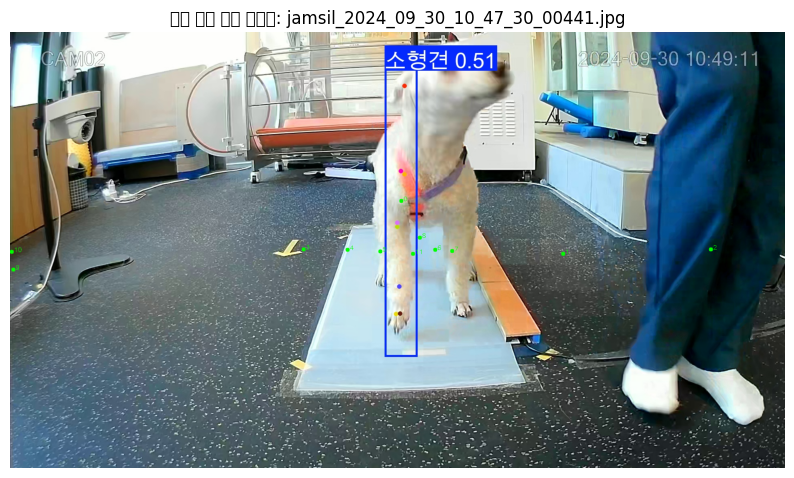

In [ ]:
# 최종 점검 - 시각화
import os
import cv2
import random
import matplotlib.pyplot as plt

# 경로 설정
image_dir = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs/predict_results"
label_dir = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs/predict_results/labels"

# keypoint 수
num_kpts = 12

# 파일 목록 불러오기
image_files = sorted([f for f in os.listdir(image_dir) if f.endswith(".jpg")])
label_files = sorted([f for f in os.listdir(label_dir) if f.endswith(".txt")])

# 파일명 기준으로 일치하는 페어만 선택
base_names = set(os.path.splitext(f)[0] for f in image_files) & set(os.path.splitext(f)[0] for f in label_files)
base_name = random.choice(list(base_names))  # 🔀 랜덤 선택

# 경로 설정
sample_image_path = os.path.join(image_dir, base_name + ".jpg")
sample_label_path = os.path.join(label_dir, base_name + ".txt")

# 이미지 불러오기
image = cv2.imread(sample_image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
h, w, _ = image.shape

# keypoint 추출
with open(sample_label_path, 'r') as f:
    line = f.readline().strip().split()
    keypoint_values = list(map(float, line[1:]))

keypoints = []
for i in range(num_kpts):
    x = keypoint_values[i * 3] * w
    y = keypoint_values[i * 3 + 1] * h
    v = keypoint_values[i * 3 + 2]
    if v > 0:
        keypoints.append((int(x), int(y)))
    else:
        keypoints.append(None)

# 시각화
for i, pt in enumerate(keypoints):
    if pt:
        cv2.circle(image, pt, 5, (0, 255, 0), -1)
        cv2.putText(image, str(i), (pt[0]+5, pt[1]), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)

# 출력
plt.figure(figsize=(10, 6))
plt.imshow(image)
plt.axis("off")
plt.title(f"랜덤 예측 결과 시각화: {base_name}.jpg")
plt.show()


In [ ]:
# 결론 front 방향의 bbox가 이상하여 txt 파일 재생성 필요

# 3.2.1 Yolo 다시 학습 - Front 방향(bbox 크기 재조정한 txt 파일 적용)

In [ ]:
from ultralytics import YOLO
model = YOLO("/content/yolov8m-pose.pt")
model.train(
    data="/content/drive/MyDrive/pet_angle_copy/dataset_split2/front.yaml",
    epochs=100,
    imgsz=768,
    name="train_pose_model",  # 이건 하위 폴더 이름
    project="/content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_bbox",  # 이게 상위 경로!
    batch=8,
    optimizer="AdamW",
    lr0=0.001,
    close_mosaic=10
)


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=8, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/pet_angle_copy/dataset_split2/front.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=768, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.001, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=/content/yolov8m-pose.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train_pose_model, nbs=64, nms=False, opset=None, optimize=False, optimizer=AdamW, overlap_mask=True, p

Overriding model.yaml kpt_shape=[17, 3] with kpt_shape=[12, 3]
Overriding model.yaml nc=1 with nc=2

                   from  n    params  module                                       arguments                     


  0                  -1  1      1392  ultralytics.nn.modules.conv.Conv             [3, 48, 3, 2]                 
  1                  -1  1     41664  ultralytics.nn.modules.conv.Conv             [48, 96, 3, 2]                
  2                  -1  2    111360  ultralytics.nn.modules.block.C2f             [96, 96, 2, True]             
  3                  -1  1    166272  ultralytics.nn.modules.conv.Conv             [96, 192, 3, 2]               
  4                  -1  4    813312  ultralytics.nn.modules.block.C2f             [192, 192, 4, True]           
  5                  -1  1    664320  ultralytics.nn.modules.conv.Conv             [192, 384, 3, 2]              
  6                  -1  4   3248640  ultralytics.nn.modules.block.C2f             [384, 384, 4, True]           
  7                  -1  1   1991808  ultralytics.nn.modules.conv.Conv             [384, 576, 3, 2]              
  8                  -1  2   3985920  ultralytics.nn.modules.block.C2f             [576,

AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.3±0.1 ms, read: 154.2±140.4 MB/s, size: 529.0 KB)


train: Scanning /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/front_image... 287 images, 0 backgrounds, 0 corrupt: 100%|██████████| 287/287 [00:05<00:00, 53.77it/s]

train: New cache created: /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/front_image.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.4±0.1 ms, read: 0.9±0.5 MB/s, size: 518.3 KB)


val: Scanning /content/drive/MyDrive/pet_angle_copy/dataset_split2/val/front_image... 55 images, 0 backgrounds, 0 corrupt: 100%|██████████| 55/55 [00:03<00:00, 14.53it/s]

val: New cache created: /content/drive/MyDrive/pet_angle_copy/dataset_split2/val/front_image.cache


Plotting labels to /content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_bbox/train_pose_model/labels.jpg... 
optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 83 weight(decay=0.0), 93 weight(decay=0.0005), 92 bias(decay=0.0)
Image sizes 768 train, 768 val
Using 8 dataloader workers
Logging results to /content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_bbox/train_pose_model
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      1/100      4.71G      2.825      7.526     0.7104      4.888      3.083         14        768:  11%|█         | 4/36 [00:02<00:16,  1.99it/s]
      1/100      4.75G      2.165      6.262     0.6109      3.027      2.537         12        768: 100%|██████████| 36/36 [00:10<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.44it/s]

                   all         55         55      0.752       0.55      0.619      0.208      0.455      0.309      0.232     0.0767



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      2/100      5.02G      1.955      4.777     0.5122      1.675      2.173         15        768: 100%|██████████| 36/36 [00:07<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.79it/s]

                   all         55         55      0.597      0.818      0.669      0.283      0.422      0.582      0.352      0.101



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      3/100      5.09G      1.904       4.29     0.4955       1.43      2.213         15        768: 100%|██████████| 36/36 [00:07<00:00,  4.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.40it/s]


                   all         55         55       0.04      0.691     0.0333     0.0108     0.0249        0.4     0.0151    0.00455

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      4/100      5.16G      1.854      3.995     0.4939      1.318      2.146         16        768: 100%|██████████| 36/36 [00:07<00:00,  4.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.17it/s]

                   all         55         55     0.0709      0.727     0.0643     0.0242      0.055      0.564     0.0423     0.0126



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      5/100      5.22G      1.829      3.891     0.4794      1.289      2.104         18        768: 100%|██████████| 36/36 [00:07<00:00,  4.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.24it/s]

                   all         55         55       0.68      0.745      0.688      0.266      0.605      0.473      0.459      0.147



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      6/100      5.23G      1.739      3.719     0.4856      1.268      2.048         19        768: 100%|██████████| 36/36 [00:07<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.27it/s]

                   all         55         55      0.887      0.909      0.951      0.505      0.702        0.6      0.571      0.229



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      7/100      5.29G      1.682      3.636     0.4751      1.193      2.025         16        768: 100%|██████████| 36/36 [00:07<00:00,  4.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.19it/s]

                   all         55         55      0.912      0.836      0.929      0.482      0.682      0.585      0.535      0.195



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      8/100      5.29G      1.735      3.702     0.4643      1.125      2.027         19        768: 100%|██████████| 36/36 [00:07<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.45it/s]


                   all         55         55      0.873      0.877      0.898      0.459      0.585      0.582      0.436      0.124

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      9/100      5.37G      1.793      3.759     0.4592      1.112      2.055         18        768: 100%|██████████| 36/36 [00:07<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.39it/s]

                   all         55         55      0.891      0.889      0.935      0.511      0.652      0.613      0.599      0.194



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     10/100      5.37G      1.687      3.428     0.4725      1.129      1.993         18        768: 100%|██████████| 36/36 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.38it/s]

                   all         55         55      0.962      0.917      0.977      0.545      0.706      0.655      0.605      0.202



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     11/100      5.37G       1.64      3.424     0.4503      1.131      1.956          9        768: 100%|██████████| 36/36 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.34it/s]

                   all         55         55      0.992      0.964       0.99      0.567       0.82      0.709      0.676       0.23



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     12/100      5.37G      1.638      3.421     0.4545      1.075      1.953         17        768: 100%|██████████| 36/36 [00:07<00:00,  4.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.40it/s]

                   all         55         55       0.96      0.964      0.984      0.458      0.626      0.579      0.474      0.206



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     13/100      5.37G        1.6      3.323     0.4636      1.049      1.898         13        768: 100%|██████████| 36/36 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.85it/s]

                   all         55         55      0.914      0.964      0.985      0.533      0.761      0.754      0.704      0.261



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     14/100      5.37G      1.534      3.166     0.4534      1.017      1.864         17        768: 100%|██████████| 36/36 [00:07<00:00,  4.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.39it/s]

                   all         55         55       0.93      0.974      0.981      0.444      0.749      0.709      0.642      0.235



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     15/100      5.37G      1.567      3.171     0.4524       1.03      1.909         14        768: 100%|██████████| 36/36 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.32it/s]

                   all         55         55      0.913       0.95      0.976      0.548      0.654      0.618      0.596      0.246



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     16/100      5.37G      1.559      3.158     0.4528     0.9621      1.856         21        768: 100%|██████████| 36/36 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.25it/s]

                   all         55         55      0.912      0.946      0.986       0.53      0.751      0.691      0.685      0.285



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     17/100      5.37G      1.541      3.087      0.443      1.006      1.859         11        768: 100%|██████████| 36/36 [00:08<00:00,  4.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.76it/s]

                   all         55         55      0.963      0.957      0.984      0.578      0.751      0.636      0.682      0.276



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     18/100      5.53G      1.538      2.925     0.4473     0.9397      1.858         11        768: 100%|██████████| 36/36 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.18it/s]

                   all         55         55      0.964      0.976      0.992      0.558      0.765      0.764        0.7      0.312



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     19/100      5.53G      1.539      3.189      0.454     0.9496      1.872         15        768: 100%|██████████| 36/36 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.07it/s]

                   all         55         55      0.958      0.964      0.989      0.647      0.749      0.705      0.581      0.248



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     20/100      5.54G      1.472      3.059     0.4467     0.9247      1.861         18        768: 100%|██████████| 36/36 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.35it/s]

                   all         55         55      0.965      0.998      0.994      0.392      0.773      0.745      0.714      0.271



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     21/100      5.54G      1.544      3.116     0.4496     0.9637       1.87         16        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.04it/s]

                   all         55         55      0.981      0.962      0.986       0.45      0.787        0.8       0.76       0.29



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     22/100      5.54G      1.595       3.12     0.4513     0.9655      1.877         16        768: 100%|██████████| 36/36 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.54it/s]


                   all         55         55      0.982      0.982      0.995      0.608      0.722      0.709      0.645      0.215

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     23/100      5.54G      1.461      2.975     0.4433     0.8822      1.814         14        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.00it/s]

                   all         55         55       0.98          1      0.993       0.64      0.775      0.673      0.652      0.304



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     24/100      5.54G      1.406      3.087     0.4393     0.8433      1.753         14        768: 100%|██████████| 36/36 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.26it/s]

                   all         55         55      0.963      0.945      0.979       0.55      0.794      0.764       0.77      0.366



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     25/100      5.54G      1.479      2.901     0.4327     0.9201      1.837         13        768: 100%|██████████| 36/36 [00:08<00:00,  4.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.09it/s]

                   all         55         55      0.954      0.982      0.983      0.656      0.784        0.8      0.771      0.355



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     26/100      5.54G      1.391      3.032     0.4373     0.8759      1.755         15        768: 100%|██████████| 36/36 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.13it/s]

                   all         55         55      0.982      0.998      0.994      0.679      0.758      0.818      0.767       0.36



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     27/100      5.54G      1.422      2.861     0.4445     0.8754      1.774         14        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.22it/s]

                   all         55         55      0.981      0.982      0.993      0.672        0.8        0.8      0.736       0.36



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     28/100      5.54G       1.38      2.875     0.4417     0.8867      1.766         14        768: 100%|██████████| 36/36 [00:08<00:00,  4.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.43it/s]

                   all         55         55      0.943      0.982       0.99      0.617      0.784      0.818      0.814      0.385



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     29/100      5.54G      1.341      2.669     0.4372     0.8275      1.683         18        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.16it/s]

                   all         55         55      0.988      0.982      0.995      0.651       0.82      0.818      0.777      0.356



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     30/100      5.54G      1.377      2.721     0.4426     0.8316      1.766         13        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.19it/s]

                   all         55         55      0.982      0.987      0.994      0.696      0.838      0.836      0.817      0.378



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     31/100      5.54G      1.358      2.613      0.427     0.8252      1.735         18        768: 100%|██████████| 36/36 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.02it/s]

                   all         55         55      0.987      0.964      0.994       0.69      0.797      0.782      0.774      0.345



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     32/100      5.54G      1.345      2.903     0.4355     0.8294      1.755         19        768: 100%|██████████| 36/36 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.85it/s]

                   all         55         55      0.996      0.982      0.995      0.644      0.853      0.818      0.823      0.409



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     33/100      5.54G       1.37      2.701     0.4389     0.8062      1.768         12        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.26it/s]

                   all         55         55      0.982      0.979      0.991      0.698      0.865      0.855      0.846       0.37



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     34/100      5.54G      1.311      2.554     0.4346     0.7661       1.69         13        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.18it/s]

                   all         55         55      0.982      0.995      0.994        0.7      0.878      0.818      0.841      0.381



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     35/100      5.54G      1.309      2.692     0.4286     0.7916       1.68         15        768: 100%|██████████| 36/36 [00:08<00:00,  4.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.07it/s]

                   all         55         55       0.99      0.982      0.995      0.725      0.897      0.873       0.86      0.407



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     36/100      5.54G      1.295      2.689     0.4369     0.7543      1.664         13        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.45it/s]


                   all         55         55       0.95      0.982      0.991      0.684      0.841      0.836       0.83      0.406

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     37/100      5.54G      1.227      2.461     0.4363     0.7565      1.608         14        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.24it/s]

                   all         55         55      0.973          1      0.993      0.663      0.865      0.855      0.829      0.412



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     38/100      5.54G      1.206       2.48     0.4259     0.7562       1.63         16        768: 100%|██████████| 36/36 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.61it/s]

                   all         55         55      0.982      0.996      0.994       0.66       0.81      0.782      0.724      0.376



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     39/100      5.54G      1.247      2.445     0.4348     0.7259      1.599         15        768: 100%|██████████| 36/36 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.19it/s]

                   all         55         55          1      0.997      0.995      0.707      0.839      0.855      0.792      0.426



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     40/100      5.54G      1.275      2.473     0.4293     0.7395      1.643         19        768: 100%|██████████| 36/36 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.04it/s]

                   all         55         55      0.961          1      0.994      0.651      0.876      0.909      0.868      0.443



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     41/100      5.54G      1.289      2.396     0.4409     0.7386      1.678         17        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.90it/s]

                   all         55         55      0.996          1      0.995      0.701       0.91      0.927      0.865      0.427



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     42/100      5.54G      1.239      2.484     0.4362     0.7247      1.643         18        768: 100%|██████████| 36/36 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.83it/s]

                   all         55         55      0.981          1      0.995      0.716      0.873      0.891      0.875      0.474



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     43/100      5.54G      1.231      2.427     0.4347     0.7098      1.622         16        768: 100%|██████████| 36/36 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.17it/s]

                   all         55         55      0.997      0.982      0.995      0.702      0.868      0.855      0.799      0.466



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     44/100      5.54G      1.209      2.453     0.4222     0.7191      1.619         14        768: 100%|██████████| 36/36 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.33it/s]

                   all         55         55      0.979          1      0.995      0.657      0.904      0.891      0.882      0.458



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     45/100      5.54G      1.178      2.215     0.4261     0.7294      1.548         11        768: 100%|██████████| 36/36 [00:07<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.45it/s]


                   all         55         55          1      0.991      0.995      0.716      0.873      0.872      0.852      0.456

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     46/100      5.54G      1.274      2.522     0.4308     0.7705      1.669         16        768: 100%|██████████| 36/36 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.27it/s]

                   all         55         55      0.979          1      0.995      0.758       0.89      0.909      0.889      0.488



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     47/100      5.54G      1.177      2.285     0.4195     0.6981      1.543         12        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.46it/s]


                   all         55         55      0.981          1      0.995      0.744      0.888      0.909       0.89      0.492

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     48/100      5.54G      1.182      2.247     0.4218     0.7439      1.595         16        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.31it/s]

                   all         55         55          1          1      0.995      0.691      0.893      0.891      0.865      0.514



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     49/100      5.54G      1.154      2.143     0.4338     0.6703      1.586         13        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.01it/s]

                   all         55         55       0.98          1      0.995      0.751      0.882      0.855      0.854       0.52



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     50/100      5.54G      1.102      2.295     0.4206     0.6534      1.516         16        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.64it/s]

                   all         55         55      0.982          1      0.994       0.79      0.892      0.909      0.887      0.534



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     51/100      5.54G      1.104      2.127     0.4133     0.6661      1.514         15        768: 100%|██████████| 36/36 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.54it/s]


                   all         55         55      0.997          1      0.995      0.714      0.888      0.891      0.865      0.519

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     52/100      5.54G      1.091      2.076     0.4218     0.6743      1.524         18        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.46it/s]

                   all         55         55      0.981          1      0.995       0.75      0.874      0.891      0.869      0.532



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     53/100      5.54G      1.089      2.087     0.4311     0.6507      1.539          8        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.42it/s]


                   all         55         55       0.98          1      0.994      0.762      0.857      0.871      0.835      0.542

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     54/100      5.54G      1.086      1.955     0.4093     0.6737      1.507         17        768: 100%|██████████| 36/36 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.26it/s]

                   all         55         55       0.98          1      0.994      0.774      0.961      0.902      0.911      0.562



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     55/100      5.54G      1.059      1.926     0.4089     0.6384      1.485         11        768: 100%|██████████| 36/36 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.07it/s]

                   all         55         55      0.982          1      0.995      0.751      0.937      0.909      0.914      0.542



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     56/100      5.54G      1.067      2.016     0.4155      0.629      1.466         20        768: 100%|██████████| 36/36 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.86it/s]

                   all         55         55      0.995          1      0.995      0.772       0.89      0.883      0.906      0.566



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     57/100      5.54G      1.074      1.955     0.4234     0.6245      1.491         17        768: 100%|██████████| 36/36 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.34it/s]


                   all         55         55      0.999          1      0.995      0.813      0.926      0.927      0.931      0.586

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     58/100      5.54G      1.054      1.859     0.4133     0.6553      1.468         19        768: 100%|██████████| 36/36 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.37it/s]

                   all         55         55      0.999          1      0.995      0.776       0.89      0.891      0.862      0.613



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     59/100      5.54G     0.9987      1.921      0.431     0.5777      1.412         13        768: 100%|██████████| 36/36 [00:08<00:00,  4.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.28it/s]

                   all         55         55          1      0.997      0.995      0.754      0.908      0.909      0.903      0.628



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     60/100      5.54G      1.043      1.951     0.4125     0.6079       1.43         21        768: 100%|██████████| 36/36 [00:07<00:00,  4.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.88it/s]

                   all         55         55      0.996          1      0.995      0.799      0.905      0.909      0.883      0.604



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     61/100      5.54G       1.07      1.852     0.4095     0.6389      1.465         14        768: 100%|██████████| 36/36 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.37it/s]

                   all         55         55          1      0.997      0.995      0.802      0.927      0.924      0.919      0.635



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     62/100      5.54G      1.025      1.759     0.4192      0.618       1.45         14        768: 100%|██████████| 36/36 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.15it/s]

                   all         55         55      0.998          1      0.995      0.725      0.944      0.925      0.908      0.628



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     63/100      5.54G     0.9845      1.702     0.4145     0.5802      1.394         20        768: 100%|██████████| 36/36 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.33it/s]

                   all         55         55      0.991          1      0.995      0.808      0.928      0.909      0.911      0.625



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     64/100      5.54G     0.9399      1.703       0.41     0.5865      1.372         16        768: 100%|██████████| 36/36 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.30it/s]

                   all         55         55      0.981          1      0.995      0.818      0.926      0.904      0.892      0.613



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     65/100      5.54G     0.9774      1.777     0.4191     0.5794      1.405         11        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.09it/s]

                   all         55         55      0.999          1      0.995      0.812      0.926      0.927      0.917      0.626



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     66/100      5.54G     0.9654       1.78     0.4164     0.6021      1.409         18        768: 100%|██████████| 36/36 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.12it/s]

                   all         55         55      0.999          1      0.995      0.818      0.926      0.927      0.922       0.63



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     67/100      5.54G     0.9807      1.777     0.4202     0.5814      1.407         16        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.14it/s]

                   all         55         55      0.999          1      0.995      0.762      0.926      0.927      0.921      0.623



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     68/100      5.54G          1       1.58     0.4029     0.5877      1.452         13        768: 100%|██████████| 36/36 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.82it/s]

                   all         55         55      0.999          1      0.995      0.811      0.908      0.909      0.885      0.621



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     69/100      5.54G      1.002      1.682     0.4128     0.5683      1.412         15        768: 100%|██████████| 36/36 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.40it/s]

                   all         55         55      0.999          1      0.995       0.83       0.89      0.891      0.874      0.603



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     70/100      5.54G     0.9718      1.719     0.4092     0.5695      1.414         21        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.57it/s]

                   all         55         55      0.999          1      0.995      0.764       0.89      0.891      0.871      0.613



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     71/100      5.54G     0.9355      1.677     0.4159     0.5652      1.375         16        768: 100%|██████████| 36/36 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.11it/s]

                   all         55         55      0.996          1      0.995      0.844      0.942      0.945      0.927      0.637



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     72/100      5.54G     0.9462       1.73        0.4     0.5767      1.367         17        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.65it/s]

                   all         55         55      0.999          1      0.995      0.825      0.944      0.945      0.948      0.644



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     73/100      5.54G     0.9281       1.53     0.4043     0.5508      1.362         10        768: 100%|██████████| 36/36 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.38it/s]

                   all         55         55      0.997          1      0.995       0.81      0.924      0.927      0.925      0.682



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     74/100      5.54G     0.9475      1.558     0.4008     0.5871      1.368         10        768: 100%|██████████| 36/36 [00:08<00:00,  4.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.16it/s]

                   all         55         55      0.998          1      0.995      0.819      0.957      0.927      0.931      0.679



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     75/100      5.54G     0.9463      1.645     0.3986     0.5847       1.38         21        768: 100%|██████████| 36/36 [00:07<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.54it/s]

                   all         55         55      0.999          1      0.995      0.826      0.975      0.945      0.957      0.661



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     76/100      5.54G     0.9002      1.508     0.4092     0.5322      1.342         14        768: 100%|██████████| 36/36 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.37it/s]

                   all         55         55      0.999          1      0.995      0.849      0.927      0.927      0.924      0.653



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     77/100      5.54G     0.8874      1.574     0.4091      0.545      1.357         15        768: 100%|██████████| 36/36 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.35it/s]

                   all         55         55      0.982          1      0.995      0.835      0.918      0.927      0.923      0.668



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     78/100      5.54G     0.9318      1.443     0.3957     0.5695      1.392         21        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.24it/s]

                   all         55         55      0.981          1      0.995      0.826      0.927      0.945      0.943      0.669



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     79/100      5.54G     0.8668      1.451     0.3881     0.5728      1.353         10        768: 100%|██████████| 36/36 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.30it/s]

                   all         55         55      0.981          1      0.995      0.844      0.928      0.945      0.941      0.684



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     80/100      5.54G     0.8383      1.456     0.3957     0.5301      1.276          9        768: 100%|██████████| 36/36 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.97it/s]

                   all         55         55      0.981          1      0.995       0.86      0.928      0.945      0.946      0.675



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     81/100      5.54G     0.8745       1.33     0.3942     0.5562       1.29         14        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.30it/s]

                   all         55         55      0.981          1      0.995      0.827      0.928      0.945      0.947      0.672



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     82/100      5.54G     0.8699      1.614     0.4065      0.543      1.343         17        768: 100%|██████████| 36/36 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.31it/s]

                   all         55         55      0.999          1      0.995      0.844      0.945      0.945      0.949      0.676



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     83/100      5.54G      0.841      1.508     0.4105     0.5566      1.302         14        768: 100%|██████████| 36/36 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.55it/s]

                   all         55         55      0.999          1      0.995      0.845      0.964      0.945      0.954      0.678



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     84/100      5.54G     0.8336      1.504     0.4097     0.5198      1.286          9        768: 100%|██████████| 36/36 [00:08<00:00,  4.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.24it/s]

                   all         55         55      0.999          1      0.995      0.864      0.925      0.895      0.901      0.662



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     85/100      5.54G     0.8228      1.444     0.4044     0.5052      1.281         14        768: 100%|██████████| 36/36 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.25it/s]


                   all         55         55      0.999          1      0.995      0.838      0.943      0.927      0.927      0.683

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     86/100      5.54G     0.8516      1.378     0.3929     0.5439      1.298         15        768: 100%|██████████| 36/36 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.74it/s]

                   all         55         55      0.998          1      0.995      0.853      0.945      0.945      0.954      0.699



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     87/100      5.54G     0.8214      1.484     0.3932     0.5144      1.291         17        768: 100%|██████████| 36/36 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.28it/s]

                   all         55         55      0.997          1      0.995       0.85      0.944      0.945      0.955      0.702



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     88/100      5.54G     0.8472      1.552     0.3912      0.542      1.302         14        768: 100%|██████████| 36/36 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.26it/s]

                   all         55         55      0.982          1      0.995      0.866       0.93      0.945      0.954       0.71



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     89/100      5.54G     0.8496      1.466     0.3918     0.5462      1.312         15        768: 100%|██████████| 36/36 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.18it/s]

                   all         55         55      0.981          1      0.995      0.863      0.929      0.945      0.954      0.712



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     90/100      5.54G     0.7866      1.476     0.4048     0.5065      1.269         14        768: 100%|██████████| 36/36 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.23it/s]

                   all         55         55      0.982          1      0.995      0.891      0.943      0.945      0.951      0.708


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     91/100      5.54G     0.6843      1.334     0.4474     0.3777      1.257          7        768: 100%|██████████| 36/36 [00:09<00:00,  3.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.56it/s]


                   all         55         55      0.997          1      0.995       0.82      0.943      0.945      0.945      0.677

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     92/100      5.54G     0.6657      1.341     0.4453     0.3642      1.263          7        768: 100%|██████████| 36/36 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.81it/s]

                   all         55         55      0.996          1      0.995      0.873      0.943      0.945      0.945      0.659



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     93/100      5.54G     0.6359      1.298     0.4439     0.3495      1.222          7        768: 100%|██████████| 36/36 [00:07<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.18it/s]

                   all         55         55      0.998          1      0.995      0.842       0.95      0.945      0.944      0.662



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     94/100      5.54G     0.6701      1.283      0.438      0.354      1.274          7        768: 100%|██████████| 36/36 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.22it/s]

                   all         55         55          1      0.999      0.995      0.879      0.961      0.945      0.945       0.68



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     95/100      5.54G     0.6027      1.252     0.4357     0.3323      1.208          7        768: 100%|██████████| 36/36 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.10it/s]

                   all         55         55          1      0.998      0.995      0.877      0.964      0.962      0.964      0.691



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     96/100      5.54G     0.6083      1.274     0.4407     0.3268      1.207          7        768: 100%|██████████| 36/36 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.78it/s]

                   all         55         55          1      0.999      0.995      0.852      0.961      0.945      0.946      0.693



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     97/100      5.54G     0.5879      1.222     0.4355     0.3342      1.188          7        768: 100%|██████████| 36/36 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.05it/s]

                   all         55         55      0.999          1      0.995      0.884      0.962      0.945      0.947      0.703



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     98/100      5.54G     0.5476      1.193     0.4383     0.3137      1.143          7        768: 100%|██████████| 36/36 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.57it/s]

                   all         55         55      0.998          1      0.995      0.867      0.974      0.945      0.947        0.7



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     99/100      5.54G     0.5646      1.192      0.441     0.3186       1.16          7        768: 100%|██████████| 36/36 [00:07<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.14it/s]

                   all         55         55      0.998          1      0.995      0.863      0.969      0.945      0.947       0.71



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


    100/100      5.54G     0.5507      1.227     0.4411     0.3204      1.165          7        768: 100%|██████████| 36/36 [00:08<00:00,  4.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.05it/s]

                   all         55         55      0.998          1      0.995      0.879      0.962      0.964      0.965      0.712



100 epochs completed in 0.276 hours.
Optimizer stripped from /content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_bbox/train_pose_model/weights/last.pt, 53.2MB
Optimizer stripped from /content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_bbox/train_pose_model/weights/best.pt, 53.2MB

Validating /content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_bbox/train_pose_model/weights/best.pt...
Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
YOLOv8m-pose summary (fused): 101 layers, 26,406,370 parameters, 0 gradients, 80.9 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.83it/s]


                   all         55         55      0.982          1      0.995      0.892      0.943      0.945      0.951      0.708
                   소형견         55         55      0.982          1      0.995      0.892      0.943      0.945      0.951      0.708
Speed: 0.1ms preprocess, 4.1ms inference, 0.0ms loss, 2.4ms postprocess per image
Results saved to /content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_bbox/train_pose_model


ultralytics.utils.metrics.PoseMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7eae47155e50>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)', 'Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)', 'Precision-Recall(P)', 'F1-Confidence(P)', 'Precision-Confidence(P)', 'Recall-Confidence(P)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034, 

In [ ]:
# 학습 결과 해석
✅ 3. 해석 요약
🟢 잘된 부분
Box 성능 (탐지 정확도): Precision=0.98, Recall=1.00, mAP50=0.995로 매우 우수. 박스 탐지는 잘 학습됨.

Pose Precision/Recall: 포즈 정확도/재현율도 0.94 수준으로 높음.

Pose mAP50: 0.951로 keypoint 예측 정확도도 매우 높음.

🔶 개선 여지
Pose mAP50-95: 0.708 → 다양한 IOU 구간에서 keypoint 예측 정확도가 다소 낮아짐.

pose_loss: 1.4~1.5 수준 → 다소 높은 값이긴 하나, mAP가 높기 때문에 정확도는 충분히 확보된 상태.

원인 추정: pose_loss는 raw distance 기반이기 때문에 keypoint 간 거리 차이가 크면 값이 커질 수 있음. 특히 강아지 자세가 다양하거나 부분 keypoint 누락이 있을 경우 그렇습니다.

In [ ]:
# 학습 완료된 모델 불러오기
model = YOLO("/content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_bbox/train_pose_model/weights/best.pt")  # 학습된 best 모델 경로

# 예측 수행
results = model.predict(
    source="/content/drive/MyDrive/pet_angle_copy/dataset_split2/test/front_image",
    project="/content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_bbox",  # 저장 루트 변경
    name="predict_results",   # 하위 폴더명 지정
    save=True,               # 예측 결과 이미지 저장
    save_txt=True,            # 예측된 keypoint 좌표 .txt 저장
    save_conf=True,             # confidence 포함 저장
    conf=0.25,                   # confidence threshold (필요 시 조절)
    imgsz=768                 # 학습할 때와 동일한 이미지 크기 사용
)

In [ ]:
# 학습한 모델 불러오기
model = YOLO("/content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_bbox/train_pose_model/weights/best.pt")

# validation 수행
metrics = model.val(data="/content/drive/MyDrive/pet_angle_copy/dataset_split2/front.yaml", project="/content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs+bbox/valid_results")

# 3-3. Yolo 학습 - Tail 방향

In [ ]:
# 3. Tail 방향 학습
/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail.yaml

In [ ]:

from ultralytics import YOLO

# 사전학습된 Pose 모델 불러오기
model = YOLO("yolov8n-pose.pt")
# /content/side_healbow2/side_healbow.yaml
# 학습 실행
model.train(
    data="/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail.yaml",
    epochs=70,
    imgsz=640,
    name="train_pose_model",
    batch=16
)

In [ ]:
from ultralytics import YOLO
model = YOLO("/content/yolov8m-pose.pt")
model.train(
    data="/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail.yaml",
    epochs=100,
    imgsz=768,
    name="train_pose_model",  # 이건 하위 폴더 이름
    project="/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs",  # 이게 상위 경로!
    batch=8,
    optimizer="AdamW",
    lr0=0.001,
    close_mosaic=10
)

Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=8, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=768, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.001, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=/content/yolov8m-pose.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train_pose_model, nbs=64, nms=False, opset=None, optimize=False, optimizer=AdamW, overlap_mask=True, pa

train: Scanning /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/tail_image... 262 images, 0 backgrounds, 0 corrupt: 100%|██████████| 262/262 [00:21<00:00, 11.95it/s]

train: New cache created: /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/tail_image.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.6±0.1 ms, read: 1.3±0.7 MB/s, size: 567.9 KB)


val: Scanning /content/drive/MyDrive/pet_angle_copy/dataset_split2/val/tail_image... 60 images, 0 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:07<00:00,  8.55it/s]

val: New cache created: /content/drive/MyDrive/pet_angle_copy/dataset_split2/val/tail_image.cache


Plotting labels to /content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs/train_pose_model/labels.jpg... 


/usr/local/lib/python3.11/dist-packages/ultralytics/utils/plotting.py:618: UserWarning: Glyph 49548 (\N{HANGUL SYLLABLE SO}) missing from font(s) DejaVu Sans.
  plt.savefig(fname, dpi=200)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/plotting.py:618: UserWarning: Glyph 54805 (\N{HANGUL SYLLABLE HYEONG}) missing from font(s) DejaVu Sans.
  plt.savefig(fname, dpi=200)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/plotting.py:618: UserWarning: Glyph 44204 (\N{HANGUL SYLLABLE GYEON}) missing from font(s) DejaVu Sans.
  plt.savefig(fname, dpi=200)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/plotting.py:618: UserWarning: Glyph 51473 (\N{HANGUL SYLLABLE JUNG}) missing from font(s) DejaVu Sans.
  plt.savefig(fname, dpi=200)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/plotting.py:618: UserWarning: Glyph 49548 (\N{HANGUL SYLLABLE SO}) missing from font(s) DejaVu Sans.
  plt.savefig(fname, dpi=200)
/usr/local/lib/python3.11/dist-packages/ultral

optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 83 weight(decay=0.0), 93 weight(decay=0.0005), 92 bias(decay=0.0)
Image sizes 768 train, 768 val
Using 8 dataloader workers
Logging results to /content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs/train_pose_model
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      1/100      5.07G      2.263      9.525      0.643      3.041      2.276         13        768: 100%|██████████| 33/33 [00:08<00:00,  3.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.10it/s]

                   all         60         60     0.0227      0.517     0.0303     0.0104   0.000456     0.0167    3.7e-05   7.41e-06



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      2/100      5.16G      1.987      8.489      0.551      1.952      1.865         10        768: 100%|██████████| 33/33 [00:07<00:00,  4.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.97it/s]

                   all         60         60      0.435        0.5      0.401      0.156    0.00229     0.0833   0.000591   6.61e-05



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      3/100      5.29G      1.932      8.046     0.5237      1.935      1.881         10        768: 100%|██████████| 33/33 [00:07<00:00,  4.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.16it/s]

                   all         60         60      0.396       0.45      0.265      0.106      0.024      0.133    0.00652    0.00101



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      4/100       5.5G      2.002      8.002      0.529      2.144      1.906         16        768: 100%|██████████| 33/33 [00:07<00:00,  4.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.53it/s]

                   all         60         60     0.0624        0.8     0.0606     0.0217    0.00901      0.183    0.00403     0.0006



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      5/100      5.59G      1.966      7.625     0.5086      1.798       1.83         17        768: 100%|██████████| 33/33 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.51it/s]

                   all         60         60     0.0457      0.533     0.0398     0.0157    0.00443      0.183    0.00158   0.000255



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      6/100      5.76G      1.922      7.469     0.5151      1.724      1.811         12        768: 100%|██████████| 33/33 [00:07<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.29it/s]

                   all         60         60      0.221      0.398      0.148     0.0563     0.0372     0.0333    0.00328   0.000452



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      7/100       5.9G      1.882      7.065     0.5047      1.693      1.828         13        768: 100%|██████████| 33/33 [00:07<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.39it/s]

                   all         60         60      0.161      0.367      0.122     0.0424     0.0223       0.05    0.00364   0.000609



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      8/100      6.06G      1.818      6.984     0.4966      1.599      1.727         17        768: 100%|██████████| 33/33 [00:07<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.16it/s]

                   all         60         60      0.569      0.595       0.56      0.236     0.0296      0.183     0.0262    0.00445



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      9/100       6.2G      1.832       6.65     0.4872      1.543       1.73         15        768: 100%|██████████| 33/33 [00:07<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.51it/s]

                   all         60         60      0.714       0.65       0.72      0.283      0.026      0.211     0.0206     0.0038



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     10/100      6.37G      1.778      6.413     0.4916      1.523      1.689         17        768: 100%|██████████| 33/33 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.62it/s]

                   all         60         60      0.668      0.703      0.685      0.287     0.0736       0.25     0.0433    0.00708



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     11/100      6.51G      1.801      6.357     0.4893      1.498      1.692          7        768: 100%|██████████| 33/33 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.17it/s]

                   all         60         60       0.74      0.711      0.703      0.294      0.208      0.267      0.139     0.0242



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     12/100      6.67G      1.738      6.397     0.4853      1.539      1.696         12        768: 100%|██████████| 33/33 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.34it/s]

                   all         60         60      0.613       0.65      0.633       0.26       0.22      0.233      0.119     0.0198



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     13/100      6.84G      1.716      6.161     0.4793      1.513      1.658         16        768: 100%|██████████| 33/33 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.56it/s]

                   all         60         60       0.68      0.707      0.711      0.312      0.183       0.35      0.117     0.0213



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     14/100      6.98G      1.777      6.014     0.4758      1.478      1.671         10        768: 100%|██████████| 33/33 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.17it/s]

                   all         60         60      0.569      0.683      0.639      0.314      0.114      0.333     0.0966     0.0187



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     15/100      7.12G      1.722      5.986     0.4678      1.473      1.675          8        768: 100%|██████████| 33/33 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.25it/s]

                   all         60         60      0.684      0.756      0.691      0.312       0.21      0.283      0.156     0.0283



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     16/100      7.29G      1.736      5.926     0.4806      1.461      1.691         13        768: 100%|██████████| 33/33 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.33it/s]

                   all         60         60      0.694      0.756       0.69      0.298      0.204        0.5      0.187     0.0366



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     17/100      7.43G      1.717      6.001      0.473      1.409      1.672         16        768: 100%|██████████| 33/33 [00:07<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.02it/s]

                   all         60         60      0.662      0.718      0.692      0.305      0.302      0.233      0.175     0.0303



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     18/100      7.59G      1.677       5.68     0.4643      1.423       1.63         13        768: 100%|██████████| 33/33 [00:07<00:00,  4.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.33it/s]

                   all         60         60      0.675      0.767      0.714      0.321      0.237      0.488      0.237     0.0409



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     19/100      7.74G      1.693        5.8     0.4661      1.462      1.663         18        768: 100%|██████████| 33/33 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.04it/s]

                   all         60         60      0.709       0.73      0.735      0.362       0.26      0.217      0.164     0.0243



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     20/100      7.89G      1.663      5.857     0.4587      1.363      1.591          8        768: 100%|██████████| 33/33 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.29it/s]

                   all         60         60      0.674        0.7      0.671      0.329      0.224       0.25      0.175     0.0294



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     21/100      8.06G      1.616      5.465     0.4619      1.368      1.641          8        768: 100%|██████████| 33/33 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.02it/s]

                   all         60         60      0.688      0.733      0.696       0.33       0.14       0.45      0.111     0.0223



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     22/100       8.2G      1.595      5.516     0.4686       1.33      1.601          7        768: 100%|██████████| 33/33 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.32it/s]

                   all         60         60      0.757      0.833      0.758      0.376      0.175        0.4      0.141     0.0299



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     23/100      8.36G      1.575      5.611     0.4676      1.304      1.506         15        768: 100%|██████████| 33/33 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.12it/s]

                   all         60         60        0.7      0.767      0.704      0.332      0.254      0.383      0.215     0.0393



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     24/100       8.5G      1.637      5.504     0.4575      1.352      1.558         14        768: 100%|██████████| 33/33 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.05it/s]

                   all         60         60      0.688      0.817      0.743      0.357      0.405      0.383      0.286     0.0578



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     25/100      8.67G      1.637      5.446     0.4548      1.325      1.569         13        768: 100%|██████████| 33/33 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.47it/s]

                   all         60         60      0.773      0.849      0.803      0.392      0.391      0.439      0.345      0.065



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     26/100      8.81G      1.576      5.258     0.4488      1.285      1.577         12        768: 100%|██████████| 33/33 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.44it/s]

                   all         60         60      0.755       0.77      0.731      0.353      0.493      0.467      0.381     0.0812



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     27/100      8.95G      1.556      5.159     0.4518      1.322      1.566         17        768: 100%|██████████| 33/33 [00:07<00:00,  4.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.21it/s]

                   all         60         60       0.81      0.833      0.857      0.426      0.513       0.35      0.406     0.0884



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     28/100      9.11G      1.537      5.109     0.4466      1.313      1.528         11        768: 100%|██████████| 33/33 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.02it/s]

                   all         60         60       0.81      0.833      0.847      0.438      0.541       0.45      0.419     0.0813



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     29/100      9.27G      1.529        5.1     0.4484      1.247      1.509         11        768: 100%|██████████| 33/33 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.66it/s]

                   all         60         60      0.813       0.85      0.904      0.434      0.424      0.588      0.429     0.0919



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     30/100      9.41G      1.533       5.15     0.4455      1.217      1.553          7        768: 100%|██████████| 33/33 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.55it/s]

                   all         60         60        0.8      0.867      0.799      0.413      0.546      0.617      0.449      0.105



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     31/100      9.58G      1.547      4.892     0.4415      1.245      1.504          8        768: 100%|██████████| 33/33 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.33it/s]

                   all         60         60       0.88      0.858      0.866      0.399      0.488        0.5      0.452     0.0879



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     32/100      9.72G      1.486      4.778     0.4418      1.192      1.483         14        768: 100%|██████████| 33/33 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.08it/s]

                   all         60         60      0.759      0.817      0.763      0.405      0.466        0.5      0.388     0.0999



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     33/100      9.88G      1.434      4.687      0.452      1.191      1.442         11        768: 100%|██████████| 33/33 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.20it/s]

                   all         60         60      0.786      0.783      0.799       0.42      0.572      0.567      0.465      0.125



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     34/100        10G      1.448      4.519     0.4352      1.202       1.46         14        768: 100%|██████████| 33/33 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.50it/s]

                   all         60         60      0.698      0.833      0.752      0.433      0.493      0.583      0.446      0.127



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     35/100      10.2G      1.469      4.626     0.4302      1.208      1.493         10        768: 100%|██████████| 33/33 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.09it/s]

                   all         60         60      0.804      0.817      0.876      0.425      0.547      0.533      0.494      0.109



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     36/100      10.3G      1.444      4.679     0.4327      1.215      1.492         11        768: 100%|██████████| 33/33 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.42it/s]

                   all         60         60      0.849      0.867      0.912      0.453      0.577      0.567       0.48      0.118



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     37/100      10.5G      1.407      4.534     0.4271      1.176      1.436         11        768: 100%|██████████| 33/33 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.44it/s]

                   all         60         60      0.837      0.917       0.91      0.486      0.577      0.683      0.477      0.127



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     38/100      10.7G       1.45      4.549     0.4173      1.136      1.448         12        768: 100%|██████████| 33/33 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.36it/s]

                   all         60         60        0.8      0.931      0.903      0.507      0.747      0.688       0.71      0.183



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     39/100      10.8G      1.469      4.271      0.409      1.132      1.428         10        768: 100%|██████████| 33/33 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.42it/s]

                   all         60         60      0.906        0.8      0.896      0.516      0.804      0.683      0.682      0.211



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     40/100        11G      1.365      4.459     0.4063      1.117      1.385         12        768: 100%|██████████| 33/33 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.24it/s]

                   all         60         60      0.882      0.876      0.892      0.543       0.73      0.722      0.738      0.214



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     41/100      11.1G       1.37      4.335     0.4173      1.196       1.44         12        768: 100%|██████████| 33/33 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.43it/s]

                   all         60         60      0.778       0.85       0.85      0.487      0.732      0.729      0.714      0.207



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     42/100      5.42G       1.37      4.296     0.4056      1.134      1.415          8        768: 100%|██████████| 33/33 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.69it/s]

                   all         60         60      0.759      0.842      0.801      0.457      0.645      0.717      0.617      0.216



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     43/100      5.42G      1.381      4.259     0.3948      1.117      1.396         15        768: 100%|██████████| 33/33 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.06it/s]

                   all         60         60      0.883      0.883      0.919      0.501      0.719       0.75      0.721      0.223



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     44/100      5.42G      1.366      4.359     0.4089      1.105      1.432         15        768: 100%|██████████| 33/33 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.27it/s]

                   all         60         60       0.85        0.9      0.897      0.523      0.794      0.706       0.67      0.214



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     45/100      5.42G      1.371      4.196     0.3917      1.093      1.408          9        768: 100%|██████████| 33/33 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.25it/s]

                   all         60         60      0.857      0.901      0.922       0.58      0.866      0.755      0.796      0.244



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     46/100      5.42G      1.349      3.994     0.3866      1.034      1.367         11        768: 100%|██████████| 33/33 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.38it/s]

                   all         60         60      0.758      0.883      0.877      0.544      0.735      0.693      0.725      0.217



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     47/100      5.42G      1.391      4.245     0.4087      1.089      1.395          9        768: 100%|██████████| 33/33 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.92it/s]

                   all         60         60      0.855      0.882      0.924      0.588       0.81      0.733      0.774      0.244



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     48/100      5.53G      1.273      3.951     0.3697      1.013      1.341         11        768: 100%|██████████| 33/33 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.06it/s]

                   all         60         60      0.887      0.916      0.897      0.572      0.773      0.796       0.76      0.284



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     49/100      5.69G      1.279      3.854     0.3765      1.024      1.347         10        768: 100%|██████████| 33/33 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.22it/s]

                   all         60         60      0.879       0.95      0.949      0.627      0.795      0.767       0.75      0.296



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     50/100      5.85G      1.328      3.921     0.3821      1.047      1.339         10        768: 100%|██████████| 33/33 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.77it/s]

                   all         60         60       0.88        0.9      0.923      0.606      0.789        0.8      0.762      0.308



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     51/100      5.99G      1.248      3.737     0.3632     0.9951      1.341         15        768: 100%|██████████| 33/33 [00:07<00:00,  4.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.36it/s]

                   all         60         60      0.842       0.89      0.932       0.62      0.866      0.817      0.864      0.281



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     52/100      6.14G      1.272      3.844     0.3573     0.9903      1.323         15        768: 100%|██████████| 33/33 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.34it/s]

                   all         60         60      0.826      0.917      0.921      0.598      0.807      0.833      0.837      0.292



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     53/100      6.31G      1.268      3.625     0.3639     0.9771      1.325          7        768: 100%|██████████| 33/33 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.23it/s]

                   all         60         60      0.884      0.883      0.945      0.655      0.877      0.867      0.903      0.354



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     54/100      6.45G      1.346      3.926      0.344      1.039      1.377         12        768: 100%|██████████| 33/33 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.11it/s]

                   all         60         60      0.901      0.913      0.954       0.66      0.862      0.867       0.89       0.37



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     55/100      6.62G      1.238      3.763     0.3491     0.9442      1.299          7        768: 100%|██████████| 33/33 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.17it/s]

                   all         60         60      0.903        0.9      0.912      0.611      0.907        0.9      0.915      0.353



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     56/100      6.76G      1.171      3.641     0.3448     0.9257       1.26         14        768: 100%|██████████| 33/33 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.46it/s]

                   all         60         60      0.912      0.917      0.942      0.631      0.917      0.883      0.922      0.388



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     57/100      6.92G      1.243      3.483     0.3293     0.9304      1.299         10        768: 100%|██████████| 33/33 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.34it/s]

                   all         60         60      0.902      0.924      0.951      0.643      0.869      0.885      0.914      0.397



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     58/100      7.06G      1.289      3.475     0.3361     0.9631      1.346         10        768: 100%|██████████| 33/33 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.11it/s]

                   all         60         60      0.893      0.978      0.973      0.659      0.883      0.767       0.84      0.349



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     59/100      7.23G      1.177      3.469     0.3149     0.8644      1.256         10        768: 100%|██████████| 33/33 [00:07<00:00,  4.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.16it/s]

                   all         60         60      0.919      0.967       0.98      0.688      0.888       0.85      0.869      0.397



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     60/100      7.37G      1.187      3.589     0.3309     0.8698      1.264         16        768: 100%|██████████| 33/33 [00:07<00:00,  4.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.29it/s]

                   all         60         60      0.946      0.967      0.983      0.672        0.9      0.902      0.921      0.411



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     61/100      7.53G      1.161      3.434     0.3267      0.902      1.257         16        768: 100%|██████████| 33/33 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.16it/s]

                   all         60         60      0.917        0.9      0.962      0.643      0.885      0.833      0.844      0.372



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     62/100      7.67G      1.167      3.507     0.3323     0.8755      1.237         12        768: 100%|██████████| 33/33 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.26it/s]

                   all         60         60      0.935      0.959      0.975      0.694        0.9      0.917      0.917      0.412



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     63/100      7.83G      1.209      3.376     0.3179     0.9059      1.279         11        768: 100%|██████████| 33/33 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.12it/s]

                   all         60         60      0.964       0.95      0.981      0.717      0.931      0.917      0.937      0.437



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     64/100      7.99G      1.114      3.203     0.3156     0.8173      1.196          9        768: 100%|██████████| 33/33 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.34it/s]

                   all         60         60      0.963       0.95      0.976      0.718      0.945      0.933      0.942      0.458



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     65/100      8.13G      1.073      3.323     0.3127       0.79      1.199         11        768: 100%|██████████| 33/33 [00:07<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.44it/s]

                   all         60         60      0.983      0.945      0.982      0.721      0.965      0.929      0.956      0.441



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     66/100      8.29G      1.169      3.515     0.3184     0.8304      1.239         14        768: 100%|██████████| 33/33 [00:07<00:00,  4.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.14it/s]

                   all         60         60      0.968      0.967       0.98      0.723       0.95       0.95      0.946      0.455



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     67/100      8.43G      1.094      3.149     0.3188     0.8025      1.216         13        768: 100%|██████████| 33/33 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.56it/s]

                   all         60         60      0.939      0.933      0.977      0.748      0.934        0.9      0.934      0.484



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     68/100      8.59G       1.12      3.092     0.3085     0.7932       1.24         13        768: 100%|██████████| 33/33 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.21it/s]

                   all         60         60      0.936      0.976      0.973      0.729      0.917      0.916      0.933      0.501



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     69/100      8.82G      1.081       3.27     0.3096     0.7679      1.215         14        768: 100%|██████████| 33/33 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.33it/s]

                   all         60         60      0.905      0.951      0.966      0.758      0.932      0.911      0.923      0.457



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     70/100      8.89G      1.119      3.097     0.3012     0.7763      1.229          6        768: 100%|██████████| 33/33 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.21it/s]

                   all         60         60      0.976      0.983      0.982      0.775      0.912      0.917      0.904      0.499



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     71/100      9.05G      1.106      3.163      0.283     0.8003      1.204         12        768: 100%|██████████| 33/33 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.02it/s]

                   all         60         60      0.951      0.983      0.983       0.78        0.9      0.917      0.922      0.504



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     72/100      9.19G      1.101      3.325      0.307     0.7979      1.212         12        768: 100%|██████████| 33/33 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.15it/s]

                   all         60         60      0.983      0.976      0.986      0.772       0.95      0.943      0.965      0.479



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     73/100      9.36G      1.066      3.064     0.3073     0.7632      1.196          8        768: 100%|██████████| 33/33 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.36it/s]

                   all         60         60      0.976      0.967      0.984      0.764      0.938        0.9      0.945      0.505



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     74/100      9.52G      1.089      2.977     0.2882      0.761      1.222         13        768: 100%|██████████| 33/33 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.46it/s]

                   all         60         60      0.949      0.967      0.985      0.785      0.965      0.925      0.962      0.526



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     75/100      9.66G      1.038      3.032     0.2844     0.7484      1.177         10        768: 100%|██████████| 33/33 [00:07<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.00it/s]

                   all         60         60      0.951      0.981      0.986      0.766      0.919      0.948       0.96      0.531



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     76/100      9.81G      1.026      2.897     0.2765     0.7324      1.158         12        768: 100%|██████████| 33/33 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.15it/s]

                   all         60         60      0.965      0.983      0.987      0.778      0.932       0.95      0.949      0.563



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     77/100        10G       1.01      2.855       0.27     0.7077      1.183         11        768: 100%|██████████| 33/33 [00:07<00:00,  4.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.36it/s]

                   all         60         60      0.964      0.967      0.983      0.755      0.938      0.933      0.961       0.55



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     78/100      10.1G      1.018      2.852     0.2632     0.7167      1.197         13        768: 100%|██████████| 33/33 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.40it/s]

                   all         60         60      0.967      0.964      0.978      0.752      0.982      0.916       0.96      0.536



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     79/100      10.3G      1.008      2.857     0.2794     0.7478      1.154         11        768: 100%|██████████| 33/33 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.25it/s]

                   all         60         60      0.951      0.968      0.977      0.775      0.983      0.944      0.959      0.543



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     80/100      10.4G     0.9998      2.725     0.2834     0.7394      1.174         12        768: 100%|██████████| 33/33 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.46it/s]

                   all         60         60      0.967      0.982      0.979      0.784      0.963      0.967      0.978       0.55



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     81/100      10.6G     0.9831      2.859     0.2933      0.724      1.141         11        768: 100%|██████████| 33/33 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.43it/s]

                   all         60         60      0.963      0.983      0.982       0.78      0.947      0.967       0.96       0.54



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     82/100      10.7G     0.9763      2.789       0.27     0.6659      1.135         12        768: 100%|██████████| 33/33 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.23it/s]

                   all         60         60      0.967      0.983      0.985      0.801      0.934       0.95      0.952      0.557



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     83/100      10.9G      1.018      2.806     0.2739     0.6995      1.152         12        768: 100%|██████████| 33/33 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.31it/s]

                   all         60         60      0.965      0.967      0.971      0.761      0.931      0.933      0.941      0.547



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     84/100      11.1G     0.9688      2.719     0.2656     0.6982      1.143          9        768: 100%|██████████| 33/33 [00:07<00:00,  4.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.13it/s]

                   all         60         60      0.959      0.967      0.961      0.778      0.926      0.933      0.937      0.539



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     85/100      5.39G     0.9583      2.708     0.2865     0.6722      1.152          8        768: 100%|██████████| 33/33 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.25it/s]

                   all         60         60      0.964      0.967      0.965      0.793      0.949      0.923      0.939      0.544



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     86/100      5.58G     0.9234      2.484     0.2497     0.6555      1.106         15        768: 100%|██████████| 33/33 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.39it/s]

                   all         60         60      0.967      0.966      0.963      0.776       0.95      0.933      0.939      0.532



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     87/100      5.58G     0.8924       2.48     0.2523     0.6541      1.112         13        768: 100%|██████████| 33/33 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.20it/s]

                   all         60         60      0.965      0.967      0.969      0.779      0.973      0.917      0.946      0.546



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     88/100      5.58G     0.9339      2.547     0.2751     0.6561      1.089         12        768: 100%|██████████| 33/33 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.40it/s]

                   all         60         60       0.98      0.967      0.974      0.796      0.974      0.933       0.95      0.564



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     89/100      5.58G     0.9239      2.707     0.2719      0.658      1.111         10        768: 100%|██████████| 33/33 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.29it/s]

                   all         60         60      0.983      0.981      0.982      0.809      0.974      0.933      0.953      0.597



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     90/100      5.58G      0.867      2.614     0.2571     0.6416        1.1          8        768: 100%|██████████| 33/33 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.63it/s]

                   all         60         60      0.983      0.981      0.983      0.822      0.956      0.917      0.916      0.565


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     91/100      5.58G     0.8684       2.27     0.1596     0.5835       1.11          6        768: 100%|██████████| 33/33 [00:11<00:00,  2.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.31it/s]

                   all         60         60      0.979      0.967      0.979      0.809      0.958      0.917      0.913      0.576



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     92/100      5.59G     0.8138      2.189     0.1631     0.5584      1.054          6        768: 100%|██████████| 33/33 [00:07<00:00,  4.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.41it/s]

                   all         60         60      0.979      0.967      0.982      0.814      0.934      0.943      0.927      0.564



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     93/100      5.66G      0.774      2.073       0.16      0.533      1.035          6        768: 100%|██████████| 33/33 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.17it/s]

                   all         60         60       0.98      0.967      0.982      0.821       0.93       0.95      0.921      0.579



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     94/100      5.85G     0.7812      2.119     0.1667     0.5437       1.07          6        768: 100%|██████████| 33/33 [00:07<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.45it/s]

                   all         60         60      0.983       0.98      0.982      0.828      0.962      0.933      0.935      0.581



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     95/100      5.99G     0.7673      2.057     0.1558      0.533      1.058          6        768: 100%|██████████| 33/33 [00:07<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.31it/s]

                   all         60         60      0.982      0.983      0.982      0.824      0.959      0.933      0.936      0.585



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     96/100      6.13G     0.7875      2.056     0.1604     0.5247      1.066          6        768: 100%|██████████| 33/33 [00:07<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.62it/s]

                   all         60         60      0.981      0.983      0.983      0.835      0.959       0.95      0.953      0.607



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     97/100       6.3G     0.7664      2.056     0.1533     0.5341      1.067          6        768: 100%|██████████| 33/33 [00:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.33it/s]

                   all         60         60      0.976      0.983      0.985      0.845       0.96      0.933      0.937      0.621



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     98/100      6.44G     0.7565       2.02     0.1616     0.5098      1.039          6        768: 100%|██████████| 33/33 [00:07<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.20it/s]

                   all         60         60      0.973      0.983      0.986      0.842      0.975       0.95      0.984       0.62



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     99/100       6.6G     0.7138      2.009     0.1485     0.5073      1.034          6        768: 100%|██████████| 33/33 [00:07<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.30it/s]

                   all         60         60       0.98      0.983      0.987      0.839      0.966      0.956      0.984      0.621



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


    100/100      6.74G     0.7399      1.992      0.145     0.5067      1.026          6        768: 100%|██████████| 33/33 [00:07<00:00,  4.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.44it/s]

                   all         60         60      0.977      0.983      0.988      0.852      0.966      0.958      0.984      0.629



100 epochs completed in 0.257 hours.
Optimizer stripped from /content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs/train_pose_model/weights/last.pt, 53.2MB
Optimizer stripped from /content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs/train_pose_model/weights/best.pt, 53.2MB

Validating /content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs/train_pose_model/weights/best.pt...
Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
YOLOv8m-pose summary (fused): 101 layers, 26,406,370 parameters, 0 gradients, 80.9 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.15it/s]
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:675: UserWarning: Glyph 49548 (\N{HANGUL SYLLABLE SO}) missing from font(s) DejaVu Sans.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:675: UserWarning: Glyph 54805 (\N{HANGUL SYLLABLE HYEONG}) missing from font(s) DejaVu Sans.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:675: UserWarning: Glyph 44204 (\N{HANGUL SYLLABLE GYEON}) missing from font(s) DejaVu Sans.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:721: UserWarning: Glyph 49548 (\N{HANGUL SYLLABLE SO}) missing from font(s) DejaVu Sans.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.11/dist-packages/ultralyti

                   all         60         60      0.977      0.983      0.988       0.85      0.966      0.958      0.984      0.629
                   소형견         60         60      0.977      0.983      0.988       0.85      0.966      0.958      0.984      0.629
Speed: 0.3ms preprocess, 4.0ms inference, 0.0ms loss, 2.7ms postprocess per image
Results saved to /content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs/train_pose_model


ultralytics.utils.metrics.PoseMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x783648a25a90>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)', 'Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)', 'Precision-Recall(P)', 'F1-Confidence(P)', 'Precision-Confidence(P)', 'Recall-Confidence(P)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034, 

In [ ]:
# 학습 완료된 모델 불러오기
model = YOLO("/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs/train_pose_model/weights/best.pt")  # 학습된 best 모델 경로

# 예측 수행
results = model.predict(
    source="/content/drive/MyDrive/pet_angle_copy/dataset_split2/test/tail_image",
    project="/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs",  # 저장 루트 변경
    name="predict_results",   # 하위 폴더명 지정
    save=True,               # 예측 결과 이미지 저장
    save_txt=True,            # 예측된 keypoint 좌표 .txt 저장
    save_conf=True,             # confidence 포함 저장
    conf=0.25,                   # confidence threshold (필요 시 조절)
    imgsz=768                 # 학습할 때와 동일한 이미지 크기 사용
)


image 1/62 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/tail_image/SNC_2024_09_07_12_55_15_00016.jpg: 448x768 2 소형견s, 13.1ms
image 2/62 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/tail_image/SNC_2024_09_17_19_37_40_00144.jpg: 448x768 1 소형견, 12.4ms
image 3/62 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/tail_image/SNC_2024_09_17_19_43_55_00027.jpg: 448x768 1 소형견, 15.1ms
image 4/62 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/tail_image/SNC_2024_09_20_16_59_50_00071.jpg: 448x768 1 소형견, 11.7ms
image 5/62 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/tail_image/SNC_2024_09_23_12_10_55_00041.jpg: 448x768 1 소형견, 12.1ms
image 6/62 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/tail_image/SNC_2024_09_28_16_40_00_00289.jpg: 448x768 1 소형견, 12.5ms
image 7/62 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/tail_image/SNC_2024_09_30_19_49_10_00329.jpg: 448x768 1 소형견, 12.0ms
image 8/62 /content/drive/MyDrive/pet_a

In [ ]:
# 학습한 모델 불러오기
model = YOLO("/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs/train_pose_model/weights/best.pt")

# validation 수행
metrics = model.val(data="/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail.yaml", project="/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs/valid_results")


Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
YOLOv8m-pose summary (fused): 101 layers, 26,406,370 parameters, 0 gradients, 80.9 GFLOPs
val: Fast image access ✅ (ping: 0.3±0.1 ms, read: 334.2±92.8 MB/s, size: 533.6 KB)


val: Scanning /content/drive/MyDrive/pet_angle_copy/dataset_split2/val/tail_image.cache... 60 images, 0 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.00it/s]
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:675: UserWarning: Glyph 49548 (\N{HANGUL SYLLABLE SO}) missing from font(s) DejaVu Sans.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:675: UserWarning: Glyph 54805 (\N{HANGUL SYLLABLE HYEONG}) missing from font(s) DejaVu Sans.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:675: UserWarning: Glyph 44204 (\N{HANGUL SYLLABLE GYEON}) missing from font(s) DejaVu Sans.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:721

                   all         60         60      0.976      0.983      0.988      0.854      0.987       0.95      0.968      0.624
                   소형견         60         60      0.976      0.983      0.988      0.854      0.987       0.95      0.968      0.624
Speed: 2.6ms preprocess, 9.1ms inference, 0.0ms loss, 4.1ms postprocess per image
Results saved to /content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs/valid_results/val


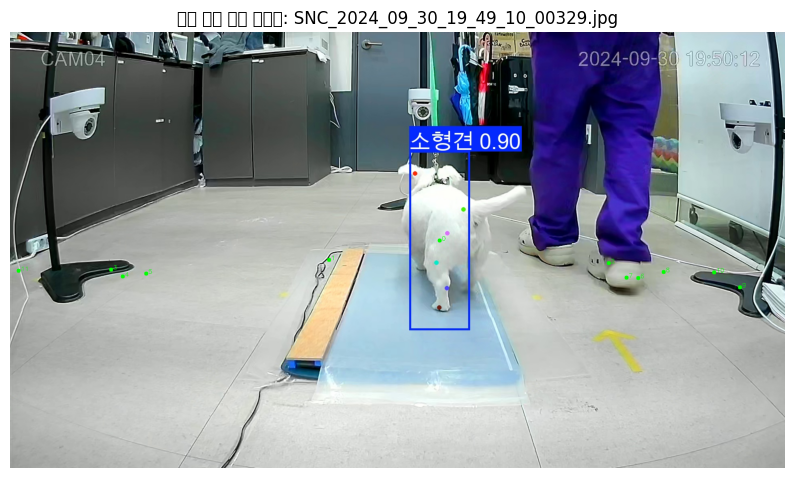

In [ ]:
# 최종 점검 시각화
# 최종 점검 - 시각화
import os
import cv2
import random
import matplotlib.pyplot as plt

# 경로 설정
image_dir = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs/predict_results"
label_dir = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs/predict_results/labels"

# keypoint 수
num_kpts = 12

# 파일 목록 불러오기
image_files = sorted([f for f in os.listdir(image_dir) if f.endswith(".jpg")])
label_files = sorted([f for f in os.listdir(label_dir) if f.endswith(".txt")])

# 파일명 기준으로 일치하는 페어만 선택
base_names = set(os.path.splitext(f)[0] for f in image_files) & set(os.path.splitext(f)[0] for f in label_files)
base_name = random.choice(list(base_names))  # 🔀 랜덤 선택

# 경로 설정
sample_image_path = os.path.join(image_dir, base_name + ".jpg")
sample_label_path = os.path.join(label_dir, base_name + ".txt")

# 이미지 불러오기
image = cv2.imread(sample_image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
h, w, _ = image.shape

# keypoint 추출
with open(sample_label_path, 'r') as f:
    line = f.readline().strip().split()
    keypoint_values = list(map(float, line[1:]))

keypoints = []
for i in range(num_kpts):
    x = keypoint_values[i * 3] * w
    y = keypoint_values[i * 3 + 1] * h
    v = keypoint_values[i * 3 + 2]
    if v > 0:
        keypoints.append((int(x), int(y)))
    else:
        keypoints.append(None)

# 시각화
for i, pt in enumerate(keypoints):
    if pt:
        cv2.circle(image, pt, 5, (0, 255, 0), -1)
        cv2.putText(image, str(i), (pt[0]+5, pt[1]), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)

# 출력
plt.figure(figsize=(10, 6))
plt.imshow(image)
plt.axis("off")
plt.title(f"랜덤 예측 결과 시각화: {base_name}.jpg")
plt.show()


In [ ]:
# tail도 마찬가지로 txt 파일 재확인 필요
bbox 탐지가 너무 작음


# 3.3.1 Yolo 다시 학습 - Tail 방향(bbox 크기 재조정한 txt 파일 적용)

In [ ]:
from ultralytics import YOLO
model = YOLO("/content/yolov8m-pose.pt")
model.train(
    data="/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail.yaml",
    epochs=100,
    imgsz=768,
    name="train_pose_model",  # 이건 하위 폴더 이름
    project="/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs_bbox",  # 이게 상위 경로!
    batch=8,
    optimizer="AdamW",
    lr0=0.001,
    close_mosaic=10
)

In [ ]:
# 학습 완료된 모델 불러오기
model = YOLO("/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs_bbox/train_pose_model/weights/best.pt")  # 학습된 best 모델 경로

# 예측 수행
results = model.predict(
    source="/content/drive/MyDrive/pet_angle_copy/dataset_split2/test/tail_image",
    project="/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs_bbox",  # 저장 루트 변경
    name="predict_results",   # 하위 폴더명 지정
    save=True,               # 예측 결과 이미지 저장
    save_txt=True,            # 예측된 keypoint 좌표 .txt 저장
    save_conf=True,             # confidence 포함 저장
    conf=0.25,                   # confidence threshold (필요 시 조절)
    imgsz=768                 # 학습할 때와 동일한 이미지 크기 사용
)

# 학습한 모델 불러오기
model = YOLO("/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs_bbox/train_pose_model/weights/best.pt")

# validation 수행
metrics = model.val(data="/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail.yaml", project="/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs_bbox/valid_results")


# 3.5 YOLO12 최신 버전으로 방향별 재학습 시켜보기

In [ ]:
✅ 최신 POSE 모델 상태
YOLO11-pose 모델들은 사전학습된 체크포인트와 함께 안정적으로 제공되고 있고,

YOLO12-pose 구성은 준비되었지만, 아직 공식 .pt 형식의 pretrained weight는 릴리스되지 않음.

.pt는 PyTorch 모델의 저장 파일 형식
PyTorch의 torch.save() 함수로 저장된 모델 파라미터 또는 전체 모델 구조가 담겨 있음

In [ ]:
import torch
print(torch.__version__)


2.6.0+cu124


In [ ]:
from ultralytics import YOLO

# Load a COCO-pretrained YOLO12n model
model = YOLO("yolo12n.pt")

# Train the model on the COCO8 example dataset for 100 epochs
results = model.train(data="coco8.yaml", epochs=100, imgsz=640)

# Run inference with the YOLO12n model on the 'bus.jpg' image
results = model("path/to/bus.jpg")

Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=coco8.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo12n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.0, pretrained=True, profile=F

Unzipping /content/datasets/coco8.zip to /content/datasets/coco8...: 100%|██████████| 25/25 [00:00<00:00, 4329.38file/s]

Dataset download success ✅ (0.6s), saved to /content/datasets


                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      6640  ultralytics.nn.modules.block.C3k2            [32, 64, 1, False, 0.25]      
  3                  -1  1     36992  ultralytics.nn.modules.conv.Conv             [64, 64, 3, 2]                
  4                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  5                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  6                  -1  2    180864  ultralytics.nn.modules.block.A2C2f           [128, 128, 2, True, 4]        
  7                  -1 

YOLOv12n summary: 272 layers, 2,602,288 parameters, 2,602,272 gradients, 6.7 GFLOPs

Transferred 691/691 items from pretrained weights
Freezing layer 'model.21.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...
AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1138.9±153.5 MB/s, size: 50.0 KB)


train: Scanning /content/datasets/coco8/labels/train... 4 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4/4 [00:00<00:00, 2331.79it/s]

train: New cache created: /content/datasets/coco8/labels/train.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 482.9±75.7 MB/s, size: 54.0 KB)


val: Scanning /content/datasets/coco8/labels/val... 4 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4/4 [00:00<00:00, 812.38it/s]

val: New cache created: /content/datasets/coco8/labels/val.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000119, momentum=0.9) with parameter groups 113 weight(decay=0.0), 120 weight(decay=0.0005), 119 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      1.27G     0.6978      1.354      1.215         29        640: 100%|██████████| 1/1 [00:00<00:00,  2.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.75it/s]


                   all          4         17     0.0263      0.217     0.0897     0.0471

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      1.31G      1.252      2.284      1.554         46        640: 100%|██████████| 1/1 [00:00<00:00,  6.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 13.01it/s]

                   all          4         17     0.0581      0.483      0.127      0.061



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      1.32G      1.453      2.191      1.973         11        640: 100%|██████████| 1/1 [00:00<00:00,  6.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 15.14it/s]

                   all          4         17     0.0794      0.567      0.139     0.0606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      1.32G      1.116      1.851      1.325         22        640: 100%|██████████| 1/1 [00:00<00:00,  6.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.10it/s]

                   all          4         17     0.0611      0.567      0.139     0.0745



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      1.35G     0.9548       1.86      1.308         39        640: 100%|██████████| 1/1 [00:00<00:00,  6.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 16.49it/s]

                   all          4         17      0.132      0.364       0.26      0.202



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      1.38G      0.771      1.528      1.205         26        640: 100%|██████████| 1/1 [00:00<00:00,  6.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.13it/s]

                   all          4         17      0.395      0.323      0.271      0.204



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100       1.4G      1.155      3.078      1.557         23        640: 100%|██████████| 1/1 [00:00<00:00,  6.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.24it/s]

                   all          4         17      0.584      0.284      0.278      0.207



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      1.41G     0.7947      1.437      1.245         16        640: 100%|██████████| 1/1 [00:00<00:00,  6.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.34it/s]

                   all          4         17      0.574      0.255      0.288       0.21



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      1.43G     0.9545      1.299      1.381         20        640: 100%|██████████| 1/1 [00:00<00:00,  6.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.11it/s]

                   all          4         17        0.6      0.272      0.294      0.205



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      1.44G     0.9696      1.373      1.308         29        640: 100%|██████████| 1/1 [00:00<00:00,  6.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 16.65it/s]

                   all          4         17      0.534      0.288        0.3      0.211



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      1.45G     0.9416      1.419      1.288         36        640: 100%|██████████| 1/1 [00:00<00:00,  6.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.16it/s]

                   all          4         17      0.543      0.371      0.371      0.238



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      1.47G     0.7694      1.341      1.232         27        640: 100%|██████████| 1/1 [00:00<00:00,  6.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 17.75it/s]

                   all          4         17      0.637      0.358      0.392      0.243



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      1.49G     0.7532       1.18      1.407         10        640: 100%|██████████| 1/1 [00:00<00:00,  6.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 16.09it/s]

                   all          4         17      0.713      0.358      0.445       0.29



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100       1.5G     0.6108     0.9553      1.065         23        640: 100%|██████████| 1/1 [00:00<00:00,  6.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.84it/s]

                   all          4         17      0.718      0.365      0.483      0.316



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      1.52G     0.7125      1.039      1.239         19        640: 100%|██████████| 1/1 [00:00<00:00,  6.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 17.69it/s]

                   all          4         17      0.717      0.364      0.505      0.353



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      1.53G     0.9007      1.395      1.233         32        640: 100%|██████████| 1/1 [00:00<00:00,  5.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.29it/s]

                   all          4         17      0.673        0.4      0.528      0.362



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      1.54G     0.8971     0.7955      1.368         17        640: 100%|██████████| 1/1 [00:00<00:00,  6.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.32it/s]

                   all          4         17      0.687      0.416      0.631      0.416



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      1.56G     0.7315      0.758      1.118         10        640: 100%|██████████| 1/1 [00:00<00:00,  8.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.71it/s]

                   all          4         17      0.687      0.416      0.631      0.416



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      1.58G     0.8027      1.335       1.36         19        640: 100%|██████████| 1/1 [00:00<00:00,  6.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.48it/s]

                   all          4         17      0.685      0.425      0.638      0.461



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      1.59G      1.129      1.055      1.575         23        640: 100%|██████████| 1/1 [00:00<00:00,  9.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.04it/s]

                   all          4         17      0.685      0.425      0.638      0.461



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      1.61G      1.065       1.31      1.449         23        640: 100%|██████████| 1/1 [00:00<00:00,  6.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.73it/s]

                   all          4         17      0.687      0.421      0.664      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      1.62G     0.9727     0.9341       1.29         40        640: 100%|██████████| 1/1 [00:00<00:00,  9.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 15.83it/s]

                   all          4         17      0.687      0.421      0.664      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      1.64G     0.6433     0.7047      1.146         23        640: 100%|██████████| 1/1 [00:00<00:00,  5.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.03it/s]

                   all          4         17      0.719      0.398      0.672      0.487



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      1.65G     0.8357      1.024      1.176         38        640: 100%|██████████| 1/1 [00:00<00:00,  8.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.11it/s]

                   all          4         17      0.719      0.398      0.672      0.487



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      1.67G     0.6805     0.5657      1.179         19        640: 100%|██████████| 1/1 [00:00<00:00,  6.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.50it/s]

                   all          4         17      0.722      0.388      0.674      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      1.68G     0.8542     0.9275       1.22         26        640: 100%|██████████| 1/1 [00:00<00:00,  9.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.03it/s]

                   all          4         17      0.722      0.388      0.674      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100       1.7G     0.8367     0.8729      1.199         23        640: 100%|██████████| 1/1 [00:00<00:00,  6.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.22it/s]

                   all          4         17      0.888        0.4      0.757       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      1.71G     0.6124     0.7196      1.147         23        640: 100%|██████████| 1/1 [00:00<00:00,  9.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.18it/s]

                   all          4         17      0.888        0.4      0.757       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      1.73G      1.001     0.8606      1.374         33        640: 100%|██████████| 1/1 [00:00<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.03it/s]

                   all          4         17      0.887      0.399       0.82      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      1.74G     0.7074     0.4137      1.232         13        640: 100%|██████████| 1/1 [00:00<00:00,  9.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 17.68it/s]

                   all          4         17      0.887      0.399       0.82      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      1.76G     0.8186      1.018      1.269         27        640: 100%|██████████| 1/1 [00:00<00:00,  6.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.35it/s]

                   all          4         17      0.728       0.45      0.818      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      1.77G     0.6749     0.5927      1.206         19        640: 100%|██████████| 1/1 [00:00<00:00,  8.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.91it/s]


                   all          4         17      0.728       0.45      0.818      0.567

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      1.79G     0.7677     0.9728      1.178         34        640: 100%|██████████| 1/1 [00:00<00:00,  5.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 17.87it/s]

                   all          4         17      0.727      0.633      0.819      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100       1.8G     0.7823     0.7588        1.2         30        640: 100%|██████████| 1/1 [00:00<00:00,  8.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 17.56it/s]

                   all          4         17      0.727      0.633      0.819      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      1.82G     0.6811     0.8128      1.131         25        640: 100%|██████████| 1/1 [00:00<00:00,  6.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 14.76it/s]

                   all          4         17      0.704      0.633      0.862       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      1.83G     0.7271     0.7918       1.09         41        640: 100%|██████████| 1/1 [00:00<00:00,  8.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.65it/s]


                   all          4         17      0.704      0.633      0.862       0.56

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      1.85G     0.5884     0.6209      1.028         40        640: 100%|██████████| 1/1 [00:00<00:00,  6.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 15.47it/s]

                   all          4         17      0.695      0.633      0.862      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      1.86G     0.8385     0.6995      1.257         20        640: 100%|██████████| 1/1 [00:00<00:00,  8.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 17.77it/s]

                   all          4         17      0.695      0.633      0.862      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      1.88G     0.7201     0.7064      1.115         28        640: 100%|██████████| 1/1 [00:00<00:00,  6.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.93it/s]

                   all          4         17      0.668      0.633      0.858      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      1.89G     0.4224     0.5304     0.9947         18        640: 100%|██████████| 1/1 [00:00<00:00,  9.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.38it/s]

                   all          4         17      0.668      0.633      0.858      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      1.91G     0.6856     0.6742      1.155         21        640: 100%|██████████| 1/1 [00:00<00:00,  6.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.87it/s]

                   all          4         17      0.685        0.6      0.828      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      1.92G     0.4942     0.5511      1.042         25        640: 100%|██████████| 1/1 [00:00<00:00,  8.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.36it/s]

                   all          4         17      0.685        0.6      0.828      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      1.94G     0.5566     0.6609      1.066         25        640: 100%|██████████| 1/1 [00:00<00:00,  6.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.66it/s]

                   all          4         17      0.702      0.593      0.854      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      1.95G     0.6645     0.4963      1.035         34        640: 100%|██████████| 1/1 [00:00<00:00,  9.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.32it/s]

                   all          4         17      0.702      0.593      0.854      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      1.97G     0.7077     0.6831      1.146         37        640: 100%|██████████| 1/1 [00:00<00:00,  6.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.35it/s]

                   all          4         17      0.706      0.583      0.825      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      1.98G     0.8093     0.5868      1.468         16        640: 100%|██████████| 1/1 [00:00<00:00,  8.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.61it/s]

                   all          4         17      0.706      0.583      0.825      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100         2G     0.6786     0.5227      1.194         21        640: 100%|██████████| 1/1 [00:00<00:00,  6.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.18it/s]

                   all          4         17       0.72      0.583      0.822      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      2.01G     0.9718     0.5941      1.475         19        640: 100%|██████████| 1/1 [00:00<00:00,  9.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 16.41it/s]

                   all          4         17       0.72      0.583      0.822      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      2.03G     0.5443     0.5977      1.053         26        640: 100%|██████████| 1/1 [00:00<00:00,  5.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.00it/s]

                   all          4         17      0.707      0.583      0.822      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      2.04G      0.549     0.4429      1.095         30        640: 100%|██████████| 1/1 [00:00<00:00,  8.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 17.85it/s]

                   all          4         17      0.707      0.583      0.822      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      2.06G     0.5684     0.6121     0.9712         38        640: 100%|██████████| 1/1 [00:00<00:00,  6.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.71it/s]

                   all          4         17      0.712      0.583      0.848      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      2.07G     0.6048     0.7756     0.9929         41        640: 100%|██████████| 1/1 [00:00<00:00,  8.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 16.79it/s]

                   all          4         17      0.712      0.583      0.848      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      2.09G     0.7659     0.5074      1.263         23        640: 100%|██████████| 1/1 [00:00<00:00,  8.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.24it/s]

                   all          4         17      0.712      0.583      0.848      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      2.11G     0.7252     0.5619      1.082         36        640: 100%|██████████| 1/1 [00:00<00:00,  6.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.12it/s]

                   all          4         17      0.719      0.574      0.847      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      2.12G     0.5763     0.6591      1.076         45        640: 100%|██████████| 1/1 [00:00<00:00,  7.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 17.89it/s]

                   all          4         17      0.719      0.574      0.847      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      2.14G     0.6209     0.5723      1.032         36        640: 100%|██████████| 1/1 [00:00<00:00,  8.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.23it/s]

                   all          4         17      0.719      0.574      0.847      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      2.15G     0.7773     0.7023       1.14         41        640: 100%|██████████| 1/1 [00:00<00:00,  6.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.75it/s]

                   all          4         17      0.724      0.567      0.875      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      2.16G     0.6131     0.4291      1.289         17        640: 100%|██████████| 1/1 [00:00<00:00,  9.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.45it/s]

                   all          4         17      0.724      0.567      0.875      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      2.18G     0.5535     0.7216      1.029         24        640: 100%|██████████| 1/1 [00:00<00:00,  8.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.55it/s]

                   all          4         17      0.724      0.567      0.875      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100       2.2G     0.4663     0.4321     0.9897         16        640: 100%|██████████| 1/1 [00:00<00:00,  6.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.89it/s]

                   all          4         17      0.727      0.567      0.875      0.582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      2.21G     0.6781     0.8568      1.114         30        640: 100%|██████████| 1/1 [00:00<00:00,  9.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.54it/s]

                   all          4         17      0.727      0.567      0.875      0.582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      2.23G     0.6318     0.4907      1.125         32        640: 100%|██████████| 1/1 [00:00<00:00,  8.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.83it/s]

                   all          4         17      0.727      0.567      0.875      0.582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      2.24G     0.5906     0.5992      1.083         27        640: 100%|██████████| 1/1 [00:00<00:00,  6.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.12it/s]

                   all          4         17      0.731      0.567      0.873      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      2.25G     0.6307     0.4093      1.038         34        640: 100%|██████████| 1/1 [00:00<00:00,  9.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.03it/s]

                   all          4         17      0.731      0.567      0.873      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      2.27G     0.7532      0.473       1.03         35        640: 100%|██████████| 1/1 [00:00<00:00,  8.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 17.43it/s]

                   all          4         17      0.731      0.567      0.873      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      2.29G     0.7878     0.5989      1.158         34        640: 100%|██████████| 1/1 [00:00<00:00,  5.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 16.81it/s]

                   all          4         17      0.738      0.567      0.902       0.54



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      2.29G     0.5394     0.4071      1.109         20        640: 100%|██████████| 1/1 [00:00<00:00,  9.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.72it/s]

                   all          4         17      0.738      0.567      0.902       0.54



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      2.32G     0.6467     0.5369      1.052         35        640: 100%|██████████| 1/1 [00:00<00:00,  8.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.62it/s]

                   all          4         17      0.738      0.567      0.902       0.54



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      2.33G     0.5066     0.4018      1.061         16        640: 100%|██████████| 1/1 [00:00<00:00,  6.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 15.30it/s]

                   all          4         17       0.75      0.567        0.9      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      2.34G     0.6429     0.4675      1.116         28        640: 100%|██████████| 1/1 [00:00<00:00,  8.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.52it/s]

                   all          4         17       0.75      0.567        0.9      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      2.36G     0.4688     0.3725     0.9709         31        640: 100%|██████████| 1/1 [00:00<00:00,  8.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.06it/s]

                   all          4         17       0.75      0.567        0.9      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      2.38G     0.5551     0.5378      1.088         23        640: 100%|██████████| 1/1 [00:00<00:00,  6.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 17.73it/s]

                   all          4         17      0.745      0.567        0.9      0.548



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      2.38G     0.4729     0.4782     0.9541         37        640: 100%|██████████| 1/1 [00:00<00:00,  9.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.06it/s]

                   all          4         17      0.745      0.567        0.9      0.548



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      2.41G     0.6422     0.6079      1.182         26        640: 100%|██████████| 1/1 [00:00<00:00,  8.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.40it/s]


                   all          4         17      0.745      0.567        0.9      0.548

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      2.42G      0.673      1.494      1.142         55        640: 100%|██████████| 1/1 [00:00<00:00,  6.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 17.92it/s]

                   all          4         17      0.751      0.567      0.899      0.546



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      2.43G     0.6145      0.429      1.165         27        640: 100%|██████████| 1/1 [00:00<00:00,  8.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 15.84it/s]


                   all          4         17      0.751      0.567      0.899      0.546

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      2.45G      0.702     0.5381      1.113         33        640: 100%|██████████| 1/1 [00:00<00:00,  8.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.56it/s]

                   all          4         17      0.751      0.567      0.899      0.546



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      2.47G     0.5369     0.5509       1.03         40        640: 100%|██████████| 1/1 [00:00<00:00,  6.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.27it/s]

                   all          4         17      0.741      0.567      0.895      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      2.47G     0.7555     0.5402      1.187         18        640: 100%|██████████| 1/1 [00:00<00:00,  7.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.06it/s]

                   all          4         17      0.741      0.567      0.895      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100       2.5G     0.5184      1.177      1.119         15        640: 100%|██████████| 1/1 [00:00<00:00,  8.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.46it/s]

                   all          4         17      0.741      0.567      0.895      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      2.51G     0.4281     0.4333     0.9533         29        640: 100%|██████████| 1/1 [00:00<00:00,  6.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.25it/s]

                   all          4         17      0.731      0.552      0.895      0.541



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      2.52G     0.6099     0.6852      1.082         32        640: 100%|██████████| 1/1 [00:00<00:00,  8.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.40it/s]

                   all          4         17      0.731      0.552      0.895      0.541



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      2.54G     0.4449     0.4277      0.984         25        640: 100%|██████████| 1/1 [00:00<00:00,  8.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 16.92it/s]


                   all          4         17      0.731      0.552      0.895      0.541

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      2.56G     0.7431     0.6503      1.143         37        640: 100%|██████████| 1/1 [00:00<00:00,  6.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 16.36it/s]

                   all          4         17      0.705      0.567      0.811      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      2.57G     0.5395     0.4264      1.196         14        640: 100%|██████████| 1/1 [00:00<00:00,  8.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.01it/s]

                   all          4         17      0.705      0.567      0.811      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      2.59G     0.4816     0.5222      1.059         15        640: 100%|██████████| 1/1 [00:00<00:00,  8.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.85it/s]

                   all          4         17      0.705      0.567      0.811      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100       2.6G     0.5618     0.4345      1.082         22        640: 100%|██████████| 1/1 [00:00<00:00,  8.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.51it/s]

                   all          4         17      0.705      0.567      0.811      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      2.62G     0.5199     0.5925      1.093         28        640: 100%|██████████| 1/1 [00:00<00:00,  6.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.21it/s]

                   all          4         17      0.678      0.579      0.808      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      2.62G     0.7046     0.5932      1.114         37        640: 100%|██████████| 1/1 [00:00<00:00,  8.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.65it/s]

                   all          4         17      0.678      0.579      0.808      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      2.65G     0.6429     0.4859      1.109         26        640: 100%|██████████| 1/1 [00:00<00:00,  8.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.13it/s]

                   all          4         17      0.678      0.579      0.808      0.542


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      2.66G     0.4543     0.3882      0.852         13        640: 100%|██████████| 1/1 [00:00<00:00,  4.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.76it/s]

                   all          4         17      0.678      0.579      0.808      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      2.68G     0.4263     0.3289     0.8514         13        640: 100%|██████████| 1/1 [00:00<00:00,  5.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 13.89it/s]

                   all          4         17      0.674      0.567      0.835      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      2.68G     0.5873     0.5072     0.8856         13        640: 100%|██████████| 1/1 [00:00<00:00,  8.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 15.54it/s]

                   all          4         17      0.674      0.567      0.835      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      2.71G     0.4079     0.3275     0.9223         13        640: 100%|██████████| 1/1 [00:00<00:00,  8.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.39it/s]

                   all          4         17      0.674      0.567      0.835      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      2.72G     0.4413     0.3856     0.8471         13        640: 100%|██████████| 1/1 [00:00<00:00,  8.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.81it/s]

                   all          4         17      0.674      0.567      0.835      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      2.74G     0.5416      0.386      1.148         13        640: 100%|██████████| 1/1 [00:00<00:00,  5.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.04it/s]

                   all          4         17      0.687      0.554      0.832      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      2.74G     0.4442     0.3842     0.9651         13        640: 100%|██████████| 1/1 [00:00<00:00,  8.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 16.51it/s]


                   all          4         17      0.687      0.554      0.832      0.537

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      2.77G     0.3679     0.2907     0.8937         13        640: 100%|██████████| 1/1 [00:00<00:00,  8.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.02it/s]

                   all          4         17      0.687      0.554      0.832      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      2.78G     0.4565     0.4915      0.973         13        640: 100%|██████████| 1/1 [00:00<00:00,  8.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 16.32it/s]

                   all          4         17      0.687      0.554      0.832      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      2.79G     0.3625     0.3309     0.8007         13        640: 100%|██████████| 1/1 [00:00<00:00,  5.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.39it/s]

                   all          4         17      0.751       0.55      0.913      0.608



100 epochs completed in 0.017 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 5.6MB
Optimizer stripped from runs/detect/train/weights/best.pt, 5.6MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
YOLOv12n summary (fused): 159 layers, 2,590,824 parameters, 0 gradients, 6.5 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 24.90it/s]


                   all          4         17      0.778       0.55      0.913      0.608
                person          3         10      0.858        0.3        0.5      0.256
                   dog          1          1      0.653          1      0.995      0.796
                 horse          1          2      0.545          1      0.995      0.574
              elephant          1          2          1          0      0.995      0.133
              umbrella          1          1      0.614          1      0.995      0.995
          potted plant          1          1          1          0      0.995      0.895
Speed: 0.2ms preprocess, 5.1ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to runs/detect/train



FileNotFoundError: path/to/bus.jpg does not exist

In [ ]:
from ultralytics import YOLO
model = YOLO("yolo12n-pose.pt")
model.train(
    data="/content/drive/MyDrive/pet_angle_copy/dataset_split2/front.yaml",
    epochs=100,
    imgsz=768,
    name="train_pose_model",  # 이건 하위 폴더 이름
    project="/content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_bbox",  # 이게 상위 경로!
    batch=8,
    optimizer="AdamW",
    lr0=0.001,
    close_mosaic=10
)


FileNotFoundError: [Errno 2] No such file or directory: 'yolo12n-pose.pt'

In [ ]:
from ultralytics import YOLO
model = YOLO("yolo11n-pose.pt")
model.train(
    data="/content/drive/MyDrive/pet_angle_copy/dataset_split2/front.yaml",
    epochs=100,
    imgsz=768,
    name="train_pose_model",  # 이건 하위 폴더 이름
    project="/content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_bbox",  # 이게 상위 경로!
    batch=8,
    optimizer="AdamW",
    lr0=0.001,
    close_mosaic=10
)


Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=8, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/pet_angle_copy/dataset_split2/front.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=768, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.001, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n-pose.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train_pose_model2, nbs=64, nms=False, opset=None, optimize=False, optimizer=AdamW, overlap_mask=True, patience=

AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.3±0.1 ms, read: 268.4±53.8 MB/s, size: 529.0 KB)


train: Scanning /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/front_image.cache... 287 images, 0 backgrounds, 0 corrupt: 100%|██████████| 287/287 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


WARNING ⚠️ val: Slow image access detected (ping: 37.3±81.9 ms, read: 79.3±85.2 MB/s, size: 518.3 KB). Use local storage instead of remote/mounted storage for better performance. See https://docs.ultralytics.com/guides/model-training-tips/


val: Scanning /content/drive/MyDrive/pet_angle_copy/dataset_split2/val/front_image.cache... 55 images, 0 backgrounds, 0 corrupt: 100%|██████████| 55/55 [00:00<?, ?it/s]


Plotting labels to /content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_bbox/train_pose_model2/labels.jpg... 
optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 87 weight(decay=0.0), 97 weight(decay=0.0005), 96 bias(decay=0.0)
Image sizes 768 train, 768 val
Using 8 dataloader workers
Logging results to /content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_bbox/train_pose_model2
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      1/100      2.21G      2.019      6.798     0.6193       3.47      2.386         12        768: 100%|██████████| 36/36 [00:05<00:00,  6.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.65it/s]

                   all         55         55      0.606     0.0727      0.125     0.0368       0.15     0.0182     0.0198    0.00328



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      2/100      2.21G       1.88      5.323     0.5289      1.835       2.16         15        768: 100%|██████████| 36/36 [00:04<00:00,  8.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.78it/s]

                   all         55         55      0.838      0.847      0.909      0.361      0.512      0.455      0.338      0.108



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      3/100      2.21G      1.826      4.727     0.5006      1.554      2.147         15        768: 100%|██████████| 36/36 [00:04<00:00,  8.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.77it/s]

                   all         55         55      0.944      0.873      0.962      0.398      0.501      0.455       0.39      0.132



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      4/100      2.21G      1.779      4.436     0.5039      1.482      2.085         16        768: 100%|██████████| 36/36 [00:04<00:00,  8.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.28it/s]

                   all         55         55      0.968      0.982      0.993      0.471      0.559      0.491      0.444      0.135



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      5/100      2.21G      1.862      4.361     0.4945      1.311       2.04         18        768: 100%|██████████| 36/36 [00:04<00:00,  8.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.87it/s]

                   all         55         55      0.881      0.964      0.953       0.46       0.51      0.473      0.308     0.0987



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      6/100      2.21G      1.766      4.125     0.5084      1.323      2.038         19        768: 100%|██████████| 36/36 [00:04<00:00,  8.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.16it/s]

                   all         55         55      0.964      0.976      0.965      0.462       0.64      0.646      0.518      0.145



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      7/100      2.21G      1.649       3.83      0.497       1.23      1.917         16        768: 100%|██████████| 36/36 [00:04<00:00,  8.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.03it/s]

                   all         55         55      0.981      0.927      0.988      0.464      0.546      0.509      0.388      0.119



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      8/100      2.21G      1.631      3.917     0.4783      1.137      1.889         19        768: 100%|██████████| 36/36 [00:04<00:00,  8.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.76it/s]

                   all         55         55      0.982      0.971      0.994      0.529      0.533      0.527      0.451      0.169



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      9/100      2.21G      1.688      3.702     0.4808      1.121      1.956         18        768: 100%|██████████| 36/36 [00:04<00:00,  8.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.36it/s]

                   all         55         55       0.92      0.909      0.969      0.566       0.71      0.618      0.581      0.204



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     10/100      2.21G      1.633      3.511     0.4902       1.16      1.903         18        768: 100%|██████████| 36/36 [00:04<00:00,  8.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.63it/s]

                   all         55         55      0.943      0.964       0.99      0.511      0.683      0.636      0.571      0.195



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     11/100      2.21G      1.618      3.541     0.4744      1.125      1.903          9        768: 100%|██████████| 36/36 [00:04<00:00,  8.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.19it/s]

                   all         55         55      0.928      0.964      0.966      0.404      0.415      0.491      0.256     0.0863



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     12/100      2.21G      1.638      3.562     0.4721      1.128      1.887         17        768: 100%|██████████| 36/36 [00:04<00:00,  8.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.35it/s]

                   all         55         55      0.954          1      0.991      0.564      0.776      0.764      0.647      0.216



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     13/100      2.21G       1.53      3.354     0.4753      1.053      1.811         13        768: 100%|██████████| 36/36 [00:04<00:00,  8.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.99it/s]

                   all         55         55      0.946          1      0.993      0.604      0.803      0.741      0.662       0.22



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     14/100      2.21G      1.469      3.289     0.4621          1      1.813         17        768: 100%|██████████| 36/36 [00:04<00:00,  8.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.41it/s]

                   all         55         55      0.964      0.978      0.981      0.593      0.754      0.745      0.653      0.216



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     15/100      2.21G      1.503      3.217     0.4573          1      1.856         14        768: 100%|██████████| 36/36 [00:04<00:00,  8.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.82it/s]

                   all         55         55      0.982       0.97      0.987        0.6      0.713      0.691      0.571      0.191



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     16/100      2.21G      1.478      3.216     0.4578     0.9517      1.816         21        768: 100%|██████████| 36/36 [00:04<00:00,  8.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.80it/s]

                   all         55         55       0.98      0.982      0.994      0.613      0.703      0.709      0.638       0.22



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     17/100      2.21G      1.545      3.136     0.4462      1.014      1.852         11        768: 100%|██████████| 36/36 [00:04<00:00,  8.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.06it/s]

                   all         55         55          1      0.948      0.994      0.632      0.753      0.691      0.616      0.229



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     18/100      2.21G      1.541      3.163     0.4501      1.031      1.825         11        768: 100%|██████████| 36/36 [00:04<00:00,  8.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.21it/s]


                   all         55         55      0.991      0.982      0.995      0.593        0.8      0.709      0.685      0.251

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     19/100      2.21G      1.516        3.2      0.454     0.9642      1.859         15        768: 100%|██████████| 36/36 [00:04<00:00,  8.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.93it/s]

                   all         55         55          1      0.994      0.995      0.647      0.787      0.739       0.66      0.219



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     20/100      2.21G      1.451      3.148     0.4466     0.9218      1.804         18        768: 100%|██████████| 36/36 [00:04<00:00,  8.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.84it/s]

                   all         55         55          1      0.981      0.994      0.565      0.627       0.61      0.466      0.169



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     21/100      2.21G      1.515      3.101     0.4488     0.9273      1.814         16        768: 100%|██████████| 36/36 [00:04<00:00,  8.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.78it/s]

                   all         55         55      0.961      0.964      0.981      0.572      0.797      0.745      0.633      0.252



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     22/100      2.21G      1.488      3.089     0.4473     0.9355      1.773         16        768: 100%|██████████| 36/36 [00:04<00:00,  8.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.37it/s]

                   all         55         55      0.977      0.982      0.987      0.606      0.772       0.74      0.634      0.219



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     23/100      2.21G      1.394      2.955      0.443     0.8848      1.752         14        768: 100%|██████████| 36/36 [00:04<00:00,  8.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.28it/s]

                   all         55         55      0.961      0.982       0.96      0.625      0.792      0.745       0.62      0.248



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     24/100      2.21G      1.397      3.126     0.4424     0.8815      1.723         14        768: 100%|██████████| 36/36 [00:04<00:00,  8.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.62it/s]

                   all         55         55          1      0.978      0.995      0.611      0.722      0.708      0.598      0.215



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     25/100      2.21G      1.427      2.961     0.4393     0.9486      1.747         13        768: 100%|██████████| 36/36 [00:04<00:00,  8.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.13it/s]

                   all         55         55      0.981          1      0.991      0.538      0.757      0.745      0.586      0.253



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     26/100      2.21G      1.417      3.105     0.4401     0.8867       1.71         15        768: 100%|██████████| 36/36 [00:04<00:00,  8.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.22it/s]

                   all         55         55      0.993          1      0.995      0.682       0.77      0.764      0.675      0.295



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     27/100      2.21G        1.4      3.006     0.4452     0.8862      1.723         14        768: 100%|██████████| 36/36 [00:04<00:00,  8.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.00it/s]

                   all         55         55       0.98      0.982      0.992      0.648       0.81      0.777      0.692      0.276



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     28/100      2.21G       1.38      2.991     0.4455     0.8656      1.731         14        768: 100%|██████████| 36/36 [00:04<00:00,  8.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.30it/s]

                   all         55         55      0.982      0.978      0.992      0.619      0.781      0.779      0.699      0.291



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     29/100      2.21G      1.335      2.861     0.4344     0.8364      1.659         18        768: 100%|██████████| 36/36 [00:04<00:00,  8.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.87it/s]

                   all         55         55      0.947      0.979      0.987      0.678      0.678      0.691      0.561      0.209



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     30/100      2.21G      1.373      2.747     0.4429     0.8573      1.744         13        768: 100%|██████████| 36/36 [00:04<00:00,  8.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.40it/s]

                   all         55         55      0.979          1      0.993      0.638      0.764      0.782      0.722      0.303



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     31/100      2.21G      1.323      2.654     0.4288     0.8104      1.681         18        768: 100%|██████████| 36/36 [00:04<00:00,  8.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.30it/s]

                   all         55         55      0.962      0.982      0.992      0.675      0.694      0.709      0.621      0.231



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     32/100      2.21G      1.321      2.944     0.4406     0.8211      1.714         19        768: 100%|██████████| 36/36 [00:04<00:00,  8.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.44it/s]

                   all         55         55          1      0.995      0.995       0.66      0.751      0.727      0.611      0.239



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     33/100      2.21G      1.306      2.748     0.4433     0.7837      1.706         12        768: 100%|██████████| 36/36 [00:04<00:00,  8.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.03it/s]

                   all         55         55      0.994      0.982      0.995      0.694      0.773      0.764      0.712      0.322



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     34/100      2.21G      1.271        2.6     0.4382     0.7703      1.621         13        768: 100%|██████████| 36/36 [00:04<00:00,  8.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.68it/s]

                   all         55         55      0.996      0.982      0.995      0.688      0.724      0.709      0.589       0.27



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     35/100      2.21G      1.293      2.673     0.4271     0.7691      1.655         15        768: 100%|██████████| 36/36 [00:04<00:00,  8.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.85it/s]

                   all         55         55      0.982      0.999      0.995      0.703      0.874        0.8      0.777      0.358



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     36/100      2.21G      1.256      2.758     0.4371     0.7601      1.621         13        768: 100%|██████████| 36/36 [00:04<00:00,  8.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.33it/s]

                   all         55         55      0.979          1      0.995      0.722      0.867      0.855      0.826      0.395



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     37/100      2.21G      1.233      2.542     0.4307     0.7586      1.606         14        768: 100%|██████████| 36/36 [00:04<00:00,  8.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.36it/s]

                   all         55         55      0.999          1      0.995      0.717       0.81        0.8      0.701      0.339



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     38/100      2.21G      1.287      2.519      0.426     0.7981      1.667         16        768: 100%|██████████| 36/36 [00:04<00:00,  8.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.00it/s]

                   all         55         55      0.964          1      0.992      0.625      0.839      0.855      0.825      0.365



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     39/100      2.21G      1.265      2.561     0.4314      0.782      1.623         15        768: 100%|██████████| 36/36 [00:04<00:00,  8.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.97it/s]

                   all         55         55      0.982      0.995      0.995      0.697      0.801        0.8      0.722       0.36



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     40/100      2.21G      1.241      2.548     0.4285     0.7636      1.595         19        768: 100%|██████████| 36/36 [00:04<00:00,  8.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.34it/s]

                   all         55         55      0.994          1      0.995      0.709      0.846      0.797      0.736      0.382



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     41/100      2.21G      1.221      2.454      0.437     0.7693      1.608         17        768: 100%|██████████| 36/36 [00:04<00:00,  8.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.30it/s]

                   all         55         55          1      0.979      0.995      0.688      0.805      0.782      0.773      0.374



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     42/100      2.21G      1.202      2.599     0.4352     0.7345      1.598         18        768: 100%|██████████| 36/36 [00:04<00:00,  8.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.97it/s]

                   all         55         55      0.959          1      0.992      0.618      0.815      0.782      0.752      0.431



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     43/100      2.21G      1.189      2.545     0.4369     0.7308      1.585         16        768: 100%|██████████| 36/36 [00:04<00:00,  8.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.90it/s]

                   all         55         55       0.96          1       0.99        0.7      0.809      0.768      0.764      0.366



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     44/100      2.21G       1.21      2.571     0.4235     0.7344      1.609         14        768: 100%|██████████| 36/36 [00:04<00:00,  8.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.91it/s]

                   all         55         55      0.981          1      0.995      0.697      0.909      0.836      0.813      0.444



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     45/100      2.21G      1.184      2.367     0.4269     0.7433       1.54         11        768: 100%|██████████| 36/36 [00:04<00:00,  8.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.80it/s]

                   all         55         55      0.982          1      0.988      0.738      0.885      0.891      0.856      0.466



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     46/100      2.21G       1.23      2.589     0.4313     0.7509      1.636         16        768: 100%|██████████| 36/36 [00:04<00:00,  8.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.25it/s]

                   all         55         55      0.982          1       0.99      0.741      0.827      0.836      0.739      0.413



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     47/100      2.21G      1.157      2.363     0.4152      0.716      1.536         12        768: 100%|██████████| 36/36 [00:04<00:00,  8.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.54it/s]

                   all         55         55      0.982          1      0.995      0.716      0.829      0.818      0.753      0.359



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     48/100      2.21G      1.201      2.298      0.425     0.7354      1.581         16        768: 100%|██████████| 36/36 [00:04<00:00,  8.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.14it/s]

                   all         55         55       0.98          1      0.995       0.72      0.873      0.891       0.84      0.469



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     49/100      2.21G      1.146      2.325     0.4383     0.6911      1.542         13        768: 100%|██████████| 36/36 [00:04<00:00,  8.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.77it/s]

                   all         55         55      0.982      0.982      0.995      0.748      0.872      0.873      0.814      0.478



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     50/100      2.21G      1.089      2.317     0.4224     0.6709      1.487         16        768: 100%|██████████| 36/36 [00:04<00:00,  8.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.24it/s]

                   all         55         55      0.994          1      0.995       0.73      0.886      0.891      0.863      0.462



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     51/100      2.21G      1.083      2.301     0.4211     0.6814      1.484         15        768: 100%|██████████| 36/36 [00:04<00:00,  8.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.51it/s]

                   all         55         55      0.995          1      0.995      0.739      0.904      0.909      0.859      0.462



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     52/100      2.21G      1.087       2.22     0.4244     0.6506      1.511         18        768: 100%|██████████| 36/36 [00:04<00:00,  8.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.19it/s]

                   all         55         55      0.999          1      0.995      0.758      0.926      0.927      0.926      0.525



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     53/100      2.21G      1.087      2.232      0.437     0.6818      1.518          8        768: 100%|██████████| 36/36 [00:04<00:00,  8.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.96it/s]

                   all         55         55      0.996          1      0.995      0.718      0.909      0.909        0.9      0.514



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     54/100      2.21G      1.124      2.094     0.4197     0.7223      1.521         17        768: 100%|██████████| 36/36 [00:04<00:00,  8.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.30it/s]

                   all         55         55      0.996          1      0.995      0.751      0.889      0.874      0.877      0.514



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     55/100      2.21G      1.108      2.139     0.4202     0.6577      1.497         11        768: 100%|██████████| 36/36 [00:04<00:00,  8.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.52it/s]

                   all         55         55          1      0.999      0.995      0.721      0.891      0.891       0.86      0.505



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     56/100      2.21G      1.138      2.241     0.4235     0.6952      1.512         20        768: 100%|██████████| 36/36 [00:04<00:00,  8.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.95it/s]

                   all         55         55      0.997          1      0.995       0.73      0.872      0.873      0.831       0.49



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     57/100      2.21G       1.06      2.281     0.4261     0.6523      1.475         17        768: 100%|██████████| 36/36 [00:04<00:00,  8.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.79it/s]


                   all         55         55      0.998          1      0.995      0.757      0.889      0.891      0.875      0.517

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     58/100      2.21G      1.094      2.012     0.4133     0.6843      1.484         19        768: 100%|██████████| 36/36 [00:04<00:00,  8.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.68it/s]

                   all         55         55      0.996          1      0.995      0.755      0.869      0.873      0.857      0.491



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     59/100      2.21G      1.076      2.189     0.4348      0.626      1.458         13        768: 100%|██████████| 36/36 [00:04<00:00,  8.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.96it/s]

                   all         55         55      0.994          1      0.995       0.73      0.889      0.891      0.868      0.523



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     60/100      2.21G      1.067      2.228     0.4221      0.637      1.444         21        768: 100%|██████████| 36/36 [00:04<00:00,  8.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.62it/s]

                   all         55         55      0.996          1      0.995      0.786      0.888      0.891      0.845      0.491



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     61/100      2.21G      1.078      2.057     0.4165     0.6508      1.457         14        768: 100%|██████████| 36/36 [00:04<00:00,  8.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.78it/s]

                   all         55         55      0.982          1      0.995      0.783      0.885      0.891      0.883      0.558



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     62/100      2.21G      1.054      2.027     0.4284     0.6429      1.452         14        768: 100%|██████████| 36/36 [00:04<00:00,  8.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.38it/s]

                   all         55         55      0.982          1      0.995      0.771      0.893      0.909      0.909      0.564



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     63/100      2.21G      1.012      2.015     0.4218      0.605      1.407         20        768: 100%|██████████| 36/36 [00:04<00:00,  8.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.99it/s]

                   all         55         55       0.98          1      0.994       0.74      0.909      0.927      0.916      0.546



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     64/100      2.21G     0.9574      1.946     0.4167     0.6158      1.397         16        768: 100%|██████████| 36/36 [00:04<00:00,  8.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.67it/s]

                   all         55         55       0.98          1      0.994      0.758      0.877      0.891      0.872      0.576



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     65/100      2.21G      1.073      2.113     0.4293     0.6214      1.455         11        768: 100%|██████████| 36/36 [00:04<00:00,  8.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.03it/s]

                   all         55         55       0.98          1      0.995       0.81      0.891      0.909      0.882      0.568



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     66/100      2.21G      1.033      2.039     0.4282     0.6242      1.456         18        768: 100%|██████████| 36/36 [00:04<00:00,  8.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.69it/s]

                   all         55         55       0.99          1      0.995      0.774      0.899      0.909      0.893       0.52



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     67/100      2.21G     0.9926      2.032      0.431     0.5859      1.399         16        768: 100%|██████████| 36/36 [00:04<00:00,  8.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.44it/s]

                   all         55         55      0.998          1      0.995      0.762      0.889      0.891      0.881      0.561



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     68/100      2.21G      1.019      1.829     0.4155       0.61      1.458         13        768: 100%|██████████| 36/36 [00:04<00:00,  8.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.39it/s]

                   all         55         55      0.996          1      0.995      0.793      0.906      0.909      0.896      0.588



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     69/100      2.21G      1.017      1.927     0.4293      0.591       1.42         15        768: 100%|██████████| 36/36 [00:04<00:00,  8.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.98it/s]

                   all         55         55      0.989          1      0.995      0.783      0.898      0.909      0.887      0.546



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     70/100      2.21G          1      1.995     0.4223     0.5971      1.423         21        768: 100%|██████████| 36/36 [00:04<00:00,  8.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.80it/s]

                   all         55         55      0.997          1      0.995      0.765      0.888      0.891      0.889      0.531



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     71/100      2.21G     0.9909      1.984     0.4291     0.5782      1.409         16        768: 100%|██████████| 36/36 [00:04<00:00,  8.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.74it/s]

                   all         55         55      0.998          1      0.995       0.76      0.926      0.927      0.917      0.538



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     72/100      2.21G      1.012      1.988     0.4202     0.6216      1.406         17        768: 100%|██████████| 36/36 [00:04<00:00,  8.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.08it/s]

                   all         55         55      0.998          1      0.995      0.799      0.922      0.891      0.902       0.56



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     73/100      2.21G     0.9634      1.798     0.4157     0.5784      1.366         10        768: 100%|██████████| 36/36 [00:04<00:00,  8.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.44it/s]

                   all         55         55      0.997          1      0.995      0.811      0.927      0.927      0.925      0.574



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     74/100      2.21G     0.9793      1.712     0.4217      0.627      1.375         10        768: 100%|██████████| 36/36 [00:04<00:00,  8.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.90it/s]

                   all         55         55      0.998          1      0.995      0.778       0.91      0.909      0.904      0.551



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     75/100      2.21G     0.9827      1.901     0.4144     0.6243      1.395         21        768: 100%|██████████| 36/36 [00:04<00:00,  8.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.35it/s]

                   all         55         55      0.993          1      0.995      0.806      0.923      0.927      0.924      0.543



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     76/100      2.21G     0.9109      1.784     0.4228     0.5548      1.344         14        768: 100%|██████████| 36/36 [00:04<00:00,  8.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.00it/s]

                   all         55         55      0.996          1      0.995      0.835      0.923      0.927      0.926      0.617



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     77/100      2.21G     0.9124      1.856     0.4231     0.5734      1.358         15        768: 100%|██████████| 36/36 [00:04<00:00,  8.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.20it/s]

                   all         55         55      0.997          1      0.995      0.802      0.906      0.909      0.902      0.642



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     78/100      2.21G     0.9598      1.759     0.4158     0.6153      1.392         21        768: 100%|██████████| 36/36 [00:04<00:00,  8.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.35it/s]

                   all         55         55       0.98          1      0.995      0.814      0.917      0.909      0.897      0.624



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     79/100      2.21G     0.9198      1.676     0.4057     0.5912      1.373         10        768: 100%|██████████| 36/36 [00:04<00:00,  8.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.04it/s]

                   all         55         55       0.98          1      0.995      0.825       0.89      0.909      0.894      0.619



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     80/100      2.21G     0.9139       1.71      0.414     0.5668      1.317          9        768: 100%|██████████| 36/36 [00:04<00:00,  8.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.77it/s]

                   all         55         55       0.98          1      0.995      0.817      0.908      0.927      0.926      0.617



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     81/100      2.21G      0.942      1.682     0.4171     0.6046      1.329         14        768: 100%|██████████| 36/36 [00:04<00:00,  7.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.97it/s]

                   all         55         55      0.979          1      0.995      0.814       0.89      0.909      0.893      0.618



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     82/100      2.21G     0.9092      1.877      0.422     0.5817      1.342         17        768: 100%|██████████| 36/36 [00:04<00:00,  8.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.77it/s]

                   all         55         55      0.983          1      0.995      0.816      0.894      0.909      0.891      0.605



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     83/100      2.21G      0.919      1.837     0.4291     0.5826      1.352         14        768: 100%|██████████| 36/36 [00:04<00:00,  8.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.54it/s]

                   all         55         55      0.992          1      0.995      0.815      0.939      0.945      0.951      0.608



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     84/100      2.21G     0.9093      1.772     0.4219      0.556      1.341          9        768: 100%|██████████| 36/36 [00:04<00:00,  8.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.37it/s]

                   all         55         55      0.993          1      0.995      0.812      0.903      0.909      0.905      0.629



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     85/100      2.21G      0.899      1.781      0.421     0.5535       1.32         14        768: 100%|██████████| 36/36 [00:04<00:00,  8.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.32it/s]

                   all         55         55      0.997          1      0.995      0.803      0.924      0.927      0.931      0.634



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     86/100      2.21G     0.9021      1.615     0.4186     0.5803      1.316         15        768: 100%|██████████| 36/36 [00:04<00:00,  8.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.54it/s]

                   all         55         55      0.993          1      0.995      0.821      0.939      0.945      0.939       0.63



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     87/100      2.21G     0.8871       1.71     0.4097     0.5536      1.325         17        768: 100%|██████████| 36/36 [00:04<00:00,  8.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.35it/s]

                   all         55         55      0.996          1      0.995      0.824      0.924      0.927      0.921      0.634



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     88/100      2.21G     0.9469      1.803     0.4094     0.5876      1.362         14        768: 100%|██████████| 36/36 [00:04<00:00,  8.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.72it/s]

                   all         55         55      0.996          1      0.995      0.828      0.924      0.927      0.921      0.633



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     89/100      2.21G     0.8985      1.706     0.4167     0.5832      1.336         15        768: 100%|██████████| 36/36 [00:04<00:00,  8.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.23it/s]

                   all         55         55      0.997          1      0.995      0.827      0.925      0.927      0.919      0.632



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     90/100      2.21G     0.8411      1.704     0.4179     0.5462        1.3         14        768: 100%|██████████| 36/36 [00:04<00:00,  8.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.05it/s]

                   all         55         55      0.998          1      0.995      0.835      0.925      0.927      0.931      0.619


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     91/100      2.28G     0.7935      1.601     0.4491     0.4313      1.302          7        768: 100%|██████████| 36/36 [00:04<00:00,  7.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.70it/s]

                   all         55         55      0.994          1      0.995      0.815       0.94      0.945      0.933      0.587



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     92/100      2.28G     0.7419      1.579     0.4445     0.4186      1.312          7        768: 100%|██████████| 36/36 [00:04<00:00,  8.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.45it/s]

                   all         55         55      0.991          1      0.995      0.808        0.9      0.909      0.873       0.59



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     93/100      2.28G     0.7598       1.58     0.4457     0.4175      1.282          7        768: 100%|██████████| 36/36 [00:04<00:00,  8.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.73it/s]

                   all         55         55      0.995          1      0.995      0.815      0.922      0.927      0.885      0.597



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     94/100      2.28G     0.7591      1.562     0.4434     0.4043      1.299          7        768: 100%|██████████| 36/36 [00:04<00:00,  8.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.98it/s]

                   all         55         55      0.996          1      0.995      0.824      0.923      0.927        0.9       0.61



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     95/100      2.28G     0.6957      1.517     0.4426     0.3843      1.254          7        768: 100%|██████████| 36/36 [00:04<00:00,  8.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.17it/s]

                   all         55         55      0.997          1      0.995      0.821      0.925      0.927      0.907      0.619



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     96/100      2.28G      0.725      1.498     0.4472     0.3893       1.26          7        768: 100%|██████████| 36/36 [00:04<00:00,  8.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.97it/s]

                   all         55         55      0.997          1      0.995      0.841      0.942      0.945      0.928      0.633



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     97/100      2.28G     0.7136      1.482     0.4386      0.393      1.249          7        768: 100%|██████████| 36/36 [00:04<00:00,  8.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.61it/s]

                   all         55         55      0.996          1      0.995      0.833      0.942      0.945      0.929      0.635



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     98/100      2.28G     0.6684      1.489      0.442     0.3803      1.221          7        768: 100%|██████████| 36/36 [00:04<00:00,  8.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.64it/s]

                   all         55         55      0.996          1      0.995      0.839      0.941      0.945      0.928      0.636



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     99/100      2.28G     0.6788      1.463      0.439     0.3743      1.209          7        768: 100%|██████████| 36/36 [00:04<00:00,  8.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.77it/s]

                   all         55         55      0.995          1      0.995      0.837      0.923      0.927       0.91      0.634



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


    100/100      2.28G     0.6876      1.466     0.4452     0.3803      1.252          7        768: 100%|██████████| 36/36 [00:04<00:00,  8.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.57it/s]

                   all         55         55      0.996          1      0.995      0.842      0.905      0.909      0.899      0.642



100 epochs completed in 0.140 hours.
Optimizer stripped from /content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_bbox/train_pose_model2/weights/last.pt, 5.9MB
Optimizer stripped from /content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_bbox/train_pose_model2/weights/best.pt, 5.9MB

Validating /content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_bbox/train_pose_model2/weights/best.pt...
Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
YOLO11n-pose summary (fused): 109 layers, 2,766,898 parameters, 0 gradients, 7.0 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.25it/s]


                   all         55         55      0.996          1      0.995      0.842      0.941      0.945       0.93      0.645
                   소형견         55         55      0.996          1      0.995      0.842      0.941      0.945       0.93      0.645
Speed: 0.3ms preprocess, 1.6ms inference, 0.0ms loss, 1.9ms postprocess per image
Results saved to /content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_bbox/train_pose_model2


ultralytics.utils.metrics.PoseMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7eae436e0110>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)', 'Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)', 'Precision-Recall(P)', 'F1-Confidence(P)', 'Precision-Confidence(P)', 'Recall-Confidence(P)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034, 

In [ ]:
✅ 종합 평가
항목	평가
BBox 성능	✅ 거의 완벽
Pose 성능	✅ 매우 우수 (정확도 높음, 일관성 좋음)
Overfitting	❌ 없음 (R=1.0이라도, P 유지됨)
Loss 이슈	🔶 pose_loss는 높은 편이지만 실제 정확도 문제 없음
실전 적용 가능성	✅ 매우 높음

# 3.5.1 YOLO11, SIDE 방향 재학습

In [ ]:
# /content/yolo11n-pose.pt

In [ ]:
!mv /content/yolo11n-pose.pt /content/drive/MyDrive/pet_angle_copy

In [ ]:
from ultralytics import YOLO
model = YOLO("yolo11n-pose.pt")
model.train(
    data="/content/drive/MyDrive/pet_angle_copy/dataset_split2/side.yaml",
    epochs=100,
    imgsz=768,
    name="train_pose_model",  # 이건 하위 폴더 이름
    project="/content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs_yolo11",  # 이게 상위 경로!
    batch=8,
    optimizer="AdamW",
    lr0=0.001,
    close_mosaic=10
)


Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=8, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/pet_angle_copy/dataset_split2/side.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=768, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.001, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n-pose.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train_pose_model, nbs=64, nms=False, opset=None, optimize=False, optimizer=AdamW, overlap_mask=True, patience=10

train: Scanning /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/side_image.cache... 342 images, 0 backgrounds, 0 corrupt: 100%|██████████| 342/342 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.3±0.0 ms, read: 1.1±0.3 MB/s, size: 425.8 KB)


val: Scanning /content/drive/MyDrive/pet_angle_copy/dataset_split2/val/side_image.cache... 79 images, 0 backgrounds, 0 corrupt: 100%|██████████| 79/79 [00:00<?, ?it/s]


Plotting labels to /content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs_yolo11/train_pose_model/labels.jpg... 
optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 87 weight(decay=0.0), 97 weight(decay=0.0005), 96 bias(decay=0.0)
Image sizes 768 train, 768 val
Using 8 dataloader workers
Logging results to /content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs_yolo11/train_pose_model
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      1/100      1.83G      1.634      9.017     0.5904      2.397      1.757          9        768: 100%|██████████| 43/43 [00:25<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.41it/s]

                   all         79         79       0.82       0.75      0.837      0.402          0          0          0          0



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      2/100      1.84G      1.464      8.186     0.5592      1.127      1.512         13        768: 100%|██████████| 43/43 [00:05<00:00,  8.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.77it/s]


                   all         79         79      0.924       0.92      0.956      0.594          0          0          0          0

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      3/100      1.84G      1.402      7.663     0.5718     0.9773      1.467          9        768: 100%|██████████| 43/43 [00:04<00:00,  8.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.60it/s]


                   all         79         79      0.994      0.962      0.994      0.609          0          0          0          0

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      4/100      1.84G      1.391      7.416     0.5544     0.9589      1.456         16        768: 100%|██████████| 43/43 [00:05<00:00,  8.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.65it/s]

                   all         79         79      0.961      0.934       0.99      0.643     0.0651     0.0633      0.005   0.000534



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      5/100      1.86G      1.367       7.23     0.5484     0.8955      1.417         16        768: 100%|██████████| 43/43 [00:04<00:00,  9.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.92it/s]

                   all         79         79      0.962      0.987      0.992      0.601      0.049     0.0506    0.00423   0.000471



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      6/100      1.86G      1.291      6.792     0.5645     0.8217      1.381         12        768: 100%|██████████| 43/43 [00:05<00:00,  8.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.00it/s]

                   all         79         79      0.991      0.962      0.992      0.677      0.014     0.0127   0.000736   7.36e-05



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      7/100      1.86G      1.268      6.615     0.5318     0.8198      1.345          8        768: 100%|██████████| 43/43 [00:04<00:00,  8.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.75it/s]


                   all         79         79      0.939       0.97      0.987      0.677     0.0302     0.0253    0.00168   0.000168

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      8/100      1.86G       1.28      6.432     0.5543     0.8363      1.386         18        768: 100%|██████████| 43/43 [00:04<00:00,  8.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.68it/s]

                   all         79         79      0.985      0.987      0.993      0.663     0.0291     0.0253    0.00168   0.000168



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      9/100      1.86G      1.253       6.26     0.5546     0.8092      1.346         16        768: 100%|██████████| 43/43 [00:05<00:00,  8.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.07it/s]

                   all         79         79      0.986          1      0.995      0.692      0.132      0.127     0.0297    0.00344



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     10/100      1.86G      1.197      6.135     0.5498     0.7678      1.327         14        768: 100%|██████████| 43/43 [00:04<00:00,  8.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.11it/s]

                   all         79         79      0.987          1      0.995      0.692      0.125      0.127     0.0212    0.00212



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     11/100      1.86G      1.178      5.914     0.5215     0.7282      1.295         17        768: 100%|██████████| 43/43 [00:04<00:00,  8.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.16it/s]

                   all         79         79      0.996      0.987      0.995       0.74     0.0894     0.0886      0.022    0.00334



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     12/100      1.88G      1.155      5.724     0.5282     0.7247       1.29         13        768: 100%|██████████| 43/43 [00:04<00:00,  8.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.80it/s]

                   all         79         79      0.962          1      0.994      0.705      0.271      0.266       0.11     0.0124



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     13/100      1.89G      1.093      5.722     0.5262     0.7145      1.258         17        768: 100%|██████████| 43/43 [00:04<00:00,  8.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.88it/s]

                   all         79         79      0.974      0.987      0.989      0.708      0.125      0.127     0.0304     0.0047



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     14/100      1.89G      1.101      5.546     0.5233     0.6878      1.243         13        768: 100%|██████████| 43/43 [00:05<00:00,  8.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.75it/s]

                   all         79         79      0.985      0.975      0.989      0.725       0.32      0.316      0.131     0.0193



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     15/100      1.89G      1.115      5.475     0.5054     0.6807      1.248         12        768: 100%|██████████| 43/43 [00:04<00:00,  8.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.49it/s]

                   all         79         79      0.985          1      0.995      0.735      0.337      0.329      0.217     0.0443



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     16/100      1.91G      1.105       5.43      0.511     0.7132       1.25         16        768: 100%|██████████| 43/43 [00:04<00:00,  8.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.16it/s]

                   all         79         79      0.986      0.987      0.993      0.726      0.381       0.38      0.158     0.0251



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     17/100      1.91G       1.12      5.341     0.5432     0.6927      1.261         16        768: 100%|██████████| 43/43 [00:05<00:00,  8.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.85it/s]

                   all         79         79      0.974          1      0.994      0.744      0.261      0.253     0.0786     0.0121



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     18/100      1.91G      1.074      5.351      0.522     0.6856      1.225         11        768: 100%|██████████| 43/43 [00:04<00:00,  8.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.39it/s]

                   all         79         79      0.971      0.987      0.994      0.723      0.398       0.38      0.261     0.0382



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     19/100      1.91G      1.098      5.383     0.5314      0.657      1.214         17        768: 100%|██████████| 43/43 [00:04<00:00,  8.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.92it/s]

                   all         79         79      0.985          1      0.994      0.711      0.332      0.329      0.159      0.026



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     20/100      1.91G      1.042      5.186     0.5047     0.6476      1.203          7        768: 100%|██████████| 43/43 [00:04<00:00,  8.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.92it/s]


                   all         79         79      0.987      0.999      0.995      0.725      0.361      0.367      0.227     0.0404

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     21/100      1.91G      1.099      5.281     0.5196     0.6699      1.256         14        768: 100%|██████████| 43/43 [00:04<00:00,  9.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.48it/s]

                   all         79         79      0.986          1      0.994      0.739      0.468      0.468      0.347     0.0727



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     22/100      1.91G       1.07      5.154      0.499     0.6648      1.235         17        768: 100%|██████████| 43/43 [00:05<00:00,  8.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.96it/s]

                   all         79         79      0.975      0.997      0.993      0.691      0.434       0.43      0.278     0.0563



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     23/100      1.91G      1.026      5.225     0.5005     0.6244      1.199         12        768: 100%|██████████| 43/43 [00:04<00:00,  8.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.70it/s]

                   all         79         79      0.986          1      0.992      0.757      0.413      0.405      0.272     0.0624



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     24/100      1.91G      1.051        4.9     0.5002     0.6661      1.195         18        768: 100%|██████████| 43/43 [00:04<00:00,  8.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.16it/s]

                   all         79         79      0.986          1      0.995      0.765      0.422      0.392       0.29     0.0539



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     25/100      1.91G      1.034      5.042     0.4961     0.6287      1.221         10        768: 100%|██████████| 43/43 [00:05<00:00,  8.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.98it/s]

                   all         79         79      0.987      0.975      0.994      0.752      0.375      0.367      0.184     0.0365



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     26/100      1.91G      1.016      4.751      0.482     0.6177      1.177          9        768: 100%|██████████| 43/43 [00:05<00:00,  8.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.46it/s]

                   all         79         79      0.975          1      0.993      0.771      0.402      0.405      0.228     0.0443



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     27/100      1.91G      1.014       4.92     0.4973     0.6344      1.203         16        768: 100%|██████████| 43/43 [00:04<00:00,  8.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.95it/s]

                   all         79         79      0.986          1      0.994      0.754      0.435       0.43      0.231     0.0499



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     28/100      1.91G     0.9654      4.995      0.477     0.5842      1.182         17        768: 100%|██████████| 43/43 [00:04<00:00,  8.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.13it/s]

                   all         79         79      0.986          1      0.995      0.759       0.46      0.456      0.265     0.0497



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     29/100      1.91G     0.9566      4.852     0.4771     0.5921      1.166         17        768: 100%|██████████| 43/43 [00:05<00:00,  8.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.79it/s]

                   all         79         79      0.987          1      0.995       0.76      0.431      0.418      0.288     0.0607



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     30/100      1.91G      1.016      4.843     0.4766     0.5919      1.174         11        768: 100%|██████████| 43/43 [00:04<00:00,  8.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.44it/s]

                   all         79         79      0.987      0.999      0.993      0.766       0.44       0.43      0.346     0.0742



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     31/100      1.91G     0.9566      4.786     0.4622     0.5661      1.156         17        768: 100%|██████████| 43/43 [00:04<00:00,  8.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.02it/s]

                   all         79         79      0.982          1      0.994       0.76      0.465      0.456       0.38     0.0894



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     32/100      1.91G      0.979      4.792     0.4691     0.6052      1.176         16        768: 100%|██████████| 43/43 [00:04<00:00,  8.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.20it/s]

                   all         79         79      0.974          1      0.993      0.783      0.466      0.468       0.32     0.0726



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     33/100      1.91G     0.9893       4.77     0.4735     0.6014      1.164         15        768: 100%|██████████| 43/43 [00:05<00:00,  8.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.76it/s]

                   all         79         79      0.975      0.985      0.994      0.762      0.447      0.443      0.294     0.0786



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     34/100      1.91G      0.964      4.898      0.457     0.6122      1.163         15        768: 100%|██████████| 43/43 [00:04<00:00,  8.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.05it/s]

                   all         79         79      0.985          1      0.994       0.76      0.472      0.468      0.333     0.0827



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     35/100      1.91G     0.9549      4.732     0.4561      0.584      1.136         12        768: 100%|██████████| 43/43 [00:04<00:00,  8.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.46it/s]

                   all         79         79      0.963      0.978      0.993      0.766      0.475      0.458      0.415      0.108



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     36/100      1.91G     0.9558      4.717     0.4322     0.5628      1.152         10        768: 100%|██████████| 43/43 [00:04<00:00,  8.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.69it/s]

                   all         79         79      0.974          1      0.995      0.775       0.46      0.443      0.349     0.0914



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     37/100      1.91G     0.9373      4.788     0.4482      0.551      1.149         12        768: 100%|██████████| 43/43 [00:05<00:00,  8.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.23it/s]

                   all         79         79      0.987          1      0.995      0.781      0.426      0.423      0.309     0.0906



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     38/100      1.91G     0.9593      4.568     0.4345      0.586      1.164         13        768: 100%|██████████| 43/43 [00:04<00:00,  8.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.24it/s]

                   all         79         79          1      0.997      0.995      0.774      0.481      0.481       0.29      0.088



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     39/100      1.91G     0.8992      4.699     0.4357     0.5254      1.136         16        768: 100%|██████████| 43/43 [00:05<00:00,  8.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.38it/s]

                   all         79         79          1      0.986      0.995      0.764      0.464      0.456      0.276     0.0698



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     40/100      1.91G     0.9094      4.713     0.4201     0.5409       1.13         15        768: 100%|██████████| 43/43 [00:04<00:00,  8.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.03it/s]

                   all         79         79      0.975      0.998      0.994      0.781      0.467      0.468      0.259     0.0741



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     41/100      1.91G     0.9173      4.635     0.4501      0.532       1.14         15        768: 100%|██████████| 43/43 [00:05<00:00,  8.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.47it/s]

                   all         79         79      0.987      0.973       0.99      0.772       0.46      0.468      0.247      0.066



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     42/100      1.91G     0.9034       4.41     0.4237     0.5444      1.116         13        768: 100%|██████████| 43/43 [00:04<00:00,  8.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.59it/s]

                   all         79         79      0.987      0.987      0.989      0.766       0.48      0.481      0.253     0.0685



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     43/100      1.91G     0.8748      4.506     0.4047     0.5014      1.107         13        768: 100%|██████████| 43/43 [00:04<00:00,  8.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.35it/s]

                   all         79         79      0.986      0.987      0.994      0.788      0.481      0.481      0.273      0.079



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     44/100      1.91G     0.8868      4.492     0.4083     0.5055      1.128         10        768: 100%|██████████| 43/43 [00:04<00:00,  8.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.60it/s]

                   all         79         79      0.987          1      0.995      0.787      0.462      0.456      0.275     0.0796



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     45/100      1.91G     0.8977      4.444     0.4123     0.5342      1.116         13        768: 100%|██████████| 43/43 [00:04<00:00,  8.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.97it/s]

                   all         79         79      0.987      0.999      0.994      0.776      0.468      0.468      0.288     0.0854



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     46/100      1.91G     0.8952      4.425     0.3937     0.5256      1.111         13        768: 100%|██████████| 43/43 [00:05<00:00,  8.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.64it/s]

                   all         79         79      0.986          1      0.993      0.795      0.437      0.443      0.325     0.0967



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     47/100      1.91G     0.9149      4.421      0.408     0.5494      1.112         14        768: 100%|██████████| 43/43 [00:04<00:00,  8.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.05it/s]

                   all         79         79      0.975      0.999      0.993      0.781      0.464      0.456      0.404      0.115



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     48/100      1.91G     0.8526      4.391     0.3863     0.5134      1.115         14        768: 100%|██████████| 43/43 [00:04<00:00,  8.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.08it/s]

                   all         79         79      0.987      0.987      0.991      0.793      0.479      0.443      0.429      0.132



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     49/100      1.91G     0.8469      4.381     0.4003     0.5023      1.097         21        768: 100%|██████████| 43/43 [00:04<00:00,  8.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.29it/s]

                   all         79         79      0.987      0.999      0.994      0.791      0.466      0.456      0.328      0.104



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     50/100      1.91G     0.8942      4.492      0.403     0.5285       1.12         13        768: 100%|██████████| 43/43 [00:05<00:00,  8.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.68it/s]

                   all         79         79      0.986          1      0.994      0.787      0.446      0.443      0.251     0.0844



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     51/100      1.91G     0.8772      4.256     0.3976     0.5286      1.108         17        768: 100%|██████████| 43/43 [00:04<00:00,  8.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.20it/s]


                   all         79         79      0.986          1      0.995      0.801      0.473      0.481      0.288     0.0924

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     52/100      1.91G     0.8871      4.353     0.4029     0.5262       1.12         17        768: 100%|██████████| 43/43 [00:04<00:00,  8.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.15it/s]

                   all         79         79      0.987          1      0.995      0.801      0.474      0.481      0.317      0.106



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     53/100      1.92G     0.8252      4.261     0.3825     0.4878      1.081         11        768: 100%|██████████| 43/43 [00:04<00:00,  8.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.74it/s]

                   all         79         79      0.985          1      0.995      0.777      0.449      0.456      0.355      0.116



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     54/100      1.92G     0.8392      4.192     0.3875     0.4855      1.077         16        768: 100%|██████████| 43/43 [00:04<00:00,  8.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.47it/s]

                   all         79         79      0.997          1      0.995      0.818      0.506      0.506      0.448      0.136



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     55/100      1.92G     0.8692      4.261     0.3856     0.5003      1.114         17        768: 100%|██████████| 43/43 [00:04<00:00,  8.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.05it/s]

                   all         79         79      0.993          1      0.995      0.793      0.538      0.544      0.452      0.116



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     56/100      1.92G     0.8423      4.249     0.3851     0.4912      1.073         15        768: 100%|██████████| 43/43 [00:04<00:00,  8.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.55it/s]

                   all         79         79          1          1      0.995      0.785      0.509      0.506      0.335     0.0846



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     57/100      1.92G     0.8217      4.302     0.3919     0.4992      1.081         13        768: 100%|██████████| 43/43 [00:04<00:00,  8.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.25it/s]

                   all         79         79      0.987      0.999      0.995      0.802      0.644      0.646      0.525      0.131



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     58/100      1.92G     0.8278      4.076     0.3931     0.4797      1.096         11        768: 100%|██████████| 43/43 [00:04<00:00,  8.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.21it/s]

                   all         79         79          1      0.998      0.995      0.793      0.589      0.582      0.464      0.114



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     59/100      1.92G     0.8509      4.248     0.3886     0.5052      1.108         10        768: 100%|██████████| 43/43 [00:04<00:00,  8.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.63it/s]

                   all         79         79          1      0.997      0.995      0.804      0.613      0.608      0.513      0.149



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     60/100      1.92G     0.7901      4.065      0.367     0.4677      1.062         13        768: 100%|██████████| 43/43 [00:04<00:00,  8.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.91it/s]

                   all         79         79          1      0.997      0.995      0.782      0.629      0.608      0.506      0.148



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     61/100      1.92G      0.836      4.126     0.3878     0.4851      1.086          9        768: 100%|██████████| 43/43 [00:04<00:00,  8.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.39it/s]

                   all         79         79      0.986          1      0.995      0.777      0.624      0.633      0.533      0.153



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     62/100      1.92G     0.7681      4.158     0.3704     0.4468      1.056         16        768: 100%|██████████| 43/43 [00:04<00:00,  8.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.31it/s]

                   all         79         79      0.986          1      0.994      0.806      0.686      0.658      0.602       0.16



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     63/100      1.92G     0.7955      4.103     0.3764      0.468      1.064         12        768: 100%|██████████| 43/43 [00:05<00:00,  8.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.10it/s]

                   all         79         79      0.987          1      0.994      0.813      0.682      0.684      0.652      0.173



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     64/100      1.92G     0.8129      3.903     0.3747     0.4801      1.079         11        768: 100%|██████████| 43/43 [00:04<00:00,  9.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.46it/s]

                   all         79         79      0.987          1      0.994      0.815      0.771      0.772       0.73      0.209



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     65/100      1.92G     0.7867      4.044     0.3723     0.4627      1.059         12        768: 100%|██████████| 43/43 [00:04<00:00,  8.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.73it/s]

                   all         79         79      0.987          1      0.995      0.792       0.72      0.709      0.619      0.154



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     66/100      1.92G     0.8016      3.878     0.3935     0.5058      1.087         18        768: 100%|██████████| 43/43 [00:04<00:00,  8.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.79it/s]

                   all         79         79      0.987          1      0.995      0.792      0.699      0.709      0.636      0.175



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     67/100      1.92G     0.8051      3.904     0.3719     0.4626      1.075         17        768: 100%|██████████| 43/43 [00:04<00:00,  8.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.33it/s]

                   all         79         79      0.987          1      0.995      0.791      0.692      0.696      0.578      0.164



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     68/100      1.92G     0.8125       3.98     0.3787     0.4794      1.063         17        768: 100%|██████████| 43/43 [00:04<00:00,  8.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.97it/s]

                   all         79         79      0.987          1      0.995      0.811      0.772      0.772       0.68      0.189



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     69/100      1.92G     0.8132      3.863     0.3695     0.4398      1.083         17        768: 100%|██████████| 43/43 [00:04<00:00,  8.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.17it/s]

                   all         79         79      0.987          1      0.995      0.807      0.799      0.785      0.731      0.204



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     70/100      1.92G     0.7933      3.722     0.3617     0.4615      1.058         14        768: 100%|██████████| 43/43 [00:04<00:00,  8.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.15it/s]

                   all         79         79      0.998          1      0.995      0.807      0.771      0.772      0.706       0.19



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     71/100      1.92G     0.7694      3.755     0.3623     0.4492      1.055         15        768: 100%|██████████| 43/43 [00:04<00:00,  8.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.76it/s]

                   all         79         79      0.998          1      0.995      0.813      0.674      0.671      0.594      0.161



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     72/100      1.92G     0.8012      3.574     0.3729     0.4651      1.071         11        768: 100%|██████████| 43/43 [00:05<00:00,  8.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.52it/s]

                   all         79         79      0.998          1      0.995      0.817      0.808       0.81      0.753       0.21



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     73/100      1.92G     0.7674      3.767     0.3734     0.4443      1.066         13        768: 100%|██████████| 43/43 [00:04<00:00,  8.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.11it/s]

                   all         79         79      0.999          1      0.995      0.812       0.81       0.81      0.739       0.21



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     74/100      1.92G     0.7384      3.657     0.3592     0.4422      1.053         12        768: 100%|██████████| 43/43 [00:05<00:00,  8.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.77it/s]

                   all         79         79      0.999          1      0.995      0.818      0.721      0.722      0.657      0.188



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     75/100      1.92G     0.7683      3.709     0.3636     0.4403      1.064         16        768: 100%|██████████| 43/43 [00:04<00:00,  9.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.44it/s]

                   all         79         79      0.999          1      0.995      0.824      0.658      0.658      0.527      0.162



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     76/100      1.92G     0.7552       3.75     0.3698     0.4259       1.05         12        768: 100%|██████████| 43/43 [00:04<00:00,  8.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.33it/s]

                   all         79         79          1          1      0.995      0.828      0.898      0.899      0.865       0.26



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     77/100      1.92G     0.7485      3.675     0.3653     0.4412      1.047         16        768: 100%|██████████| 43/43 [00:04<00:00,  8.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 11.21it/s]

                   all         79         79      0.999          1      0.995      0.819      0.772      0.772      0.671      0.202



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     78/100      1.92G     0.7501      3.598     0.3677     0.4322      1.034         13        768: 100%|██████████| 43/43 [00:04<00:00,  8.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.17it/s]

                   all         79         79      0.999          1      0.995      0.808       0.86      0.861      0.815      0.246



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     79/100      1.92G     0.7471      3.443     0.3831     0.4327      1.046         21        768: 100%|██████████| 43/43 [00:04<00:00,  8.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.70it/s]

                   all         79         79      0.999          1      0.995      0.811      0.809       0.81      0.717      0.234



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     80/100      1.92G     0.7496      3.441     0.3862     0.4338      1.052         13        768: 100%|██████████| 43/43 [00:05<00:00,  8.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.09it/s]


                   all         79         79      0.999          1      0.995      0.805       0.86      0.861      0.805      0.268

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     81/100      1.92G     0.7511      3.312     0.3671     0.4303      1.045         20        768: 100%|██████████| 43/43 [00:05<00:00,  8.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.53it/s]

                   all         79         79      0.999          1      0.995      0.822       0.86      0.861      0.801      0.301



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     82/100      1.92G     0.7325      3.527     0.3728     0.4306      1.063         12        768: 100%|██████████| 43/43 [00:04<00:00,  8.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.72it/s]

                   all         79         79      0.998          1      0.995      0.822      0.783      0.785      0.702      0.267



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     83/100      1.92G     0.6994      3.299     0.3707     0.4013      1.029         13        768: 100%|██████████| 43/43 [00:04<00:00,  8.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.40it/s]

                   all         79         79      0.998          1      0.995      0.821       0.77      0.772      0.712        0.3



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     84/100      1.92G     0.7407      3.287     0.3867     0.4403      1.064         11        768: 100%|██████████| 43/43 [00:04<00:00,  8.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.87it/s]

                   all         79         79      0.999          1      0.995      0.815      0.742      0.734       0.67      0.274



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     85/100      1.92G     0.7457      3.319     0.3599      0.435      1.049         11        768: 100%|██████████| 43/43 [00:04<00:00,  8.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.96it/s]

                   all         79         79      0.999          1      0.995      0.814      0.761      0.747       0.69      0.276



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     86/100      1.92G     0.7252      3.205     0.3415     0.4246      1.032         15        768: 100%|██████████| 43/43 [00:04<00:00,  8.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.84it/s]

                   all         79         79      0.999          1      0.995      0.816       0.77      0.759      0.703      0.303



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     87/100      1.92G     0.7199      3.254     0.3681     0.4346      1.026         18        768: 100%|██████████| 43/43 [00:04<00:00,  8.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.86it/s]

                   all         79         79      0.999          1      0.995      0.802      0.786      0.772      0.726      0.311



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     88/100      1.92G     0.7123      3.166     0.3657     0.4184       1.03          9        768: 100%|██████████| 43/43 [00:04<00:00,  8.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.22it/s]

                   all         79         79      0.999          1      0.995      0.808      0.691      0.684      0.606      0.246



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     89/100      1.92G     0.7362      3.195      0.366     0.4219      1.052         14        768: 100%|██████████| 43/43 [00:04<00:00,  8.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.95it/s]

                   all         79         79      0.999          1      0.995      0.817      0.772      0.772      0.699      0.276



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     90/100      1.92G     0.7367      3.155     0.3897     0.4305      1.061         15        768: 100%|██████████| 43/43 [00:05<00:00,  8.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.99it/s]

                   all         79         79      0.999          1      0.995      0.818       0.81      0.797       0.73      0.307


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     91/100      1.92G     0.5982       2.96     0.1891     0.3465     0.9632          6        768: 100%|██████████| 43/43 [00:05<00:00,  7.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.94it/s]


                   all         79         79      0.998          1      0.995      0.803       0.77      0.772      0.671      0.266

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     92/100      1.92G     0.6106      2.903     0.1819      0.342     0.9914          6        768: 100%|██████████| 43/43 [00:04<00:00,  8.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.08it/s]

                   all         79         79      0.999          1      0.995      0.803       0.86      0.861      0.813      0.352



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     93/100      1.92G     0.5718      2.835     0.2012     0.3174     0.9902          6        768: 100%|██████████| 43/43 [00:04<00:00,  8.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.08it/s]

                   all         79         79      0.998          1      0.995       0.81      0.851      0.848      0.794      0.363



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     94/100      1.92G     0.5715      2.762     0.1907     0.3094     0.9574          6        768: 100%|██████████| 43/43 [00:04<00:00,  8.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.86it/s]

                   all         79         79      0.998          1      0.995      0.815      0.771      0.772      0.669      0.288



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     95/100      1.92G     0.5644      2.626     0.1701      0.305     0.9551          6        768: 100%|██████████| 43/43 [00:04<00:00,  9.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.85it/s]

                   all         79         79      0.998          1      0.995      0.819      0.832       0.81      0.769      0.359



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     96/100      1.92G     0.5588      2.695     0.1788     0.2989     0.9564          6        768: 100%|██████████| 43/43 [00:04<00:00,  8.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.33it/s]

                   all         79         79      0.998          1      0.995      0.819      0.857      0.831      0.789      0.386



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     97/100      1.92G     0.5671      2.711     0.1741     0.2985     0.9663          6        768: 100%|██████████| 43/43 [00:04<00:00,  9.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.54it/s]

                   all         79         79      0.998          1      0.995       0.82      0.821      0.823      0.775      0.389



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     98/100      1.92G     0.5426       2.56     0.1811     0.3015     0.9486          6        768: 100%|██████████| 43/43 [00:04<00:00,  8.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.08it/s]

                   all         79         79      0.998          1      0.995      0.822      0.821      0.823       0.77      0.381



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     99/100      1.92G     0.5326      2.617      0.165     0.2933     0.9505          6        768: 100%|██████████| 43/43 [00:04<00:00,  8.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.28it/s]

                   all         79         79      0.998          1      0.995      0.824      0.841      0.835      0.796      0.393



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


    100/100      1.92G     0.5242      2.551     0.1758     0.2898     0.9487          6        768: 100%|██████████| 43/43 [00:04<00:00,  8.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.48it/s]

                   all         79         79      0.998          1      0.995      0.827      0.816       0.81      0.764      0.372



100 epochs completed in 0.169 hours.
Optimizer stripped from /content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs_yolo11/train_pose_model/weights/last.pt, 5.9MB
Optimizer stripped from /content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs_yolo11/train_pose_model/weights/best.pt, 5.9MB

Validating /content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs_yolo11/train_pose_model/weights/best.pt...
Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
YOLO11n-pose summary (fused): 109 layers, 2,766,898 parameters, 0 gradients, 7.0 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.67it/s]


                   all         79         79      0.998          1      0.995      0.824      0.841      0.835      0.794      0.392
                   소형견         79         79      0.998          1      0.995      0.824      0.841      0.835      0.794      0.392
Speed: 0.4ms preprocess, 2.5ms inference, 0.0ms loss, 2.8ms postprocess per image
Results saved to /content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs_yolo11/train_pose_model


ultralytics.utils.metrics.PoseMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7b30b8ad8fd0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)', 'Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)', 'Precision-Recall(P)', 'F1-Confidence(P)', 'Precision-Confidence(P)', 'Recall-Confidence(P)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034, 

In [ ]:
# /content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs_yolo11
from ultralytics import YOLO

# 학습 완료된 모델 불러오기
model = YOLO("/content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs_yolo11/train_pose_model/weights/best.pt")  # 학습된 best 모델 경로

In [ ]:
# 예측 수행
results = model.predict(
    source="/content/drive/MyDrive/pet_angle_copy/dataset_split2/test/side_image",
    project="/content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs_yolo11",  # 저장 루트 변경
    name="predict_results",   # 하위 폴더명 지정
    save=True,               # 예측 결과 이미지 저장
    save_txt=True,            # 예측된 keypoint 좌표 .txt 저장
    save_conf=True,             # confidence 포함 저장
    conf=0.25,                   # confidence threshold (필요 시 조절)
    imgsz=768                 # 학습할 때와 동일한 이미지 크기 사용
)



image 1/80 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/side_image/SNC_2024_09_07_11_19_30_00904.jpg: 448x768 1 소형견, 14.3ms
image 2/80 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/side_image/SNC_2024_09_08_16_13_55_00151.jpg: 448x768 1 소형견, 12.0ms
image 3/80 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/side_image/SNC_2024_09_09_10_29_30_00002.jpg: 448x768 1 소형견, 14.1ms
image 4/80 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/side_image/SNC_2024_09_09_15_06_50_00239.jpg: 448x768 1 소형견, 13.2ms
image 5/80 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/side_image/SNC_2024_09_09_15_06_50_00244.jpg: 448x768 1 소형견, 12.2ms
image 6/80 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/side_image/SNC_2024_09_13_17_38_20_00051.jpg: 448x768 1 소형견, 15.3ms
image 7/80 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/side_image/SNC_2024_09_14_20_16_20_00108.jpg: 448x768 1 소형견, 12.2ms
image 8/80 /content/drive/MyDrive/pet_an

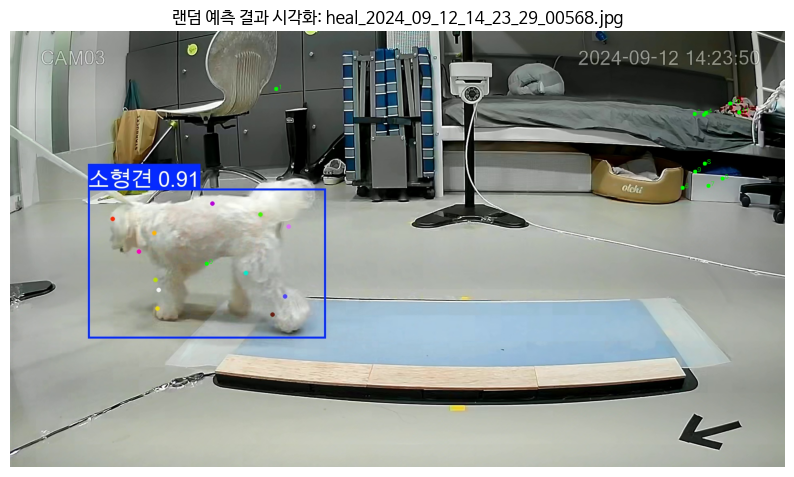

In [ ]:
# 예측 결과 시각화
import os
import cv2
import random
import matplotlib.pyplot as plt

# 경로 설정
image_dir = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs_yolo11/predict_results"
label_dir = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs_yolo11/predict_results/labels"

# keypoint 수
num_kpts = 12

# 파일 목록 불러오기
image_files = sorted([f for f in os.listdir(image_dir) if f.endswith(".jpg")])
label_files = sorted([f for f in os.listdir(label_dir) if f.endswith(".txt")])

# 파일명 기준으로 일치하는 페어만 선택
base_names = set(os.path.splitext(f)[0] for f in image_files) & set(os.path.splitext(f)[0] for f in label_files)
base_name = random.choice(list(base_names))  # 🔀 랜덤 선택

# 경로 설정
sample_image_path = os.path.join(image_dir, base_name + ".jpg")
sample_label_path = os.path.join(label_dir, base_name + ".txt")

# 이미지 불러오기
image = cv2.imread(sample_image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
h, w, _ = image.shape

# keypoint 추출
with open(sample_label_path, 'r') as f:
    line = f.readline().strip().split()
    keypoint_values = list(map(float, line[1:]))

keypoints = []
for i in range(num_kpts):
    x = keypoint_values[i * 3] * w
    y = keypoint_values[i * 3 + 1] * h
    v = keypoint_values[i * 3 + 2]
    if v > 0:
        keypoints.append((int(x), int(y)))
    else:
        keypoints.append(None)

# 시각화
for i, pt in enumerate(keypoints):
    if pt:
        cv2.circle(image, pt, 5, (0, 255, 0), -1)
        cv2.putText(image, str(i), (pt[0]+5, pt[1]), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)

# 출력
plt.figure(figsize=(10, 6))
plt.imshow(image)
plt.axis("off")
plt.title(f"랜덤 예측 결과 시각화: {base_name}.jpg")
plt.show()


In [ ]:

# 학습한 모델 불러오기
model = YOLO("/content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs_yolo11/train_pose_model/weights/best.pt")

# validation 수행
metrics = model.val(data="/content/drive/MyDrive/pet_angle_copy/dataset_split2/side.yaml", project="/content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs_yolo11/side_runs_yolo11/valid_results")

Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
YOLO11n-pose summary (fused): 109 layers, 2,766,898 parameters, 0 gradients, 7.0 GFLOPs
val: Fast image access ✅ (ping: 0.3±0.1 ms, read: 253.0±103.9 MB/s, size: 437.5 KB)


val: Scanning /content/drive/MyDrive/pet_angle_copy/dataset_split2/val/side_image.cache... 79 images, 0 backgrounds, 0 corrupt: 100%|██████████| 79/79 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.61it/s]


                   all         79         79      0.998          1      0.995      0.821      0.842      0.835      0.794      0.392
                   소형견         79         79      0.998          1      0.995      0.821      0.842      0.835      0.794      0.392
Speed: 1.5ms preprocess, 2.4ms inference, 0.0ms loss, 1.6ms postprocess per image
Results saved to /content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs_yolo11/side_runs_yolo11/valid_results/val


# 3.5.1.2 YOLO11, SIDE 방향 재학습(EPOCH 200)

In [ ]:
# PetBone_gayoon_supervison.ipynb
https://colab.research.google.com/drive/1HvmG_SlLP1oJg7vhnvUrkaT6JRUkmOGj?usp=sharing

# 3.5.2 YOLO11, FRONT 방향 재학습

In [ ]:
from ultralytics import YOLO
model = YOLO("yolo11n-pose.pt")
model.train(
    data="/content/drive/MyDrive/pet_angle_copy/dataset_split2/front.yaml",
    epochs=100,
    imgsz=768,
    name="train_pose_model",  # 이건 하위 폴더 이름
    project="/content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_yolo11",  # 이게 상위 경로!
    batch=8,
    optimizer="AdamW",
    lr0=0.001,
    close_mosaic=10
)

Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=8, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/pet_angle_copy/dataset_split2/front.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=768, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.001, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n-pose.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train_pose_model, nbs=64, nms=False, opset=None, optimize=False, optimizer=AdamW, overlap_mask=True, patience=1

train: Scanning /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/front_image.cache... 287 images, 0 backgrounds, 0 corrupt: 100%|██████████| 287/287 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


WARNING ⚠️ val: Slow image access detected (ping: 25.2±54.7 ms, read: 76.1±51.2 MB/s, size: 518.3 KB). Use local storage instead of remote/mounted storage for better performance. See https://docs.ultralytics.com/guides/model-training-tips/


val: Scanning /content/drive/MyDrive/pet_angle_copy/dataset_split2/val/front_image.cache... 55 images, 0 backgrounds, 0 corrupt: 100%|██████████| 55/55 [00:00<?, ?it/s]


Plotting labels to /content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_yolo11/train_pose_model/labels.jpg... 
optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 87 weight(decay=0.0), 97 weight(decay=0.0005), 96 bias(decay=0.0)
Image sizes 768 train, 768 val
Using 8 dataloader workers
Logging results to /content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_yolo11/train_pose_model
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      1/100      1.74G      2.019      6.798     0.6193       3.47      2.386         12        768: 100%|██████████| 36/36 [00:05<00:00,  6.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.20it/s]

                   all         55         55      0.606     0.0727      0.125     0.0368       0.15     0.0182     0.0198    0.00328



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      2/100      1.76G       1.88      5.323     0.5289      1.835       2.16         15        768: 100%|██████████| 36/36 [00:04<00:00,  8.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.71it/s]

                   all         55         55      0.838      0.847      0.909      0.361      0.512      0.455      0.338      0.108



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      3/100      1.76G      1.826      4.727     0.5006      1.554      2.147         15        768: 100%|██████████| 36/36 [00:04<00:00,  8.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.71it/s]

                   all         55         55      0.944      0.873      0.962      0.398      0.501      0.455       0.39      0.132



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      4/100      1.77G      1.779      4.436     0.5039      1.482      2.085         16        768: 100%|██████████| 36/36 [00:04<00:00,  8.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.06it/s]

                   all         55         55      0.968      0.982      0.993      0.471      0.559      0.491      0.444      0.135



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      5/100      1.77G      1.862      4.361     0.4945      1.311       2.04         18        768: 100%|██████████| 36/36 [00:04<00:00,  8.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.80it/s]

                   all         55         55      0.881      0.964      0.953       0.46       0.51      0.473      0.308     0.0987



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      6/100      1.77G      1.766      4.125     0.5084      1.323      2.038         19        768: 100%|██████████| 36/36 [00:04<00:00,  8.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.32it/s]

                   all         55         55      0.964      0.976      0.965      0.462       0.64      0.646      0.518      0.145



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      7/100      1.77G      1.649       3.83      0.497       1.23      1.917         16        768: 100%|██████████| 36/36 [00:04<00:00,  8.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.29it/s]

                   all         55         55      0.981      0.927      0.988      0.464      0.546      0.509      0.388      0.119



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      8/100      1.79G      1.631      3.917     0.4783      1.137      1.889         19        768: 100%|██████████| 36/36 [00:04<00:00,  8.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.99it/s]

                   all         55         55      0.982      0.971      0.994      0.529      0.533      0.527      0.451      0.169



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      9/100       1.8G      1.688      3.702     0.4808      1.121      1.956         18        768: 100%|██████████| 36/36 [00:04<00:00,  8.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.55it/s]

                   all         55         55       0.92      0.909      0.969      0.566       0.71      0.618      0.581      0.204



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     10/100       1.8G      1.633      3.511     0.4902       1.16      1.903         18        768: 100%|██████████| 36/36 [00:03<00:00,  9.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.12it/s]

                   all         55         55      0.943      0.964       0.99      0.511      0.683      0.636      0.571      0.195



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     11/100       1.8G      1.618      3.541     0.4744      1.125      1.903          9        768: 100%|██████████| 36/36 [00:04<00:00,  8.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.88it/s]

                   all         55         55      0.928      0.964      0.966      0.404      0.415      0.491      0.256     0.0863



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     12/100      1.82G      1.638      3.562     0.4721      1.128      1.887         17        768: 100%|██████████| 36/36 [00:04<00:00,  8.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.68it/s]

                   all         55         55      0.954          1      0.991      0.564      0.776      0.764      0.647      0.216



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     13/100      1.82G       1.53      3.354     0.4753      1.053      1.811         13        768: 100%|██████████| 36/36 [00:04<00:00,  8.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.90it/s]

                   all         55         55      0.946          1      0.993      0.604      0.803      0.741      0.662       0.22



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     14/100      1.83G      1.469      3.289     0.4621          1      1.813         17        768: 100%|██████████| 36/36 [00:04<00:00,  8.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.36it/s]

                   all         55         55      0.964      0.978      0.981      0.593      0.754      0.745      0.653      0.216



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     15/100      1.85G      1.503      3.217     0.4573          1      1.856         14        768: 100%|██████████| 36/36 [00:03<00:00,  9.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.54it/s]

                   all         55         55      0.982       0.97      0.987        0.6      0.713      0.691      0.571      0.191



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     16/100      1.85G      1.478      3.216     0.4578     0.9517      1.816         21        768: 100%|██████████| 36/36 [00:04<00:00,  7.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.64it/s]

                   all         55         55       0.98      0.982      0.994      0.613      0.703      0.709      0.638       0.22



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     17/100      1.85G      1.545      3.136     0.4462      1.014      1.852         11        768: 100%|██████████| 36/36 [00:04<00:00,  8.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.61it/s]

                   all         55         55          1      0.948      0.994      0.632      0.753      0.691      0.616      0.229



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     18/100      1.85G      1.541      3.163     0.4501      1.031      1.825         11        768: 100%|██████████| 36/36 [00:04<00:00,  8.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.24it/s]

                   all         55         55      0.991      0.982      0.995      0.593        0.8      0.709      0.685      0.251



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     19/100      1.85G      1.516        3.2      0.454     0.9642      1.859         15        768: 100%|██████████| 36/36 [00:04<00:00,  8.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.12it/s]

                   all         55         55          1      0.994      0.995      0.647      0.787      0.739       0.66      0.219



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     20/100      1.85G      1.451      3.148     0.4466     0.9218      1.804         18        768: 100%|██████████| 36/36 [00:04<00:00,  8.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.14it/s]

                   all         55         55          1      0.981      0.994      0.565      0.627       0.61      0.466      0.169



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     21/100      1.85G      1.515      3.101     0.4488     0.9273      1.814         16        768: 100%|██████████| 36/36 [00:04<00:00,  8.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.52it/s]

                   all         55         55      0.961      0.964      0.981      0.572      0.797      0.745      0.633      0.252



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     22/100      1.85G      1.488      3.089     0.4473     0.9355      1.773         16        768: 100%|██████████| 36/36 [00:04<00:00,  8.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.83it/s]

                   all         55         55      0.977      0.982      0.987      0.606      0.772       0.74      0.634      0.219



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     23/100      1.85G      1.394      2.955      0.443     0.8848      1.752         14        768: 100%|██████████| 36/36 [00:03<00:00,  9.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.34it/s]

                   all         55         55      0.961      0.982       0.96      0.625      0.792      0.745       0.62      0.248



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     24/100      1.85G      1.397      3.126     0.4424     0.8815      1.723         14        768: 100%|██████████| 36/36 [00:04<00:00,  8.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.31it/s]

                   all         55         55          1      0.978      0.995      0.611      0.722      0.708      0.598      0.215



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     25/100      1.85G      1.427      2.961     0.4393     0.9486      1.747         13        768: 100%|██████████| 36/36 [00:04<00:00,  8.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.66it/s]

                   all         55         55      0.981          1      0.991      0.538      0.757      0.745      0.586      0.253



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     26/100      1.85G      1.417      3.105     0.4401     0.8867       1.71         15        768: 100%|██████████| 36/36 [00:04<00:00,  8.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.37it/s]

                   all         55         55      0.993          1      0.995      0.682       0.77      0.764      0.675      0.295



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     27/100      1.85G        1.4      3.006     0.4452     0.8862      1.723         14        768: 100%|██████████| 36/36 [00:04<00:00,  8.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.88it/s]

                   all         55         55       0.98      0.982      0.992      0.648       0.81      0.777      0.692      0.276



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     28/100      1.85G       1.38      2.991     0.4455     0.8656      1.731         14        768: 100%|██████████| 36/36 [00:04<00:00,  8.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.65it/s]

                   all         55         55      0.982      0.978      0.992      0.619      0.781      0.779      0.699      0.291



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     29/100      1.85G      1.335      2.861     0.4344     0.8364      1.659         18        768: 100%|██████████| 36/36 [00:04<00:00,  8.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.02it/s]

                   all         55         55      0.947      0.979      0.987      0.678      0.678      0.691      0.561      0.209



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     30/100      1.85G      1.373      2.747     0.4429     0.8573      1.744         13        768: 100%|██████████| 36/36 [00:04<00:00,  8.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.91it/s]

                   all         55         55      0.979          1      0.993      0.638      0.764      0.782      0.722      0.303



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     31/100      1.85G      1.323      2.654     0.4288     0.8104      1.681         18        768: 100%|██████████| 36/36 [00:04<00:00,  8.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.93it/s]

                   all         55         55      0.962      0.982      0.992      0.675      0.694      0.709      0.621      0.231



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     32/100      1.85G      1.321      2.944     0.4406     0.8211      1.714         19        768: 100%|██████████| 36/36 [00:04<00:00,  8.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.11it/s]

                   all         55         55          1      0.995      0.995       0.66      0.751      0.727      0.611      0.239



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     33/100      1.85G      1.306      2.748     0.4433     0.7837      1.706         12        768: 100%|██████████| 36/36 [00:04<00:00,  8.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.87it/s]

                   all         55         55      0.994      0.982      0.995      0.694      0.773      0.764      0.712      0.322



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     34/100      1.85G      1.271        2.6     0.4382     0.7703      1.621         13        768: 100%|██████████| 36/36 [00:04<00:00,  8.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.70it/s]

                   all         55         55      0.996      0.982      0.995      0.688      0.724      0.709      0.589       0.27



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     35/100      1.85G      1.293      2.673     0.4271     0.7691      1.655         15        768: 100%|██████████| 36/36 [00:04<00:00,  8.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.81it/s]

                   all         55         55      0.982      0.999      0.995      0.703      0.874        0.8      0.777      0.358



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     36/100      1.85G      1.256      2.758     0.4371     0.7601      1.621         13        768: 100%|██████████| 36/36 [00:04<00:00,  8.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.14it/s]

                   all         55         55      0.979          1      0.995      0.722      0.867      0.855      0.826      0.395



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     37/100      1.85G      1.233      2.542     0.4307     0.7586      1.606         14        768: 100%|██████████| 36/36 [00:04<00:00,  8.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.40it/s]

                   all         55         55      0.999          1      0.995      0.717       0.81        0.8      0.701      0.339



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     38/100      1.85G      1.287      2.519      0.426     0.7981      1.667         16        768: 100%|██████████| 36/36 [00:04<00:00,  8.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.48it/s]

                   all         55         55      0.964          1      0.992      0.625      0.839      0.855      0.825      0.365



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     39/100      1.85G      1.265      2.561     0.4314      0.782      1.623         15        768: 100%|██████████| 36/36 [00:04<00:00,  8.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.90it/s]

                   all         55         55      0.982      0.995      0.995      0.697      0.801        0.8      0.722       0.36



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     40/100      1.85G      1.241      2.548     0.4285     0.7636      1.595         19        768: 100%|██████████| 36/36 [00:04<00:00,  8.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.72it/s]

                   all         55         55      0.994          1      0.995      0.709      0.846      0.797      0.736      0.382



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     41/100      1.85G      1.221      2.454      0.437     0.7693      1.608         17        768: 100%|██████████| 36/36 [00:04<00:00,  8.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.72it/s]

                   all         55         55          1      0.979      0.995      0.688      0.805      0.782      0.773      0.374



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     42/100      1.85G      1.202      2.599     0.4352     0.7345      1.598         18        768: 100%|██████████| 36/36 [00:04<00:00,  8.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.83it/s]

                   all         55         55      0.959          1      0.992      0.618      0.815      0.782      0.752      0.431



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     43/100      1.85G      1.189      2.545     0.4369     0.7308      1.585         16        768: 100%|██████████| 36/36 [00:04<00:00,  8.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.90it/s]

                   all         55         55       0.96          1       0.99        0.7      0.809      0.768      0.764      0.366



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     44/100      1.85G       1.21      2.571     0.4235     0.7344      1.609         14        768: 100%|██████████| 36/36 [00:04<00:00,  8.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.99it/s]

                   all         55         55      0.981          1      0.995      0.697      0.909      0.836      0.813      0.444



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     45/100      1.85G      1.184      2.367     0.4269     0.7433       1.54         11        768: 100%|██████████| 36/36 [00:03<00:00,  9.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.07it/s]

                   all         55         55      0.982          1      0.988      0.738      0.885      0.891      0.856      0.466



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     46/100      1.85G       1.23      2.589     0.4313     0.7509      1.636         16        768: 100%|██████████| 36/36 [00:04<00:00,  8.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.71it/s]

                   all         55         55      0.982          1       0.99      0.741      0.827      0.836      0.739      0.413



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     47/100      1.85G      1.157      2.363     0.4152      0.716      1.536         12        768: 100%|██████████| 36/36 [00:04<00:00,  8.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.52it/s]

                   all         55         55      0.982          1      0.995      0.716      0.829      0.818      0.753      0.359



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     48/100      1.85G      1.201      2.298      0.425     0.7354      1.581         16        768: 100%|██████████| 36/36 [00:04<00:00,  8.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.85it/s]

                   all         55         55       0.98          1      0.995       0.72      0.873      0.891       0.84      0.469



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     49/100      1.85G      1.146      2.325     0.4383     0.6911      1.542         13        768: 100%|██████████| 36/36 [00:04<00:00,  8.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.38it/s]

                   all         55         55      0.982      0.982      0.995      0.748      0.872      0.873      0.814      0.478



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     50/100      1.85G      1.089      2.317     0.4224     0.6709      1.487         16        768: 100%|██████████| 36/36 [00:04<00:00,  8.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.30it/s]

                   all         55         55      0.994          1      0.995       0.73      0.886      0.891      0.863      0.462



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     51/100      1.85G      1.083      2.301     0.4211     0.6814      1.484         15        768: 100%|██████████| 36/36 [00:04<00:00,  8.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.59it/s]

                   all         55         55      0.995          1      0.995      0.739      0.904      0.909      0.859      0.462



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     52/100      1.85G      1.087       2.22     0.4244     0.6506      1.511         18        768: 100%|██████████| 36/36 [00:04<00:00,  8.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.01it/s]

                   all         55         55      0.999          1      0.995      0.758      0.926      0.927      0.926      0.525



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     53/100      1.85G      1.087      2.232      0.437     0.6818      1.518          8        768: 100%|██████████| 36/36 [00:04<00:00,  8.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.39it/s]

                   all         55         55      0.996          1      0.995      0.718      0.909      0.909        0.9      0.514



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     54/100      1.85G      1.124      2.094     0.4197     0.7223      1.521         17        768: 100%|██████████| 36/36 [00:04<00:00,  8.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.51it/s]

                   all         55         55      0.996          1      0.995      0.751      0.889      0.874      0.877      0.514



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     55/100      1.85G      1.108      2.139     0.4202     0.6577      1.497         11        768: 100%|██████████| 36/36 [00:04<00:00,  8.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.03it/s]

                   all         55         55          1      0.999      0.995      0.721      0.891      0.891       0.86      0.505



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     56/100      1.85G      1.138      2.241     0.4235     0.6952      1.512         20        768: 100%|██████████| 36/36 [00:04<00:00,  8.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.10it/s]

                   all         55         55      0.997          1      0.995       0.73      0.872      0.873      0.831       0.49



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     57/100      1.85G       1.06      2.281     0.4261     0.6523      1.475         17        768: 100%|██████████| 36/36 [00:04<00:00,  8.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.60it/s]

                   all         55         55      0.998          1      0.995      0.757      0.889      0.891      0.875      0.517



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     58/100      1.85G      1.094      2.012     0.4133     0.6843      1.484         19        768: 100%|██████████| 36/36 [00:04<00:00,  8.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.75it/s]

                   all         55         55      0.996          1      0.995      0.755      0.869      0.873      0.857      0.491



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     59/100      1.85G      1.076      2.189     0.4348      0.626      1.458         13        768: 100%|██████████| 36/36 [00:04<00:00,  8.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.92it/s]

                   all         55         55      0.994          1      0.995       0.73      0.889      0.891      0.868      0.523



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     60/100      1.85G      1.067      2.228     0.4221      0.637      1.444         21        768: 100%|██████████| 36/36 [00:04<00:00,  8.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.98it/s]

                   all         55         55      0.996          1      0.995      0.786      0.888      0.891      0.845      0.491



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     61/100      1.85G      1.078      2.057     0.4165     0.6508      1.457         14        768: 100%|██████████| 36/36 [00:04<00:00,  8.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.24it/s]

                   all         55         55      0.982          1      0.995      0.783      0.885      0.891      0.883      0.558



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     62/100      1.85G      1.054      2.027     0.4284     0.6429      1.452         14        768: 100%|██████████| 36/36 [00:04<00:00,  8.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.85it/s]

                   all         55         55      0.982          1      0.995      0.771      0.893      0.909      0.909      0.564



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     63/100      1.85G      1.012      2.015     0.4218      0.605      1.407         20        768: 100%|██████████| 36/36 [00:04<00:00,  8.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.80it/s]

                   all         55         55       0.98          1      0.994       0.74      0.909      0.927      0.916      0.546



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     64/100      1.85G     0.9574      1.946     0.4167     0.6158      1.397         16        768: 100%|██████████| 36/36 [00:04<00:00,  8.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.08it/s]

                   all         55         55       0.98          1      0.994      0.758      0.877      0.891      0.872      0.576



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     65/100      1.85G      1.073      2.113     0.4293     0.6214      1.455         11        768: 100%|██████████| 36/36 [00:04<00:00,  8.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.04it/s]

                   all         55         55       0.98          1      0.995       0.81      0.891      0.909      0.882      0.568



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     66/100      1.85G      1.033      2.039     0.4282     0.6242      1.456         18        768: 100%|██████████| 36/36 [00:04<00:00,  8.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.87it/s]

                   all         55         55       0.99          1      0.995      0.774      0.899      0.909      0.893       0.52



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     67/100      1.85G     0.9926      2.032      0.431     0.5859      1.399         16        768: 100%|██████████| 36/36 [00:04<00:00,  8.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.34it/s]

                   all         55         55      0.998          1      0.995      0.762      0.889      0.891      0.881      0.561



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     68/100      1.85G      1.019      1.829     0.4155       0.61      1.458         13        768: 100%|██████████| 36/36 [00:04<00:00,  8.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.98it/s]

                   all         55         55      0.996          1      0.995      0.793      0.906      0.909      0.896      0.588



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     69/100      1.85G      1.017      1.927     0.4293      0.591       1.42         15        768: 100%|██████████| 36/36 [00:04<00:00,  8.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.37it/s]

                   all         55         55      0.989          1      0.995      0.783      0.898      0.909      0.887      0.546



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     70/100      1.85G          1      1.995     0.4223     0.5971      1.423         21        768: 100%|██████████| 36/36 [00:04<00:00,  8.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.54it/s]

                   all         55         55      0.997          1      0.995      0.765      0.888      0.891      0.889      0.531



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     71/100      1.85G     0.9909      1.984     0.4291     0.5782      1.409         16        768: 100%|██████████| 36/36 [00:04<00:00,  8.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.98it/s]

                   all         55         55      0.998          1      0.995       0.76      0.926      0.927      0.917      0.538



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     72/100      1.85G      1.012      1.988     0.4202     0.6216      1.406         17        768: 100%|██████████| 36/36 [00:04<00:00,  8.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.89it/s]

                   all         55         55      0.998          1      0.995      0.799      0.922      0.891      0.902       0.56



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     73/100      1.85G     0.9634      1.798     0.4157     0.5784      1.366         10        768: 100%|██████████| 36/36 [00:04<00:00,  8.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.46it/s]

                   all         55         55      0.997          1      0.995      0.811      0.927      0.927      0.925      0.574



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     74/100      1.85G     0.9793      1.712     0.4217      0.627      1.375         10        768: 100%|██████████| 36/36 [00:04<00:00,  8.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.59it/s]

                   all         55         55      0.998          1      0.995      0.778       0.91      0.909      0.904      0.551



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     75/100      1.85G     0.9827      1.901     0.4144     0.6243      1.395         21        768: 100%|██████████| 36/36 [00:04<00:00,  8.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.15it/s]

                   all         55         55      0.993          1      0.995      0.806      0.923      0.927      0.924      0.543



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     76/100      1.85G     0.9109      1.784     0.4228     0.5548      1.344         14        768: 100%|██████████| 36/36 [00:04<00:00,  8.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.70it/s]

                   all         55         55      0.996          1      0.995      0.835      0.923      0.927      0.926      0.617



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     77/100      1.85G     0.9124      1.856     0.4231     0.5734      1.358         15        768: 100%|██████████| 36/36 [00:04<00:00,  8.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.44it/s]

                   all         55         55      0.997          1      0.995      0.802      0.906      0.909      0.902      0.642



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     78/100      1.85G     0.9598      1.759     0.4158     0.6153      1.392         21        768: 100%|██████████| 36/36 [00:04<00:00,  8.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.09it/s]

                   all         55         55       0.98          1      0.995      0.814      0.917      0.909      0.897      0.624



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     79/100      1.85G     0.9198      1.676     0.4057     0.5912      1.373         10        768: 100%|██████████| 36/36 [00:04<00:00,  9.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.63it/s]

                   all         55         55       0.98          1      0.995      0.825       0.89      0.909      0.894      0.619



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     80/100      1.85G     0.9139       1.71      0.414     0.5668      1.317          9        768: 100%|██████████| 36/36 [00:04<00:00,  8.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.99it/s]

                   all         55         55       0.98          1      0.995      0.817      0.908      0.927      0.926      0.617



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     81/100      1.85G      0.942      1.682     0.4171     0.6046      1.329         14        768: 100%|██████████| 36/36 [00:04<00:00,  8.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.66it/s]

                   all         55         55      0.979          1      0.995      0.814       0.89      0.909      0.893      0.618



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     82/100      1.85G     0.9092      1.877      0.422     0.5817      1.342         17        768: 100%|██████████| 36/36 [00:04<00:00,  8.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.52it/s]

                   all         55         55      0.983          1      0.995      0.816      0.894      0.909      0.891      0.605



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     83/100      1.85G      0.919      1.837     0.4291     0.5826      1.352         14        768: 100%|██████████| 36/36 [00:04<00:00,  8.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.85it/s]

                   all         55         55      0.992          1      0.995      0.815      0.939      0.945      0.951      0.608



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     84/100      1.85G     0.9093      1.772     0.4219      0.556      1.341          9        768: 100%|██████████| 36/36 [00:04<00:00,  8.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.85it/s]

                   all         55         55      0.993          1      0.995      0.812      0.903      0.909      0.905      0.629



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     85/100      1.85G      0.899      1.781      0.421     0.5535       1.32         14        768: 100%|██████████| 36/36 [00:04<00:00,  8.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.14it/s]

                   all         55         55      0.997          1      0.995      0.803      0.924      0.927      0.931      0.634



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     86/100      1.85G     0.9021      1.615     0.4186     0.5803      1.316         15        768: 100%|██████████| 36/36 [00:04<00:00,  8.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.84it/s]

                   all         55         55      0.993          1      0.995      0.821      0.939      0.945      0.939       0.63



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     87/100      1.85G     0.8871       1.71     0.4097     0.5536      1.325         17        768: 100%|██████████| 36/36 [00:03<00:00,  9.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.33it/s]

                   all         55         55      0.996          1      0.995      0.824      0.924      0.927      0.921      0.634



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     88/100      1.85G     0.9469      1.803     0.4094     0.5876      1.362         14        768: 100%|██████████| 36/36 [00:04<00:00,  8.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.26it/s]

                   all         55         55      0.996          1      0.995      0.828      0.924      0.927      0.921      0.633



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     89/100      1.85G     0.8985      1.706     0.4167     0.5832      1.336         15        768: 100%|██████████| 36/36 [00:04<00:00,  8.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.75it/s]

                   all         55         55      0.997          1      0.995      0.827      0.925      0.927      0.919      0.632



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     90/100      1.85G     0.8411      1.704     0.4179     0.5462        1.3         14        768: 100%|██████████| 36/36 [00:04<00:00,  8.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.36it/s]

                   all         55         55      0.998          1      0.995      0.835      0.925      0.927      0.931      0.619


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     91/100      1.85G     0.7935      1.601     0.4491     0.4313      1.302          7        768: 100%|██████████| 36/36 [00:04<00:00,  7.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.06it/s]

                   all         55         55      0.994          1      0.995      0.815       0.94      0.945      0.933      0.587



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     92/100      1.85G     0.7419      1.579     0.4445     0.4186      1.312          7        768: 100%|██████████| 36/36 [00:04<00:00,  8.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.52it/s]

                   all         55         55      0.991          1      0.995      0.808        0.9      0.909      0.873       0.59



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     93/100      1.85G     0.7598       1.58     0.4457     0.4175      1.282          7        768: 100%|██████████| 36/36 [00:04<00:00,  8.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.49it/s]

                   all         55         55      0.995          1      0.995      0.815      0.922      0.927      0.885      0.597



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     94/100      1.85G     0.7591      1.562     0.4434     0.4043      1.299          7        768: 100%|██████████| 36/36 [00:04<00:00,  8.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.24it/s]

                   all         55         55      0.996          1      0.995      0.824      0.923      0.927        0.9       0.61



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     95/100      1.85G     0.6957      1.517     0.4426     0.3843      1.254          7        768: 100%|██████████| 36/36 [00:04<00:00,  8.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.65it/s]

                   all         55         55      0.997          1      0.995      0.821      0.925      0.927      0.907      0.619



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     96/100      1.85G      0.725      1.498     0.4472     0.3893       1.26          7        768: 100%|██████████| 36/36 [00:04<00:00,  8.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.70it/s]

                   all         55         55      0.997          1      0.995      0.841      0.942      0.945      0.928      0.633



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     97/100      1.85G     0.7136      1.482     0.4386      0.393      1.249          7        768: 100%|██████████| 36/36 [00:04<00:00,  8.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.38it/s]

                   all         55         55      0.996          1      0.995      0.833      0.942      0.945      0.929      0.635



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     98/100      1.85G     0.6684      1.489      0.442     0.3803      1.221          7        768: 100%|██████████| 36/36 [00:04<00:00,  8.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.52it/s]

                   all         55         55      0.996          1      0.995      0.839      0.941      0.945      0.928      0.636



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     99/100      1.85G     0.6788      1.463      0.439     0.3743      1.209          7        768: 100%|██████████| 36/36 [00:04<00:00,  8.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.88it/s]

                   all         55         55      0.995          1      0.995      0.837      0.923      0.927       0.91      0.634



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


    100/100      1.85G     0.6876      1.466     0.4452     0.3803      1.252          7        768: 100%|██████████| 36/36 [00:04<00:00,  8.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.59it/s]


                   all         55         55      0.996          1      0.995      0.842      0.905      0.909      0.899      0.642

100 epochs completed in 0.138 hours.
Optimizer stripped from /content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_yolo11/train_pose_model/weights/last.pt, 5.9MB
Optimizer stripped from /content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_yolo11/train_pose_model/weights/best.pt, 5.9MB

Validating /content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_yolo11/train_pose_model/weights/best.pt...
Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
YOLO11n-pose summary (fused): 109 layers, 2,766,898 parameters, 0 gradients, 7.0 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.09it/s]


                   all         55         55      0.996          1      0.995      0.842      0.941      0.945       0.93      0.645
                   소형견         55         55      0.996          1      0.995      0.842      0.941      0.945       0.93      0.645
Speed: 0.3ms preprocess, 1.8ms inference, 0.0ms loss, 1.8ms postprocess per image
Results saved to /content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_yolo11/train_pose_model


ultralytics.utils.metrics.PoseMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7b30b8d370d0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)', 'Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)', 'Precision-Recall(P)', 'F1-Confidence(P)', 'Precision-Confidence(P)', 'Recall-Confidence(P)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034, 

In [ ]:
# 학습 완료된 모델 불러오기
model = YOLO("/content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_yolo11/train_pose_model/weights/best.pt")  # 학습된 best 모델 경로

# 예측 수행
results = model.predict(
    source="/content/drive/MyDrive/pet_angle_copy/dataset_split2/test/front_image",
    project="/content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_yolo11",  # 저장 루트 변경
    name="predict_results",   # 하위 폴더명 지정
    save=True,               # 예측 결과 이미지 저장
    save_txt=True,            # 예측된 keypoint 좌표 .txt 저장
    save_conf=True,             # confidence 포함 저장
    conf=0.25,                   # confidence threshold (필요 시 조절)
    imgsz=768                 # 학습할 때와 동일한 이미지 크기 사용
)


image 1/57 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/front_image/SNC_2024_09_07_11_19_30_00264.jpg: 448x768 1 소형견, 14.1ms
image 2/57 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/front_image/SNC_2024_09_07_18_05_45_00156.jpg: 448x768 1 소형견, 11.9ms
image 3/57 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/front_image/SNC_2024_09_08_09_49_40_00011.jpg: 448x768 1 소형견, 13.1ms
image 4/57 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/front_image/SNC_2024_09_08_10_47_15_00056.jpg: 448x768 1 소형견, 12.4ms
image 5/57 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/front_image/SNC_2024_09_14_10_04_17_00117.jpg: 448x768 1 소형견, 11.8ms
image 6/57 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/front_image/SNC_2024_09_30_19_49_10_00458.jpg: 448x768 1 소형견, 12.1ms
image 7/57 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/front_image/SNC_2024_10_04_14_37_59_00017.jpg: 448x768 1 소형견, 12.3ms
image 8/57 /content/drive/MyDrive

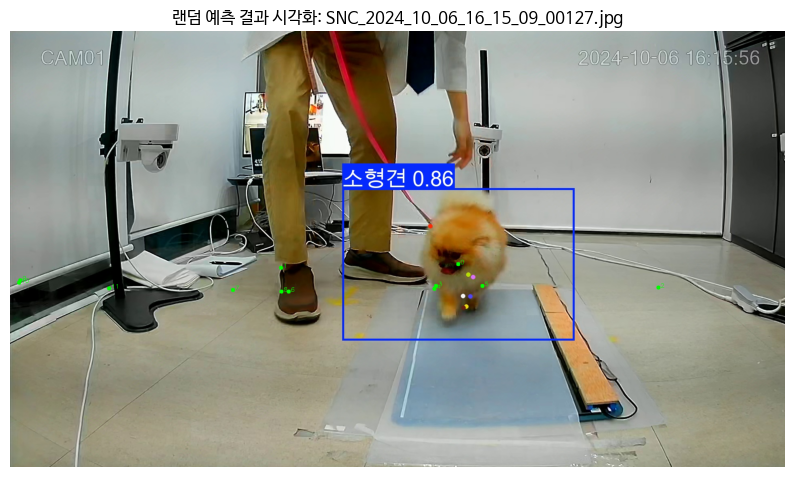

In [ ]:
# 예측 결과 시각화
# 예측 결과 시각화
import os
import cv2
import random
import matplotlib.pyplot as plt

# 경로 설정
image_dir = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_yolo11/predict_results"
label_dir = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_yolo11/predict_results/labels"

# keypoint 수
num_kpts = 12

# 파일 목록 불러오기
image_files = sorted([f for f in os.listdir(image_dir) if f.endswith(".jpg")])
label_files = sorted([f for f in os.listdir(label_dir) if f.endswith(".txt")])

# 파일명 기준으로 일치하는 페어만 선택
base_names = set(os.path.splitext(f)[0] for f in image_files) & set(os.path.splitext(f)[0] for f in label_files)
base_name = random.choice(list(base_names))  # 🔀 랜덤 선택

# 경로 설정
sample_image_path = os.path.join(image_dir, base_name + ".jpg")
sample_label_path = os.path.join(label_dir, base_name + ".txt")

# 이미지 불러오기
image = cv2.imread(sample_image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
h, w, _ = image.shape

# keypoint 추출
with open(sample_label_path, 'r') as f:
    line = f.readline().strip().split()
    keypoint_values = list(map(float, line[1:]))

keypoints = []
for i in range(num_kpts):
    x = keypoint_values[i * 3] * w
    y = keypoint_values[i * 3 + 1] * h
    v = keypoint_values[i * 3 + 2]
    if v > 0:
        keypoints.append((int(x), int(y)))
    else:
        keypoints.append(None)

# 시각화
for i, pt in enumerate(keypoints):
    if pt:
        cv2.circle(image, pt, 5, (0, 255, 0), -1)
        cv2.putText(image, str(i), (pt[0]+5, pt[1]), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)

# 출력
plt.figure(figsize=(10, 6))
plt.imshow(image)
plt.axis("off")
plt.title(f"랜덤 예측 결과 시각화: {base_name}.jpg")
plt.show()


In [ ]:
# 학습한 모델 불러오기
model = YOLO("/content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_yolo11/train_pose_model/weights/best.pt")

# validation 수행
metrics = model.val(data="/content/drive/MyDrive/pet_angle_copy/dataset_split2/front.yaml", project="/content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_yolo11/valid_results")

Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
YOLO11n-pose summary (fused): 109 layers, 2,766,898 parameters, 0 gradients, 7.0 GFLOPs
val: Fast image access ✅ (ping: 0.8±1.1 ms, read: 232.4±132.0 MB/s, size: 498.8 KB)


val: Scanning /content/drive/MyDrive/pet_angle_copy/dataset_split2/val/front_image.cache... 55 images, 0 backgrounds, 0 corrupt: 100%|██████████| 55/55 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.26it/s]


                   all         55         55      0.996          1      0.995       0.84      0.905      0.909      0.901      0.641
                   소형견         55         55      0.996          1      0.995       0.84      0.905      0.909      0.901      0.641
Speed: 3.1ms preprocess, 5.2ms inference, 0.0ms loss, 1.9ms postprocess per image
Results saved to /content/drive/MyDrive/pet_angle_copy/dataset_split2/front_runs_yolo11/valid_results/val


# 3.5.3 YOLO11, TAIL 방향 재학습

In [ ]:
from ultralytics import YOLO
model = YOLO("yolo11n-pose.pt")
model.train(
    data="/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail.yaml",
    epochs=100,
    imgsz=768,
    name="train_pose_model",  # 이건 하위 폴더 이름
    project="/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs_yolo11",  # 이게 상위 경로!
    batch=8,
    optimizer="AdamW",
    lr0=0.001,
    close_mosaic=10
)

Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=8, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=768, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.001, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n-pose.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train_pose_model, nbs=64, nms=False, opset=None, optimize=False, optimizer=AdamW, overlap_mask=True, patience=10

train: Scanning /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/tail_image... 262 images, 0 backgrounds, 0 corrupt: 100%|██████████| 262/262 [00:17<00:00, 15.08it/s]

train: New cache created: /content/drive/MyDrive/pet_angle_copy/dataset_split2/train/tail_image.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.5±0.4 ms, read: 199.2±189.5 MB/s, size: 567.9 KB)


val: Scanning /content/drive/MyDrive/pet_angle_copy/dataset_split2/val/tail_image... 60 images, 0 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:03<00:00, 16.18it/s]

val: New cache created: /content/drive/MyDrive/pet_angle_copy/dataset_split2/val/tail_image.cache


Plotting labels to /content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs_yolo11/train_pose_model/labels.jpg... 
optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 87 weight(decay=0.0), 97 weight(decay=0.0005), 96 bias(decay=0.0)
Image sizes 768 train, 768 val
Using 8 dataloader workers
Logging results to /content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs_yolo11/train_pose_model
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      1/100      1.74G      2.071      6.826      0.623       3.62      2.484         16        768: 100%|██████████| 33/33 [00:12<00:00,  2.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.68it/s]

                   all         60         60       0.54        0.9      0.762      0.315      0.126      0.217     0.0539     0.0189



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      2/100      1.75G      1.782      5.783     0.5404      2.065      2.123         12        768: 100%|██████████| 33/33 [00:03<00:00,  8.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.86it/s]


                   all         60         60      0.854      0.783       0.83      0.332       0.41      0.317      0.221      0.051

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      3/100      1.76G      1.757      5.452     0.5221      1.636      1.985         11        768: 100%|██████████| 33/33 [00:03<00:00,  8.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.88it/s]


                   all         60         60      0.869      0.967      0.928      0.457     0.0476       0.25     0.0308    0.00598

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      4/100      1.76G      1.686      5.537     0.5193      1.369       1.78         16        768: 100%|██████████| 33/33 [00:03<00:00,  8.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.71it/s]

                   all         60         60          1      0.978      0.986      0.472     0.0689     0.0667     0.0199     0.0025



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      5/100      1.79G      1.624      5.135     0.5186      1.237      1.754         19        768: 100%|██████████| 33/33 [00:03<00:00,  8.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.66it/s]

                   all         60         60      0.997      0.983      0.985      0.564      0.109      0.133     0.0341    0.00612



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      6/100      1.79G      1.732      4.825     0.5172      1.208      1.784         13        768: 100%|██████████| 33/33 [00:03<00:00,  9.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.30it/s]

                   all         60         60      0.948      0.983      0.982      0.546      0.229      0.233     0.0989     0.0194



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      7/100       1.8G      1.688      4.839     0.5102      1.243      1.762         14        768: 100%|██████████| 33/33 [00:03<00:00,  9.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.82it/s]

                   all         60         60      0.983      0.976      0.986      0.502       0.41      0.417      0.213     0.0528



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      8/100       1.8G      1.585      4.494     0.5048      1.089      1.657         18        768: 100%|██████████| 33/33 [00:03<00:00,  8.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.71it/s]


                   all         60         60      0.998      0.983      0.985      0.405      0.374      0.367      0.185     0.0328

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      9/100       1.8G      1.554       4.58     0.4961      1.012      1.638         15        768: 100%|██████████| 33/33 [00:03<00:00,  8.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.74it/s]


                   all         60         60      0.961      0.983      0.985      0.552      0.358      0.367       0.18     0.0401

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     10/100       1.8G      1.454      4.365     0.5024     0.9605       1.58         17        768: 100%|██████████| 33/33 [00:03<00:00,  9.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.79it/s]

                   all         60         60      0.996      0.983      0.985      0.606      0.485      0.467      0.283     0.0561



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     11/100       1.8G      1.496      4.193     0.4992     0.9939      1.594          7        768: 100%|██████████| 33/33 [00:03<00:00,  8.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.04it/s]

                   all         60         60      0.996      0.983      0.989      0.571      0.607      0.583      0.438     0.0938



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     12/100       1.8G      1.567      4.007     0.4941      1.016       1.63         14        768: 100%|██████████| 33/33 [00:03<00:00,  8.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.08it/s]

                   all         60         60      0.997      0.983       0.99      0.581      0.579      0.549      0.381     0.0957



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     13/100       1.8G      1.467      4.177     0.4869     0.9801      1.545         18        768: 100%|██████████| 33/33 [00:03<00:00,  9.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.25it/s]

                   all         60         60      0.983      0.983      0.991       0.61      0.518      0.517      0.323     0.0766



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     14/100      1.82G      1.433      3.985     0.4756     0.9392      1.546         12        768: 100%|██████████| 33/33 [00:03<00:00,  8.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.99it/s]

                   all         60         60      0.997      0.983      0.994       0.65      0.625      0.617      0.465      0.113



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     15/100      1.84G      1.401      3.988     0.4745     0.8677      1.494         12        768: 100%|██████████| 33/33 [00:03<00:00,  8.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.45it/s]

                   all         60         60      0.998      0.983      0.994      0.652      0.677      0.667      0.592      0.173



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     16/100      1.85G      1.426      3.866     0.4799      0.902      1.504         17        768: 100%|██████████| 33/33 [00:03<00:00,  8.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.28it/s]

                   all         60         60      0.999      0.983      0.995      0.557      0.575      0.567      0.421      0.113



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     17/100      1.85G      1.404      3.829     0.4834      0.872      1.492         17        768: 100%|██████████| 33/33 [00:03<00:00,  8.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.69it/s]

                   all         60         60      0.966          1      0.994      0.576      0.515      0.533       0.33     0.0659



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     18/100      1.85G      1.434      3.783     0.4791     0.8745      1.512         13        768: 100%|██████████| 33/33 [00:03<00:00,  9.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.87it/s]

                   all         60         60      0.996      0.983      0.994      0.612      0.538      0.582      0.423     0.0972



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     19/100      1.85G      1.395      3.833     0.4789     0.8478      1.476         18        768: 100%|██████████| 33/33 [00:03<00:00,  8.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.52it/s]

                   all         60         60      0.998      0.983      0.994      0.629      0.474      0.467      0.309     0.0699



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     20/100      1.85G      1.359      3.653     0.4673     0.8408      1.441         11        768: 100%|██████████| 33/33 [00:03<00:00,  8.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.18it/s]

                   all         60         60      0.997      0.983      0.995      0.659      0.625      0.617      0.471     0.0936



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     21/100      1.85G        1.3       3.62     0.4616     0.8119       1.41          9        768: 100%|██████████| 33/33 [00:03<00:00,  8.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.17it/s]

                   all         60         60      0.981      0.983      0.991      0.679      0.665      0.667      0.497      0.112



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     22/100      1.85G      1.325      3.716     0.4714     0.8019      1.442          9        768: 100%|██████████| 33/33 [00:03<00:00,  8.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.35it/s]

                   all         60         60      0.958      0.983      0.978      0.547       0.65      0.667      0.534      0.145



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     23/100      1.85G      1.294      3.617     0.4657     0.8111      1.422         17        768: 100%|██████████| 33/33 [00:03<00:00,  9.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.16it/s]


                   all         60         60      0.982          1      0.995      0.655      0.654      0.667       0.62      0.173

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     24/100      1.85G      1.301      3.634     0.4728     0.7676      1.414         15        768: 100%|██████████| 33/33 [00:03<00:00,  8.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.62it/s]

                   all         60         60      0.998          1      0.995      0.661      0.665      0.667      0.542      0.148



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     25/100      1.85G      1.282      3.534     0.4768     0.7469      1.409         13        768: 100%|██████████| 33/33 [00:03<00:00,  8.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.28it/s]

                   all         60         60      0.982          1      0.995      0.664      0.687        0.7      0.535      0.159



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     26/100      1.85G      1.285      3.434     0.4746     0.7626      1.387         13        768: 100%|██████████| 33/33 [00:03<00:00,  8.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.20it/s]

                   all         60         60          1      0.979      0.994      0.686       0.74      0.733      0.719      0.255



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     27/100      1.85G      1.269       3.41     0.4634     0.7974      1.387         17        768: 100%|██████████| 33/33 [00:03<00:00,  8.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.25it/s]

                   all         60         60      0.984      0.998      0.995      0.661      0.754      0.764      0.675      0.254



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     28/100      1.85G      1.289      3.157     0.4614     0.7872       1.37         11        768: 100%|██████████| 33/33 [00:03<00:00,  8.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.64it/s]

                   all         60         60      0.993      0.983      0.994      0.658      0.774      0.767      0.734      0.291



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     29/100      1.85G      1.246      3.141     0.4578     0.7592      1.367         12        768: 100%|██████████| 33/33 [00:03<00:00,  8.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.11it/s]


                   all         60         60      0.993      0.983      0.994      0.708      0.791      0.783      0.756      0.289

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     30/100      1.85G      1.261      3.009     0.4545     0.7638      1.381          9        768: 100%|██████████| 33/33 [00:03<00:00,  8.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.53it/s]

                   all         60         60      0.998      0.983      0.994      0.685      0.845      0.833      0.821      0.358



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     31/100      1.85G      1.247      2.971     0.4585     0.7473      1.352         10        768: 100%|██████████| 33/33 [00:03<00:00,  8.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.11it/s]

                   all         60         60      0.984      0.998      0.995      0.654      0.846      0.833      0.793      0.333



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     32/100      1.85G       1.28      3.044     0.4529      0.751      1.376         14        768: 100%|██████████| 33/33 [00:03<00:00,  9.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.99it/s]

                   all         60         60      0.998      0.983      0.995      0.684      0.812        0.8      0.778      0.333



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     33/100      1.85G       1.23      3.095     0.4585     0.7414      1.345         13        768: 100%|██████████| 33/33 [00:03<00:00,  8.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.50it/s]

                   all         60         60      0.997      0.983      0.995        0.7      0.746      0.733       0.72      0.319



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     34/100      1.85G      1.252      2.876     0.4431     0.7503      1.364         17        768: 100%|██████████| 33/33 [00:03<00:00,  8.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.21it/s]

                   all         60         60      0.986      0.983      0.994      0.695      0.754       0.75      0.773      0.322



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     35/100      1.85G      1.254      2.712     0.4362     0.7184      1.367         11        768: 100%|██████████| 33/33 [00:03<00:00,  8.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.22it/s]

                   all         60         60      0.988      0.983      0.994      0.699      0.817      0.833      0.794      0.364



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     36/100      1.85G      1.242      2.629      0.429     0.7634      1.362         12        768: 100%|██████████| 33/33 [00:03<00:00,  8.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.98it/s]

                   all         60         60      0.982      0.983      0.978      0.668      0.849       0.85       0.83      0.361



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     37/100      1.85G      1.216      2.762     0.4292     0.7422      1.337         15        768: 100%|██████████| 33/33 [00:03<00:00,  8.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.71it/s]

                   all         60         60      0.998      0.983      0.993      0.673      0.813        0.8      0.773      0.334



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     38/100      1.85G      1.188      2.898     0.4207      0.699      1.305         12        768: 100%|██████████| 33/33 [00:03<00:00,  8.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.76it/s]


                   all         60         60      0.998      0.983      0.994      0.703      0.863       0.85      0.862      0.384

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     39/100      1.85G      1.196      2.793     0.4205     0.7095      1.317         11        768: 100%|██████████| 33/33 [00:03<00:00,  8.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.27it/s]

                   all         60         60      0.997      0.983      0.993      0.651      0.895      0.883      0.869      0.368



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     40/100      1.85G      1.151      2.595     0.4116     0.6785      1.293         17        768: 100%|██████████| 33/33 [00:03<00:00,  8.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.94it/s]

                   all         60         60      0.994      0.983      0.992      0.627      0.927      0.917      0.901      0.417



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     41/100      1.85G      1.195      2.641      0.418     0.7212      1.342         12        768: 100%|██████████| 33/33 [00:03<00:00,  8.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.17it/s]

                   all         60         60      0.971      0.983       0.99      0.689      0.872      0.883      0.861      0.387



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     42/100      1.85G      1.155      2.509     0.4034     0.6865      1.318         10        768: 100%|██████████| 33/33 [00:03<00:00,  8.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.70it/s]

                   all         60         60      0.998      0.983      0.994      0.743      0.863       0.85      0.842      0.422



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     43/100      1.85G      1.137       2.44     0.4031      0.681      1.287         16        768: 100%|██████████| 33/33 [00:03<00:00,  8.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.02it/s]

                   all         60         60      0.998      0.983      0.994      0.741      0.881      0.867      0.874      0.485



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     44/100      1.85G      1.143      2.611     0.4004     0.6652      1.289         16        768: 100%|██████████| 33/33 [00:03<00:00,  8.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.34it/s]

                   all         60         60      0.999      0.983      0.995      0.714      0.862      0.833       0.87      0.429



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     45/100      1.85G       1.12      2.501     0.3961     0.6465      1.276          9        768: 100%|██████████| 33/33 [00:03<00:00,  8.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.01it/s]

                   all         60         60      0.999      0.983      0.995      0.703      0.897      0.883      0.884      0.463



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     46/100      1.85G      1.072      2.466     0.3893     0.6106      1.248         11        768: 100%|██████████| 33/33 [00:03<00:00,  8.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.28it/s]

                   all         60         60      0.998      0.983      0.992       0.72       0.88      0.867      0.872      0.447



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     47/100      1.85G      1.137      2.356     0.3965     0.6798      1.305         10        768: 100%|██████████| 33/33 [00:03<00:00,  8.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.04it/s]

                   all         60         60      0.998      0.983      0.988      0.739      0.914        0.9      0.916      0.466



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     48/100      1.85G       1.17      2.364     0.3874     0.6853      1.298         14        768: 100%|██████████| 33/33 [00:03<00:00,  8.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.90it/s]


                   all         60         60      0.999      0.983      0.988      0.706      0.931      0.917      0.921      0.448

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     49/100      1.85G      1.113      2.295     0.3866     0.6545      1.282         11        768: 100%|██████████| 33/33 [00:03<00:00,  8.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.79it/s]


                   all         60         60      0.999      0.983       0.99      0.726        0.9      0.867      0.867      0.468

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     50/100      1.85G      1.129      2.336     0.3877     0.6636      1.289         12        768: 100%|██████████| 33/33 [00:03<00:00,  8.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.29it/s]


                   all         60         60      0.999      0.983      0.995      0.746      0.914        0.9      0.894      0.441

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     51/100      1.85G      1.089      2.475     0.3791     0.6628      1.251         15        768: 100%|██████████| 33/33 [00:03<00:00,  8.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.27it/s]

                   all         60         60      0.998      0.983      0.995      0.759      0.913        0.9       0.89      0.462



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     52/100      1.85G      1.073      2.283     0.3746     0.6445       1.23         17        768: 100%|██████████| 33/33 [00:03<00:00,  8.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.21it/s]

                   all         60         60      0.998      0.983      0.995      0.754       0.88      0.867      0.841      0.412



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     53/100      1.85G      1.114      2.282     0.3672     0.6636      1.279          9        768: 100%|██████████| 33/33 [00:03<00:00,  8.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.15it/s]


                   all         60         60          1      0.999      0.995      0.745      0.948      0.933      0.912      0.413

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     54/100      1.85G      1.124      2.443     0.3654     0.6678      1.278         13        768: 100%|██████████| 33/33 [00:03<00:00,  8.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.81it/s]

                   all         60         60          1      0.999      0.995      0.751      0.948      0.933      0.921      0.429



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     55/100      1.85G      1.032      2.278      0.368     0.5972      1.219          8        768: 100%|██████████| 33/33 [00:03<00:00,  8.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.73it/s]

                   all         60         60          1      0.999      0.995      0.776      0.917      0.915        0.9      0.483



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     56/100      1.85G      1.021      2.208     0.3587     0.6316      1.194         14        768: 100%|██████████| 33/33 [00:03<00:00,  8.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.54it/s]

                   all         60         60      0.999      0.983      0.995      0.794      0.914        0.9      0.904      0.474



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     57/100      1.85G      1.034      2.261     0.3476     0.5865      1.203         12        768: 100%|██████████| 33/33 [00:03<00:00,  8.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.63it/s]

                   all         60         60      0.999      0.983      0.995       0.78      0.931      0.917      0.924      0.485



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     58/100      1.85G      1.028      2.234     0.3544     0.6139      1.194         12        768: 100%|██████████| 33/33 [00:03<00:00,  8.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.20it/s]

                   all         60         60          1      0.999      0.995      0.765      0.948      0.933      0.939      0.491



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     59/100      1.85G      1.066      2.195     0.3422     0.6218      1.203         12        768: 100%|██████████| 33/33 [00:03<00:00,  8.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.08it/s]

                   all         60         60      0.984      0.999      0.995      0.773      0.913        0.9      0.919      0.498



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     60/100      1.85G      1.039      2.261     0.3481     0.6228      1.211         16        768: 100%|██████████| 33/33 [00:03<00:00,  8.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.93it/s]

                   all         60         60      0.984      0.999      0.995      0.782      0.961       0.95      0.961      0.507



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     61/100      1.85G      1.034      2.161     0.3473     0.6196      1.188         17        768: 100%|██████████| 33/33 [00:03<00:00,  8.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.77it/s]

                   all         60         60      0.998      0.983      0.995       0.78      0.964       0.95      0.954       0.51



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     62/100      1.85G      1.027      2.044     0.3407     0.6018      1.196         12        768: 100%|██████████| 33/33 [00:03<00:00,  8.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.69it/s]

                   all         60         60      0.996      0.983      0.995      0.751      0.962       0.95      0.966      0.501



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     63/100      1.85G      1.037      2.063     0.3358     0.6369      1.217         14        768: 100%|██████████| 33/33 [00:03<00:00,  8.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.92it/s]

                   all         60         60          1      0.998      0.995      0.787      0.933      0.932      0.907      0.527



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     64/100      1.85G      1.001      2.215      0.332     0.5732      1.174         11        768: 100%|██████████| 33/33 [00:03<00:00,  8.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.43it/s]

                   all         60         60          1      0.999      0.995      0.783       0.95      0.949      0.936      0.519



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     65/100      1.85G     0.9607       2.14     0.3358     0.5636      1.156         13        768: 100%|██████████| 33/33 [00:03<00:00,  8.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.97it/s]

                   all         60         60      0.999      0.983      0.995      0.782      0.931      0.917      0.903      0.507



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     66/100      1.85G      1.016      2.092     0.3281     0.5956      1.187         19        768: 100%|██████████| 33/33 [00:03<00:00,  8.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.98it/s]

                   all         60         60          1      0.999      0.995      0.763      0.967      0.966       0.95      0.526



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     67/100      1.85G       1.02      2.049      0.329     0.5822      1.196         13        768: 100%|██████████| 33/33 [00:03<00:00,  8.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.21it/s]

                   all         60         60          1      0.999      0.995      0.794      0.917      0.933      0.902      0.537



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     68/100      1.85G     0.9747       2.08     0.3348     0.5959      1.182         12        768: 100%|██████████| 33/33 [00:03<00:00,  8.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.00it/s]


                   all         60         60      0.999          1      0.995      0.804      0.966      0.967      0.958      0.552

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     69/100      1.85G     0.9422      2.131     0.3236     0.5576      1.155         16        768: 100%|██████████| 33/33 [00:03<00:00,  8.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.48it/s]

                   all         60         60      0.999          1      0.995      0.814      0.966      0.967      0.966      0.525



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     70/100      1.85G     0.9614       2.02     0.3241     0.5747      1.164         12        768: 100%|██████████| 33/33 [00:03<00:00,  8.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.53it/s]

                   all         60         60          1          1      0.995      0.806      0.983      0.983      0.984      0.553



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     71/100      1.85G     0.9449      2.012     0.3208     0.5618       1.16         14        768: 100%|██████████| 33/33 [00:03<00:00,  8.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.29it/s]

                   all         60         60          1      0.999      0.995        0.8      0.983      0.982      0.985      0.573



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     72/100      1.85G     0.9781      2.129     0.3318     0.5773      1.163         12        768: 100%|██████████| 33/33 [00:03<00:00,  8.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.47it/s]

                   all         60         60          1      0.999      0.995      0.809          1      0.999      0.995      0.563



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     73/100      1.85G     0.9752      1.862     0.3198     0.5724      1.185         10        768: 100%|██████████| 33/33 [00:03<00:00,  8.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.50it/s]

                   all         60         60          1      0.999      0.995      0.824      0.967      0.966      0.962      0.557



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     74/100      1.85G     0.9194      2.162     0.3244     0.5525      1.128         14        768: 100%|██████████| 33/33 [00:03<00:00,  8.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.41it/s]

                   all         60         60          1      0.999      0.995      0.805      0.967      0.965      0.956      0.553



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     75/100      1.85G     0.9306      1.797     0.3042     0.5759      1.149         12        768: 100%|██████████| 33/33 [00:03<00:00,  8.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.10it/s]

                   all         60         60          1          1      0.995      0.786       0.93      0.917      0.938      0.557



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     76/100      1.85G     0.9107       2.04     0.3018     0.5347      1.142         12        768: 100%|██████████| 33/33 [00:03<00:00,  8.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.63it/s]

                   all         60         60          1          1      0.995      0.816      0.947      0.933      0.951      0.535



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     77/100      1.85G      0.893      2.036     0.3164     0.5053       1.13         11        768: 100%|██████████| 33/33 [00:03<00:00,  8.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.46it/s]

                   all         60         60          1          1      0.995      0.809       0.95       0.95      0.952      0.539



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     78/100      1.85G     0.9081      1.853     0.3049     0.5214      1.123         14        768: 100%|██████████| 33/33 [00:03<00:00,  8.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.24it/s]

                   all         60         60      0.999          1      0.995      0.812      0.949       0.95      0.945      0.514



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     79/100      1.85G     0.9075       1.99     0.3103     0.5465      1.129         12        768: 100%|██████████| 33/33 [00:03<00:00,  8.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.44it/s]

                   all         60         60          1          1      0.995      0.819      0.966      0.967      0.968      0.532



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     80/100      1.85G     0.9028      1.982     0.3033     0.5259      1.151         12        768: 100%|██████████| 33/33 [00:03<00:00,  8.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.79it/s]

                   all         60         60      0.999          1      0.995      0.774      0.949       0.95      0.946      0.551



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     81/100      1.85G     0.9224      2.029     0.3034     0.5536      1.151         12        768: 100%|██████████| 33/33 [00:03<00:00,  8.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.94it/s]

                   all         60         60      0.999          1      0.995      0.821      0.949       0.95      0.933      0.557



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     82/100      1.85G     0.9073      1.927     0.2941     0.5401      1.148         14        768: 100%|██████████| 33/33 [00:03<00:00,  8.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.51it/s]

                   all         60         60      0.999          1      0.995      0.823      0.949       0.95      0.946      0.577



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     83/100      1.85G     0.9036       1.94     0.2995     0.5493      1.155         14        768: 100%|██████████| 33/33 [00:03<00:00,  8.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.22it/s]

                   all         60         60      0.999          1      0.995      0.799      0.949       0.95      0.949       0.56



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     84/100      1.85G     0.8597      1.806     0.2949      0.518       1.11         11        768: 100%|██████████| 33/33 [00:03<00:00,  8.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.97it/s]

                   all         60         60      0.999          1      0.995      0.819      0.966      0.967      0.966      0.561



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     85/100      1.85G     0.8967       1.83     0.2958     0.5513      1.136         11        768: 100%|██████████| 33/33 [00:03<00:00,  8.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.35it/s]

                   all         60         60      0.999          1      0.995      0.821      0.966      0.967      0.968      0.592



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     86/100      1.85G      0.858      1.656     0.2898     0.5229      1.104         14        768: 100%|██████████| 33/33 [00:03<00:00,  8.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.99it/s]

                   all         60         60      0.999          1      0.995      0.824      0.949       0.95      0.955      0.614



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     87/100      1.85G     0.8616      1.786     0.2933     0.5197      1.112         15        768: 100%|██████████| 33/33 [00:03<00:00,  8.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.25it/s]

                   all         60         60      0.999          1      0.995      0.837      0.966      0.967       0.97      0.612



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     88/100      1.85G     0.8732      1.791     0.2922     0.5122      1.108         12        768: 100%|██████████| 33/33 [00:03<00:00,  8.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.56it/s]

                   all         60         60      0.999          1      0.995      0.823      0.966      0.967       0.97      0.628



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     89/100      1.85G     0.8776      1.762     0.2919      0.539      1.121         11        768: 100%|██████████| 33/33 [00:03<00:00,  9.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.55it/s]

                   all         60         60      0.999          1      0.995      0.819      0.966      0.967       0.97       0.63



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     90/100      1.85G     0.8455      1.707     0.2933     0.5147      1.099         10        768: 100%|██████████| 33/33 [00:03<00:00,  8.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.28it/s]

                   all         60         60      0.999          1      0.995      0.827      0.982      0.983      0.987      0.628


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     91/100      1.85G     0.7655      1.699     0.2324     0.3961      1.024          6        768: 100%|██████████| 33/33 [00:04<00:00,  7.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.08it/s]

                   all         60         60      0.998          1      0.995      0.817      0.965      0.967      0.965      0.597



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     92/100      1.85G     0.7747      1.697     0.2363     0.3958      1.015          6        768: 100%|██████████| 33/33 [00:03<00:00,  8.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.38it/s]

                   all         60         60      0.998          1      0.995      0.805      0.965      0.967      0.962      0.565



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     93/100      1.85G     0.7488      1.622     0.2261     0.3757       1.02          6        768: 100%|██████████| 33/33 [00:03<00:00,  8.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.60it/s]

                   all         60         60      0.999          1      0.995      0.833      0.949       0.95      0.943      0.579



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     94/100      1.85G     0.7203      1.576     0.2249     0.3777      1.002          6        768: 100%|██████████| 33/33 [00:03<00:00,  8.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.73it/s]

                   all         60         60      0.999          1      0.995      0.833      0.949       0.95      0.947      0.579



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     95/100      1.85G     0.6964      1.543     0.2221     0.3548     0.9841          6        768: 100%|██████████| 33/33 [00:03<00:00,  8.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.69it/s]

                   all         60         60      0.999          1      0.995      0.836      0.949       0.95      0.946      0.596



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     96/100      1.85G     0.7127      1.573     0.2211     0.3627     0.9853          6        768: 100%|██████████| 33/33 [00:03<00:00,  8.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.17it/s]

                   all         60         60      0.999          1      0.995      0.844      0.949       0.95      0.948      0.608



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     97/100      1.85G     0.7009      1.532     0.2228     0.3554     0.9659          6        768: 100%|██████████| 33/33 [00:03<00:00,  8.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.68it/s]

                   all         60         60      0.999          1      0.995      0.841      0.966      0.967      0.966      0.595



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     98/100      1.85G      0.684      1.544     0.2222     0.3551          1          6        768: 100%|██████████| 33/33 [00:03<00:00,  8.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.31it/s]

                   all         60         60      0.999          1      0.995      0.834      0.966      0.967      0.966      0.588



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


     99/100      1.85G     0.6972      1.519     0.2213     0.3551     0.9723          6        768: 100%|██████████| 33/33 [00:03<00:00,  8.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.80it/s]

                   all         60         60      0.999          1      0.995      0.845      0.966      0.967      0.967        0.6



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


    100/100      1.85G     0.6946      1.505     0.2146     0.3439     0.9776          6        768: 100%|██████████| 33/33 [00:03<00:00,  8.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.49it/s]

                   all         60         60      0.999          1      0.995      0.847      0.966      0.967      0.967      0.613



100 epochs completed in 0.131 hours.
Optimizer stripped from /content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs_yolo11/train_pose_model/weights/last.pt, 5.9MB
Optimizer stripped from /content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs_yolo11/train_pose_model/weights/best.pt, 5.9MB

Validating /content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs_yolo11/train_pose_model/weights/best.pt...
Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
YOLO11n-pose summary (fused): 109 layers, 2,766,898 parameters, 0 gradients, 7.0 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.69it/s]


                   all         60         60      0.999          1      0.995      0.845      0.966      0.967      0.968      0.612
                   소형견         60         60      0.999          1      0.995      0.845      0.966      0.967      0.968      0.612
Speed: 0.4ms preprocess, 2.3ms inference, 0.0ms loss, 2.6ms postprocess per image
Results saved to /content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs_yolo11/train_pose_model


ultralytics.utils.metrics.PoseMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7b31b6e2f0d0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)', 'Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)', 'Precision-Recall(P)', 'F1-Confidence(P)', 'Precision-Confidence(P)', 'Recall-Confidence(P)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034, 

In [ ]:
# 학습 완료된 모델 불러오기
model = YOLO("/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs_yolo11/train_pose_model/weights/best.pt")  # 학습된 best 모델 경로

# 예측 수행
results = model.predict(
    source="/content/drive/MyDrive/pet_angle_copy/dataset_split2/test/tail_image",
    project="/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs_yolo11",  # 저장 루트 변경
    name="predict_results",   # 하위 폴더명 지정
    save=True,               # 예측 결과 이미지 저장
    save_txt=True,            # 예측된 keypoint 좌표 .txt 저장
    save_conf=True,             # confidence 포함 저장
    conf=0.25,                   # confidence threshold (필요 시 조절)
    imgsz=768                 # 학습할 때와 동일한 이미지 크기 사용
)


image 1/62 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/tail_image/SNC_2024_09_07_12_55_15_00016.jpg: 448x768 1 소형견, 14.7ms
image 2/62 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/tail_image/SNC_2024_09_17_19_37_40_00144.jpg: 448x768 1 소형견, 14.7ms
image 3/62 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/tail_image/SNC_2024_09_17_19_43_55_00027.jpg: 448x768 1 소형견, 13.2ms
image 4/62 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/tail_image/SNC_2024_09_20_16_59_50_00071.jpg: 448x768 1 소형견, 12.1ms
image 5/62 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/tail_image/SNC_2024_09_23_12_10_55_00041.jpg: 448x768 1 소형견, 12.2ms
image 6/62 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/tail_image/SNC_2024_09_28_16_40_00_00289.jpg: 448x768 1 소형견, 12.3ms
image 7/62 /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/tail_image/SNC_2024_09_30_19_49_10_00329.jpg: 448x768 1 소형견, 12.3ms
image 8/62 /content/drive/MyDrive/pet_an

In [ ]:
# 학습한 모델 불러오기
model = YOLO("/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs_yolo11/train_pose_model/weights/best.pt")

# validation 수행
metrics = model.val(data="/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail.yaml", project="/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs_yolo11/valid_results")


Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
YOLO11n-pose summary (fused): 109 layers, 2,766,898 parameters, 0 gradients, 7.0 GFLOPs
val: Fast image access ✅ (ping: 5.8±12.1 ms, read: 178.5±113.8 MB/s, size: 533.6 KB)


val: Scanning /content/drive/MyDrive/pet_angle_copy/dataset_split2/val/tail_image.cache... 60 images, 0 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]


                   all         60         60      0.999          1      0.995      0.845      0.966      0.967      0.968      0.612
                   소형견         60         60      0.999          1      0.995      0.845      0.966      0.967      0.968      0.612
Speed: 3.1ms preprocess, 4.8ms inference, 0.0ms loss, 2.1ms postprocess per image
Results saved to /content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs_yolo11/valid_results/val


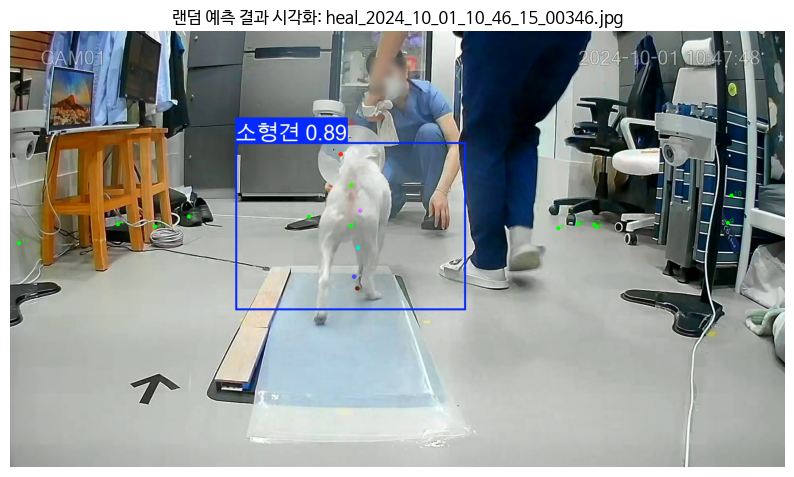

In [ ]:
# 예측 결과 시각화
import os
import cv2
import random
import matplotlib.pyplot as plt

# 경로 설정
image_dir = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs_yolo11/predict_results"
label_dir = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs_yolo11/predict_results/labels"

# keypoint 수
num_kpts = 12

# 파일 목록 불러오기
image_files = sorted([f for f in os.listdir(image_dir) if f.endswith(".jpg")])
label_files = sorted([f for f in os.listdir(label_dir) if f.endswith(".txt")])

# 파일명 기준으로 일치하는 페어만 선택
base_names = set(os.path.splitext(f)[0] for f in image_files) & set(os.path.splitext(f)[0] for f in label_files)
base_name = random.choice(list(base_names))  # 🔀 랜덤 선택

# 경로 설정
sample_image_path = os.path.join(image_dir, base_name + ".jpg")
sample_label_path = os.path.join(label_dir, base_name + ".txt")

# 이미지 불러오기
image = cv2.imread(sample_image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
h, w, _ = image.shape

# keypoint 추출
with open(sample_label_path, 'r') as f:
    line = f.readline().strip().split()
    keypoint_values = list(map(float, line[1:]))

keypoints = []
for i in range(num_kpts):
    x = keypoint_values[i * 3] * w
    y = keypoint_values[i * 3 + 1] * h
    v = keypoint_values[i * 3 + 2]
    if v > 0:
        keypoints.append((int(x), int(y)))
    else:
        keypoints.append(None)

# 시각화
for i, pt in enumerate(keypoints):
    if pt:
        cv2.circle(image, pt, 5, (0, 255, 0), -1)
        cv2.putText(image, str(i), (pt[0]+5, pt[1]), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)

# 출력
plt.figure(figsize=(10, 6))
plt.imshow(image)
plt.axis("off")
plt.title(f"랜덤 예측 결과 시각화: {base_name}.jpg")
plt.show()


# 5.0 yolo pose한 내용을 supervison으로 예쁘게 시각화

In [ ]:
import numpy as np
import supervision as sv
from ultralytics import YOLO
import cv2

model = YOLO("yolov11n-pose.pt")
edge_annotator = sv.EdgeAnnotator()
vertex_annotator = sv.VertexAnnotator()

# 이미지 읽기
# /content/drive/MyDrive/pet_angle_copy/dataset_split2/test/tail_image
image = cv2.imread("skiiing_still.png")

# 추론 실행
results = model(image)[0]
key_points = sv.KeyPoints.from_ultralytics(results)

# 키포인트 어노테이션 적용
annotated_frame = edge_annotator.annotate(image.copy(), key_points=key_points)
annotated_frame = vertex_annotator.annotate(annotated_frame, key_points=key_points)

# 결과 이미지 저장
# cv2.imwrite("result_pose.jpg", annotated_frame)

# 결과 이미지 화면에 표시
cv2.imshow("Pose Detection Result", annotated_frame)
cv2.waitKey(0)  # 키 입력까지 대기
cv2.destroyAllWindows()  # 모든 창 닫기

In [ ]:
!pip install supervision

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.2/207.2 kB 8.4 MB/s eta 0:00:00


In [ ]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 29.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 124.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 98.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 64.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 38.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 16.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 4.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 104.3 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalli

In [ ]:
# supervison의 keypoint 좌표 매핑

In [ ]:
from ultralytics import YOLO

# Load a COCO-pretrained YOLO12n model
model = YOLO("yolo12n.pt")

# Train the model on the COCO8 example dataset for 100 epochs
results = model.train(data="coco8.yaml", epochs=100, imgsz=640)

# Run inference with the YOLO12n model on the 'bus.jpg' image
results = model("path/to/bus.jpg")

Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=coco8.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo12n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train2, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.0, pretrained=True, profile=

train: Scanning /content/datasets/coco8/labels/train.cache... 4 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4/4 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 400.5±52.1 MB/s, size: 54.0 KB)


val: Scanning /content/datasets/coco8/labels/val.cache... 4 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4/4 [00:00<?, ?it/s]


Plotting labels to runs/detect/train2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000119, momentum=0.9) with parameter groups 113 weight(decay=0.0), 120 weight(decay=0.0005), 119 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train2
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      1.06G     0.6978      1.354      1.215         29        640: 100%|██████████| 1/1 [00:00<00:00,  6.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.86it/s]

                   all          4         17     0.0263      0.217     0.0897     0.0471



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      1.06G      1.252      2.284      1.554         46        640: 100%|██████████| 1/1 [00:00<00:00,  6.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 13.12it/s]

                   all          4         17     0.0581      0.483      0.127      0.061



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      1.06G      1.453      2.191      1.973         11        640: 100%|██████████| 1/1 [00:00<00:00,  6.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 15.88it/s]

                   all          4         17     0.0794      0.567      0.139     0.0606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      1.06G      1.116      1.851      1.325         22        640: 100%|██████████| 1/1 [00:00<00:00,  6.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.75it/s]

                   all          4         17     0.0611      0.567      0.139     0.0745



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      1.06G     0.9548       1.86      1.308         39        640: 100%|██████████| 1/1 [00:00<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.28it/s]

                   all          4         17      0.132      0.364       0.26      0.202



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      1.06G      0.771      1.528      1.205         26        640: 100%|██████████| 1/1 [00:00<00:00,  6.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.76it/s]

                   all          4         17      0.395      0.323      0.271      0.204



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      1.06G      1.155      3.078      1.557         23        640: 100%|██████████| 1/1 [00:00<00:00,  6.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.47it/s]

                   all          4         17      0.584      0.284      0.278      0.207



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      1.06G     0.7947      1.437      1.245         16        640: 100%|██████████| 1/1 [00:00<00:00,  6.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.23it/s]

                   all          4         17      0.574      0.255      0.288       0.21



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      1.06G     0.9545      1.299      1.381         20        640: 100%|██████████| 1/1 [00:00<00:00,  6.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 16.54it/s]

                   all          4         17        0.6      0.272      0.294      0.205



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      1.06G     0.9696      1.373      1.308         29        640: 100%|██████████| 1/1 [00:00<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.40it/s]

                   all          4         17      0.534      0.288        0.3      0.211



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      1.06G     0.9416      1.419      1.288         36        640: 100%|██████████| 1/1 [00:00<00:00,  6.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.01it/s]

                   all          4         17      0.543      0.371      0.371      0.238



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      1.06G     0.7694      1.341      1.232         27        640: 100%|██████████| 1/1 [00:00<00:00,  6.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.40it/s]

                   all          4         17      0.637      0.358      0.392      0.243



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      1.06G     0.7532       1.18      1.407         10        640: 100%|██████████| 1/1 [00:00<00:00,  6.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.99it/s]

                   all          4         17      0.713      0.358      0.445       0.29



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      1.06G     0.6108     0.9553      1.065         23        640: 100%|██████████| 1/1 [00:00<00:00,  6.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 16.66it/s]

                   all          4         17      0.718      0.365      0.483      0.316



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      1.06G     0.7125      1.039      1.239         19        640: 100%|██████████| 1/1 [00:00<00:00,  6.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.45it/s]

                   all          4         17      0.717      0.364      0.505      0.353



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      1.06G     0.9007      1.395      1.233         32        640: 100%|██████████| 1/1 [00:00<00:00,  6.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.69it/s]

                   all          4         17      0.673        0.4      0.528      0.362



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      1.06G     0.8971     0.7955      1.368         17        640: 100%|██████████| 1/1 [00:00<00:00,  6.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.59it/s]

                   all          4         17      0.687      0.416      0.631      0.416



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      1.06G     0.7315      0.758      1.118         10        640: 100%|██████████| 1/1 [00:00<00:00,  9.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.55it/s]

                   all          4         17      0.687      0.416      0.631      0.416



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      1.06G     0.8027      1.335       1.36         19        640: 100%|██████████| 1/1 [00:00<00:00,  6.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.12it/s]

                   all          4         17      0.685      0.425      0.638      0.461



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      1.06G      1.129      1.055      1.575         23        640: 100%|██████████| 1/1 [00:00<00:00,  9.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 17.74it/s]

                   all          4         17      0.685      0.425      0.638      0.461



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      1.06G      1.065       1.31      1.449         23        640: 100%|██████████| 1/1 [00:00<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.44it/s]

                   all          4         17      0.687      0.421      0.664      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      1.06G     0.9727     0.9341       1.29         40        640: 100%|██████████| 1/1 [00:00<00:00,  8.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.49it/s]

                   all          4         17      0.687      0.421      0.664      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      1.06G     0.6433     0.7047      1.146         23        640: 100%|██████████| 1/1 [00:00<00:00,  6.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.51it/s]

                   all          4         17      0.719      0.398      0.672      0.487



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      1.06G     0.8357      1.024      1.176         38        640: 100%|██████████| 1/1 [00:00<00:00,  9.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.50it/s]

                   all          4         17      0.719      0.398      0.672      0.487



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      1.06G     0.6805     0.5657      1.179         19        640: 100%|██████████| 1/1 [00:00<00:00,  5.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 17.89it/s]

                   all          4         17      0.722      0.388      0.674      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      1.06G     0.8542     0.9275       1.22         26        640: 100%|██████████| 1/1 [00:00<00:00,  9.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.36it/s]

                   all          4         17      0.722      0.388      0.674      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      1.06G     0.8367     0.8729      1.199         23        640: 100%|██████████| 1/1 [00:00<00:00,  6.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.06it/s]

                   all          4         17      0.888        0.4      0.757       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      1.06G     0.6124     0.7196      1.147         23        640: 100%|██████████| 1/1 [00:00<00:00,  9.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.07it/s]

                   all          4         17      0.888        0.4      0.757       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      1.06G      1.001     0.8606      1.374         33        640: 100%|██████████| 1/1 [00:00<00:00,  6.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.78it/s]

                   all          4         17      0.887      0.399       0.82      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      1.06G     0.7074     0.4137      1.232         13        640: 100%|██████████| 1/1 [00:00<00:00,  8.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.64it/s]

                   all          4         17      0.887      0.399       0.82      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      1.06G     0.8186      1.018      1.269         27        640: 100%|██████████| 1/1 [00:00<00:00,  6.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 17.96it/s]

                   all          4         17      0.728       0.45      0.818      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      1.06G     0.6749     0.5927      1.206         19        640: 100%|██████████| 1/1 [00:00<00:00,  9.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.49it/s]

                   all          4         17      0.728       0.45      0.818      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      1.06G     0.7677     0.9728      1.178         34        640: 100%|██████████| 1/1 [00:00<00:00,  6.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.21it/s]

                   all          4         17      0.727      0.633      0.819      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      1.06G     0.7823     0.7588        1.2         30        640: 100%|██████████| 1/1 [00:00<00:00,  9.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 16.42it/s]

                   all          4         17      0.727      0.633      0.819      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      1.06G     0.6811     0.8128      1.131         25        640: 100%|██████████| 1/1 [00:00<00:00,  6.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.91it/s]

                   all          4         17      0.704      0.633      0.862       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      1.06G     0.7271     0.7918       1.09         41        640: 100%|██████████| 1/1 [00:00<00:00,  8.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 16.59it/s]

                   all          4         17      0.704      0.633      0.862       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      1.06G     0.5884     0.6209      1.028         40        640: 100%|██████████| 1/1 [00:00<00:00,  6.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.59it/s]

                   all          4         17      0.695      0.633      0.862      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      1.06G     0.8385     0.6995      1.257         20        640: 100%|██████████| 1/1 [00:00<00:00,  9.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 16.23it/s]

                   all          4         17      0.695      0.633      0.862      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      1.06G     0.7201     0.7064      1.115         28        640: 100%|██████████| 1/1 [00:00<00:00,  6.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.62it/s]

                   all          4         17      0.668      0.633      0.858      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      1.06G     0.4224     0.5304     0.9947         18        640: 100%|██████████| 1/1 [00:00<00:00,  8.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 16.61it/s]

                   all          4         17      0.668      0.633      0.858      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      1.06G     0.6856     0.6742      1.155         21        640: 100%|██████████| 1/1 [00:00<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.36it/s]

                   all          4         17      0.685        0.6      0.828      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      1.06G     0.4942     0.5511      1.042         25        640: 100%|██████████| 1/1 [00:00<00:00,  8.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.68it/s]

                   all          4         17      0.685        0.6      0.828      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      1.06G     0.5566     0.6609      1.066         25        640: 100%|██████████| 1/1 [00:00<00:00,  6.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.89it/s]

                   all          4         17      0.702      0.593      0.854      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      1.06G     0.6645     0.4963      1.035         34        640: 100%|██████████| 1/1 [00:00<00:00,  7.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.69it/s]

                   all          4         17      0.702      0.593      0.854      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      1.06G     0.7077     0.6831      1.146         37        640: 100%|██████████| 1/1 [00:00<00:00,  6.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.35it/s]

                   all          4         17      0.706      0.583      0.825      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      1.06G     0.8093     0.5868      1.468         16        640: 100%|██████████| 1/1 [00:00<00:00,  8.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.69it/s]

                   all          4         17      0.706      0.583      0.825      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      1.06G     0.6786     0.5227      1.194         21        640: 100%|██████████| 1/1 [00:00<00:00,  6.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.95it/s]

                   all          4         17       0.72      0.583      0.822      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      1.06G     0.9718     0.5941      1.475         19        640: 100%|██████████| 1/1 [00:00<00:00,  9.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.11it/s]

                   all          4         17       0.72      0.583      0.822      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      1.06G     0.5443     0.5977      1.053         26        640: 100%|██████████| 1/1 [00:00<00:00,  6.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.68it/s]

                   all          4         17      0.707      0.583      0.822      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      1.06G      0.549     0.4429      1.095         30        640: 100%|██████████| 1/1 [00:00<00:00,  9.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.36it/s]

                   all          4         17      0.707      0.583      0.822      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      1.06G     0.5684     0.6121     0.9712         38        640: 100%|██████████| 1/1 [00:00<00:00,  6.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.22it/s]

                   all          4         17      0.712      0.583      0.848      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      1.06G     0.6048     0.7756     0.9929         41        640: 100%|██████████| 1/1 [00:00<00:00,  9.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.60it/s]

                   all          4         17      0.712      0.583      0.848      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      1.06G     0.7659     0.5074      1.263         23        640: 100%|██████████| 1/1 [00:00<00:00,  9.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 16.90it/s]

                   all          4         17      0.712      0.583      0.848      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      1.06G     0.7252     0.5619      1.082         36        640: 100%|██████████| 1/1 [00:00<00:00,  6.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.55it/s]

                   all          4         17      0.719      0.574      0.847      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      1.06G     0.5763     0.6591      1.076         45        640: 100%|██████████| 1/1 [00:00<00:00,  9.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.72it/s]

                   all          4         17      0.719      0.574      0.847      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      1.06G     0.6209     0.5723      1.032         36        640: 100%|██████████| 1/1 [00:00<00:00,  9.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.19it/s]

                   all          4         17      0.719      0.574      0.847      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      1.06G     0.7773     0.7023       1.14         41        640: 100%|██████████| 1/1 [00:00<00:00,  6.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.01it/s]

                   all          4         17      0.724      0.567      0.875      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      1.06G     0.6131     0.4291      1.289         17        640: 100%|██████████| 1/1 [00:00<00:00,  9.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.27it/s]

                   all          4         17      0.724      0.567      0.875      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      1.06G     0.5535     0.7216      1.029         24        640: 100%|██████████| 1/1 [00:00<00:00,  8.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.11it/s]

                   all          4         17      0.724      0.567      0.875      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      1.06G     0.4663     0.4321     0.9897         16        640: 100%|██████████| 1/1 [00:00<00:00,  6.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.96it/s]

                   all          4         17      0.727      0.567      0.875      0.582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      1.06G     0.6781     0.8568      1.114         30        640: 100%|██████████| 1/1 [00:00<00:00,  8.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 16.63it/s]


                   all          4         17      0.727      0.567      0.875      0.582

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      1.06G     0.6318     0.4907      1.125         32        640: 100%|██████████| 1/1 [00:00<00:00,  8.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.28it/s]

                   all          4         17      0.727      0.567      0.875      0.582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      1.06G     0.5906     0.5992      1.083         27        640: 100%|██████████| 1/1 [00:00<00:00,  6.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.57it/s]

                   all          4         17      0.731      0.567      0.873      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      1.06G     0.6307     0.4093      1.038         34        640: 100%|██████████| 1/1 [00:00<00:00,  9.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.14it/s]

                   all          4         17      0.731      0.567      0.873      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      1.06G     0.7532      0.473       1.03         35        640: 100%|██████████| 1/1 [00:00<00:00,  8.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.68it/s]

                   all          4         17      0.731      0.567      0.873      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      1.06G     0.7878     0.5989      1.158         34        640: 100%|██████████| 1/1 [00:00<00:00,  6.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 16.90it/s]

                   all          4         17      0.738      0.567      0.902       0.54



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      1.06G     0.5394     0.4071      1.109         20        640: 100%|██████████| 1/1 [00:00<00:00,  9.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 16.87it/s]

                   all          4         17      0.738      0.567      0.902       0.54



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      1.06G     0.6467     0.5369      1.052         35        640: 100%|██████████| 1/1 [00:00<00:00,  9.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 17.54it/s]


                   all          4         17      0.738      0.567      0.902       0.54

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      1.06G     0.5066     0.4018      1.061         16        640: 100%|██████████| 1/1 [00:00<00:00,  6.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 17.00it/s]

                   all          4         17       0.75      0.567        0.9      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      1.06G     0.6429     0.4675      1.116         28        640: 100%|██████████| 1/1 [00:00<00:00,  8.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 17.08it/s]

                   all          4         17       0.75      0.567        0.9      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      1.06G     0.4688     0.3725     0.9709         31        640: 100%|██████████| 1/1 [00:00<00:00,  8.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.27it/s]

                   all          4         17       0.75      0.567        0.9      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      1.06G     0.5551     0.5378      1.088         23        640: 100%|██████████| 1/1 [00:00<00:00,  6.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 17.95it/s]

                   all          4         17      0.745      0.567        0.9      0.548



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      1.06G     0.4729     0.4782     0.9541         37        640: 100%|██████████| 1/1 [00:00<00:00,  9.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 16.41it/s]

                   all          4         17      0.745      0.567        0.9      0.548



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      1.06G     0.6422     0.6079      1.182         26        640: 100%|██████████| 1/1 [00:00<00:00,  8.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.32it/s]

                   all          4         17      0.745      0.567        0.9      0.548



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      1.06G      0.673      1.494      1.142         55        640: 100%|██████████| 1/1 [00:00<00:00,  6.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.18it/s]

                   all          4         17      0.751      0.567      0.899      0.546



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      1.06G     0.6145      0.429      1.165         27        640: 100%|██████████| 1/1 [00:00<00:00,  8.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.09it/s]

                   all          4         17      0.751      0.567      0.899      0.546



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      1.06G      0.702     0.5381      1.113         33        640: 100%|██████████| 1/1 [00:00<00:00,  8.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.71it/s]

                   all          4         17      0.751      0.567      0.899      0.546



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      1.06G     0.5369     0.5509       1.03         40        640: 100%|██████████| 1/1 [00:00<00:00,  6.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.09it/s]

                   all          4         17      0.741      0.567      0.895      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      1.06G     0.7555     0.5402      1.187         18        640: 100%|██████████| 1/1 [00:00<00:00,  8.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.30it/s]

                   all          4         17      0.741      0.567      0.895      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      1.06G     0.5184      1.177      1.119         15        640: 100%|██████████| 1/1 [00:00<00:00,  9.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.29it/s]

                   all          4         17      0.741      0.567      0.895      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      1.06G     0.4281     0.4333     0.9533         29        640: 100%|██████████| 1/1 [00:00<00:00,  5.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 15.86it/s]

                   all          4         17      0.731      0.552      0.895      0.541



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      1.06G     0.6099     0.6852      1.082         32        640: 100%|██████████| 1/1 [00:00<00:00,  9.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.50it/s]

                   all          4         17      0.731      0.552      0.895      0.541



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      1.06G     0.4449     0.4277      0.984         25        640: 100%|██████████| 1/1 [00:00<00:00,  9.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.61it/s]

                   all          4         17      0.731      0.552      0.895      0.541



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      1.06G     0.7431     0.6503      1.143         37        640: 100%|██████████| 1/1 [00:00<00:00,  6.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.12it/s]

                   all          4         17      0.705      0.567      0.811      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      1.06G     0.5395     0.4264      1.196         14        640: 100%|██████████| 1/1 [00:00<00:00,  9.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.73it/s]

                   all          4         17      0.705      0.567      0.811      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      1.06G     0.4816     0.5222      1.059         15        640: 100%|██████████| 1/1 [00:00<00:00,  8.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.70it/s]

                   all          4         17      0.705      0.567      0.811      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      1.06G     0.5618     0.4345      1.082         22        640: 100%|██████████| 1/1 [00:00<00:00,  8.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 16.06it/s]

                   all          4         17      0.705      0.567      0.811      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      1.06G     0.5199     0.5925      1.093         28        640: 100%|██████████| 1/1 [00:00<00:00,  6.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.08it/s]

                   all          4         17      0.678      0.579      0.808      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      1.06G     0.7046     0.5932      1.114         37        640: 100%|██████████| 1/1 [00:00<00:00,  9.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.52it/s]

                   all          4         17      0.678      0.579      0.808      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      1.06G     0.6429     0.4859      1.109         26        640: 100%|██████████| 1/1 [00:00<00:00,  8.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.14it/s]

                   all          4         17      0.678      0.579      0.808      0.542


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      1.06G     0.4543     0.3882      0.852         13        640: 100%|██████████| 1/1 [00:00<00:00,  4.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.32it/s]

                   all          4         17      0.678      0.579      0.808      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      1.06G     0.4263     0.3289     0.8514         13        640: 100%|██████████| 1/1 [00:00<00:00,  6.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 15.07it/s]

                   all          4         17      0.674      0.567      0.835      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      1.06G     0.5873     0.5072     0.8856         13        640: 100%|██████████| 1/1 [00:00<00:00,  9.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 16.21it/s]


                   all          4         17      0.674      0.567      0.835      0.567

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      1.06G     0.4079     0.3275     0.9223         13        640: 100%|██████████| 1/1 [00:00<00:00,  8.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.04it/s]

                   all          4         17      0.674      0.567      0.835      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      1.06G     0.4413     0.3856     0.8471         13        640: 100%|██████████| 1/1 [00:00<00:00,  8.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.95it/s]

                   all          4         17      0.674      0.567      0.835      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      1.06G     0.5416      0.386      1.148         13        640: 100%|██████████| 1/1 [00:00<00:00,  6.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 16.32it/s]

                   all          4         17      0.687      0.554      0.832      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      1.06G     0.4442     0.3842     0.9651         13        640: 100%|██████████| 1/1 [00:00<00:00,  8.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.13it/s]


                   all          4         17      0.687      0.554      0.832      0.537

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      1.06G     0.3679     0.2907     0.8937         13        640: 100%|██████████| 1/1 [00:00<00:00,  8.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.40it/s]

                   all          4         17      0.687      0.554      0.832      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      1.06G     0.4565     0.4915      0.973         13        640: 100%|██████████| 1/1 [00:00<00:00,  8.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.31it/s]

                   all          4         17      0.687      0.554      0.832      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      1.06G     0.3625     0.3309     0.8007         13        640: 100%|██████████| 1/1 [00:00<00:00,  6.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.37it/s]

                   all          4         17      0.751       0.55      0.913      0.608



100 epochs completed in 0.018 hours.
Optimizer stripped from runs/detect/train2/weights/last.pt, 5.6MB
Optimizer stripped from runs/detect/train2/weights/best.pt, 5.6MB

Validating runs/detect/train2/weights/best.pt...
Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
YOLOv12n summary (fused): 159 layers, 2,590,824 parameters, 0 gradients, 6.5 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 26.09it/s]


                   all          4         17      0.778       0.55      0.913      0.608
                person          3         10      0.858        0.3        0.5      0.256
                   dog          1          1      0.653          1      0.995      0.796
                 horse          1          2      0.545          1      0.995      0.574
              elephant          1          2          1          0      0.995      0.133
              umbrella          1          1      0.614          1      0.995      0.995
          potted plant          1          1          1          0      0.995      0.895
Speed: 0.2ms preprocess, 4.8ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to runs/detect/train2



FileNotFoundError: path/to/bus.jpg does not exist

In [ ]:
import os
import random
import numpy as np
import supervision as sv
from ultralytics import YOLO
import cv2
import matplotlib.pyplot as plt

# ✅ YOLOv11 pose 모델 로드
model = YOLO("yolo11n-pose.pt")
model = YOLO("yolov8m-pose.pt")

🔍 선택된 이미지: jamsil_2024_10_30_10_29_10_00642.jpg

0: 384x640 1 person, 11.7ms
Speed: 2.4ms preprocess, 11.7ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


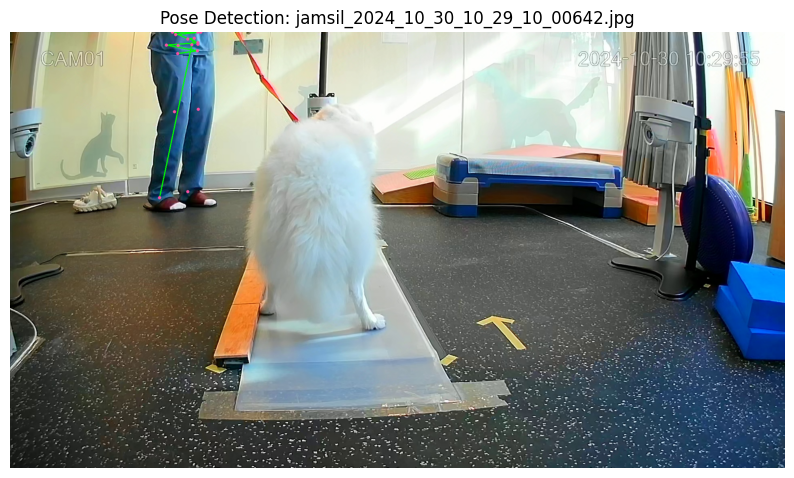

In [ ]:
import os
import random
import numpy as np
import supervision as sv
from ultralytics import YOLO
import cv2
import matplotlib.pyplot as plt

# ✅ YOLOv11 pose 모델 로드
model = YOLO("yolo11n-pose.pt")

# ✅ 사용자 지정 keypoint edge 연결
CUSTOM_EDGES = [
    (0, 1), (1, 2), (2, 3),
    (4, 5), (5, 6), (6, 7),
    (7, 8), (8, 9), (9, 10), (10, 11)
]

# ✅ Annotator 정의
# Use RGB tuple for green color
edge_annotator = sv.EdgeAnnotator(edges=CUSTOM_EDGES, color=sv.Color(r=0, g=255, b=0))
vertex_annotator = sv.VertexAnnotator()

# ✅ 이미지 폴더 경로 설정
image_dir = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/test/tail_image"

# ✅ 랜덤 이미지 선택
image_files = [f for f in os.listdir(image_dir) if f.endswith(('.jpg', '.png'))]
random_image = random.choice(image_files)
image_path = os.path.join(image_dir, random_image)
print(f"🔍 선택된 이미지: {random_image}")

# ✅ 이미지 읽기
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# ✅ YOLO 추론
results = model(image)[0]
key_points = sv.KeyPoints.from_ultralytics(results)

# ✅ 시각화
annotated_frame = edge_annotator.annotate(image.copy(), key_points=key_points)
annotated_frame = vertex_annotator.annotate(annotated_frame, key_points=key_points)

# ✅ 결과 표시 (Colab 또는 Jupyter에 적합)
plt.figure(figsize=(10, 6))
plt.imshow(annotated_frame)
plt.axis("off")
plt.title(f"Pose Detection: {random_image}")
plt.show()

🔍 선택된 이미지: jamsil_2024_09_30_10_47_30_00569.jpg

0: 448x768 1 소형견, 11.1ms
Speed: 3.1ms preprocess, 11.1ms inference, 1.7ms postprocess per image at shape (1, 3, 448, 768)


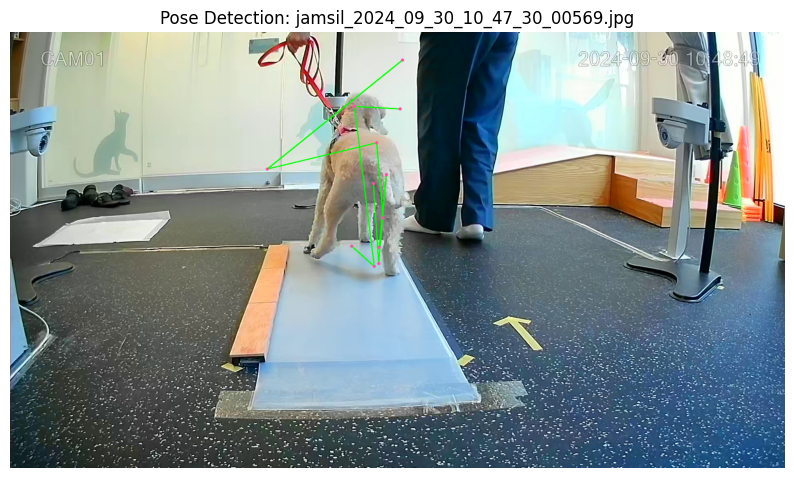

In [ ]:
import os
import random
import numpy as np
import supervision as sv
from ultralytics import YOLO
import cv2
import matplotlib.pyplot as plt

# ✅ YOLOv11 pose 모델 로드
model = YOLO("/content/drive/MyDrive/pet_angle_copy/dataset_split2/tail_runs_yolo11/train_pose_model/weights/best.pt")  # 학습된 best 모델 경로

# ✅ 사용자 지정 keypoint edge 연결
CUSTOM_EDGES = [
    (0, 1), (1, 2), (2, 3),
    (4, 5), (5, 6), (6, 7),
    (7, 8), (8, 9), (9, 10), (10, 11)
]

# ✅ Annotator 정의
# Use RGB tuple for green color
edge_annotator = sv.EdgeAnnotator(edges=CUSTOM_EDGES, color=sv.Color(r=0, g=255, b=0))
vertex_annotator = sv.VertexAnnotator()

# ✅ 이미지 폴더 경로 설정
image_dir = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/train/tail_image"

# ✅ 랜덤 이미지 선택
image_files = [f for f in os.listdir(image_dir) if f.endswith(('.jpg', '.png'))]
random_image = random.choice(image_files)
image_path = os.path.join(image_dir, random_image)
print(f"🔍 선택된 이미지: {random_image}")

# ✅ 이미지 읽기
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# ✅ YOLO 추론
results = model(image)[0]
key_points = sv.KeyPoints.from_ultralytics(results)

# ✅ 시각화
annotated_frame = edge_annotator.annotate(image.copy(), key_points=key_points)
annotated_frame = vertex_annotator.annotate(annotated_frame, key_points=key_points)

# ✅ 결과 표시 (Colab 또는 Jupyter에 적합)
plt.figure(figsize=(10, 6))
plt.imshow(annotated_frame)
plt.axis("off")
plt.title(f"Pose Detection: {random_image}")
plt.show()

# 5. 방향별 슬개골 탈구 예측

In [ ]:
✅ 전체 파이프라인 요약

✅ predict_results/labels/*.txt → keypoint 추출
✅ severity 정보 추출 (JSON에서)
🔁 keypoint → 수치형 feature 가공 (거리, 각도 등)

🔁 (X, y) 만들고 ML 모델 학습
✅ 슬개골 탈구 여부/등급 예측

In [ ]:
# 📁 Step 1. YOLO 예측 txt → keypoint DataFrame 정리

In [ ]:
import json

def load_severity_from_json(json_dir):
    severity_dict = {}
    for file in os.listdir(json_dir):
        if not file.endswith(".json"):
            continue
        with open(os.path.join(json_dir, file), 'r') as f:
            data = json.load(f)
            filename = os.path.splitext(data['image_info']['filename'])[0]
            severity = int(data['severity'])  # 예: 0~4 범주
            severity_dict[filename] = severity
    return severity_dict

# 사용 예
json_dir = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/test/tail_json"
severity_map = load_severity_from_json(json_dir)

# keypoints_df에 merge
keypoints_df["severity"] = keypoints_df["filename"].map(severity_map)
keypoints_df = keypoints_df.dropna()  # 일부 누락된 라벨 제거


In [ ]:
import numpy as np

def compute_distance(p1, p2):
    return np.linalg.norm(np.array(p1) - np.array(p2))

def extract_features(df):
    features = []
    for _, row in df.iterrows():
        # 거리 feature 예시
        p5 = np.array([row['kp5_x'], row['kp5_y']])
        p6 = np.array([row['kp6_x'], row['kp6_y']])
        p7 = np.array([row['kp7_x'], row['kp7_y']])

        d1 = compute_distance(p5, p6)
        d2 = compute_distance(p6, p7)
        d3 = compute_distance(p5, p7)

        features.append([d1, d2, d3])
    return np.array(features)

X = extract_features(keypoints_df)
y = keypoints_df["severity"].values


In [ ]:
from sklearn.model_selection import train_test_split
from xgboost import XGBClassifier
from sklearn.metrics import classification_report

X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y)

clf = XGBClassifier()
clf.fit(X_train, y_train)

y_pred = clf.predict(X_test)
print(classification_report(y_test, y_pred))


# 4.0 파인튜닝 적용하기 전, 24개 keypoint로 강아지 사진 시각화해보기

In [ ]:
json_path = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/StanfordExtra_v12.json"
/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split
/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split/train

In [ ]:
# keypoint order

📂 시각화 대상: n02109047_24340.jpg


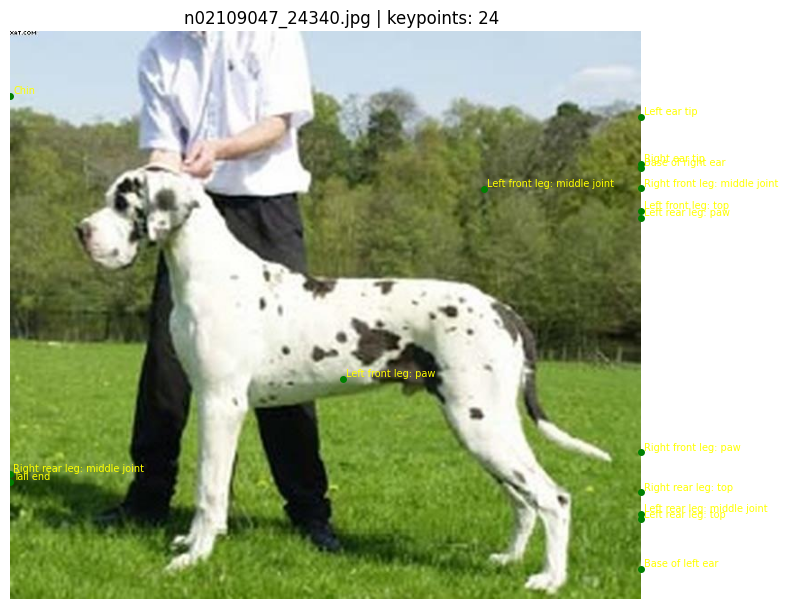

In [7]:
import cv2
import random
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from pathlib import Path

# ✅ 24개 keypoint 순서에 맞는 명칭
KEYPOINT_LABELS = [
    'Left front leg: paw', 'Left front leg: middle joint', 'Left front leg: top',
    'Left rear leg: paw', 'Left rear leg: middle joint', 'Left rear leg: top',
    'Right front leg: paw', 'Right front leg: middle joint', 'Right front leg: top',
    'Right rear leg: paw', 'Right rear leg: middle joint', 'Right rear leg: top',
    'Tail start', 'Tail end',
    'Base of left ear', 'Base of right ear',
    'Nose', 'Chin', 'Left ear tip', 'Right ear tip',
    'Left eye', 'Right eye', 'Withers', 'Throat'
]

# ✅ bbox를 시각화하려면 YOLO format에서 변환 필요
def draw_bbox(ax, bbox, img_w, img_h, color="red"):
    x_center, y_center, w, h = bbox
    x_center *= img_w
    y_center *= img_h
    w *= img_w
    h *= img_h
    x_min = x_center - w / 2
    y_min = y_center - h / 2
    rect = patches.Rectangle((x_min, y_min), w, h,
                             linewidth=2, edgecolor=color, facecolor='none')
    ax.add_patch(rect)

# ✅ 시각화 함수
def visualize_yolo_pose(txt_path, image_path):
    with open(txt_path, "r") as f:
        values = list(map(float, f.readline().strip().split()))

    class_id = int(values[0])
    kps = values[1:-4*1]  # 24*3 = 72 keypoint
    bbox = values[-4:]    # YOLO format bbox: xc, yc, w, h

    # 이미지 로딩
    image = cv2.imread(str(image_path))
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    h, w, _ = image.shape

    # 시각화
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.imshow(image)

    # bbox
    draw_bbox(ax, bbox, w, h)

    # keypoint 시각화
    for i in range(0, len(kps), 3):
        x, y, v = kps[i], kps[i+1], kps[i+2]
        if v > 0:
            abs_x = x * w
            abs_y = y * h
            label = KEYPOINT_LABELS[i // 3]
            ax.plot(abs_x, abs_y, 'go', markersize=4)
            ax.text(abs_x + 3, abs_y - 3, label, fontsize=7, color='yellow')

    plt.title(f"{Path(image_path).name} | keypoints: {len(kps)//3}")
    plt.axis('off')
    plt.tight_layout()
    plt.show()

# ✅ 실행 함수
def random_visualize_yolo_pose(folder_path):
    folder = Path(folder_path)
    image_files = sorted(folder.glob("*.jpg"))
    if not image_files:
        print("❌ 이미지가 없습니다.")
        return

    sample_img = random.choice(image_files)
    sample_txt = sample_img.with_suffix(".txt")

    if not sample_txt.exists():
        print(f"❌ 해당 이미지에 대한 .txt 파일이 없습니다: {sample_txt.name}")
        return

    print(f"📂 시각화 대상: {sample_img.name}")
    visualize_yolo_pose(sample_txt, sample_img)

# ✅ 사용 예시
random_visualize_yolo_pose("/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split/train")


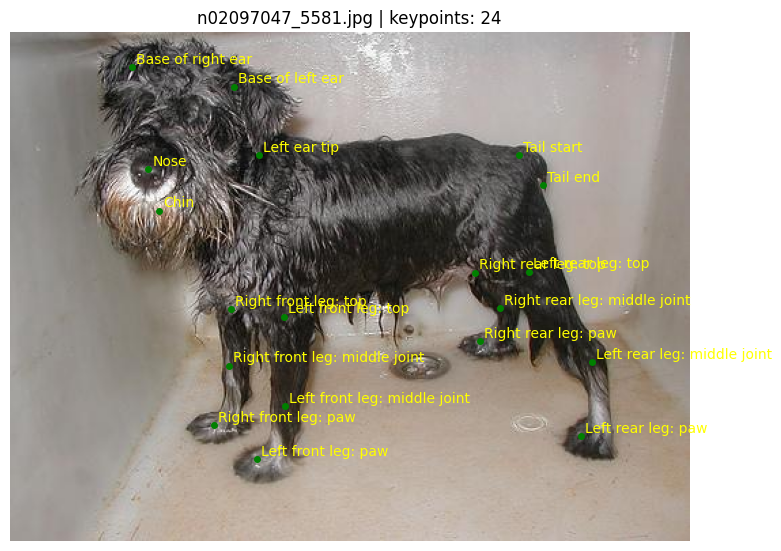

In [43]:
import json
import random
import cv2
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from pathlib import Path

# keypoint label (24개)
KEYPOINT_LABELS = [
    'Left front leg: paw', 'Left front leg: middle joint', 'Left front leg: top',
    'Left rear leg: paw', 'Left rear leg: middle joint', 'Left rear leg: top',
    'Right front leg: paw', 'Right front leg: middle joint', 'Right front leg: top',
    'Right rear leg: paw', 'Right rear leg: middle joint', 'Right rear leg: top',
    'Tail start', 'Tail end',
    'Base of left ear', 'Base of right ear',
    'Nose', 'Chin', 'Left ear tip', 'Right ear tip',
    'Left eye', 'Right eye', 'Withers', 'Throat'
]

# 이미지 폴더 (중간 품종 폴더 없음)
base_image_folder = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split/train"

# JSON 경로
json_path = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/StanfordExtra_v12.json"

# JSON 로드
with open(json_path, "r") as f:
    data = json.load(f)

# 랜덤 샘플 선택
sample_data = random.choice(data)
original_path = sample_data["img_path"]  # 예: 'n02091032-Italian_greyhound/n02091032_10079.jpg'
file_name = Path(original_path).name     # 'n02091032_10079.jpg' 추출
img_file = Path(base_image_folder) / file_name

# joints 불러오기
joints = sample_data["joints"]

# 이미지 로드
image = cv2.imread(str(img_file))
if image is None:
    raise FileNotFoundError(f"❌ 이미지가 존재하지 않습니다: {img_file}")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# 시각화
fig, ax = plt.subplots(figsize=(8, 8))
ax.imshow(image)

for i, (x, y, v) in enumerate(joints):
    if v > 0:
        label = KEYPOINT_LABELS[i] if i < len(KEYPOINT_LABELS) else f"kp{i}"
        ax.plot(x, y, 'go', markersize=4)
        ax.text(x + 3, y - 3, label, fontsize=10, color='yellow')

plt.title(f"{file_name} | keypoints: {len(joints)}")
plt.axis('off')
plt.tight_layout()
plt.show()



# 4. 파인튜닝 (DownStream 분류기 적용)

In [ ]:
import os

# 이미지가 들어 있는 최상위 폴더 경로
image_root = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs/images/Images"

# 카운트할 이미지 확장자 목록
image_extensions = [".jpg", ".jpeg", ".png", ".bmp", ".webp"]

# 전체 이미지 파일 수 카운트
image_count = 0

for root, dirs, files in os.walk(image_root):
    for file in files:
        if any(file.lower().endswith(ext) for ext in image_extensions):
            image_count += 1

print(f"📸 전체 이미지 파일 수 (하위 폴더 포함): {image_count}개")


📸 전체 이미지 파일 수 (하위 폴더 포함): 20580개


In [ ]:
# /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs/images/Images

In [ ]:
import os
from collections import defaultdict

# 이미지가 들어 있는 최상위 폴더 경로
image_root = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs/images/Images"

# 카운트할 이미지 확장자 목록
image_extensions = [".jpg", ".jpeg", ".png", ".bmp", ".webp"]

# 파일명만 기준으로 저장할 딕셔너리 (key: 파일명, value: 전체 경로 리스트)
file_name_dict = defaultdict(list)

# 모든 파일 수집
for root, dirs, files in os.walk(image_root):
    for file in files:
        if any(file.lower().endswith(ext) for ext in image_extensions):
            file_name = file  # 또는 os.path.basename(file) 동일
            full_path = os.path.join(root, file)
            file_name_dict[file_name].append(full_path)

# 중복 파일명 확인
duplicate_files = {name: paths for name, paths in file_name_dict.items() if len(paths) > 1}

# 결과 출력
if duplicate_files:
    print(f"⚠️ 중복된 파일명 수: {len(duplicate_files)}개\n")
    for name, paths in duplicate_files.items():
        print(f"📛 파일명: {name}")
        for path in paths:
            print(f"   └─ 경로: {path}")
        print()
else:
    print("✅ 중복 파일명 없음")


✅ 중복 파일명 없음


In [ ]:
import json

# JSON 파일 경로
json_path = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/StanfordExtra_v12.json"

# JSON 로드
with open(json_path, "r") as f:
    data = json.load(f)

# 전체 이미지 개수 출력
print(f"📄 JSON에 기재된 이미지 항목 수: {len(data)}개")
# 파일명만 추출
filenames = [item["img_path"].split("/")[-1] for item in data]

# 고유 파일명 개수 확인
print(f"📁 고유한 파일명 수: {len(set(filenames))}개")


📄 JSON에 기재된 이미지 항목 수: 12538개
📁 고유한 파일명 수: 12538개


In [ ]:
# extra json과 원본 이미지 파일 개수 차이 : 12538개 vs 20580개

In [ ]:
npy에 기재된 데이터 기준으로 분할해야하는데, 폴더명을 타고 들어가지 말고, 실제파일명.jpg 이런식으로 저장하고 분할되도록

In [ ]:
import os
import shutil
import numpy as np
import json

# 경로 설정
original_images_root = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs/images/Images"
split_npy_paths = {
    "train": "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/train_stanford_StanfordExtra_v12.npy",
    "val": "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/val_stanford_StanfordExtra_v12.npy",
    "test": "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/test_stanford_StanfordExtra_v12.npy"
}
json_path = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/StanfordExtra_v12.json"
output_base_dir = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split"

# JSON 로드
with open(json_path, "r") as f:
    data = json.load(f)

# 분할 및 이미지 복사
for split_name, npy_path in split_npy_paths.items():
    indices = np.load(npy_path, allow_pickle=True)

    split_output_dir = os.path.join(output_base_dir, split_name)
    os.makedirs(split_output_dir, exist_ok=True)

    missing_files = []

    for idx in indices:
        idx = int(idx)
        img_rel_path = data[idx]["img_path"]  # 예: 'n02111129-Leonberg/n02111129_1215.jpg'
        filename = os.path.basename(img_rel_path)  # → 'n02111129_1215.jpg'

        src_path = os.path.join(original_images_root, img_rel_path)
        dst_path = os.path.join(split_output_dir, filename)

        if os.path.exists(src_path):
            shutil.copy2(src_path, dst_path)
        else:
            missing_files.append(src_path)

    print(f"✅ {split_name} 이미지 복사 완료. 총 {len(indices)}개 중 누락 {len(missing_files)}개")
    if missing_files:
        print("❗ 누락 파일 목록:")
        for f in missing_files[:10]:  # 처음 10개만 출력
            print("   -", f)


✅ train 이미지 복사 완료. 총 6773개 중 누락 0개
✅ val 이미지 복사 완료. 총 4062개 중 누락 0개
✅ test 이미지 복사 완료. 총 1703개 중 누락 0개


In [ ]:
# /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split/train
# /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split/val
# /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split/test


In [ ]:
import os
import json
import numpy as np

# 경로 설정
json_path = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/StanfordExtra_v12.json"
split_npy_paths = {
    "train": "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/train_stanford_StanfordExtra_v12.npy",
    "val": "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/val_stanford_StanfordExtra_v12.npy",
    "test": "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/test_stanford_StanfordExtra_v12.npy"
}
split_image_root = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split"

# JSON 로드
with open(json_path, 'r') as f:
    data = json.load(f)

# Split별 라벨 생성
for split_name, npy_path in split_npy_paths.items():
    indices = np.load(npy_path, allow_pickle=True)
    split_dir = os.path.join(split_image_root, split_name)

    print(f"🔹 {split_name} 라벨 생성 중... ({len(indices)}개)")
    skipped = 0

    for idx in indices:
        idx = int(idx)
        if idx >= len(data):
            skipped += 1
            continue

        item = data[idx]
        img_filename = os.path.basename(item["img_path"])        # e.g., n02111129_1215.jpg
        img_name_wo_ext = os.path.splitext(img_filename)[0]      # n02111129_1215
        img_path = os.path.join(split_dir, img_filename)
        txt_path = os.path.join(split_dir, img_name_wo_ext + ".txt")

        # ✅ 이미지 존재 여부 확인
        if not os.path.exists(img_path):
            print(f"❗ 이미지 누락: {img_path}")
            skipped += 1
            continue

        # ✅ bbox 정규화
        x, y, w, h = item["img_bbox"]
        img_w = item["img_width"]
        img_h = item["img_height"]
        x_center = (x + w / 2) / img_w
        y_center = (y + h / 2) / img_h
        bbox_w = w / img_w
        bbox_h = h / img_h

        # ✅ keypoints 정규화
        keypoints = item["joints"]
        keypoints_flat = []
        for kx, ky, v in keypoints:
            norm_x = kx / img_w if v != 0 else 0.0
            norm_y = ky / img_h if v != 0 else 0.0
            keypoints_flat.extend([round(norm_x, 6), round(norm_y, 6), v])

        # ✅ YOLO 포맷 라벨 저장 (class_id = 0)
        with open(txt_path, "w") as f:
            f.write(f"0 {x_center:.6f} {y_center:.6f} {bbox_w:.6f} {bbox_h:.6f} ")
            f.write(" ".join(map(str, keypoints_flat)))

    print(f"✅ {split_name} 완료: {len(indices)-skipped}개 생성, {skipped}개 누락")


🔹 train 라벨 생성 중... (6773개)
✅ train 완료: 6773개 생성, 0개 누락
🔹 val 라벨 생성 중... (4062개)
✅ val 완료: 4062개 생성, 0개 누락
🔹 test 라벨 생성 중... (1703개)
✅ test 완료: 1703개 생성, 0개 누락


In [ ]:
import os

# 경로 설정
base_dir = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split"
splits = ["train", "val", "test"]

# 결과 출력
for split in splits:
    split_dir = os.path.join(base_dir, split)
    txt_files = [f for f in os.listdir(split_dir) if f.endswith(".txt")]
    print(f"📄 {split} 폴더의 .txt 파일 수: {len(txt_files)}개")


📄 train 폴더의 .txt 파일 수: 6773개
📄 val 폴더의 .txt 파일 수: 4062개
📄 test 폴더의 .txt 파일 수: 1703개


In [ ]:
import os

# 경로 설정
base_dir = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split"
splits = ["train", "val", "test"]

# 결과 출력
for split in splits:
    split_dir = os.path.join(base_dir, split)
    txt_files = [f for f in os.listdir(split_dir) if f.endswith(".jpg")]
    print(f"📄 {split} 폴더의 .txt 파일 수: {len(txt_files)}개")


📄 train 폴더의 .txt 파일 수: 6773개
📄 val 폴더의 .txt 파일 수: 4062개
📄 test 폴더의 .txt 파일 수: 1703개


In [ ]:
import os

# 경로 설정
base_dir = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split"
splits = ["train", "val", "test"]

# 각 split 폴더 확인
for split in splits:
    split_dir = os.path.join(base_dir, split)
    jpg_files = set(os.path.splitext(f)[0] for f in os.listdir(split_dir) if f.endswith(".jpg"))
    txt_files = set(os.path.splitext(f)[0] for f in os.listdir(split_dir) if f.endswith(".txt"))

    only_jpg = sorted(jpg_files - txt_files)
    only_txt = sorted(txt_files - jpg_files)

    print(f"\n📂 {split} 폴더:")
    print(f" - 📸 jpg만 있고 txt가 없는 파일: {len(only_jpg)}개")
    if only_jpg:
        print("   예시:", only_jpg[:5])

    print(f" - 📝 txt만 있고 jpg가 없는 파일: {len(only_txt)}개")
    if only_txt:
        print("   예시:", only_txt[:5])



📂 train 폴더:
 - 📸 jpg만 있고 txt가 없는 파일: 0개
 - 📝 txt만 있고 jpg가 없는 파일: 0개

📂 val 폴더:
 - 📸 jpg만 있고 txt가 없는 파일: 0개
 - 📝 txt만 있고 jpg가 없는 파일: 0개

📂 test 폴더:
 - 📸 jpg만 있고 txt가 없는 파일: 0개
 - 📝 txt만 있고 jpg가 없는 파일: 0개


In [ ]:
# 현재까지 txt 파일 생성 완료(jpg와 매칭)
# extra json 기준으로 데이터 분할 (훈련,검증,시험) 완료

In [ ]:
그러면 파인튜닝 준비할 작업은 끝난 것이고,
슬개골 탈구는 방향별(side, front,tail) 별로 학습, 검증, 시험 데이터로 분할해서 yolo 작업한 거 잖아,
이번의 파인튜닝 데이터는 방향 데이터는 없잖아, 어떻게 하면 좋을까?


In [ ]:
# 문제점 - 파인튜닝
슬개골 탈구는 보통 측면 이미지에서 명확하게 판단됨
전신 포즈 추론 정확도 향상엔 좋지만,탈구 판단용 pose classification에는 한계


In [ ]:
✅ 1. Stanford Dogs 데이터는 YOLO pose 모델 generalization용으로 사용
다양한 품종, 포즈, 해상도 → Keypoint localization 정확도 향상
방향 구분 없이 기존 모델의 기반 feature extractor를 더 정교화하는 데 사용
즉, backbone + head를 더 똑똑하게 만들어주는 역할

🔁 이후 슬개골 탈구 분류는 다시 방향 필터링된 데이터셋에서 진행

# 4. 파인튜닝 작업 시작

# 4.0 YAML 파일 구성을 위한 Keypoint 순서 추출 (dict가 아닌, 리스트 형식의 json)

In [ ]:
import json

json_file_path = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/StanfordExtra_v12.json"

with open(json_file_path, 'r') as f:
    data = json.load(f)

# 첫 번째 샘플 확인
first_sample = data[0]

# joints가 존재하는지 확인
if "joints" in first_sample:
    num_keypoints = len(first_sample["joints"])
    keypoint_names = [f"kp_{i}" for i in range(num_keypoints)]
    print(f"✅ keypoint 수: {num_keypoints}")
    print("📌 keypoint 순서 (인덱스 기준):")
    for i, name in enumerate(keypoint_names):
        print(f"{i}: {name}")
else:
    print("❌ 'joints' 필드가 존재하지 않습니다.")


✅ keypoint 수: 24
📌 keypoint 순서 (인덱스 기준):
0: kp_0
1: kp_1
2: kp_2
3: kp_3
4: kp_4
5: kp_5
6: kp_6
7: kp_7
8: kp_8
9: kp_9
10: kp_10
11: kp_11
12: kp_12
13: kp_13
14: kp_14
15: kp_15
16: kp_16
17: kp_17
18: kp_18
19: kp_19
20: kp_20
21: kp_21
22: kp_22
23: kp_23


In [ ]:
import pandas as pd

# CSV 파일 경로
csv_path = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/keypoint_definitions.csv"  # CSV 파일 경로 수정

# CSV 읽기
df = pd.read_csv(csv_path)

# Index 기준으로 정렬
df_sorted = df.sort_values(by="Index")

# 이름 리스트 생성
keypoint_names = df_sorted["Name"].tolist()

# 결과 확인
print(f"✅ 총 keypoints: {len(keypoint_names)}개")
for i, name in enumerate(keypoint_names):
    print(f"{i}: {name}")


✅ 총 keypoints: 24개
0: Left front leg: paw
1: Left front leg: middle joint
2: Left front leg: top
3: Left rear leg: paw
4: Left rear leg: middle joint
5: Left rear leg: top
6: Right front leg: paw
7: Right front leg: middle joint
8: Right front leg: top
9: Right rear leg: paw
10: Right rear leg: middle joint
11: Right rear leg: top
12: Tail start
13: Tail end
14: Base of left ear
15: Base of right ear
16: Nose
17: Chin
18: Left ear tip
19: Right ear tip
20: Left eye
21: Right eye
22: Withers
23: Throat


In [ ]:
flip_dict = {}
for i, name in enumerate(keypoint_names):
    # 좌 ↔ 우 치환
    if "left" in name.lower():
        paired_name = name.lower().replace("left", "right")
    elif "right" in name.lower():
        paired_name = name.lower().replace("right", "left")
    elif "l_" in name.lower():
        paired_name = name.lower().replace("l_", "r_")
    elif "r_" in name.lower():
        paired_name = name.lower().replace("r_", "l_")
    else:
        paired_name = None

    if paired_name and paired_name in [n.lower() for n in keypoint_names]:
        j = [n.lower() for n in keypoint_names].index(paired_name)
        flip_dict[i] = j
    else:
        flip_dict[i] = i  # 좌우 대칭 쌍이 없으면 자기 자신

# flip_idx 리스트 생성
flip_idx = [flip_dict[i] for i in range(len(keypoint_names))]
print("\n✅ flip_idx:", flip_idx)


✅ flip_idx: [6, 7, 8, 9, 10, 11, 0, 1, 2, 3, 4, 5, 12, 13, 15, 14, 16, 17, 19, 18, 21, 20, 22, 23]


In [ ]:
path: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split
train: train
val: val
test: test

kpt_shape: [24, 3]

flip_idx: [6, 7, 8, 9, 10, 11, 0, 1, 2, 3, 4, 5, 12, 13, 15, 14, 16, 17, 19, 18, 21, 20, 22, 23]

names:
  0: dog

In [ ]:
# txt파일의 v가 2.0이고 나머지 val과 test는 v가 1.0이어야해 => 하지만 제공된 코드대로 npy 값에 따라 visibility값이 반영된 코드였음
/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split/train
/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split/test
/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split/val

In [ ]:
import os
from collections import Counter

# split 경로 설정
split_root = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split"
splits = ["train", "val", "test"]

# YOLO keypoint 라벨 포맷은: class x_center y_center w h kp1_x kp1_y kp1_v kp2_x ...
def analyze_visibility(split):
    txt_dir = os.path.join(split_root, split)
    v_counter = Counter()

    for fname in os.listdir(txt_dir):
        if not fname.endswith(".txt"):
            continue

        txt_path = os.path.join(txt_dir, fname)
        with open(txt_path, "r") as f:
            line = f.readline().strip().split()
            # keypoint 부분: 5번째 요소부터 끝까지 3개 단위씩
            keypoints = line[5:]
            v_values = [int(float(keypoints[i])) for i in range(2, len(keypoints), 3)]
            v_counter.update(v_values)

    print(f"\n🔍 {split.upper()} SPLIT - Visibility 분포:")
    for v, count in sorted(v_counter.items()):
        print(f"  ▪️ v={v}: {count}개")

# 실행
for split in splits:
    analyze_visibility(split)


🔍 TRAIN SPLIT - Visibility 분포:
  ▪️ v=0: 69482개
  ▪️ v=1: 93070개

🔍 VAL SPLIT - Visibility 분포:
  ▪️ v=0: 50612개
  ▪️ v=1: 46876개

🔍 TEST SPLIT - Visibility 분포:
  ▪️ v=0: 17368개
  ▪️ v=1: 23504개


In [ ]:
🔍 TRAIN SPLIT - Visibility 분포:
  ▪️ v=0: 69482개
  ▪️ v=1: 93070개

🔍 VAL SPLIT - Visibility 분포:
  ▪️ v=0: 50612개
  ▪️ v=1: 46876개

🔍 TEST SPLIT - Visibility 분포:
  ▪️ v=0: 17368개
  ▪️ v=1: 23504개


# 파인튜닝을 위한 kpt_shape(기존 12개 키포인트에 24개 keypoint 맞추기)

In [ ]:
✅ 기존 12개 keypoint 사전학습 모델에 24개 keypoint 데이터를 맞추는 방법
🔁 방법 2: 24개 중 12개만 사용 (매핑 전략)
StanfordExtra의 24개 keypoint 중 기존 YOLO 모델에서 학습한 12개 keypoint와 위치나 의미가 유사한 것만 선택

→ 즉, 24개 중 12개만 추려서 새로운 학습 데이터를 만드는 것

In [ ]:
⚠️ 주의: 몇몇 항목은 정확히 매칭되지 않으며, 기능적으로 가장 가까운 위치를 기준으로 작성된 의미적 근사 매핑입니다.

In [ ]:
❗ 정확히 매칭되지 않는 슬개골 키포인트 항목
슬개골 키포인트 이름	Stanford keypoint 후보	비고
Dorsal scapular spine	Withers (idx 22)	이름이 다르며, 해부학적으로 위치는 유사. 정확히 일치하지 않음
T13 Spinous precess	Throat (idx 23)	실제로는 등쪽(요추), throat는 목 쪽으로 해부학적 위치가 다름
Acromion/Greater tubercle	Right front leg: top (idx 8)	해부학적 위치 근사치이나 정확한 지점 아님
Femoral greater trochanter	Left rear leg: top (idx 5)	대퇴골의 상단 위치와 일치하지만 정확한 구분은 없음
Ulnar styloid process	Left front leg: middle joint (idx 1)	위치는 비슷하지만, ‘ulnar styloid’처럼 뼈 지점을 명확히 표기하지 않음
Lateral malleolus of the distal tibia	Left rear leg: middle joint (idx 4)	해부학적 근접 위치로 추정되나, 명확히 뼈 이름으로 구분되지 않음

🔍 해석 요약
StanfordExtra의 키포인트 정의는 "leg joint 중심"의 외부 관찰 포인트에 가까워서, 정형외과적 명칭(예: styloid, trochanter, spine)을 그대로 매칭하긴 어렵습니다.

대부분은 위치상 근접한 지점이 있어 실용적으로 매핑은 가능하지만, 정확한 해부학적 명칭 일치는 아님.

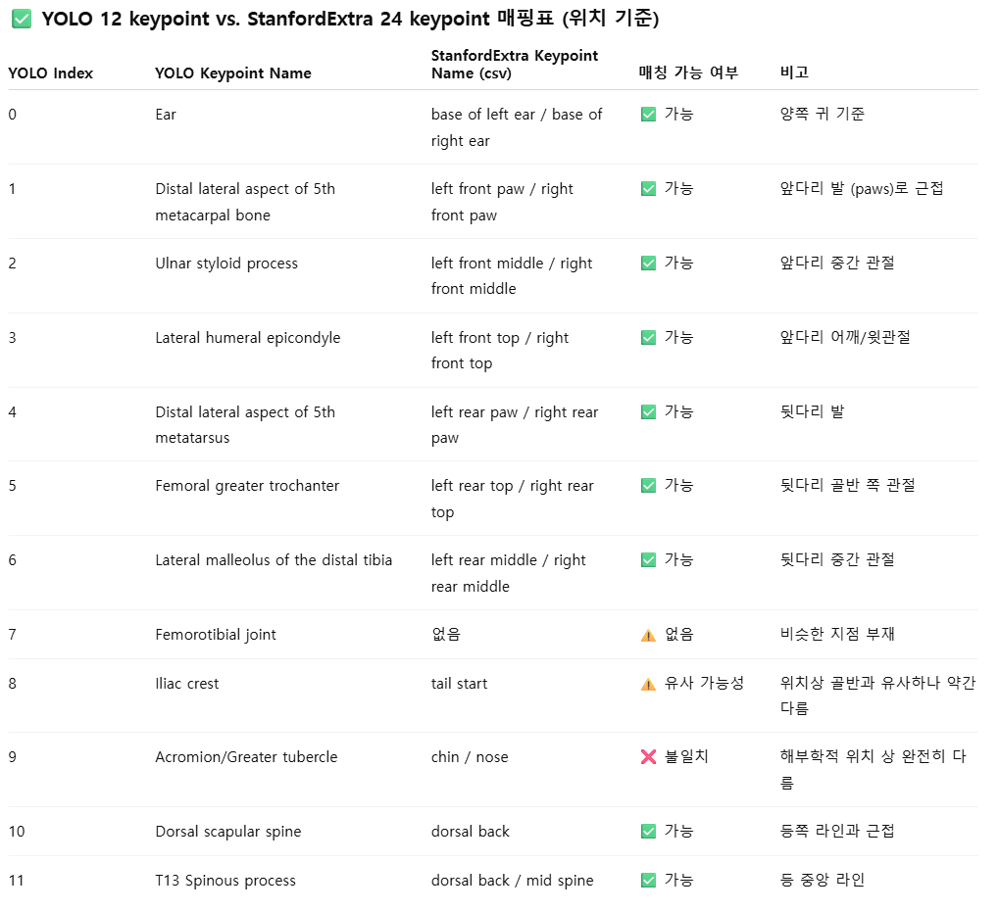

# 없는 keypoint는 0으로 채우면 안 된다. 지점을 연결할 때 갑자기 생뚱맞은 방향으로 넘어간다.

In [ ]:
총 12개 중 정확/근접하게 매핑 가능한 keypoint는 9~10개 정도.

정확하게 매칭이 되지 않는 index가 7번,8번,9번이잖아 그것은 0으로 해야지, yolo keypoint 12는 그걸 모르니까
정확히 매칭되지 않는 위치는 visibility=0으로 처리하여 "모름 / 존재하지 않음"으로 마킹하면 된다.

In [ ]:
# 기존의 yolo keypoint 12 yaml 파일 내용
path: /content/drive/MyDrive/pet_angle_copy/dataset_split2
train: train/side_image
val: val/side_image

nc: 2
names: ["소형견", "중형견"]

kpt_shape: [12, 3]
flip_idx: [0, 4, 6, 5, 1, 3, 2, 8, 7, 10, 9, 11]

In [ ]:
# YOLOv11 기반 pose 모델을 위한 StanfordExtra 기반 파인튜닝 설정
path: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split
train: train
val: val
test: test

kpt_shape: [12, 3]
flip_idx: [0, 4, 6, 5, 1, 3, 2, 8, 7, 10, 9, 11]

names:
  0: dog

In [ ]:
# 품종 폴더명을 이용하여 소형견과 중형견 클래스 분리(txt 파일 수정), yaml 파인튜닝 재설정
# YOLOv11 기반 pose 모델을 위한 StanfordExtra 기반 파인튜닝 설정
path: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split
train: train
val: val
test: test

kpt_shape: [12, 3]
flip_idx: [0, 4, 6, 5, 1, 3, 2, 8, 7, 10, 9, 11]

nc: 2
names: ["소형견", "중형견"]

In [ ]:
# 클래스 구분 무시하기 : 소형견, 중형견
파인튜닝 목적이 기존 pose 모델의 keypoint localization 성능 강화

In [ ]:
✅ 방법 1: 단일 클래스 유지 (추천)
keypoint 성능 향상이 목적이라면, 그냥 class_id = 0 유지
나중에 keypoint 기반 파생 정보로 분류 모델 따로 만들 수 있음

📌 이 방법을 쓰면 지금 라벨 수정 필요 없음

In [ ]:
# 클래스 구분 할 수 있는 방법 : 품종에 따라 크기 구분 가능
✅ 방법 2: 견종 → 크기 매핑 후 자동 라벨링
StanfordExtra 데이터에는 **견종 정보 (예: img_path: n02085620-Chihuahua/xxx.jpg)**가 포함되어 있음. 이걸 이용해서 자동 분류 가능.

In [ ]:
import json

# JSON 파일 경로
json_path = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/StanfordExtra_v12.json"

# JSON 로드
with open(json_path, "r") as f:
    data = json.load(f)

# 견종 추출
breed_set = set()
for item in data:
    img_path = item["img_path"]  # e.g., "n02085620-Chihuahua/n02085620_123.jpg"
    breed = img_path.split('/')[0].split('-')[1]  # "Chihuahua"
    breed_set.add(breed)

# 정렬 및 출력
breed_list = sorted(list(breed_set))
print(f"✅ 총 견종 수: {len(breed_list)}종\n")
for i, breed in enumerate(breed_list):
    print(f"{i+1:2d}. {breed}")


✅ 총 견종 수: 120종

 1. Afghan_hound
 2. African_hunting_dog
 3. Airedale
 4. American_Staffordshire_terrier
 5. Appenzeller
 6. Australian_terrier
 7. Bedlington_terrier
 8. Bernese_mountain_dog
 9. Blenheim_spaniel
10. Border_collie
11. Border_terrier
12. Boston_bull
13. Bouvier_des_Flandres
14. Brabancon_griffon
15. Brittany_spaniel
16. Cardigan
17. Chesapeake_Bay_retriever
18. Chihuahua
19. Dandie_Dinmont
20. Doberman
21. English_foxhound
22. English_setter
23. English_springer
24. EntleBucher
25. Eskimo_dog
26. French_bulldog
27. German_shepherd
28. German_short
29. Gordon_setter
30. Great_Dane
31. Great_Pyrenees
32. Greater_Swiss_Mountain_dog
33. Ibizan_hound
34. Irish_setter
35. Irish_terrier
36. Irish_water_spaniel
37. Irish_wolfhound
38. Italian_greyhound
39. Japanese_spaniel
40. Kerry_blue_terrier
41. Labrador_retriever
42. Lakeland_terrier
43. Leonberg
44. Lhasa
45. Maltese_dog
46. Mexican_hairless
47. Newfoundland
48. Norfolk_terrier
49. Norwegian_elkhound
50. Norwich_terrier
5

In [ ]:
breed_size_map = {
    "Afghan_hound": 1, "African_hunting_dog": 1, "Airedale": 1, "American_Staffordshire_terrier": 1,
    "Appenzeller": 1, "Australian_terrier": 0, "Bedlington_terrier": 1, "Bernese_mountain_dog": 1,
    "Blenheim_spaniel": 0, "Border_collie": 1, "Border_terrier": 0, "Boston_bull": 0,
    "Bouvier_des_Flandres": 1, "Brabancon_griffon": 0, "Brittany_spaniel": 1, "Cardigan": 1,
    "Chesapeake_Bay_retriever": 1, "Chihuahua": 0, "Dandie_Dinmont": 0, "Doberman": 1,
    "English_foxhound": 1, "English_setter": 1, "English_springer": 1, "EntleBucher": 1,
    "Eskimo_dog": 1, "French_bulldog": 0, "German_shepherd": 1, "German_short": 1,
    "Gordon_setter": 1, "Great_Dane": 1, "Great_Pyrenees": 1, "Greater_Swiss_Mountain_dog": 1,
    "Ibizan_hound": 1, "Irish_setter": 1, "Irish_terrier": 1, "Irish_water_spaniel": 1,
    "Irish_wolfhound": 1, "Italian_greyhound": 0, "Japanese_spaniel": 0, "Kerry_blue_terrier": 1,
    "Labrador_retriever": 1, "Lakeland_terrier": 0, "Leonberg": 1, "Lhasa": 0,
    "Maltese_dog": 0, "Mexican_hairless": 0, "Newfoundland": 1, "Norfolk_terrier": 0,
    "Norwegian_elkhound": 1, "Norwich_terrier": 0, "Old_English_sheepdog": 1, "Pekinese": 0,
    "Pembroke": 0, "Pomeranian": 0, "Rhodesian_ridgeback": 1, "Rottweiler": 1,
    "Saint_Bernard": 1, "Saluki": 1, "Samoyed": 1, "Scotch_terrier": 0,
    "Scottish_deerhound": 1, "Sealyham_terrier": 0, "Shetland_sheepdog": 0, "Shih": 0,
    "Siberian_husky": 1, "Staffordshire_bullterrier": 1, "Sussex_spaniel": 0, "Tibetan_mastiff": 1,
    "Tibetan_terrier": 0, "Walker_hound": 1, "Weimaraner": 1, "Welsh_springer_spaniel": 1,
    "West_Highland_white_terrier": 0, "Yorkshire_terrier": 0, "affenpinscher": 0, "basenji": 0,
    "basset": 1, "beagle": 1, "black": 1, "bloodhound": 1,
    "bluetick": 1, "borzoi": 1, "boxer": 1, "briard": 1,
    "bull_mastiff": 1, "cairn": 0, "chow": 1, "clumber": 1,
    "cocker_spaniel": 1, "collie": 1, "curly": 1, "dhole": 1,
    "dingo": 1, "flat": 1, "giant_schnauzer": 1, "golden_retriever": 1,
    "groenendael": 1, "keeshond": 1, "kelpie": 1, "komondor": 1,
    "kuvasz": 1, "malamute": 1, "malinois": 1, "miniature_pinscher": 0,
    "miniature_poodle": 0, "miniature_schnauzer": 0, "otterhound": 1, "papillon": 0,
    "pug": 0, "redbone": 1, "schipperke": 0, "silky_terrier": 0,
    "soft": 0, "standard_poodle": 1, "standard_schnauzer": 1, "toy_poodle": 0,
    "toy_terrier": 0, "vizsla": 1, "whippet": 1, "wire": 1
}


In [ ]:
import json

# ✅ JSON 경로
json_path = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/StanfordExtra_v12.json"

# ✅ JSON 로드
with open(json_path, "r") as f:
    data = json.load(f)

# ✅ JSON에서 breed 추출
json_breed_set = set()
for item in data:
    img_path = item["img_path"]
    try:
        breed = img_path.split('/')[0].split('-')[1]  # 예: "Chihuahua"
        json_breed_set.add(breed)
    except IndexError:
        print(f"❗ 경로 파싱 실패: {img_path}")

# ✅ 불일치 견종 탐색
breed_map_set = set(breed_size_map.keys())
missing_in_map = json_breed_set - breed_map_set
extra_in_map = breed_map_set - json_breed_set

# ✅ 통계 출력
print(f"✅ 총 JSON 내 견종 수: {len(json_breed_set)}")
print(f"✅ 총 breed_size_map 견종 수: {len(breed_map_set)}")
print(f"🔹 소형견 수: {sum(v == 0 for v in breed_size_map.values())}")
print(f"🔹 중형견 수: {sum(v == 1 for v in breed_size_map.values())}")

# ✅ 불일치 견종 출력
if missing_in_map:
    print(f"\n❗ breed_size_map에 누락된 견종 ({len(missing_in_map)}종):")
    print(", ".join(sorted(missing_in_map)))
else:
    print("\n✅ breed_size_map에 JSON 견종이 모두 포함되어 있음")

if extra_in_map:
    print(f"\n❗ JSON에 존재하지 않는 breed_size_map의 견종 ({len(extra_in_map)}종):")
    print(", ".join(sorted(extra_in_map)))


✅ 총 JSON 내 견종 수: 120
✅ 총 breed_size_map 견종 수: 120
🔹 소형견 수: 40
🔹 중형견 수: 80

✅ breed_size_map에 JSON 견종이 모두 포함되어 있음


In [ ]:
import json
from collections import Counter

# 카운터 초기화
size_counter = Counter()
error_count = 0

# 이미지별 크기 분류
for item in data:
    try:
        breed = item["img_path"].split('/')[0].split('-')[1]
        size_class = breed_size_map.get(breed)
        if size_class is not None:
            size_counter[size_class] += 1
        else:
            print(f"❗ Unknown breed in map: {breed}")
            error_count += 1
    except Exception as e:
        print(f"❗ Error parsing: {item['img_path']}")
        error_count += 1

# 결과 출력
print("\n✅ 이미지 개수 통계")
print(f"🔹 소형견 (0): {size_counter[0]} 장")
print(f"🔹 중형견 (1): {size_counter[1]} 장")
print(f"⚠️ 매핑 실패/에러: {error_count} 장")



✅ 이미지 개수 통계
🔹 소형견 (0): 4364 장
🔹 중형견 (1): 8174 장
⚠️ 매핑 실패/에러: 0 장


In [ ]:
# yolo keypoint 12개(슬개골)
하지만 여전히 클래스 불균형 문제 존재
현재 소형견: 1027, 중형견: 23 → 매우 불균형

In [ ]:
# /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split/train
/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split/test
/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split/val

In [ ]:
클래스 값은 이미 0으로 일괄 반영되어있어, 하지만 npy파일 기준으로는 품종폴더명/실제파일명.jpg로 되어있기 때문에 품종폴더명으로 인식을 해서 txt파일의 클래스를 수정할 수 있잖아

In [ ]:
import numpy as np
import json

# 경로 설정
json_path = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/StanfordExtra_v12.json"
npy_path = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/train_stanford_StanfordExtra_v12.npy"  # 업로드된 npy

# JSON 로드
with open(json_path, 'r') as f:
    json_data = json.load(f)

# 인덱스 로드
indices = np.load(npy_path)

# 해당 인덱스에 매칭되는 이미지 경로만 추출
image_paths = [json_data[int(idx)]["img_path"] for idx in indices]

# 결과 출력
for path in image_paths:
    print(path)

# 필요하다면 저장도 가능
with open("used_image_paths.txt", "w") as f:
    for path in image_paths:
        f.write(path + "\n")

print("✅ 이미지 경로 추출 완료")

In [ ]:
npy 파일에 포함된 인덱스 → StanfordExtra_v12.json의 img_path → txt 파일명과 매칭되므로,
img_path에서 품종 이름을 추출하고, 이를 기반으로 소형견(0), 중형견(1) 클래스로 txt 파일 내 첫 숫자(class id)를 수정할 수 있습니다.


In [ ]:
import os
import json
import numpy as np

# 설정
json_path = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/StanfordExtra_v12.json"
npy_path = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/train_stanford_StanfordExtra_v12.npy"
label_root = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split/train"

target_breed = "German_shepherd"
target_class = 1  # 중형견

# JSON 및 NPY 로드
with open(json_path, 'r') as f:
    json_data = json.load(f)
indices = np.load(npy_path)

# 찾기
updated = False
for idx in indices:
    item = json_data[int(idx)]
    breed = item["img_path"].split('/')[0].split('-')[1]

    if breed == target_breed:
        filename = os.path.splitext(os.path.basename(item["img_path"]))[0] + ".txt"
        txt_path = os.path.join(label_root, filename)

        if os.path.exists(txt_path):
            # 수정 전 클래스 읽기
            with open(txt_path, "r") as f:
                parts = f.read().strip().split()
                old_class = parts[0]
                parts[0] = str(target_class)

            # 클래스 덮어쓰기
            with open(txt_path, "w") as f:
                f.write(" ".join(parts) + "\n")

            print(f"✅ 수정 완료: {filename}")
            print(f"🔹 품종: {breed}")
            print(f"🔹 기존 클래스: {old_class} → 새 클래스: {target_class}")
            updated = True
            break

if not updated:
    print("❗ German_shepherd 품종의 txt 파일을 찾지 못했습니다.")


✅ 수정 완료: n02106662_104.txt
🔹 품종: German_shepherd
🔹 기존 클래스: 0 → 새 클래스: 1


In [ ]:
import os
import json
import numpy as np

# 경로 설정
json_path = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/StanfordExtra_v12.json"
split_npy_paths = {
    "train": "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/train_stanford_StanfordExtra_v12.npy",
    "val": "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/val_stanford_StanfordExtra_v12.npy",
    "test": "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/test_stanford_StanfordExtra_v12.npy"
}
split_image_root = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split"


# JSON 로드
with open(json_path, "r") as f:
    json_data = json.load(f)

# 처리 시작
for split_name, npy_path in split_npy_paths.items():
    indices = np.load(npy_path, allow_pickle=True)
    split_dir = os.path.join(split_image_root, split_name)

    print(f"\n📂 {split_name.upper()} 시작 ({len(indices)}개)...")
    updated, skipped = 0, 0

    for idx in indices:
        idx = int(idx)
        item = json_data[idx]
        img_path = item["img_path"]  # e.g., "n02085620-Chihuahua/n02085620_10131.jpg"
        breed_folder = img_path.split('/')[0]
        breed = breed_folder.split('-')[1] if '-' in breed_folder else breed_folder

        # 🐕 크기 분류
        cls = breed_size_map.get(breed, 1)  # 기본값: 중형견(1)

        # txt 경로
        img_filename = os.path.basename(img_path)
        txt_name = os.path.splitext(img_filename)[0] + ".txt"
        txt_path = os.path.join(split_dir, txt_name)

        if not os.path.exists(txt_path):
            skipped += 1
            continue

        # txt 내용 읽고 첫 번째 숫자(class)만 수정
        with open(txt_path, 'r') as f:
            lines = f.readlines()

        if not lines:
            skipped += 1
            continue

        parts = lines[0].strip().split()
        if len(parts) < 5:
            skipped += 1
            continue

        parts[0] = str(cls)  # class ID 변경
        lines[0] = " ".join(parts) + "\n"

        # 덮어쓰기
        with open(txt_path, 'w') as f:
            f.writelines(lines)

        updated += 1

    print(f"✅ 완료: {updated}개 업데이트, {skipped}개 누락/건너뜀")


📂 TRAIN 시작 (6773개)...
✅ 완료: 6773개 업데이트, 0개 누락/건너뜀

📂 VAL 시작 (4062개)...
✅ 완료: 4062개 업데이트, 0개 누락/건너뜀

📂 TEST 시작 (1703개)...
✅ 완료: 1703개 업데이트, 0개 누락/건너뜀


In [ ]:
# txt 파일 수정이 잘 되었는지 확인 코드 (품종에 따라 소형견, 중형견)
import os
from collections import Counter

# ✅ YOLO 라벨 폴더 경로
base_dir = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split"
splits = ["train", "val", "test"]

class_counter = Counter()
file_errors = []

# 🔍 각 split 폴더 순회
for split in splits:
    split_dir = os.path.join(base_dir, split)
    print(f"\n📂 {split.upper()} 경로 확인 중...")

    for file in os.listdir(split_dir):
        if file.endswith(".txt"):
            txt_path = os.path.join(split_dir, file)

            try:
                with open(txt_path, 'r') as f:
                    line = f.readline().strip()
                    if not line:
                        continue
                    cls_id = int(line.split()[0])
                    class_counter[cls_id] += 1
            except Exception as e:
                file_errors.append((txt_path, str(e)))

# 📊 결과 출력
print("\n🔍 클래스 분포 확인 결과:")
print(f"소형견(0): {class_counter[0]}개")
print(f"중형견(1): {class_counter[1]}개")

if file_errors:
    print("\n⚠️ 읽기 오류 파일:")
    for path, err in file_errors[:5]:
        print(f" - {path}: {err}")
    if len(file_errors) > 5:
        print(f"  ... 외 {len(file_errors) - 5}개 생략")

print("\n✅ 확인 완료")


📂 TRAIN 경로 확인 중...

📂 VAL 경로 확인 중...

📂 TEST 경로 확인 중...

🔍 클래스 분포 확인 결과:
소형견(0): 4364개
중형견(1): 8174개

✅ 확인 완료


In [ ]:
✅ 방법 3: 나중에 inference에서만 분리
지금은 dog 단일 클래스로 학습 진행
추론 시 keypoint 좌표 또는 특징 기반으로 소형/중형을 분류하는 모델을 따로 구성

📌 예: keypoint 간 거리 비율, 신체 크기 비율 → 소형/중형 이진 분류기 학습 (XGBoost 등)

In [ ]:
# 매칭한 keypoint_map 기준으로 txt 파일 수정하거나 새로 생성해야함
아래는 StanfordExtra 기반 YOLO .txt 파일(총 24개 keypoint)을 12개 keypoint 구조로 자동 변환해주는 일괄 변환 스크립트입니다:

In [ ]:
# keypoint_mapping 잘못되었음

기존의 keypoint12 yolo모델의 json에는 annotation_info에 해당 좌표의 label값이 있었으나
이번의 파인튜닝 json에는 이미지경로, 이미지 크기, bbox, ismultipledogs, joints, seg 키 값만 존재

[{"img_path": "n02085782-Japanese_spaniel/n02085782_2886.jpg", "img_width": 350, "img_height": 272, "img_bbox": [205, 20, 116, 201], "is_multiple_dogs": false,
  "joints": [[108.66666666666667, 252.0, 1], [147.66666666666666, 229.0, 1], [163.5, 208.5, 1], [0, 0, 0], [0, 0, 0], [0, 0, 0], [54.0, 244.0, 1], [77.33333333333333, 225.33333333333334, 1],
   [79.0, 196.5, 1], [0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], [150.66666666666666, 86.66666666666667, 1], [88.66666666666667, 73.0, 1], [116.0, 106.33333333333333, 1],
    [109.0, 123.33333333333333, 1], [0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0]], "seg": "Yi71c01S74jHNU75gHMX75eHM"}]

In [ ]:
해당 joints 속성이 /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/keypoint_definitions.csv 순서에 맞게 정의되어있다.

In [ ]:
{0: 'Left front leg: paw', 1: 'Left front leg: middle joint', 2: 'Left front leg: top', 3: 'Left rear leg: paw', 4: 'Left rear leg: middle joint', 5: 'Left rear leg: top',
 6: 'Right front leg: paw', 7: 'Right front leg: middle joint', 8: 'Right front leg: top', 9: 'Right rear leg: paw', 10: 'Right rear leg: middle joint',
 11: 'Right rear leg: top', 12: 'Tail start', 13: 'Tail end',
 14: 'Base of left ear',
 15: 'Base of right ear', 16: 'Nose', 17: 'Chin', 18: 'Left ear tip', 19: 'Right ear tip', 20: 'Left eye', 21: 'Right eye', 22: 'Withers', 23: 'Throat'}

In [ ]:
이렇게 되어있는데, json파일에는 label 명칭(keypoint)가 없고, 아래 csv파일에서 명시한 순서대로 joints가 정의된거야,
그러면 yolo keypoint12개에 맞게 필요한 것만 추출해서 txt 파일 재생성해야하잖아
너가 매핑해준 인덱스(keypoint 순서)는 아래와 같거든?

keypoint_mapping = {
    0: (14, 15),     # Ear
    1: (0, 6),
    2: (1, 7),
    3: (2, 8),
    4: (3, 9),
    5: (5, 11),
    6: (4, 10),
    7: None,
    8: 12,
    9: None,
    10: 20,
    11: 21
}

# ✅ YOLO keypoint 12개 중 사용할 StanfordExtra 인덱스 (10개만 사용)
stanford_kpt_indices = [0, 1, 2, 3, 6, 7, 8, 12, 15, 16]  # 나머지 2개는 패딩

# 원본 yolo keypoint12개의 keypoint 순서
KEYPOINT_ORDER = [
    "Ear",
    "Distal lateral aspect of fifth metacarpal bone",
    "Ulnar styloid process",
    "Lateral humeral epicondyle",
    "Distal lateral aspect of the fifth metatarsus",
    "Femoral greater trochanter",
    "Lateral malleolus of the distal tibia",
    "Femorotibial joint",
    "Iliac crest",
    "Acromion/Greater tubercle",
    "Dorsal scapular spine",
    "T13 Spinous precess"
]

SyntaxError: invalid syntax (ipython-input-2909956341.py, line 1)

In [ ]:
이 매핑이 잘못된 게, 하나의 순서에 24개짜리는 2개씩 매핑된 경우가 있잖아, 이걸 yolo가 12개로 인식할 수 있어?
# 예시
0  : (14,15)
# 현재 구조는 "좌우 평균을 직접 계산하여 단일 좌표로 축약"하는 방식이기 때문에 YOLOv8이 정상적으로 처리할 수 있습니다.

In [ ]:
# ✅ YOLO keypoint 12개 중 사용할 StanfordExtra 인덱스 (10개만 사용)
stanford_kpt_indices = [0, 1, 2, 3, 6, 7, 8, 12, 15, 16]  # 나머지 2개는 패딩
# 24개 순서로 된 것 중에 저 순서로 된 것만 txt파일에 남겨두고, 해당 순서에 없는 내용은 삭제해줘

In [ ]:
import os

# 사용할 인덱스 (총 10개)
stanford_kpt_indices = [0, 1, 2, 3, 6, 7, 8, 12, 15, 16]  # YOLO 12개 중 실제로 추출할 10개
NUM_YOLO_KPTS = 12

def convert_txt_keep_10_pad_2(source_dir, dest_dir):
    os.makedirs(dest_dir, exist_ok=True)
    converted = 0

    for fname in os.listdir(source_dir):
        if not fname.endswith(".txt"):
            continue

        src_path = os.path.join(source_dir, fname)
        dst_path = os.path.join(dest_dir, fname)

        with open(src_path, "r") as f:
            line = f.readline().strip()
            if not line:
                continue

        items = line.split()
        class_id = items[0]
        keypoints_raw = list(map(float, items[1:]))

        if len(keypoints_raw) != 72:
            print(f"⚠️ keypoint 개수 이상함: {fname}")
            continue

        # (x, y, v) 24개로 나누기
        kpts_24 = [(keypoints_raw[i], keypoints_raw[i+1], int(keypoints_raw[i+2]))
                   for i in range(0, 72, 3)]

        # 10개 인덱스만 추출
        filtered_kpts = [kpts_24[i] for i in stanford_kpt_indices]

        # 패딩: 나머지 2개는 (0.0, 0.0, 0)
        while len(filtered_kpts) < NUM_YOLO_KPTS:
            filtered_kpts.append((0.0, 0.0, 0))

        # 저장
        converted_line = class_id + " " + " ".join(f"{x:.6f} {y:.6f} {v}" for (x, y, v) in filtered_kpts)
        with open(dst_path, "w") as f:
            f.write(converted_line + "\n")
        converted += 1

    print(f"✅ 변환 완료: {converted}개 파일 저장됨 → {dest_dir}")


In [ ]:
convert_txt_keep_10_pad_2(
    source_dir="/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split/train",
    dest_dir="/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split_yolo11/train/labels"
)

스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
⚠️ keypoint 개수 이상함: n02107574_2806.txt
⚠️ keypoint 개수 이상함: n02107574_2905.txt
⚠️ keypoint 개수 이상함: n02107574_2954.txt
⚠️ keypoint 개수 이상함: n02107574_298.txt
⚠️ keypoint 개수 이상함: n02107574_2998.txt
⚠️ keypoint 개수 이상함: n02107574_3001.txt
⚠️ keypoint 개수 이상함: n02107574_306.txt
⚠️ keypoint 개수 이상함: n02107574_3099.txt
⚠️ keypoint 개수 이상함: n02107574_3270.txt
⚠️ keypoint 개수 이상함: n02107574_330.txt
⚠️ keypoint 개수 이상함: n02107574_380.txt
⚠️ keypoint 개수 이상함: n02107574_426.txt
⚠️ keypoint 개수 이상함: n02107574_431.txt
⚠️ keypoint 개수 이상함: n02107574_445.txt
⚠️ keypoint 개수 이상함: n02107574_481.txt
⚠️ keypoint 개수 이상함: n02107574_530.txt
⚠️ keypoint 개수 이상함: n02107574_592.txt
⚠️ keypoint 개수 이상함: n02107574_627.txt
⚠️ keypoint 개수 이상함: n02107574_656.txt
⚠️ keypoint 개수 이상함: n02107574_750.txt
⚠️ keypoint 개수 이상함: n02107574_753.txt
⚠️ keypoint 개수 이상함: n02107574_835.txt
⚠️ keypoint 개수 이상함: n02107574_870.txt
⚠️ keypoint 개수 이상함: n02107574_888.txt
⚠️ keypoint 개수 이상함: n02107574_972.txt
⚠️ keyp

In [ ]:
# /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split_yolo11/train/labels

## TXT 파일부터 다시 생성

In [ ]:
# NPY 파일 이용하지 말고, 그 파일은 데이터 분할 용도로만 사용하고 (폴더명/파일명.jpg = 클래스(소형,중현견) 분류 용도로 사용)

In [ ]:
🔑 JSON 내 필드 목록:
- img_path
- img_width
- img_height
- img_bbox
- is_multiple_dogs
- joints
- seg

# 4.1 Side 방향부터 학습 시작 (파인튜닝)

In [ ]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 61.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 115.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 96.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 58.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 38.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 16.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 3.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 105.0 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalli

In [ ]:
# /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split/finetune.yaml

path: /content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/stanford_dogs_split
train: images/train
val: images/val
test: images/test

kpt_shape: [24, 3]

flip_idx:
  [1, 2, 3, 4, 5, 6, 7, 8,
   0, 11, 10, 9, 17, 18, 19, 12, 13, 14,
   16, 15, 23, 22, 21, 20]

# 참고: flip_idx[i]는 i번 keypoint가 horizontal flip될 때 대응되는 index

names:
  0: dog


In [ ]:
from ultralytics import YOLO

# 기존 모델 불러오기 (예: side 방향 학습된 모델)
model = YOLO("/content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs_yolo11/train/weights/best.pt")

# 파인튜닝 수행
model.train(
    data="/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/finetune.yaml",
    epochs=100,
    imgsz=768,
    batch=8,
    name="finetune_all_directions",
    project="/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/side_runs_yolo11",
    device=0,
    optimizer="AdamW",
    lr0=0.001,
    close_mosaic=10
)

In [ ]:
# 학습한 모델 불러오기
model = YOLO("/content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs_yolo11/train/weights/best.pt")

# validation 수행
metrics = model.val(data="/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/finetune.yaml", project="/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/side_runs_yolo11/valid_results")


In [ ]:
# 학습 완료된 모델 불러오기
model = YOLO("/content/drive/MyDrive/pet_angle_copy/dataset_split2/side_runs_yolo11/train/weights/best.pt")

# 예측 수행
results = model.predict(
    source="/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/test/tail_image",
    project="/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/side_runs_yolo11",  # 저장 루트 변경
    name="predict_results",   # 하위 폴더명 지정
    save=True,               # 예측 결과 이미지 저장
    save_txt=True,            # 예측된 keypoint 좌표 .txt 저장
    save_conf=True,             # confidence 포함 저장
    conf=0.25,                   # confidence threshold (필요 시 조절)
    imgsz=768                 # 학습할 때와 동일한 이미지 크기 사용
)

In [ ]:
# 예측 결과 시각화
import os
import cv2
import random
import matplotlib.pyplot as plt

# 경로 설정
image_dir = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/side_runs_yolo11predict_results"
label_dir = "/content/drive/MyDrive/pet_angle_copy/dataset_split2/finetunning/side_runs_yolo11/labels"

# keypoint 수
num_kpts = 12

# 파일 목록 불러오기
image_files = sorted([f for f in os.listdir(image_dir) if f.endswith(".jpg")])
label_files = sorted([f for f in os.listdir(label_dir) if f.endswith(".txt")])

# 파일명 기준으로 일치하는 페어만 선택
base_names = set(os.path.splitext(f)[0] for f in image_files) & set(os.path.splitext(f)[0] for f in label_files)
base_name = random.choice(list(base_names))  # 🔀 랜덤 선택

# 경로 설정
sample_image_path = os.path.join(image_dir, base_name + ".jpg")
sample_label_path = os.path.join(label_dir, base_name + ".txt")

# 이미지 불러오기
image = cv2.imread(sample_image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
h, w, _ = image.shape

# keypoint 추출
with open(sample_label_path, 'r') as f:
    line = f.readline().strip().split()
    keypoint_values = list(map(float, line[1:]))

keypoints = []
for i in range(num_kpts):
    x = keypoint_values[i * 3] * w
    y = keypoint_values[i * 3 + 1] * h
    v = keypoint_values[i * 3 + 2]
    if v > 0:
        keypoints.append((int(x), int(y)))
    else:
        keypoints.append(None)

# 시각화
for i, pt in enumerate(keypoints):
    if pt:
        cv2.circle(image, pt, 5, (0, 255, 0), -1)
        cv2.putText(image, str(i), (pt[0]+5, pt[1]), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)

# 출력
plt.figure(figsize=(10, 6))
plt.imshow(image)
plt.axis("off")
plt.title(f"랜덤 예측 결과 시각화: {base_name}.jpg")
plt.show()
